In [1]:
from multi_imbalance.datasets import load_datasets
import experiment_autoencoder_basic_weights_cutoff as ex
from sklearn.model_selection import StratifiedKFold
from collections import Counter, defaultdict
from multi_imbalance.utils.metrics import gmean_score
from sklearn.metrics import f1_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from utils import plot_embeddings
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis

In [2]:
datasets = load_datasets()

In [3]:
ds_name = 'dermatology'
test_on_all_folds = True
test_all_ds = True

In [4]:
datasets = ex.one_hot_encode_all(datasets)

In [5]:
config = ex.config_calculation_strategy2(datasets)

In [6]:
config['cmc'] = {'nn_config': {'units_1st_layer': 17,
                               'units_2nd_layer': 256,
                               'units_3rd_layer': 128,
                               'units_latent_layer': 8},
                 'weighted_triplet_loss': True,
                 'lr': 0.001,
                 'batch_size': 32,
                 'gamma': 0.99,
                 'epochs': 10}


config['dermatology'] = {'nn_config': {'units_1st_layer': 97,
                                       'units_2nd_layer': 128,
                                       'units_3rd_layer': 64,
                                       'units_latent_layer': 48},
                         'weighted_triplet_loss': True,
                         'lr': 0.0010,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 45}

config['hayes-roth'] = {'nn_config': {'units_1st_layer': 11,
                                      'units_2nd_layer': 128,
                                      'units_3rd_layer': 64,
                                      'units_latent_layer': 16},
                        'weighted_triplet_loss': True,
                        'lr': 0.007,
                        'batch_size': 16,
                        'gamma': 0.99,
                        'epochs': 20}

config['new_vehicle'] = {'nn_config': {'units_1st_layer': 18,
                                       'units_2nd_layer': 256,
                                       'units_3rd_layer': 128,
                                       'units_latent_layer': 16},
                         'weighted_triplet_loss': True,
                         'lr': 0.001,
                         'batch_size': 16,
                         'gamma': 0.99,
                         'epochs': 45}

config['new_yeast'] = {'nn_config': {'units_1st_layer': 9,
                                     'units_2nd_layer': 300,
                                     'units_3rd_layer': 200,
                                     'units_latent_layer': 12},
                       'weighted_triplet_loss': True,
                       'lr': 0.0004,
                       'batch_size': 32,
                       'gamma': 0.99,
                       'epochs': 3}

config['balance-scale'] = {'nn_config': {'units_1st_layer': 16,
                                         'units_2nd_layer': 64,
                                         'units_3rd_layer': 32,
                                         'units_latent_layer': 16},
                           'weighted_triplet_loss': True,
                           'lr': 0.007,
                           'batch_size': 16,
                           'gamma': 0.99,
                           'epochs': 50}

config['cleveland'] = {'nn_config': {'units_1st_layer': 24,
                                     'units_2nd_layer': 256,
                                     'units_3rd_layer': 128,
                                     'units_latent_layer': 24},
                       'weighted_triplet_loss': True,
                       'lr': 0.001,
                       'batch_size': 32,
                       'gamma': 0.99,
                       'epochs': 20}

config['cleveland_v2'] = {'nn_config': {'units_1st_layer': 23,
                                        'units_2nd_layer': 256,
                                        'units_3rd_layer': 128,
                                        'units_latent_layer': 24},
                          'weighted_triplet_loss': True,
                          'lr': 0.001,
                          'batch_size': 16,
                          'gamma': 0.99,
                          'epochs': 10}

config['glass'] = {'nn_config': {'units_1st_layer': 9,
                                 'units_2nd_layer': 256,
                                 'units_3rd_layer': 128,
                                 'units_latent_layer': 14},
                   'weighted_triplet_loss': True,
                   'lr': 0.001,
                   'batch_size': 16,
                   'gamma': 0.99,
                   'epochs': 50}

config['thyroid-newthyroid'] = {'nn_config': {'units_1st_layer': 5,
                                              'units_2nd_layer': 32,
                                              'units_3rd_layer': 16,
                                              'units_latent_layer': 8},
                                'weighted_triplet_loss': True,
                                'lr': 0.001,
                                'batch_size': 32,
                                'gamma': 0.99,
                                'epochs': 20}

config['new_ecoli'] = {'nn_config': {'units_1st_layer': 7,
                                     'units_2nd_layer': 128,
                                     'units_3rd_layer': 64,
                                     'units_latent_layer': 8},
                       'weighted_triplet_loss': True,
                       'lr': 0.001,
                       'batch_size': 16,
                       'gamma': 0.99,
                       'epochs': 20}

config['new_led7digit'] = {'nn_config': {'units_1st_layer': 7,
                                         'units_2nd_layer': 64,
                                         'units_3rd_layer': 32,
                                         'units_latent_layer': 8},
                           'weighted_triplet_loss': True,
                           'lr': 0.001,
                           'batch_size': 32,
                           'gamma': 0.99,
                           'epochs': 10}

config['new_winequality-red'] = {'nn_config': {'units_1st_layer': 11,
                                               'units_2nd_layer': 64,
                                               'units_3rd_layer': 32,
                                               'units_latent_layer': 12},
                                 'weighted_triplet_loss': True,
                                 'lr': 0.0001,
                                 'batch_size': 32,
                                 'gamma': 0.99,
                                 'epochs': 25}

config['4delikatne-bezover-cut'] = {'nn_config': {'units_1st_layer': 2,
                                                  'units_2nd_layer': 128,
                                                  'units_3rd_layer': 64,
                                                  'units_latent_layer': 8},
                                    'weighted_triplet_loss': True,
                                    'lr': 0.001,
                                    'batch_size': 16,
                                    'gamma': 0.99,
                                    'epochs': 30}

config['3mocniej-cut'] = {'nn_config': {'units_1st_layer': 2,
                                        'units_2nd_layer': 64,
                                        'units_3rd_layer': 32,
                                        'units_latent_layer': 8},
                          'weighted_triplet_loss': True,
                          'lr': 0.001,
                          'batch_size': 32,
                          'gamma': 0.99,
                          'epochs': 30}


config['1czysty-cut'] = {'nn_config': {'units_1st_layer': 2,
                                       'units_2nd_layer': 32,
                                       'units_3rd_layer': 16,
                                       'units_latent_layer': 8},
                         'weighted_triplet_loss': True,
                         'lr': 0.004,
                         'batch_size': 32,
                         'gamma': 0.99,
                         'epochs': 10}

config['2delikatne-cut'] = {'nn_config': {'units_1st_layer': 2,
                                          'units_2nd_layer': 64,
                                          'units_3rd_layer': 32,
                                          'units_latent_layer': 8},
                            'weighted_triplet_loss': True,
                            'lr': 0.001,
                            'batch_size': 32,
                            'gamma': 0.99,
                            'epochs': 30}

In [7]:
config

{'1czysty-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 32,
   'units_3rd_layer': 16,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.004,
  'batch_size': 32,
  'gamma': 0.99,
  'epochs': 10},
 '2delikatne-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 64,
   'units_3rd_layer': 32,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.001,
  'batch_size': 32,
  'gamma': 0.99,
  'epochs': 30},
 '3mocniej-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 64,
   'units_3rd_layer': 32,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.001,
  'batch_size': 32,
  'gamma': 0.99,
  'epochs': 30},
 '4delikatne-bezover-cut': {'nn_config': {'units_1st_layer': 2,
   'units_2nd_layer': 128,
   'units_3rd_layer': 64,
   'units_latent_layer': 8},
  'weighted_triplet_loss': True,
  'lr': 0.001,
  'batch_size': 16,
  'gamma': 0.99,
  'epochs': 30},
 'balance-scale': {'nn_config': {'units_

In [8]:
autoencoder_config = ex.autoenc_config_calc_strategy1(datasets)

In [9]:
autoencoder_config['balance-scale']

{'epochs': 25,
 'batch_size': 16,
 'test_batch_size': 16,
 'lr': 0.001,
 'gamma': 1}

In [10]:
autoencoder_config['hayes-roth'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}


autoencoder_config['dermatology'] = {
    'epochs': 70,
    'batch_size': 16,
    'test_batch_size': 16,
    'lr': 0.002,
    'gamma': 1
}

autoencoder_config['balance-scale'] = {
    'epochs': 30,
    'batch_size': 16,
    'test_batch_size': 16,
    'lr': 0.002,
    'gamma': 1
}

autoencoder_config['2delikatne-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['3mocniej-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}


autoencoder_config['cleveland'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['cleveland_v2'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['glass'] = {
    "epochs": 50,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.002,
    "gamma": 1
}


autoencoder_config['4delikatne-bezover-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}


autoencoder_config['new_yeast'] = {
    "epochs": 30,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['new_ecoli'] = {
    "epochs": 30,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['thyroid-newthyroid'] = {
    "epochs": 25,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

autoencoder_config['1czysty-cut'] = {
    "epochs": 5,
    "batch_size": 16,
    "test_batch_size": 16,
    "lr": 0.001,
    "gamma": 1
}

In [11]:
k_dict = ex.construct_k_dict(datasets)
k_dict['balance-scale'] = 21
k_dict['new_vehicle'] = 13
k_dict['new_yeast'] = 21
k_dict['2delikatne-cut'] = 21

In [12]:
def instantiate_classifiers():
    classifiers = {
#             "RF24": RandomForestClassifier(random_state=0, min_samples_leaf=2, min_samples_split=4, class_weight='balanced'),
            "DT": DecisionTreeClassifier(random_state=0, min_samples_split=4, min_samples_leaf=2, class_weight='balanced'),
            "KNN": KNeighborsClassifier(n_neighbors=1)
#             "QDA": QuadraticDiscriminantAnalysis(),
#             "LDA": LinearDiscriminantAnalysis()
        } 
    return classifiers

In [13]:
from experiment import dt_name_to_cols_to_encode, dt_name_minority_classes


In [14]:
from sklearn.neighbors import KNeighborsClassifier

def calc_safety5(X,y):
    result = {
        "safe":0,
        "borderline":0,
        "rare":0,
        "outlier":0
    }
    neigh = KNeighborsClassifier(n_neighbors=5)
    neigh.fit(X, y)
    neighbors = neigh.kneighbors(X, 5+1, False)
    for i, (x, nbors) in enumerate(list(zip(X, neighbors))):
        same_class_nbrs = (y[nbors[1:]] == y[i]).sum()
        if same_class_nbrs >= 4:
            result['safe'] += 1
        elif same_class_nbrs >= 2:
            result['borderline'] += 1
        elif same_class_nbrs == 1:
            result['rare'] += 1
        else:
            result['outlier'] += 1
    return result

In [15]:
def standardize(X_train, X_test):
    means = X_train.mean(axis=0)
    stds = X_train.std(axis=0)
    return (X_train - means) / (stds+1e-6), (X_test - means) / (stds + 1e-6)

cmc


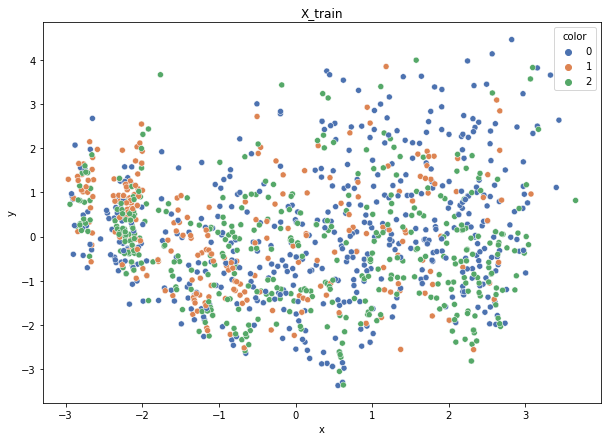

Class cardinalities: Counter({0: 503, 2: 409, 1: 266})
Weights: {0: 0.2426709552796112, 1: 0.45888530265279864, 2: 0.29844374206759033}
Training autoencoder...


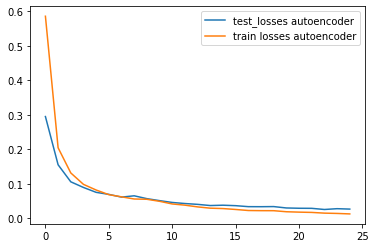

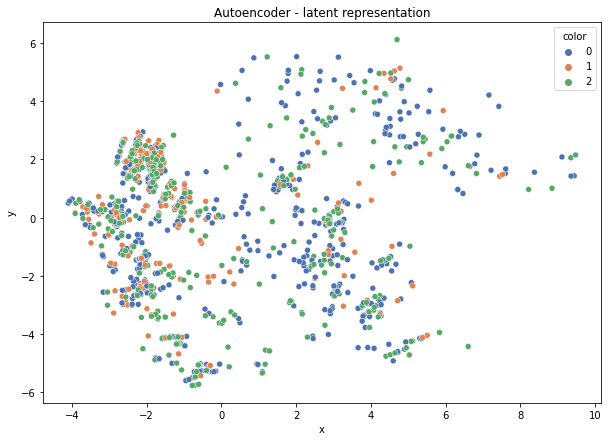

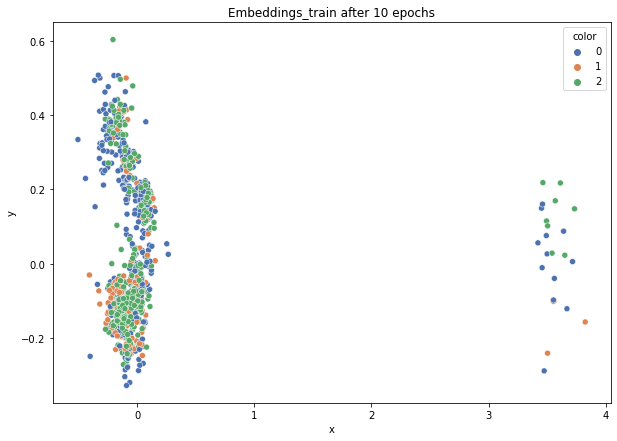

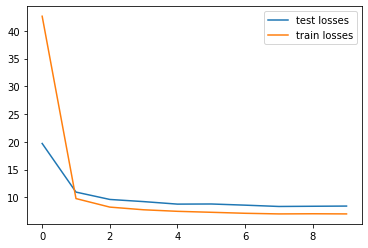

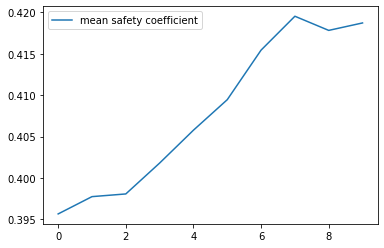

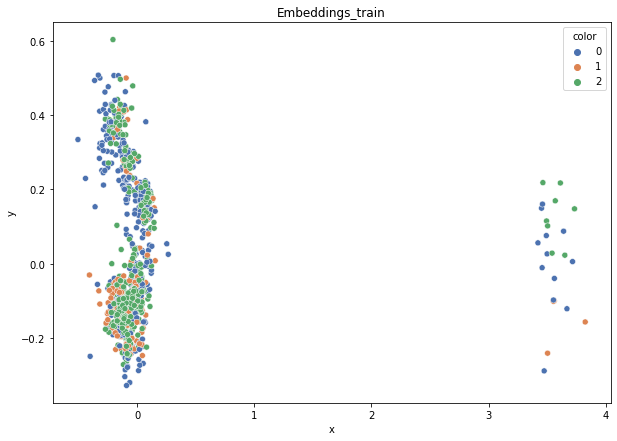

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.435
DT-f1-old+new-features: 0.386
DT-f1-old-features: 0.469
DT-gmean-new-features: 0.443
DT-gmean-old+new-features: 0.382
DT-gmean-old-features: 0.467
DT-minority_gmean-new-features: 0.008
DT-minority_gmean-old+new-features: 0.007
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.419
KNN-f1-old+new-features: 0.44
KNN-f1-old-features: 0.431
KNN-gmean-new-features: 0.415
KNN-gmean-old+new-features: 0.437
KNN-gmean-old-features: 0.425
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007


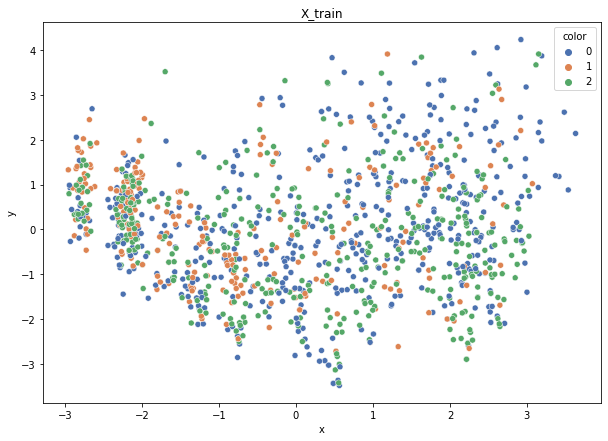

Class cardinalities: Counter({0: 503, 2: 409, 1: 266})
Weights: {0: 0.2426709552796112, 1: 0.45888530265279864, 2: 0.29844374206759033}
Training autoencoder...


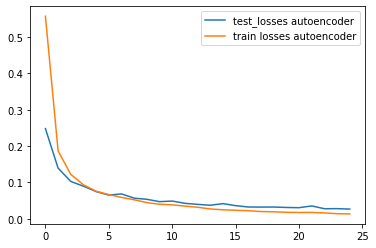

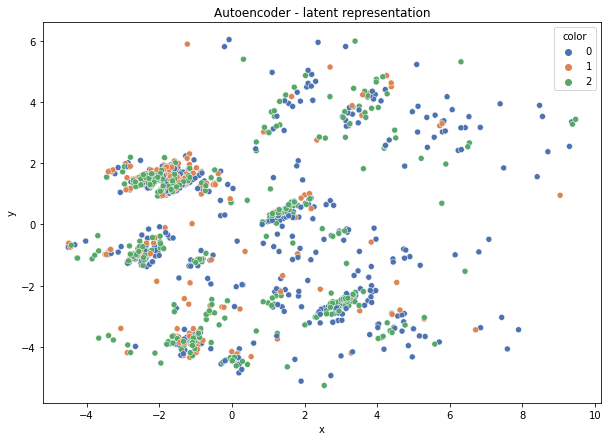

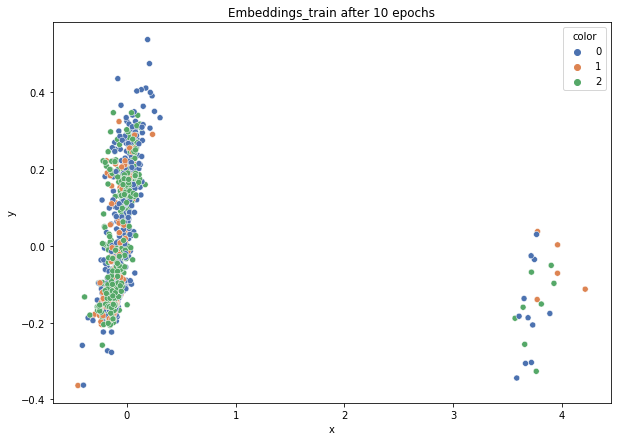

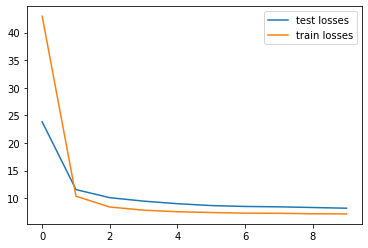

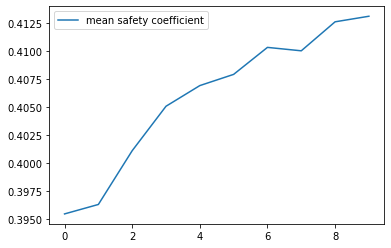

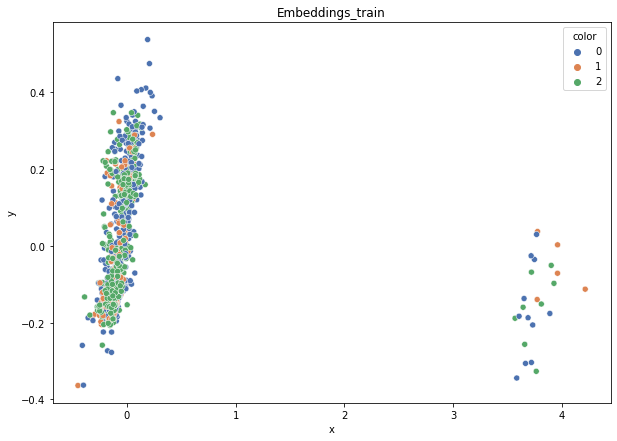

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.436
DT-f1-old+new-features: 0.502
DT-f1-old-features: 0.491
DT-gmean-new-features: 0.437
DT-gmean-old+new-features: 0.505
DT-gmean-old-features: 0.503
DT-minority_gmean-new-features: 0.007
DT-minority_gmean-old+new-features: 0.008
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.424
KNN-f1-old+new-features: 0.431
KNN-f1-old-features: 0.443
KNN-gmean-new-features: 0.418
KNN-gmean-old+new-features: 0.42
KNN-gmean-old-features: 0.433
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007


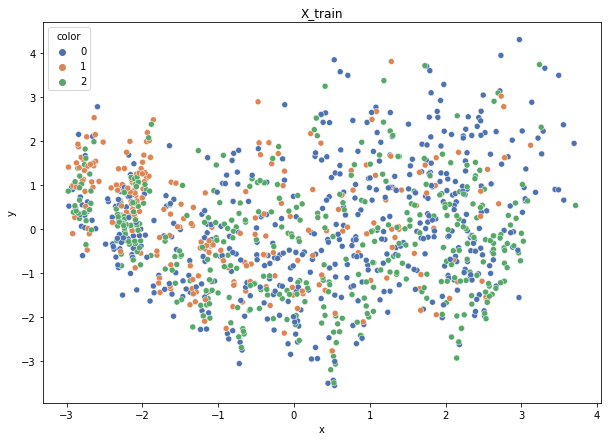

Class cardinalities: Counter({0: 503, 2: 408, 1: 267})
Weights: {0: 0.2429107547813522, 1: 0.45761838822104933, 2: 0.29947085699759846}
Training autoencoder...


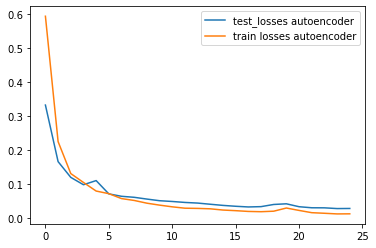

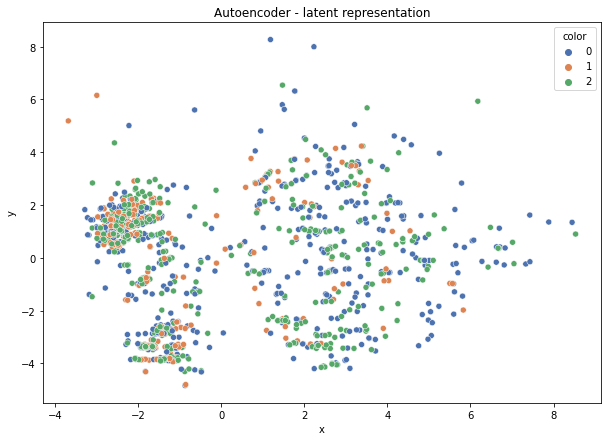

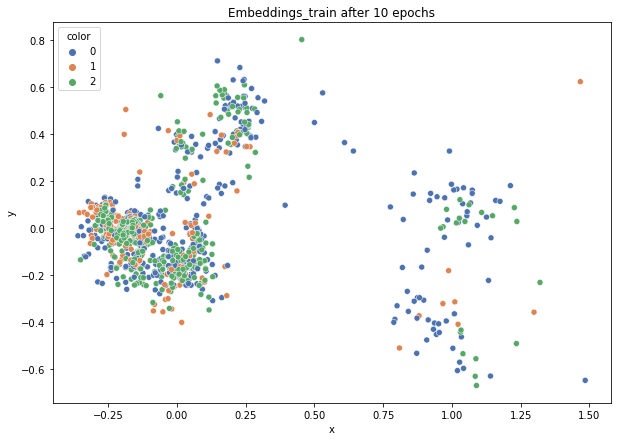

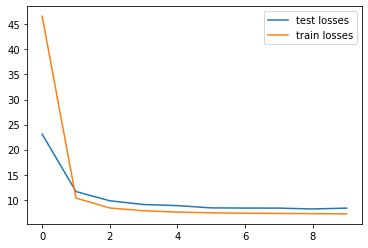

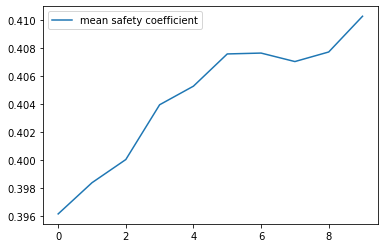

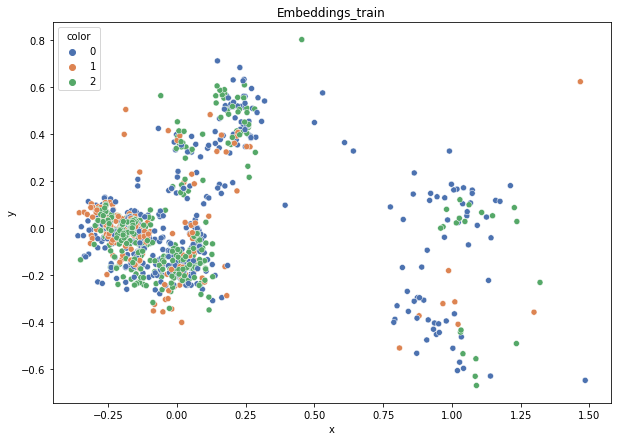

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.394
DT-f1-old+new-features: 0.498
DT-f1-old-features: 0.462
DT-gmean-new-features: 0.397
DT-gmean-old+new-features: 0.488
DT-gmean-old-features: 0.46
DT-minority_gmean-new-features: 0.007
DT-minority_gmean-old+new-features: 0.007
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.438
KNN-f1-old+new-features: 0.417
KNN-f1-old-features: 0.413
KNN-gmean-new-features: 0.44
KNN-gmean-old+new-features: 0.406
KNN-gmean-old-features: 0.399
KNN-minority_gmean-new-features: 0.008
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007


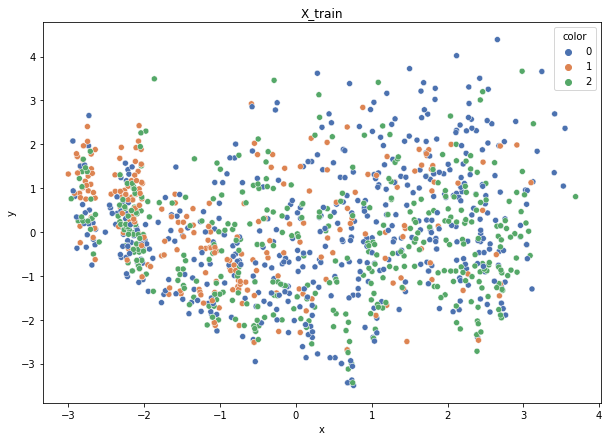

Class cardinalities: Counter({0: 503, 2: 409, 1: 267})
Weights: {0: 0.24308874498865835, 1: 0.4579537031059744, 2: 0.29895755190536716}
Training autoencoder...


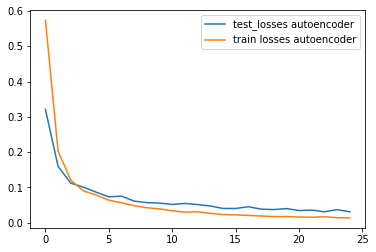

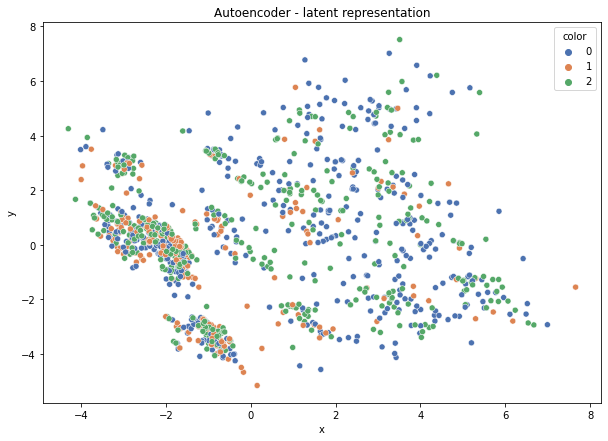

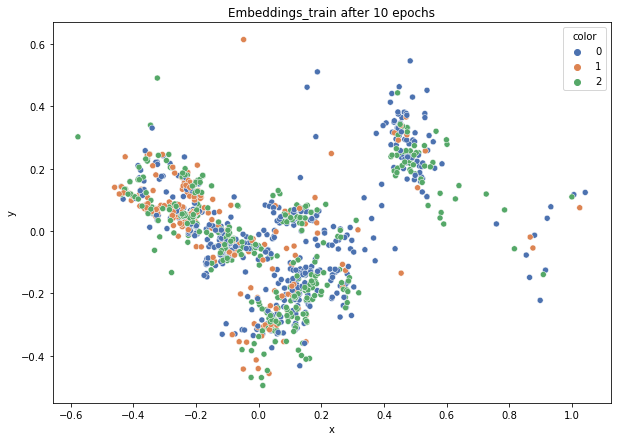

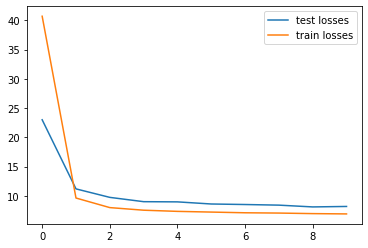

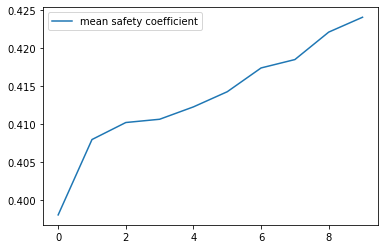

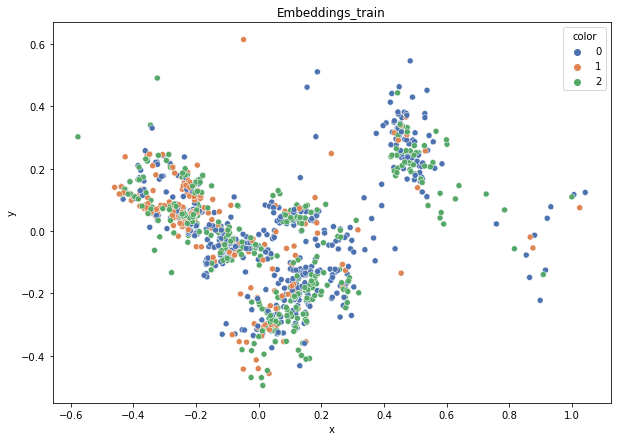

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.363
DT-f1-old+new-features: 0.459
DT-f1-old-features: 0.44
DT-gmean-new-features: 0.365
DT-gmean-old+new-features: 0.455
DT-gmean-old-features: 0.438
DT-minority_gmean-new-features: 0.007
DT-minority_gmean-old+new-features: 0.007
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.414
KNN-f1-old+new-features: 0.413
KNN-f1-old-features: 0.418
KNN-gmean-new-features: 0.409
KNN-gmean-old+new-features: 0.408
KNN-gmean-old-features: 0.413
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007


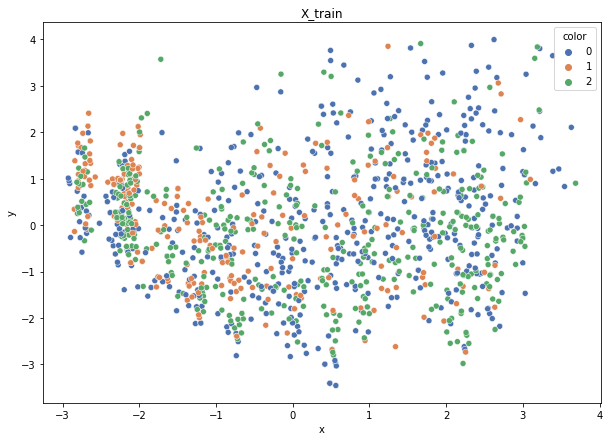

Class cardinalities: Counter({0: 504, 2: 409, 1: 266})
Weights: {0: 0.24230613326681422, 1: 0.4591063577687006, 2: 0.29858750896448505}
Training autoencoder...


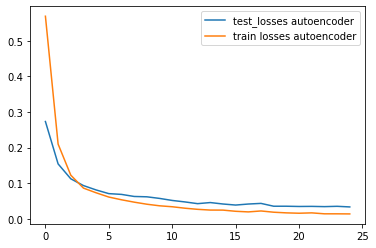

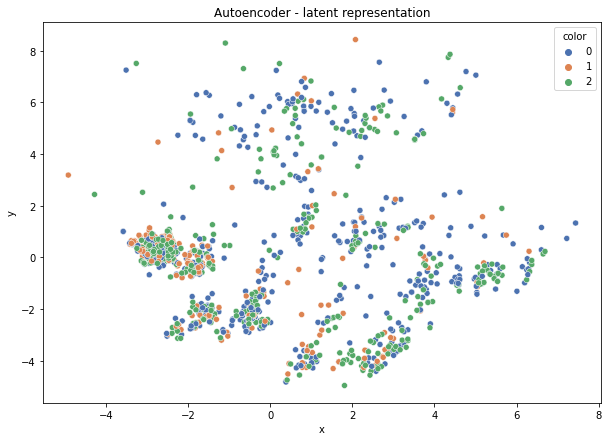

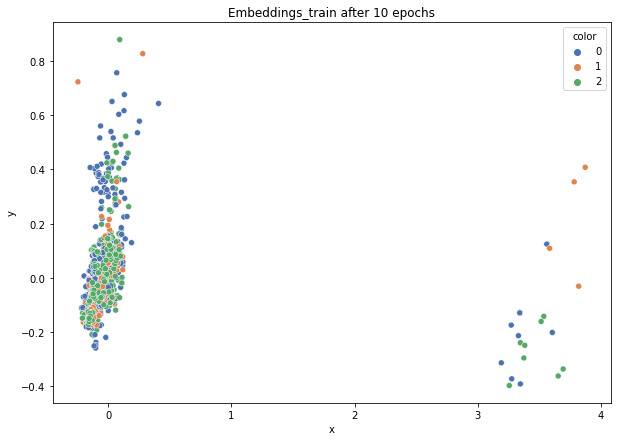

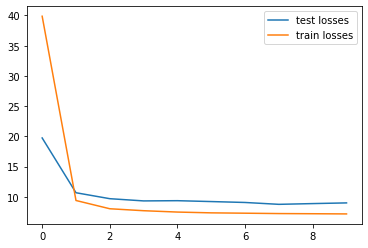

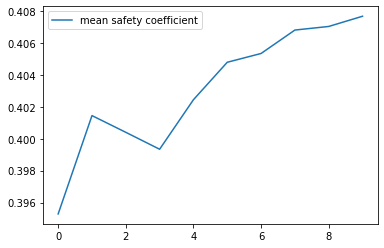

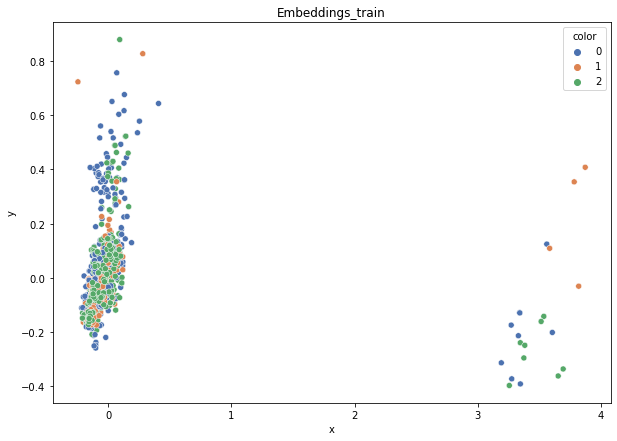

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.43
DT-f1-old+new-features: 0.455
DT-f1-old-features: 0.473
DT-gmean-new-features: 0.428
DT-gmean-old+new-features: 0.454
DT-gmean-old-features: 0.483
DT-minority_gmean-new-features: 0.007
DT-minority_gmean-old+new-features: 0.007
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.412
KNN-f1-old+new-features: 0.403
KNN-f1-old-features: 0.408
KNN-gmean-new-features: 0.404
KNN-gmean-old+new-features: 0.392
KNN-gmean-old-features: 0.394
KNN-minority_gmean-new-features: 0.007
KNN-minority_gmean-old+new-features: 0.007
KNN-minority_gmean-old-features: 0.007
dermatology


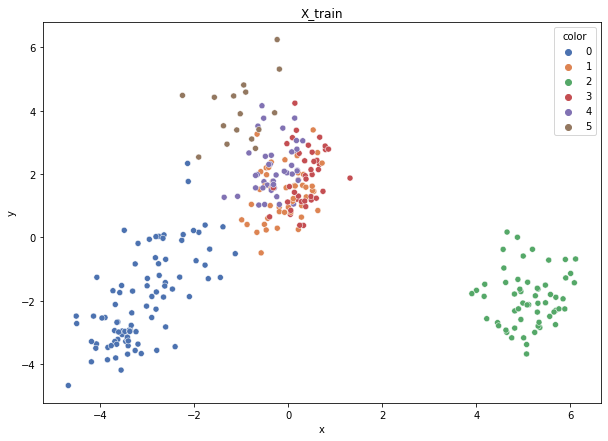

Class cardinalities: Counter({0: 90, 2: 58, 1: 48, 4: 41, 3: 39, 5: 16})
Weights: {1: 0.1288257963857323, 0: 0.0687070914057239, 2: 0.10661445218129569, 4: 0.15082044454915, 3: 0.1585548263209013, 5: 0.38647738915719687}
Training autoencoder...


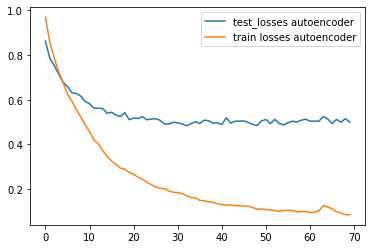

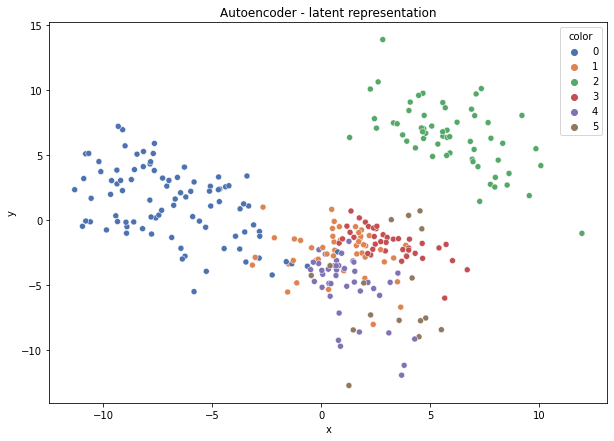

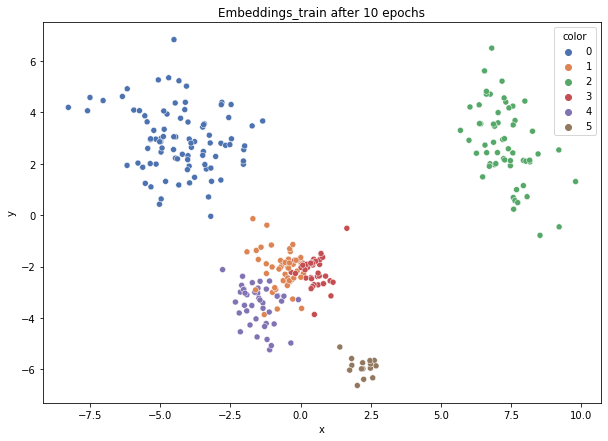

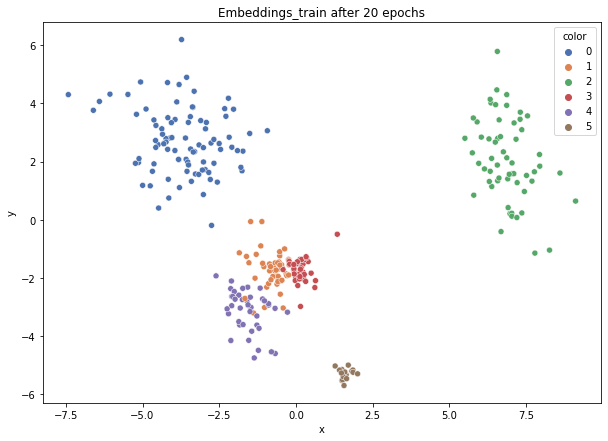

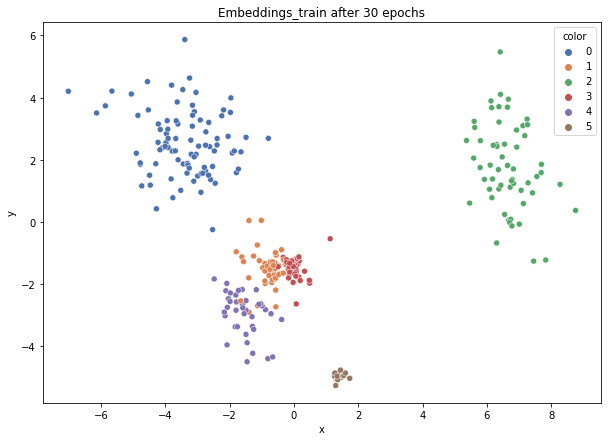

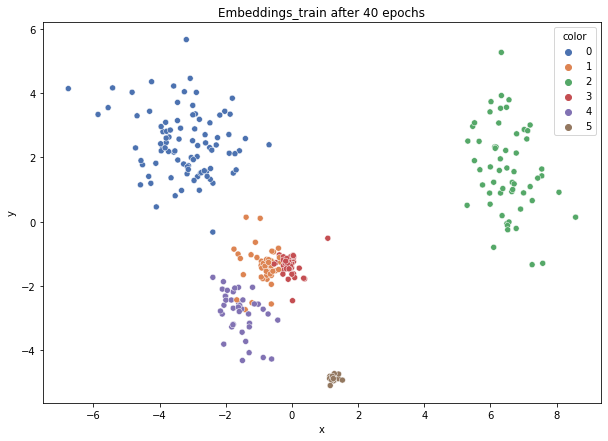

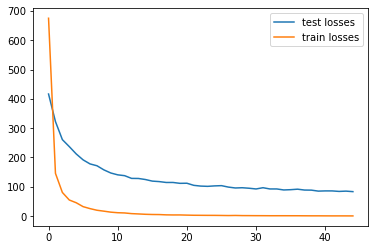

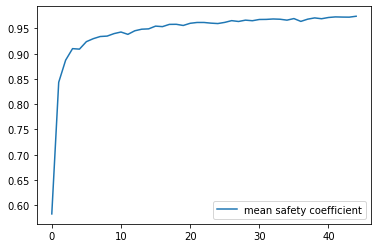

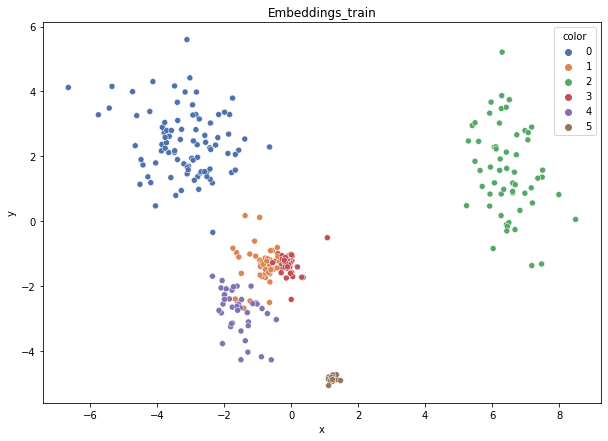

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.842
DT-f1-old+new-features: 0.885
DT-f1-old-features: 0.914
DT-gmean-new-features: 0.835
DT-gmean-old+new-features: 0.871
DT-gmean-old-features: 0.911
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 0.027
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.93
KNN-f1-old+new-features: 0.944
KNN-f1-old-features: 0.944
KNN-gmean-new-features: 0.924
KNN-gmean-old+new-features: 0.941
KNN-gmean-old-features: 0.941
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


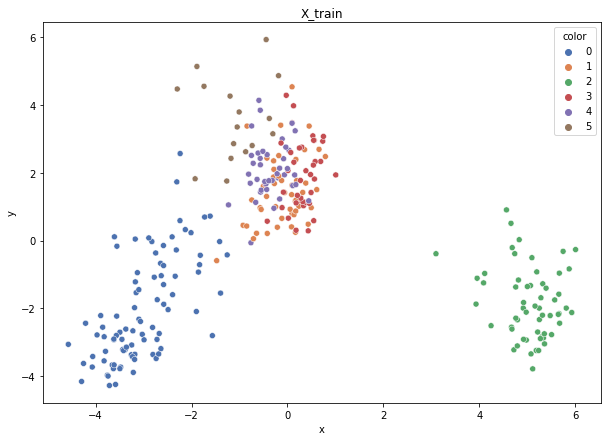

Class cardinalities: Counter({0: 89, 2: 58, 1: 49, 4: 41, 3: 40, 5: 16})
Weights: {1: 0.1269355878601628, 2: 0.10723868629565478, 0: 0.06988588545110087, 4: 0.1517035074426336, 3: 0.15549609512869944, 5: 0.3887402378217486}
Training autoencoder...


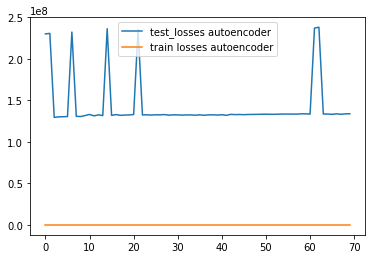

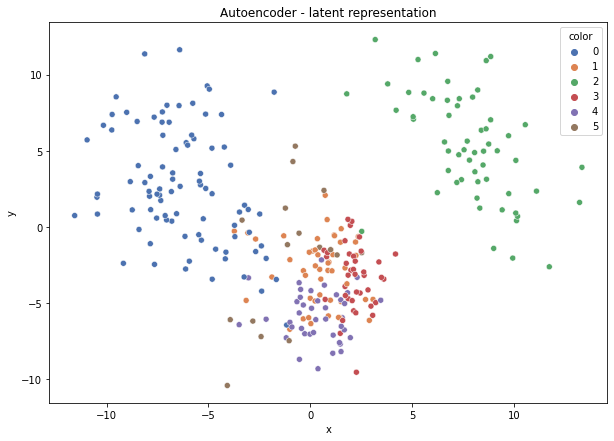

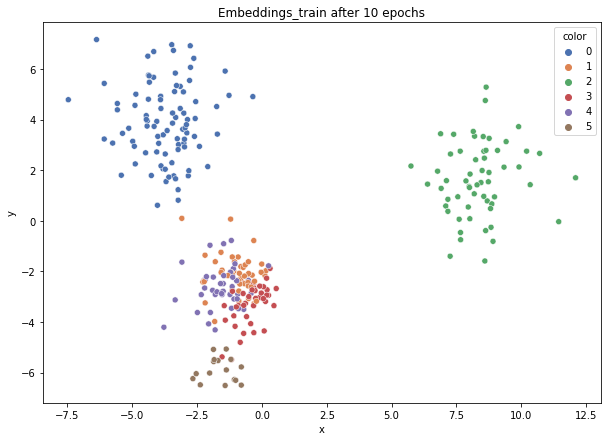

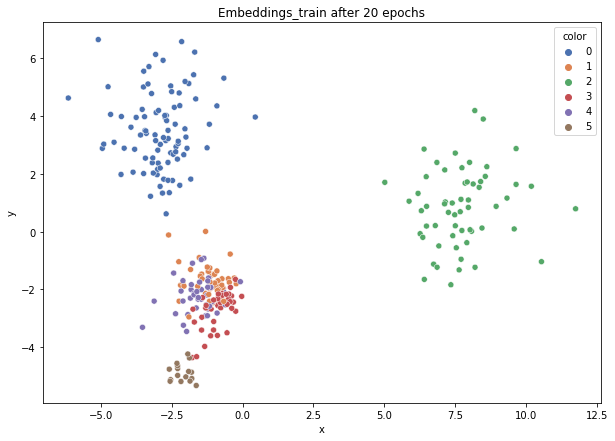

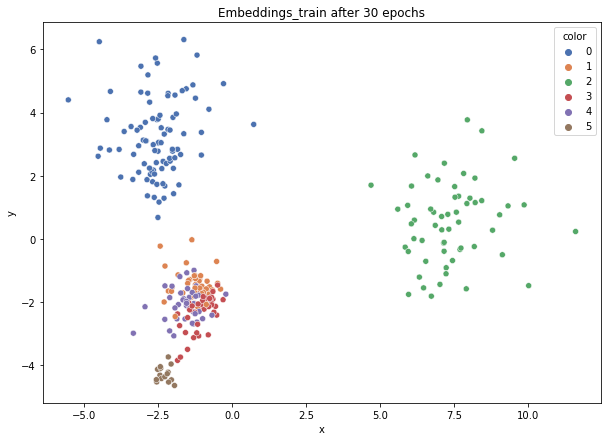

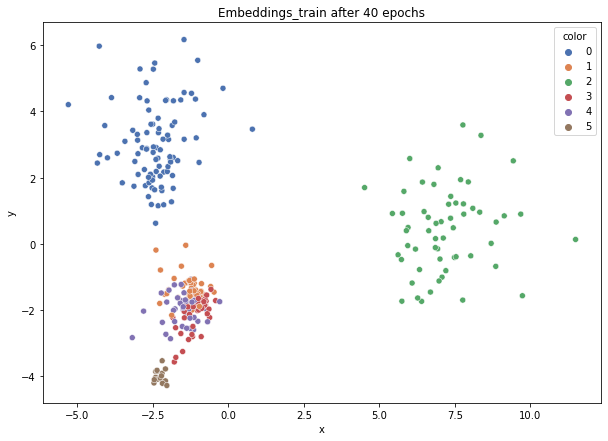

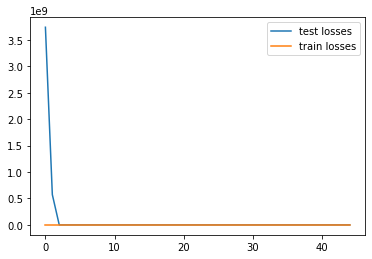

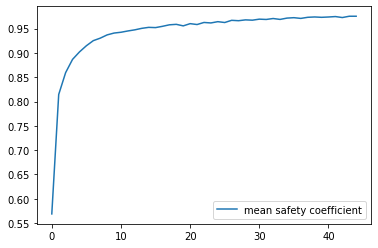

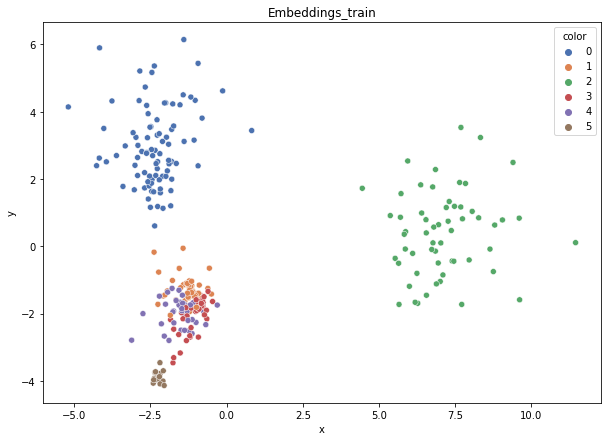

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.862
DT-f1-old+new-features: 0.877
DT-f1-old-features: 0.955
DT-gmean-new-features: 0.841
DT-gmean-old+new-features: 0.854
DT-gmean-old-features: 0.955
DT-minority_gmean-new-features: 0.027
DT-minority_gmean-old+new-features: 0.027
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.941
KNN-f1-old+new-features: 0.957
KNN-f1-old-features: 0.952
KNN-gmean-new-features: 0.934
KNN-gmean-old+new-features: 0.947
KNN-gmean-old-features: 0.951
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


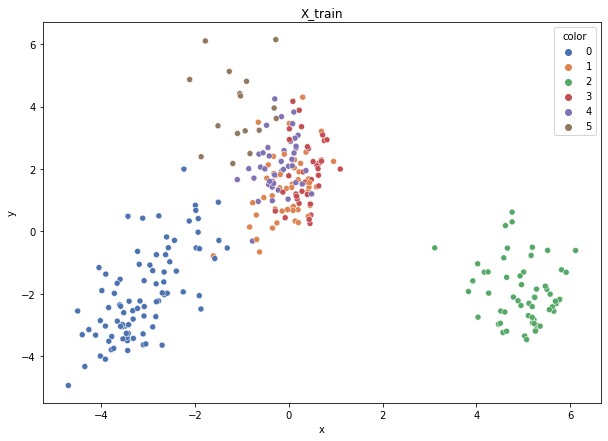

Class cardinalities: Counter({0: 89, 2: 58, 1: 49, 4: 42, 3: 39, 5: 16})
Weights: {0: 0.06985968170695418, 2: 0.10719847710205038, 4: 0.14803599218854577, 3: 0.15942337620304928, 1: 0.1268879933044678, 5: 0.38859447949493264}
Training autoencoder...


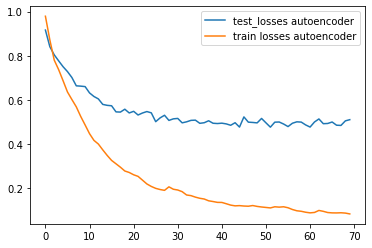

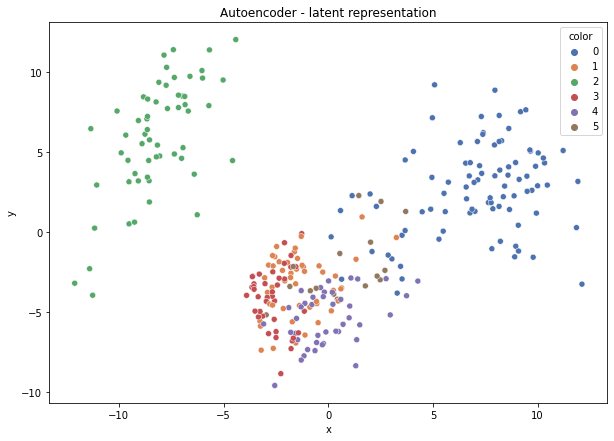

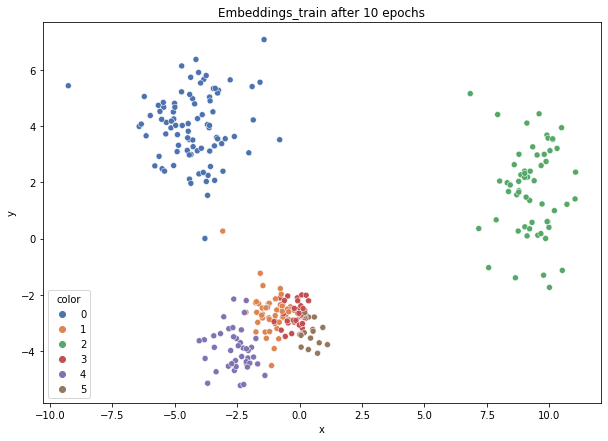

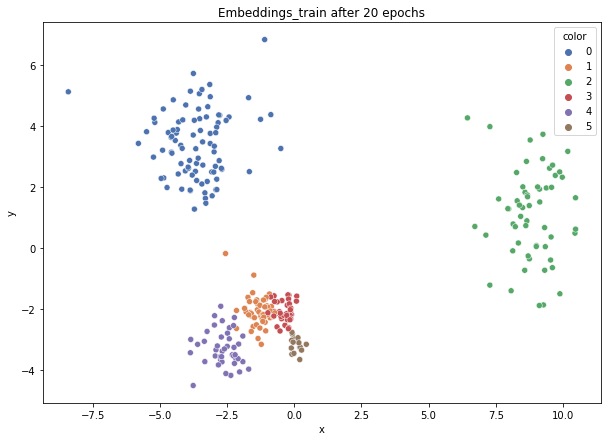

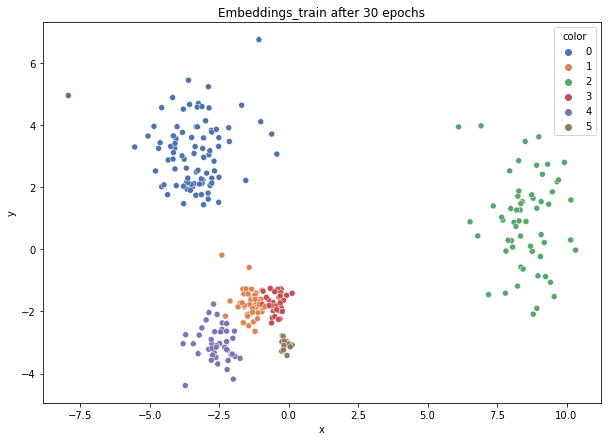

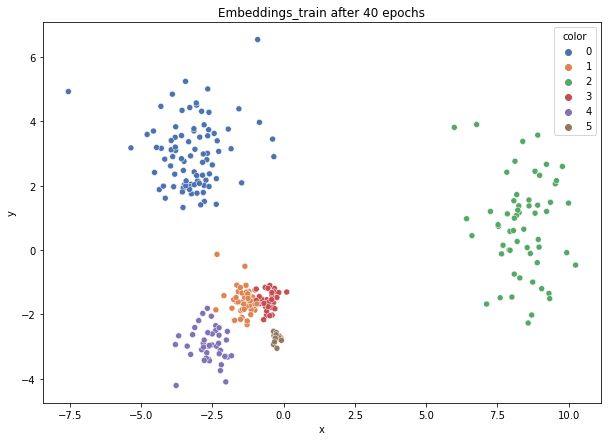

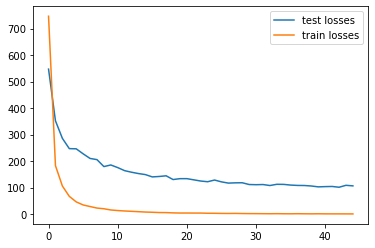

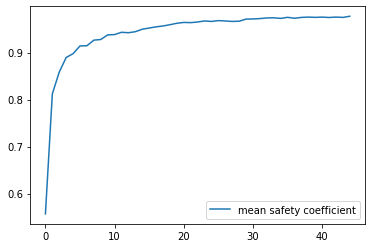

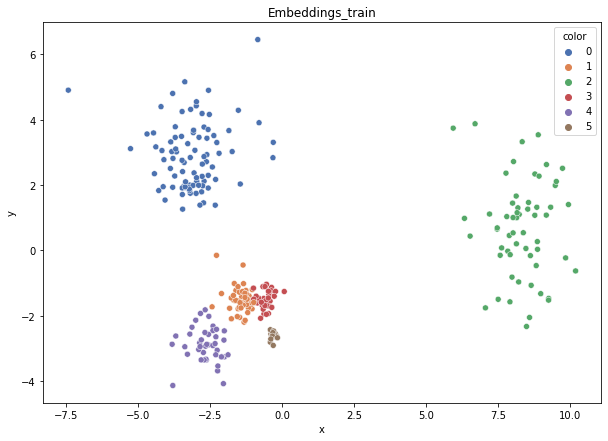

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.758
DT-f1-old+new-features: 0.887
DT-f1-old-features: 0.945
DT-gmean-new-features: 0.718
DT-gmean-old+new-features: 0.894
DT-gmean-old-features: 0.953
DT-minority_gmean-new-features: 0.027
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.927
KNN-f1-old+new-features: 0.954
KNN-f1-old-features: 0.906
KNN-gmean-new-features: 0.935
KNN-gmean-old+new-features: 0.95
KNN-gmean-old-features: 0.891
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


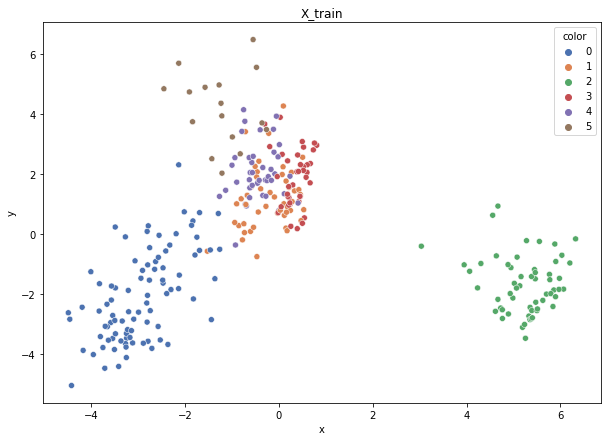

Class cardinalities: Counter({0: 90, 2: 57, 1: 49, 4: 42, 3: 39, 5: 16})
Weights: {1: 0.12674800566460384, 0: 0.06900724752850654, 2: 0.10895881188711559, 4: 0.14787267327537115, 3: 0.15924749429655355, 5: 0.3881657673478493}
Training autoencoder...


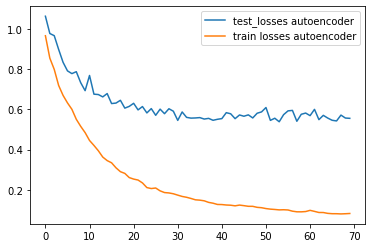

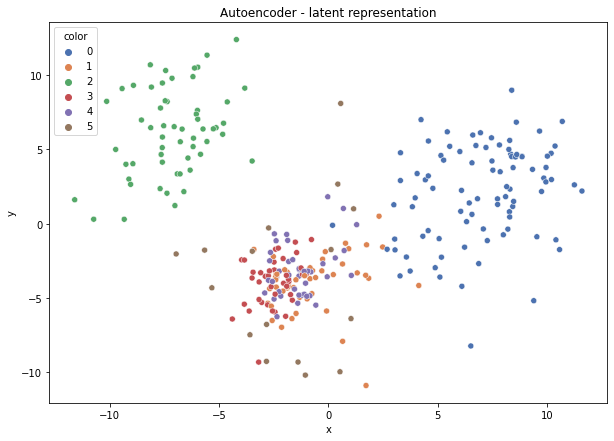

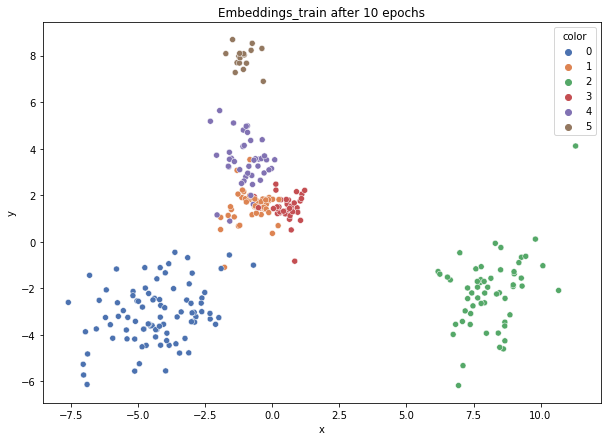

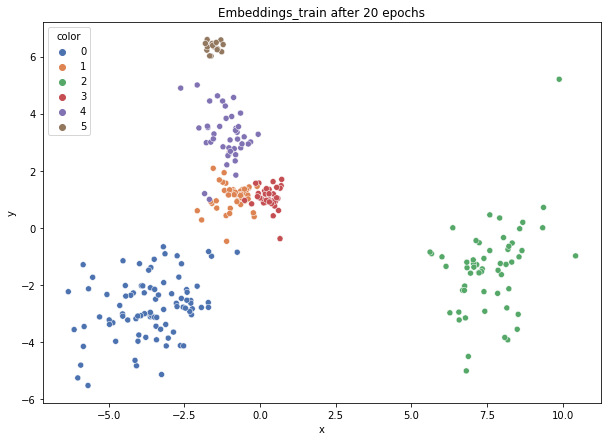

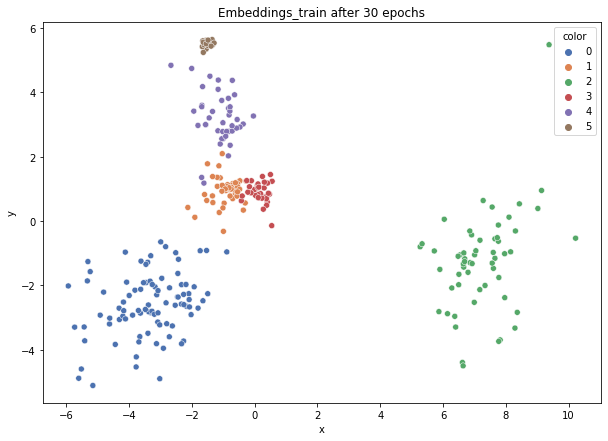

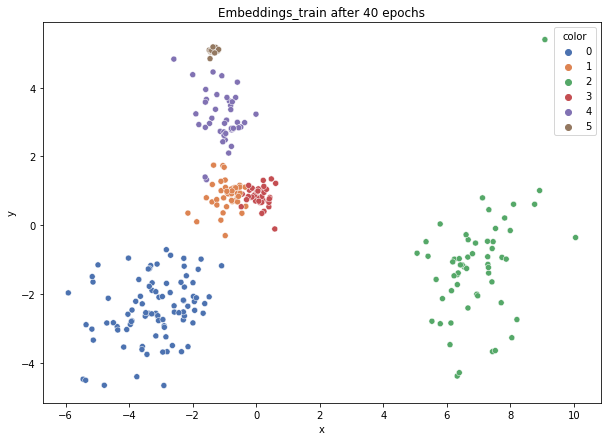

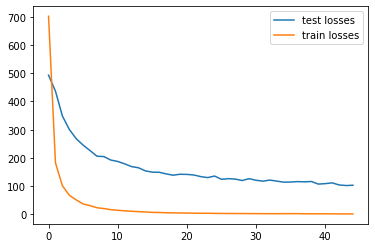

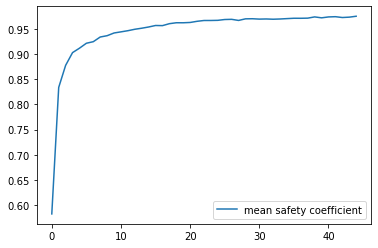

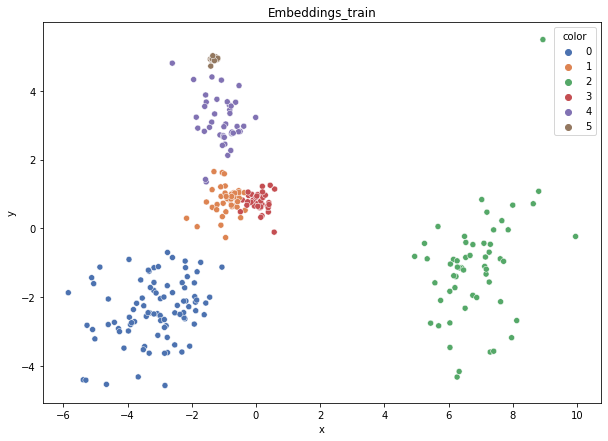

DT-f1-new-features: 0.907
DT-f1-old+new-features: 0.933
DT-f1-old-features: 0.946
DT-gmean-new-features: 0.912
DT-gmean-old+new-features: 0.935
DT-gmean-old-features: 0.945
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.958
KNN-f1-old+new-features: 0.969
KNN-f1-old-features: 0.939
KNN-gmean-new-features: 0.963
KNN-gmean-old+new-features: 0.968
KNN-gmean-old-features: 0.937
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


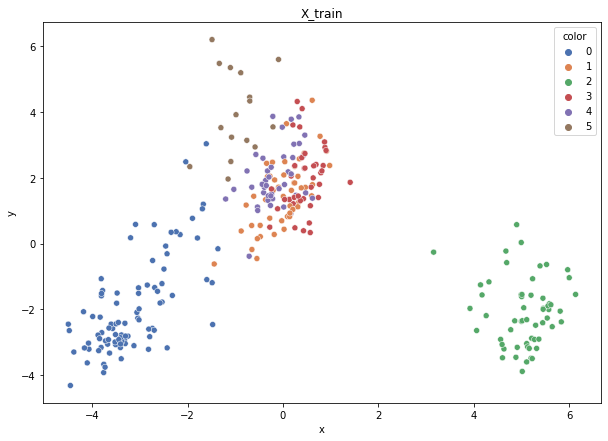

Class cardinalities: Counter({0: 90, 2: 57, 1: 49, 4: 42, 3: 39, 5: 16})
Weights: {1: 0.12674800566460384, 0: 0.06900724752850654, 2: 0.10895881188711559, 3: 0.15924749429655355, 4: 0.14787267327537115, 5: 0.3881657673478493}
Training autoencoder...


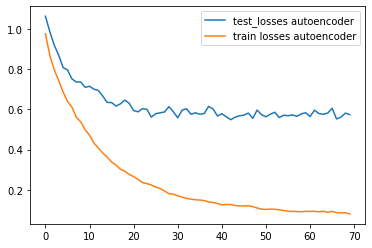

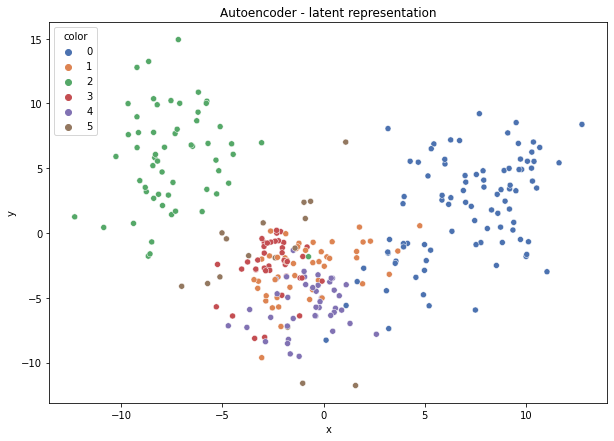

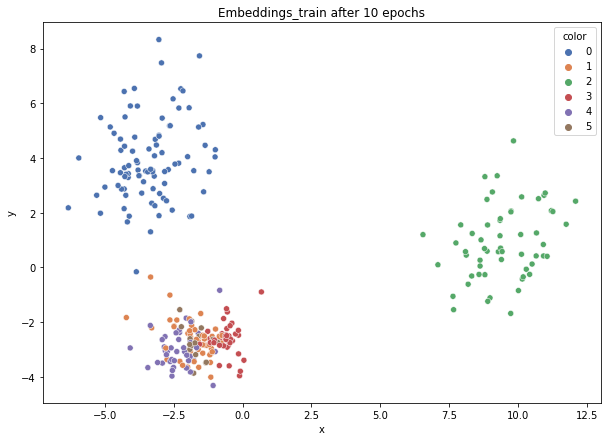

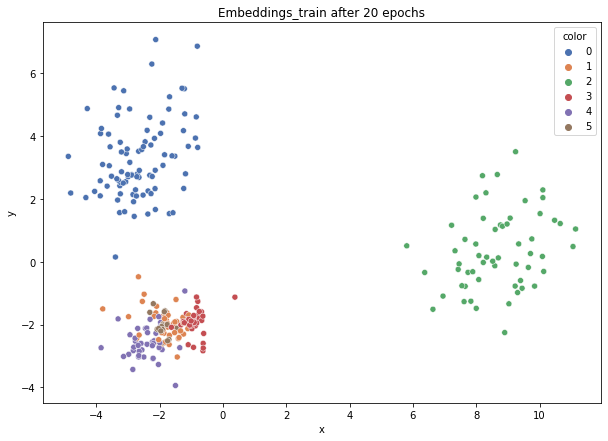

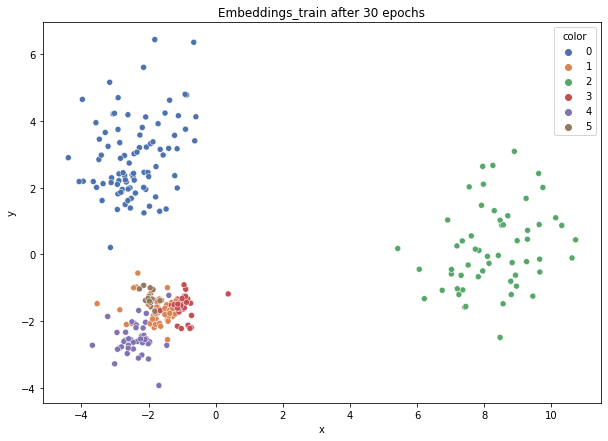

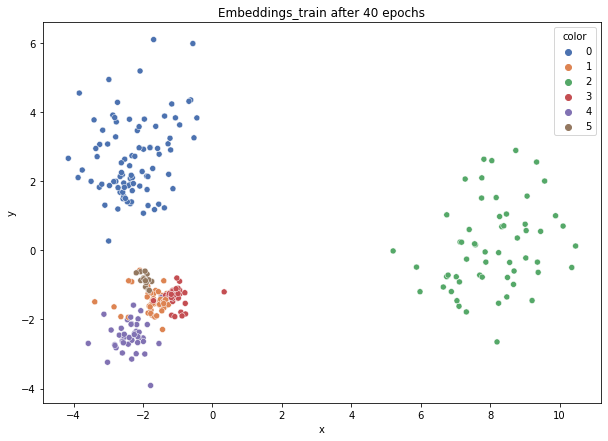

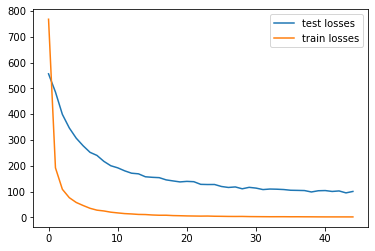

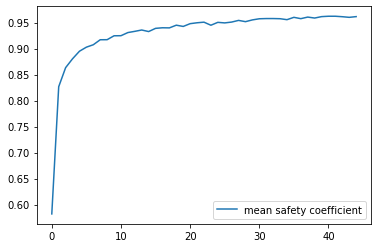

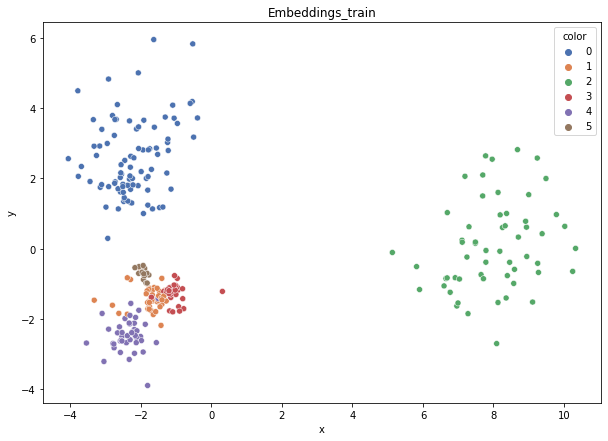

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.901
DT-f1-old+new-features: 0.915
DT-f1-old-features: 0.989
DT-gmean-new-features: 0.891
DT-gmean-old+new-features: 0.898
DT-gmean-old-features: 0.992
DT-minority_gmean-new-features: 0.027
DT-minority_gmean-old+new-features: 0.027
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.974
KNN-f1-old+new-features: 0.935
KNN-f1-old-features: 0.944
KNN-gmean-new-features: 0.978
KNN-gmean-old+new-features: 0.935
KNN-gmean-old-features: 0.942
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0
hayes-roth


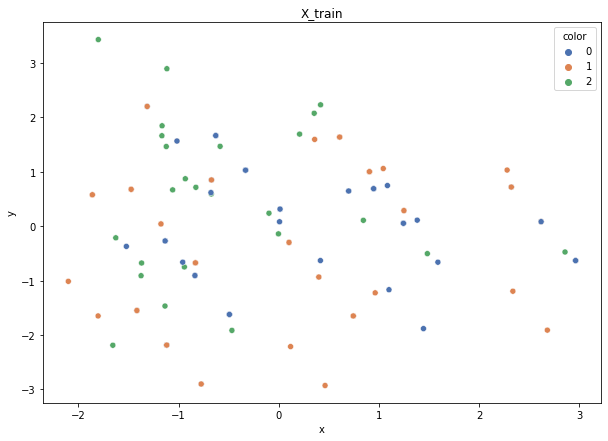

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {0: 0.243925770040176, 1: 0.24870862827625786, 2: 0.507365601683566}
Training autoencoder...


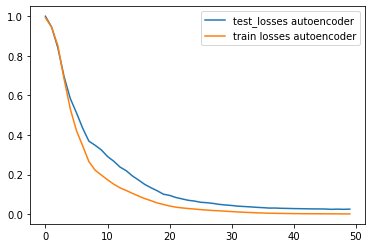

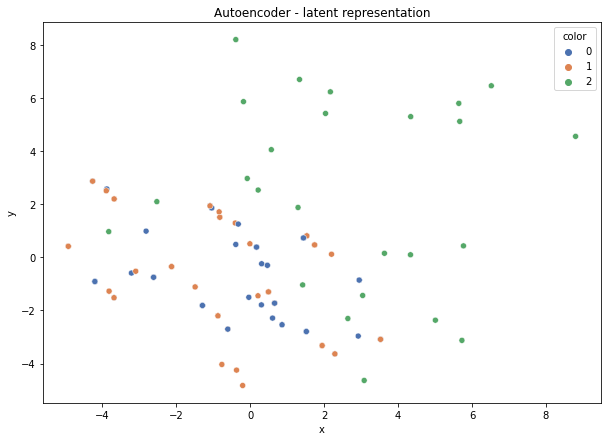

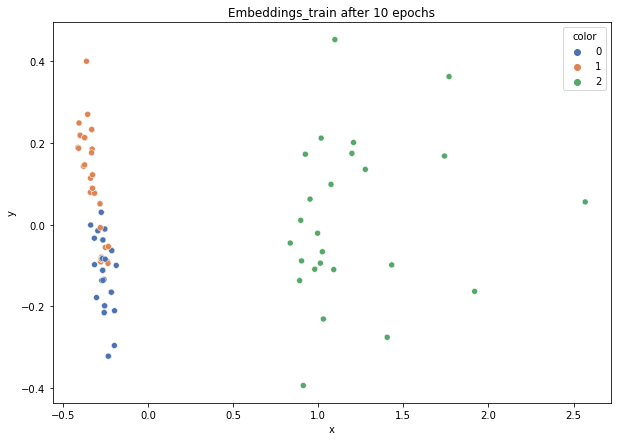

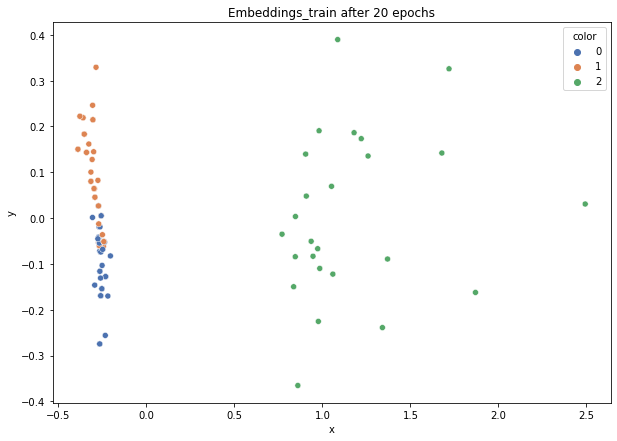

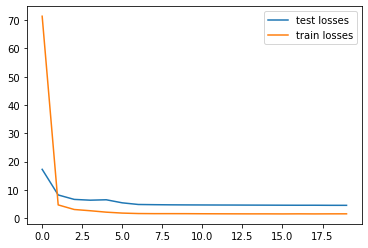

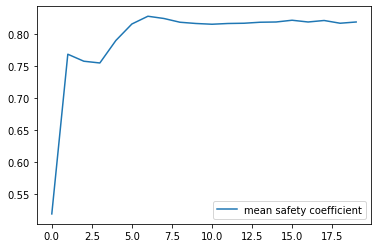

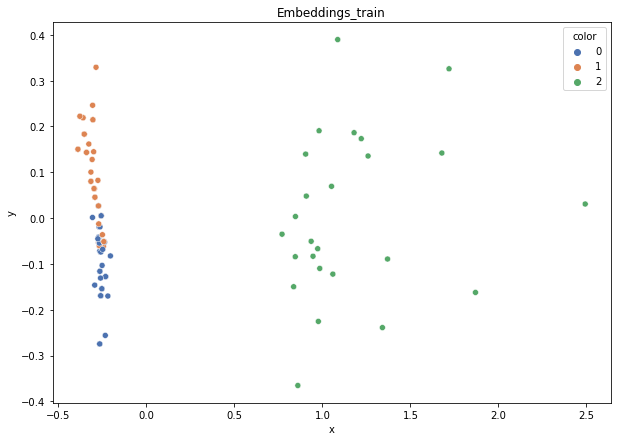

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.87
DT-f1-old+new-features: 0.87
DT-f1-old-features: 0.842
DT-gmean-new-features: 0.861
DT-gmean-old+new-features: 0.861
DT-gmean-old-features: 0.828
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.897
KNN-f1-old+new-features: 0.786
KNN-f1-old-features: 0.733
KNN-gmean-new-features: 0.895
KNN-gmean-old+new-features: 0.757
KNN-gmean-old-features: 0.688
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 0.026
KNN-minority_gmean-old-features: 0.022


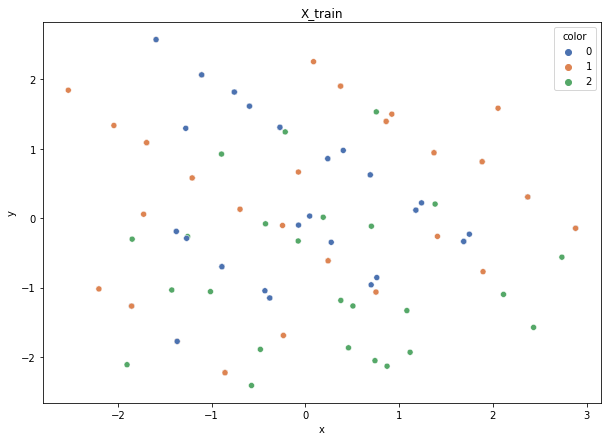

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {0: 0.243925770040176, 1: 0.24870862827625786, 2: 0.507365601683566}
Training autoencoder...


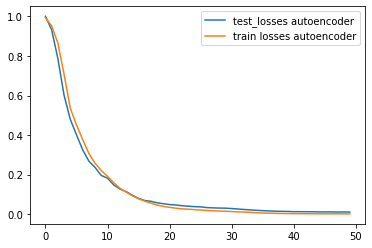

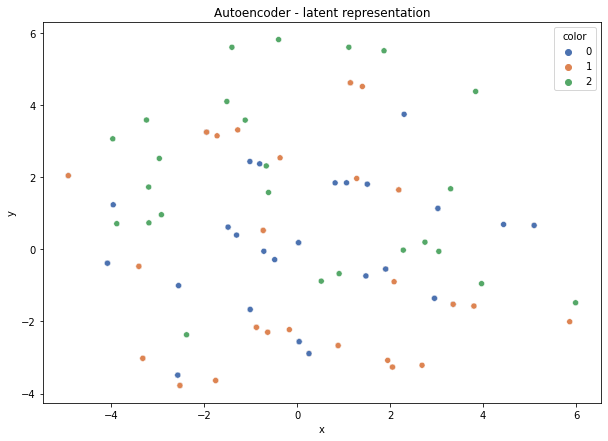

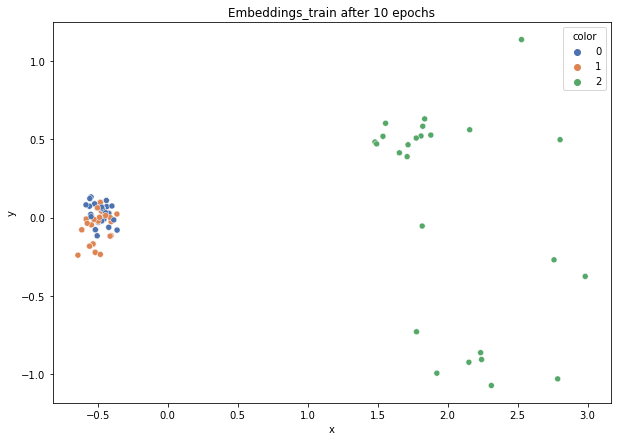

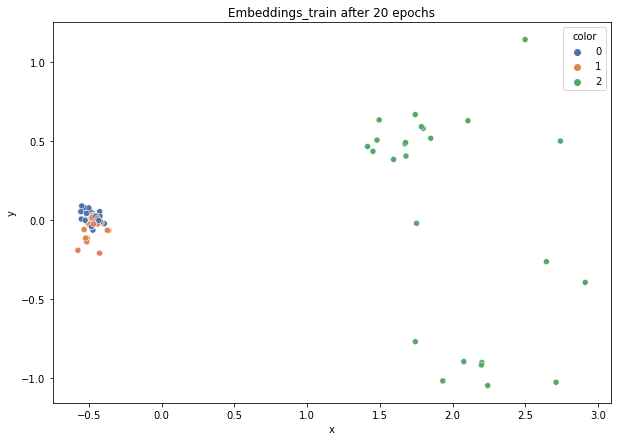

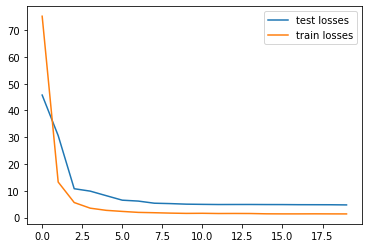

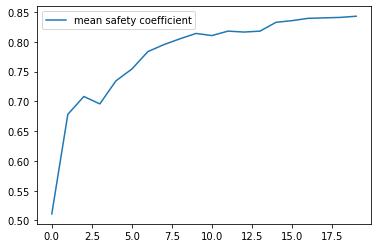

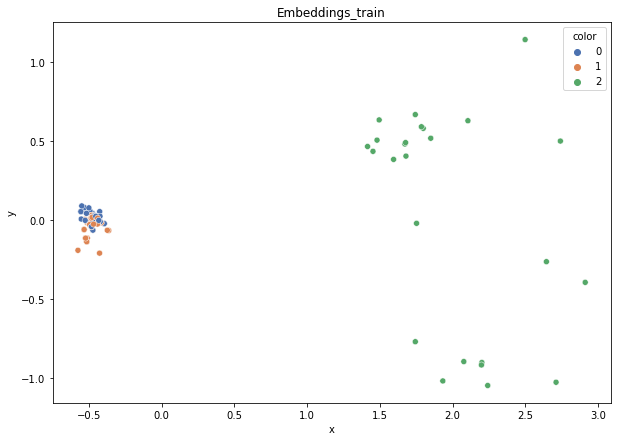

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.897
DT-f1-old+new-features: 0.897
DT-f1-old-features: 0.872
DT-gmean-new-features: 0.895
DT-gmean-old+new-features: 0.895
DT-gmean-old-features: 0.867
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.897
KNN-f1-old+new-features: 0.842
KNN-f1-old-features: 0.643
KNN-gmean-new-features: 0.892
KNN-gmean-old+new-features: 0.828
KNN-gmean-old-features: 0.619
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 0.008


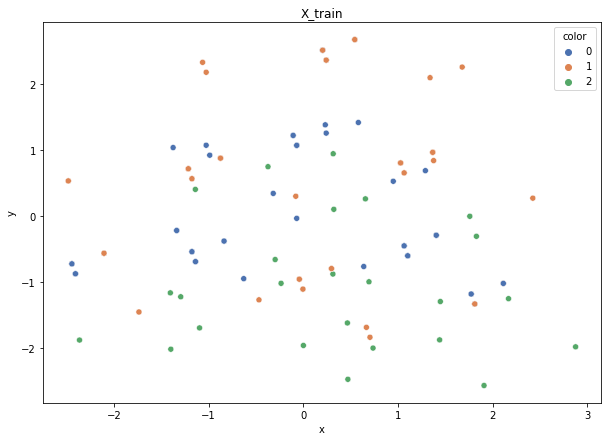

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {0: 0.243925770040176, 1: 0.24870862827625786, 2: 0.507365601683566}
Training autoencoder...


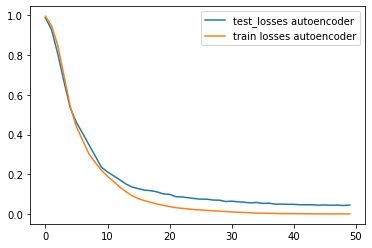

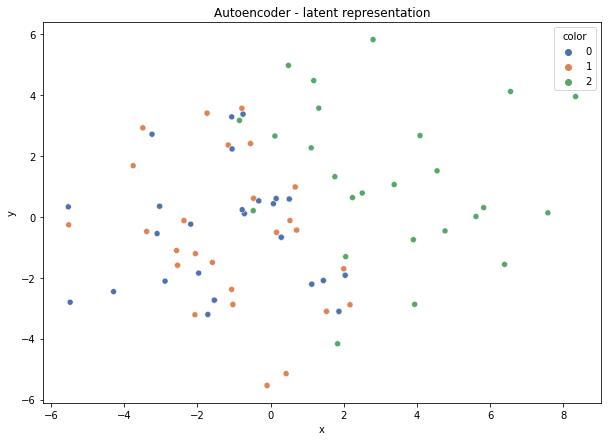

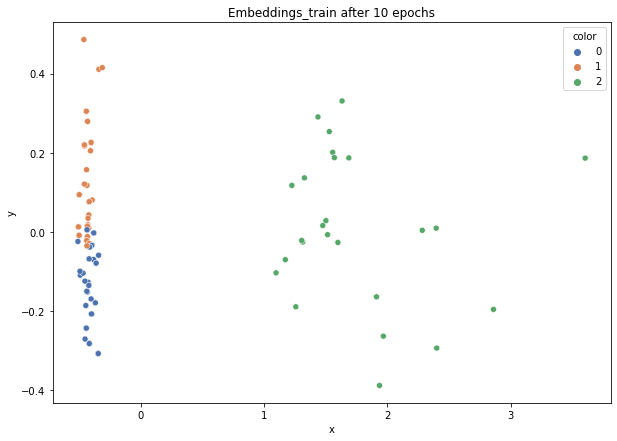

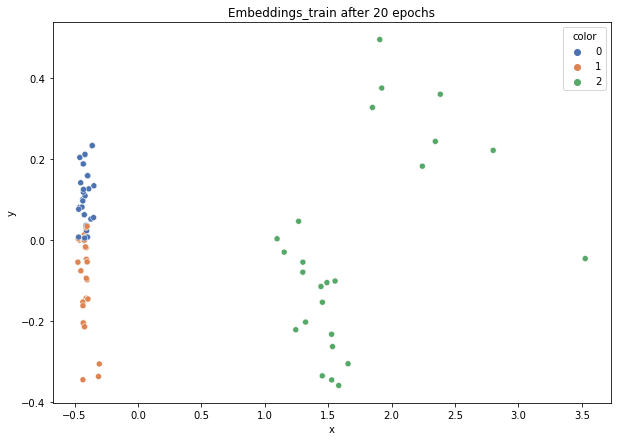

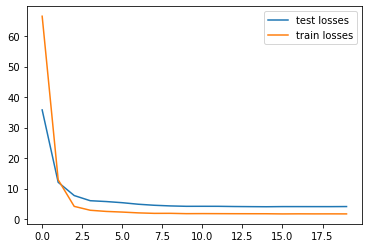

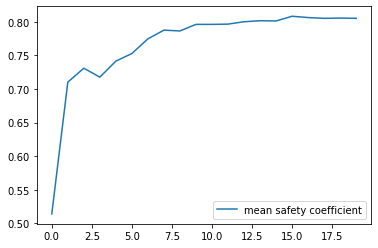

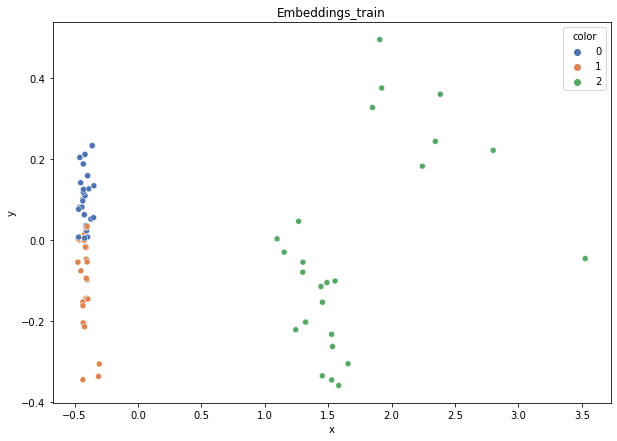

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.923
DT-f1-old+new-features: 0.923
DT-f1-old-features: 0.923
DT-gmean-new-features: 0.921
DT-gmean-old+new-features: 0.921
DT-gmean-old-features: 0.921
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.923
KNN-f1-old+new-features: 0.923
KNN-f1-old-features: 0.836
KNN-gmean-new-features: 0.921
KNN-gmean-old+new-features: 0.921
KNN-gmean-old-features: 0.805
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 0.026


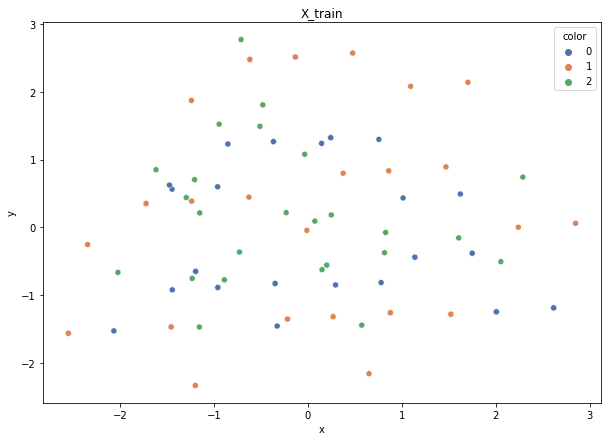

Class cardinalities: Counter({0: 52, 1: 51, 2: 25})
Weights: {1: 0.24870862827625786, 2: 0.507365601683566, 0: 0.243925770040176}
Training autoencoder...


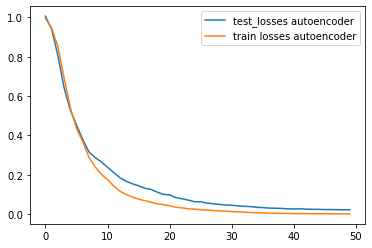

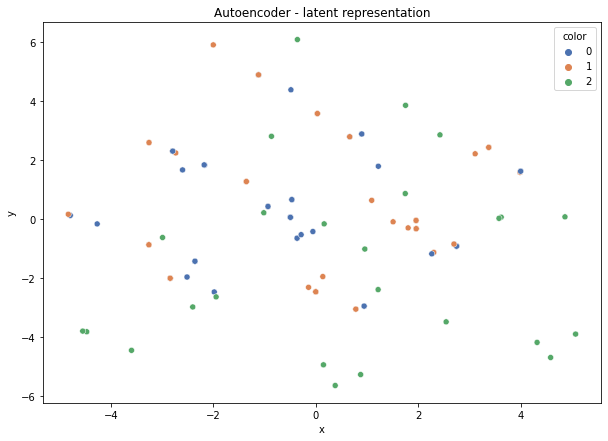

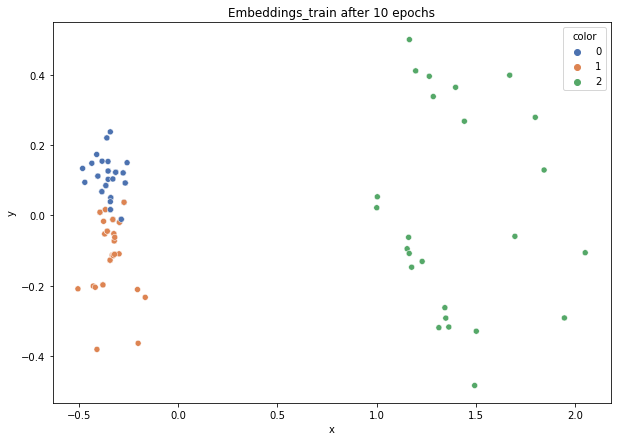

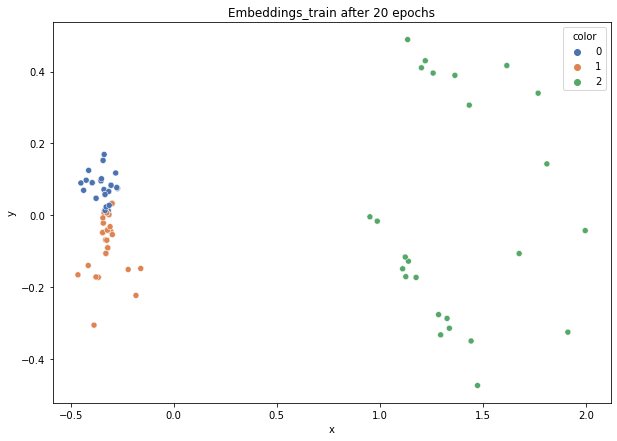

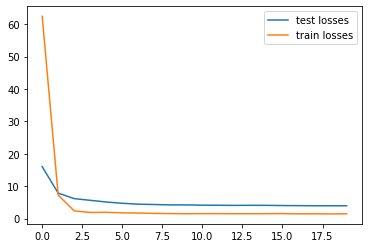

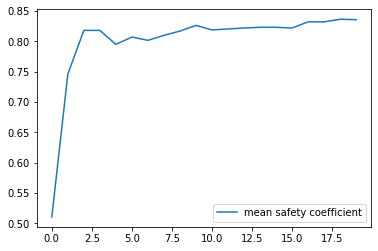

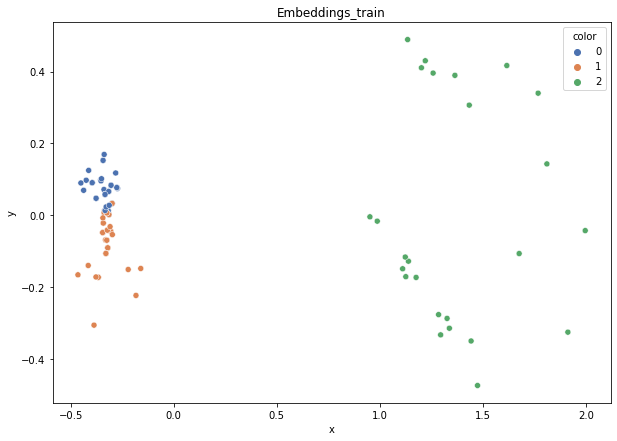

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.897
DT-f1-old+new-features: 0.897
DT-f1-old-features: 0.897
DT-gmean-new-features: 0.895
DT-gmean-old+new-features: 0.895
DT-gmean-old-features: 0.892
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.923
KNN-f1-old+new-features: 0.769
KNN-f1-old-features: 0.594
KNN-gmean-new-features: 0.921
KNN-gmean-old+new-features: 0.752
KNN-gmean-old-features: 0.54
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 0.007


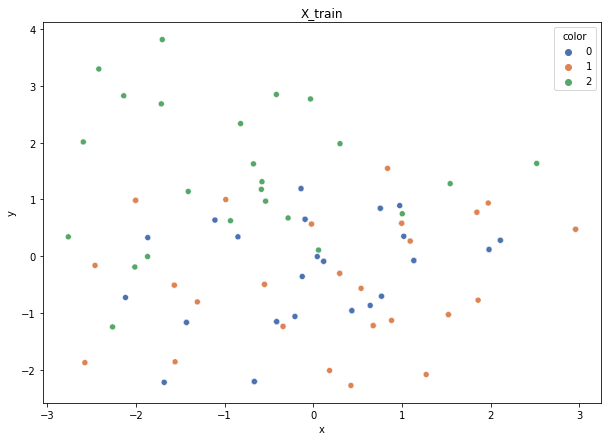

Class cardinalities: Counter({0: 52, 1: 52, 2: 24})
Weights: {0: 0.24000000000000005, 2: 0.52, 1: 0.24000000000000005}
Training autoencoder...


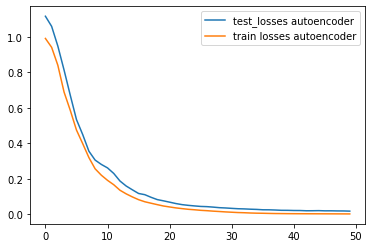

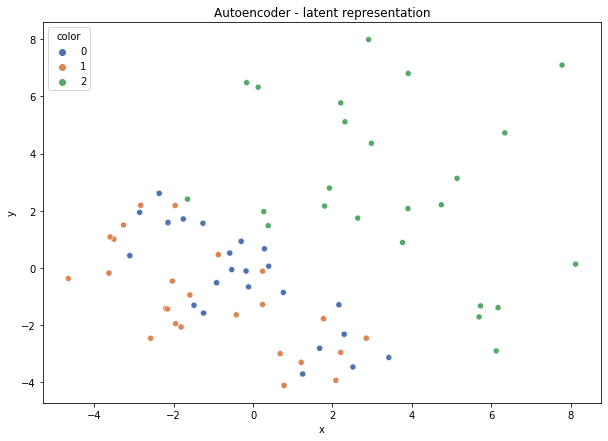

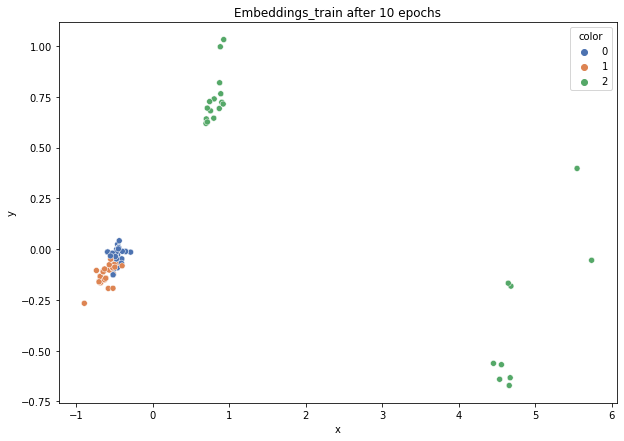

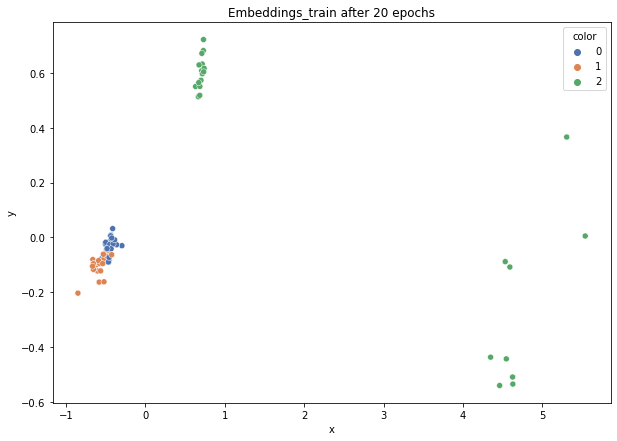

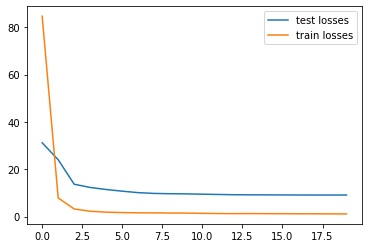

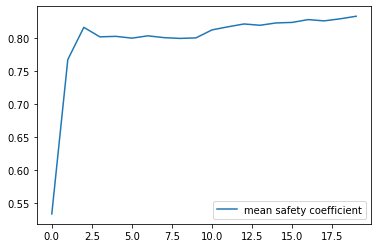

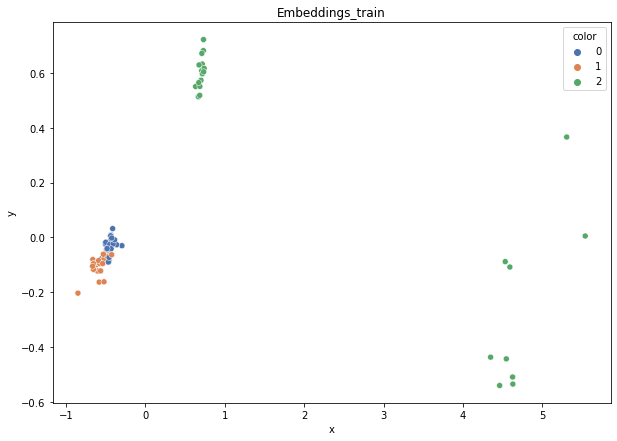

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.812
DT-f1-old+new-features: 0.812
DT-f1-old-features: 0.722
DT-gmean-new-features: 0.8
DT-gmean-old+new-features: 0.8
DT-gmean-old-features: 0.684
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 0.813
KNN-f1-old+new-features: 0.724
KNN-f1-old-features: 0.555
KNN-gmean-new-features: 0.804
KNN-gmean-old+new-features: 0.702
KNN-gmean-old-features: 0.529
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 0.029
KNN-minority_gmean-old-features: 0.008
new_vehicle


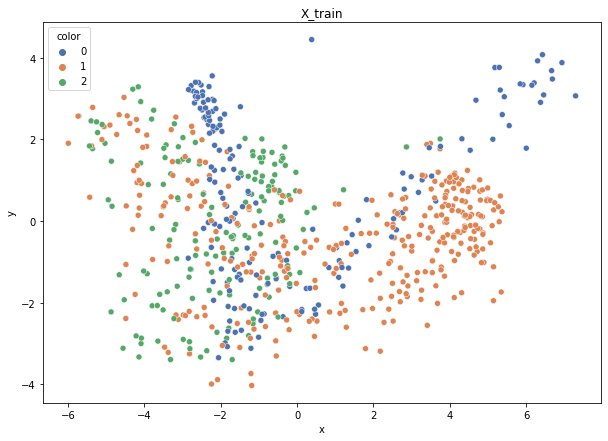

Class cardinalities: Counter({1: 343, 0: 174, 2: 159})
Weights: {2: 0.42063643091235864, 1: 0.19498889946083095, 0: 0.38437466962681044}
Training autoencoder...


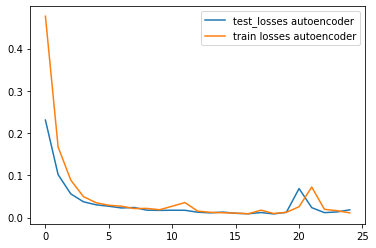

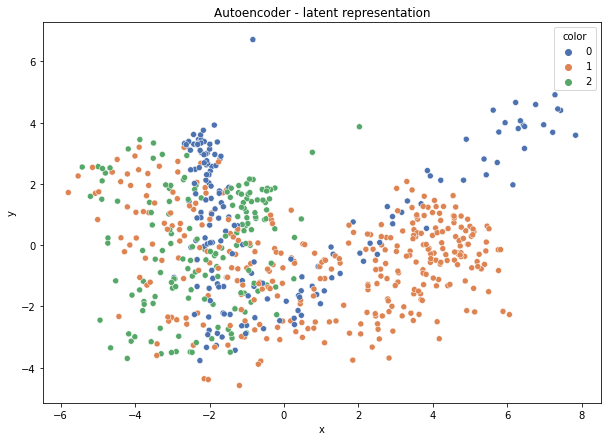

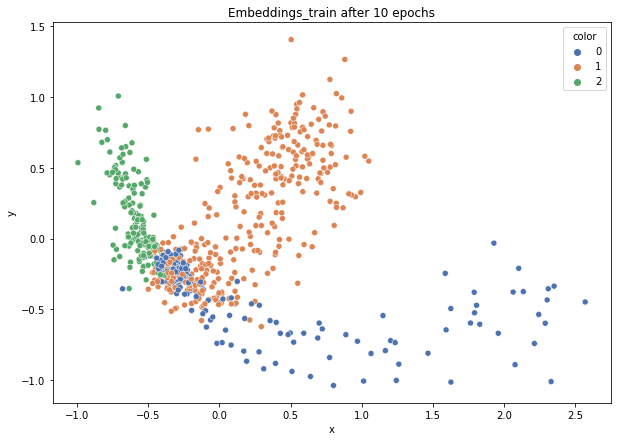

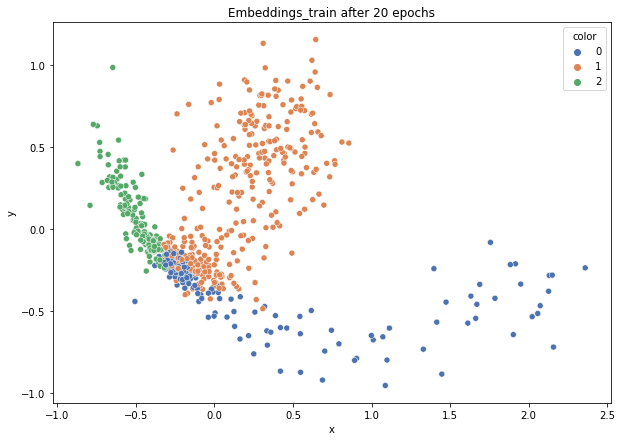

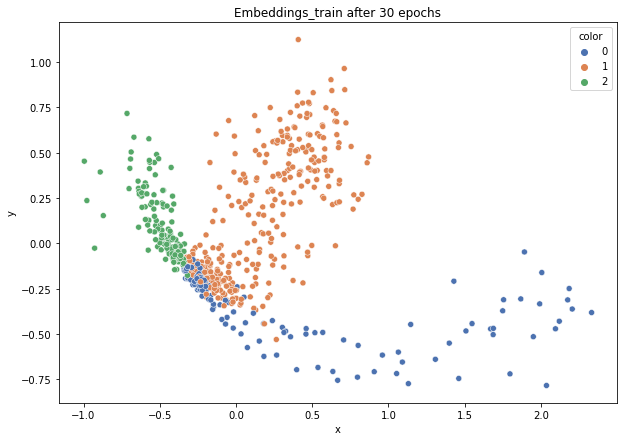

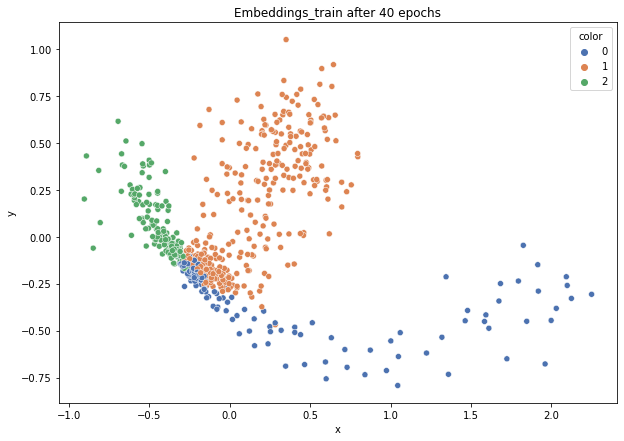

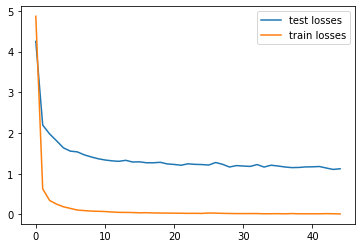

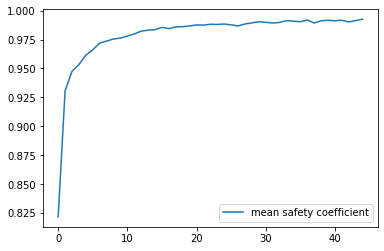

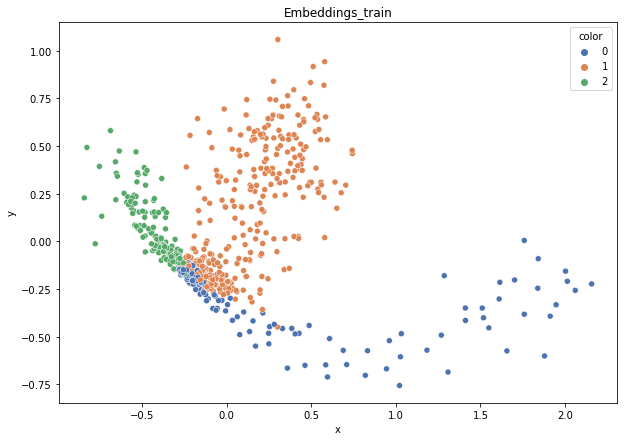

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.872
DT-f1-old+new-features: 0.883
DT-f1-old-features: 0.901
DT-gmean-new-features: 0.874
DT-gmean-old+new-features: 0.882
DT-gmean-old-features: 0.908
DT-minority_gmean-new-features: 0.09
DT-minority_gmean-old+new-features: 0.09
DT-minority_gmean-old-features: 0.094
KNN-f1-new-features: 0.932
KNN-f1-old+new-features: 0.901
KNN-f1-old-features: 0.889
KNN-gmean-new-features: 0.931
KNN-gmean-old+new-features: 0.908
KNN-gmean-old-features: 0.895
KNN-minority_gmean-new-features: 0.094
KNN-minority_gmean-old+new-features: 0.094
KNN-minority_gmean-old-features: 0.093


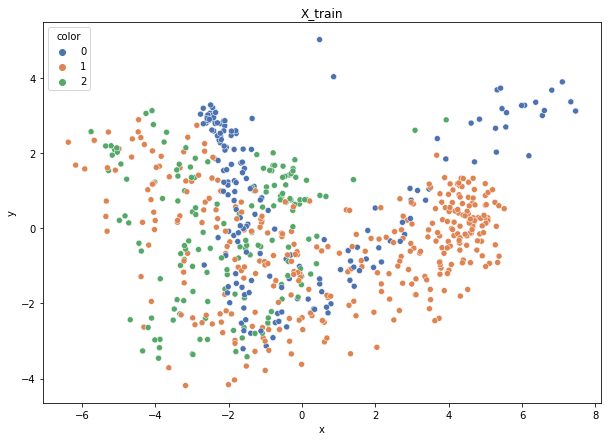

Class cardinalities: Counter({1: 343, 0: 175, 2: 159})
Weights: {2: 0.4215623617324616, 1: 0.19541812103633058, 0: 0.3830195172312079}
Training autoencoder...


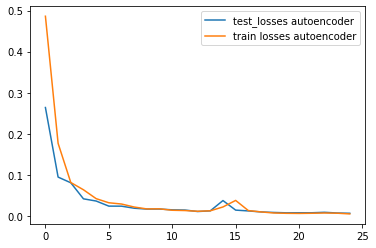

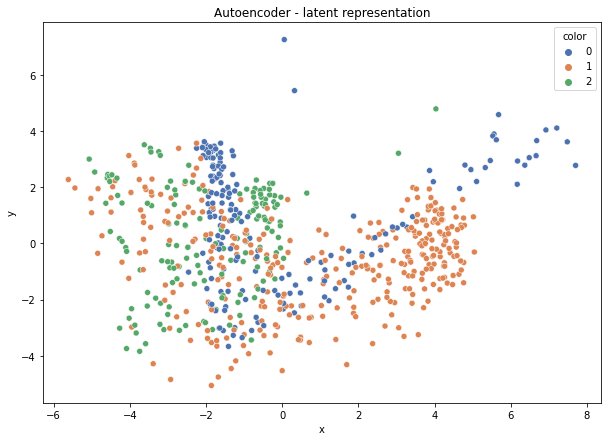

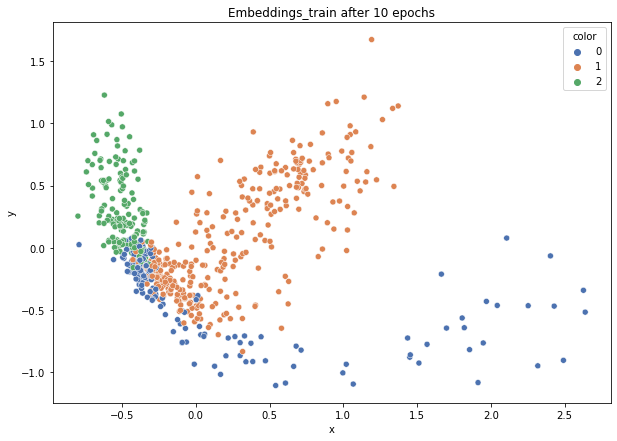

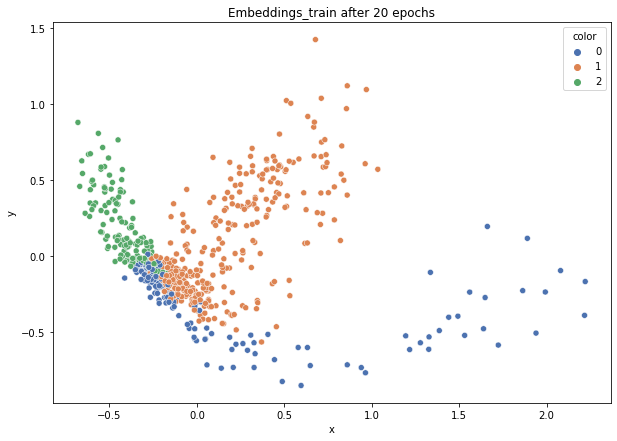

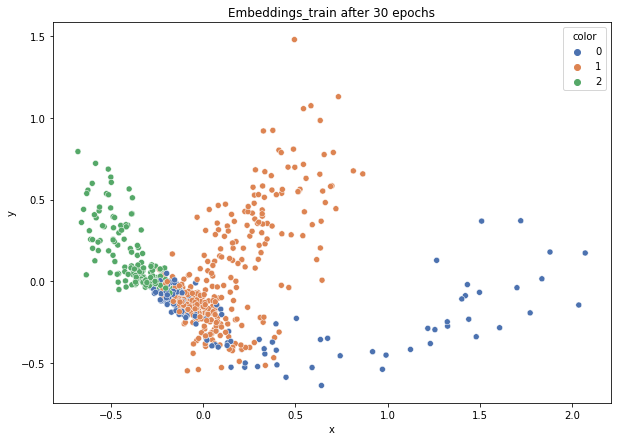

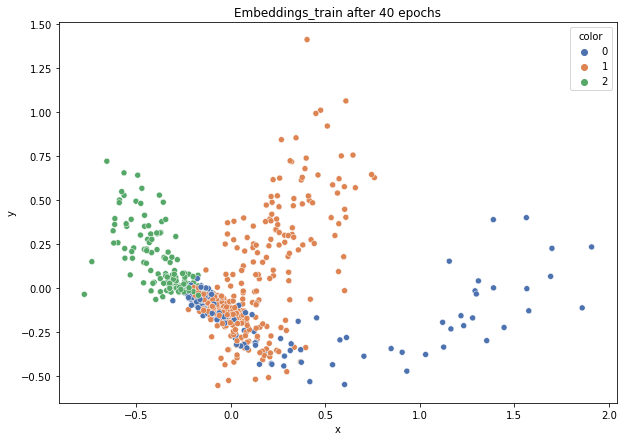

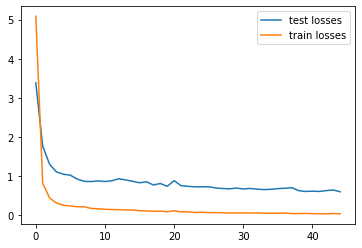

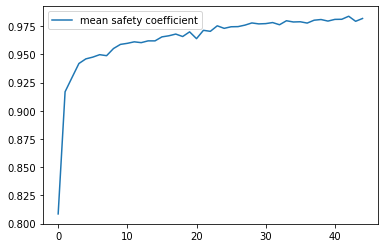

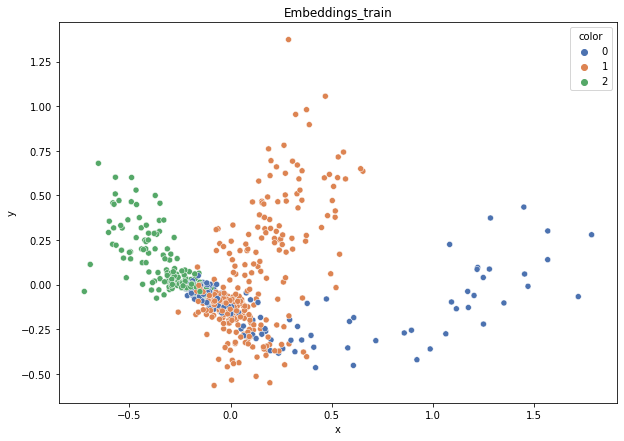

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.905
DT-f1-old+new-features: 0.919
DT-f1-old-features: 0.906
DT-gmean-new-features: 0.921
DT-gmean-old+new-features: 0.933
DT-gmean-old-features: 0.904
DT-minority_gmean-new-features: 0.096
DT-minority_gmean-old+new-features: 0.097
DT-minority_gmean-old-features: 0.093
KNN-f1-new-features: 0.986
KNN-f1-old+new-features: 0.9
KNN-f1-old-features: 0.9
KNN-gmean-new-features: 0.988
KNN-gmean-old+new-features: 0.908
KNN-gmean-old-features: 0.908
KNN-minority_gmean-new-features: 0.988
KNN-minority_gmean-old+new-features: 0.094
KNN-minority_gmean-old-features: 0.094


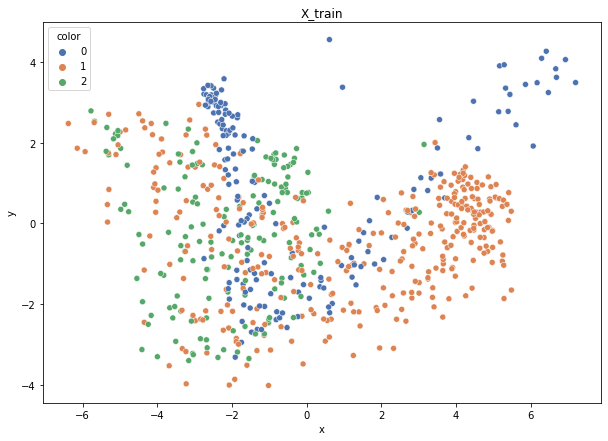

Class cardinalities: Counter({1: 343, 0: 175, 2: 159})
Weights: {2: 0.4215623617324616, 1: 0.19541812103633058, 0: 0.3830195172312079}
Training autoencoder...


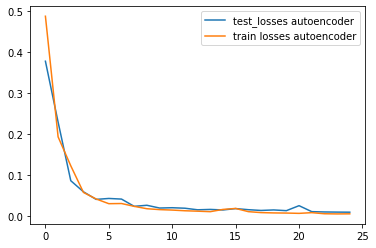

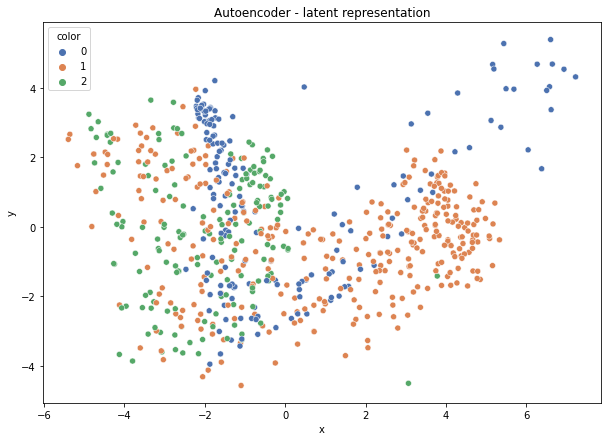

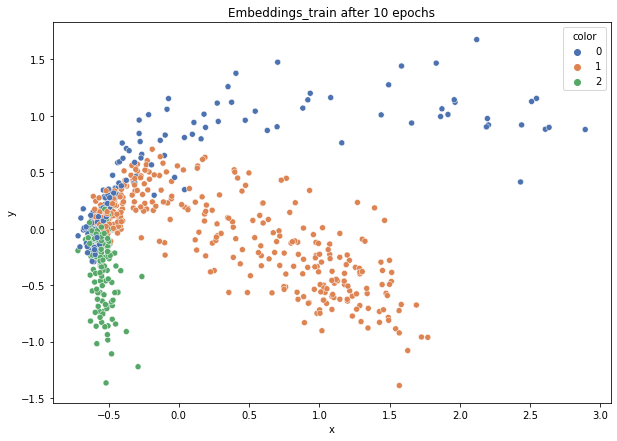

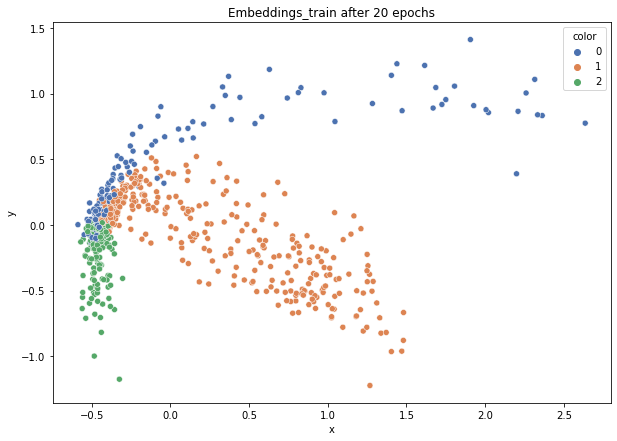

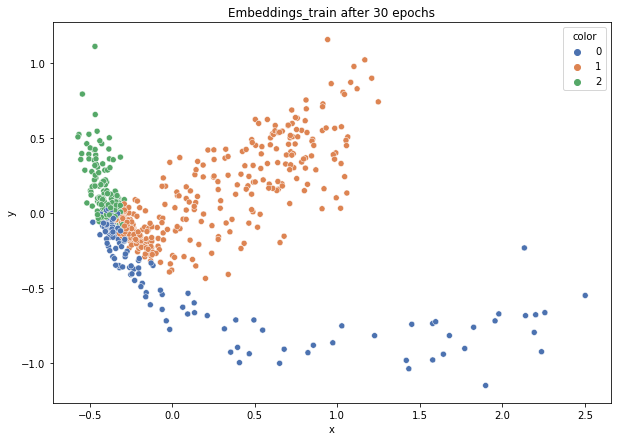

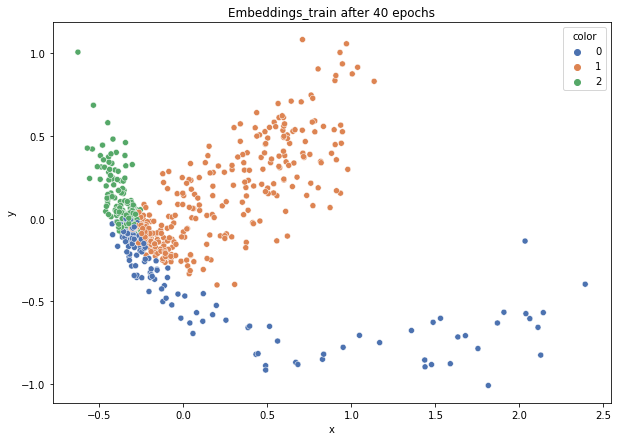

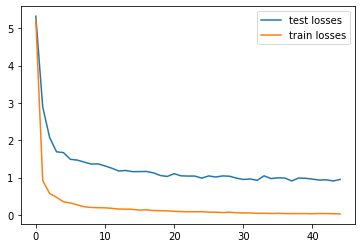

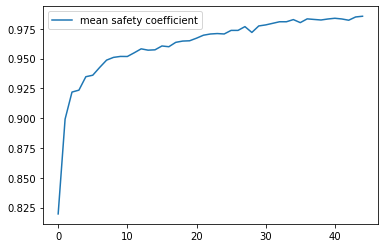

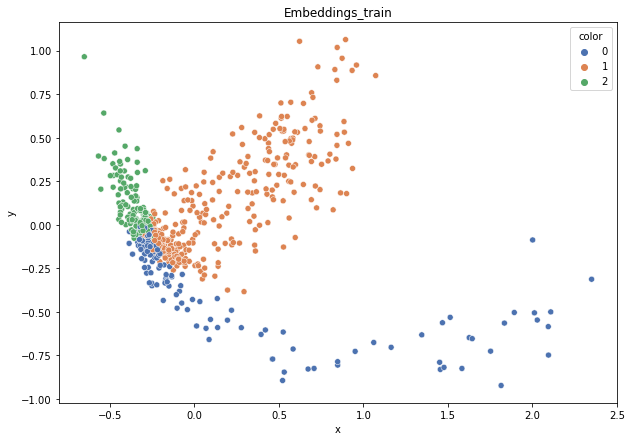

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.928
DT-f1-old+new-features: 0.945
DT-f1-old-features: 0.89
DT-gmean-new-features: 0.917
DT-gmean-old+new-features: 0.935
DT-gmean-old-features: 0.895
DT-minority_gmean-new-features: 0.092
DT-minority_gmean-old+new-features: 0.094
DT-minority_gmean-old-features: 0.093
KNN-f1-new-features: 0.982
KNN-f1-old+new-features: 0.899
KNN-f1-old-features: 0.899
KNN-gmean-new-features: 0.984
KNN-gmean-old+new-features: 0.897
KNN-gmean-old-features: 0.897
KNN-minority_gmean-new-features: 0.099
KNN-minority_gmean-old+new-features: 0.092
KNN-minority_gmean-old-features: 0.092


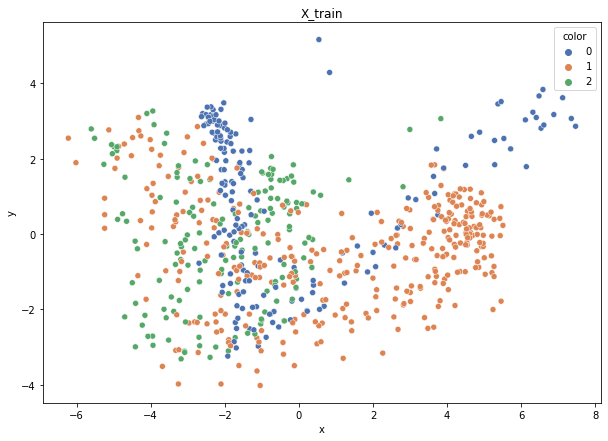

Class cardinalities: Counter({1: 344, 0: 174, 2: 159})
Weights: {2: 0.42087499472640594, 0: 0.3845926675948192, 1: 0.19453233767877484}
Training autoencoder...


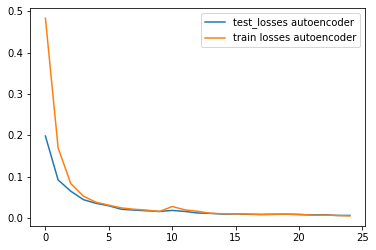

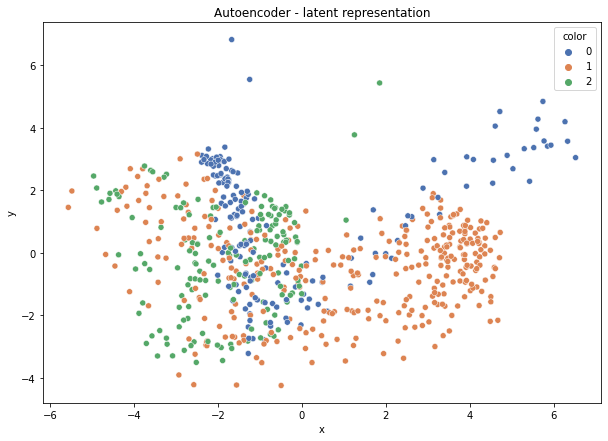

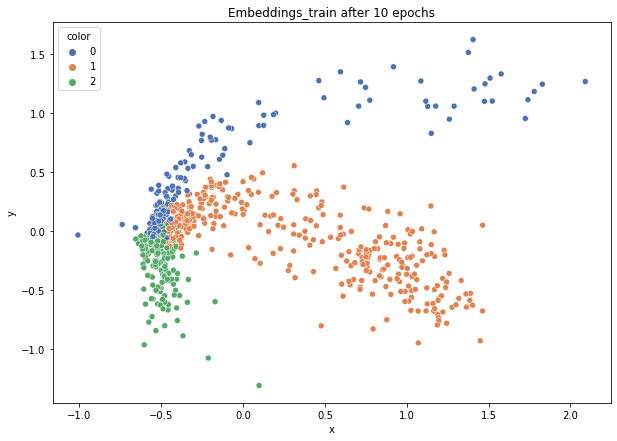

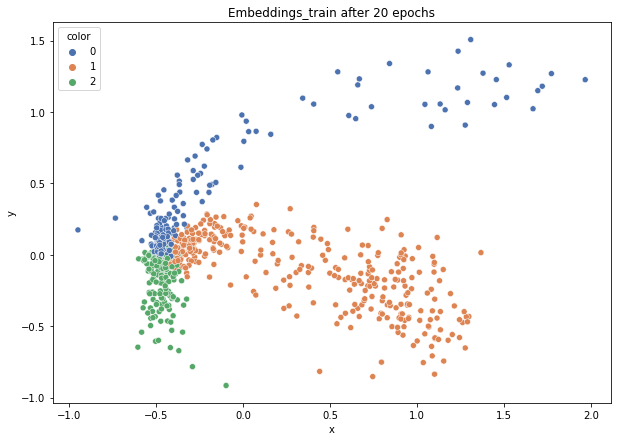

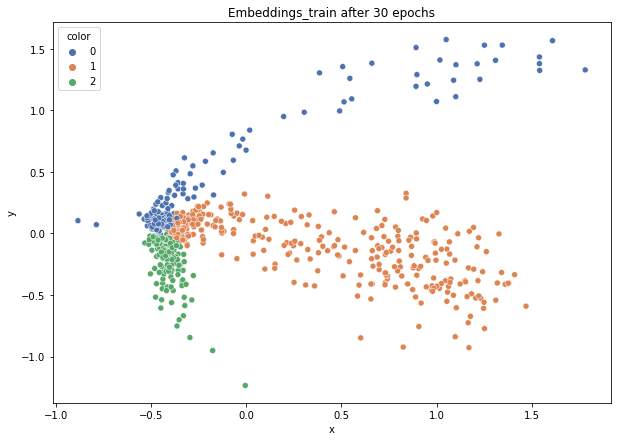

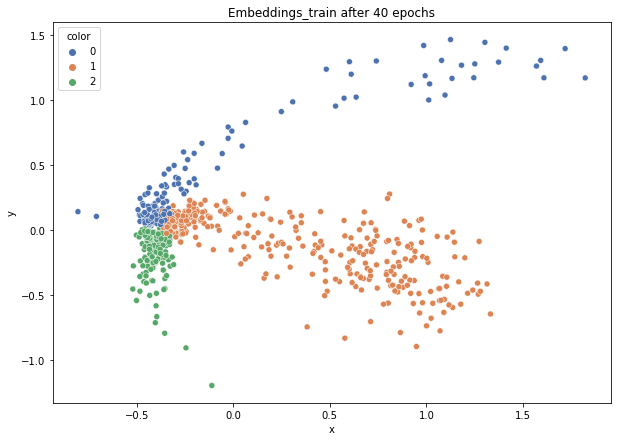

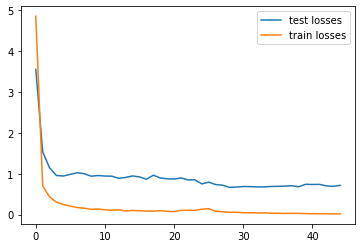

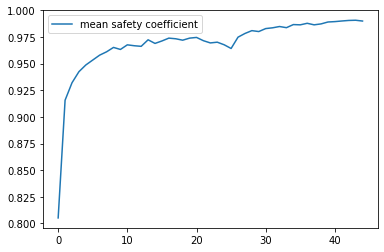

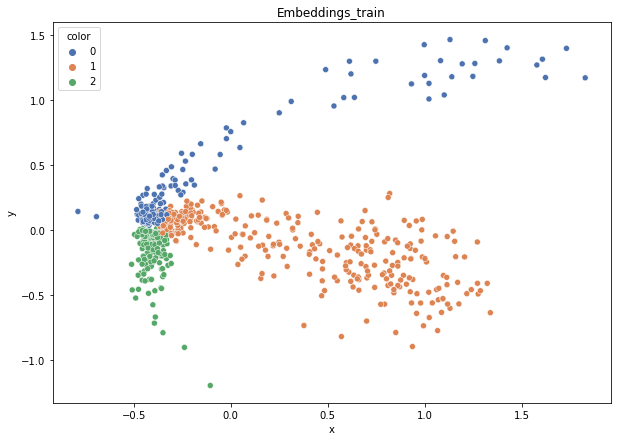

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.96
DT-f1-old+new-features: 0.968
DT-f1-old-features: 0.909
DT-gmean-new-features: 0.956
DT-gmean-old+new-features: 0.959
DT-gmean-old-features: 0.916
DT-minority_gmean-new-features: 0.096
DT-minority_gmean-old+new-features: 0.096
DT-minority_gmean-old-features: 0.095
KNN-f1-new-features: 0.972
KNN-f1-old+new-features: 0.937
KNN-f1-old-features: 0.937
KNN-gmean-new-features: 0.967
KNN-gmean-old+new-features: 0.927
KNN-gmean-old-features: 0.927
KNN-minority_gmean-new-features: 0.097
KNN-minority_gmean-old+new-features: 0.093
KNN-minority_gmean-old-features: 0.093


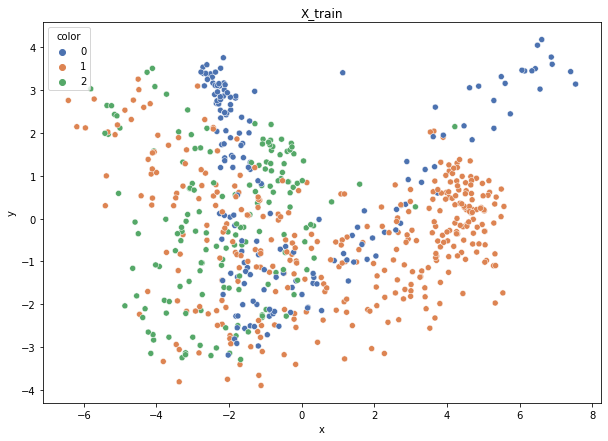

Class cardinalities: Counter({1: 343, 0: 174, 2: 160})
Weights: {2: 0.4191092821730032, 1: 0.19550287215067205, 0: 0.3853878456763248}
Training autoencoder...


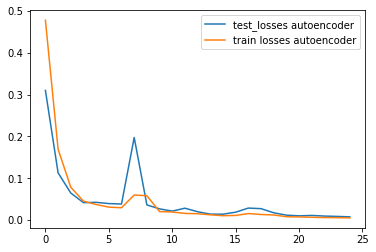

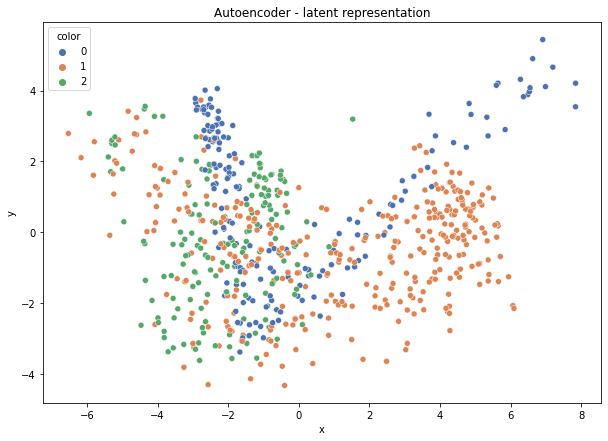

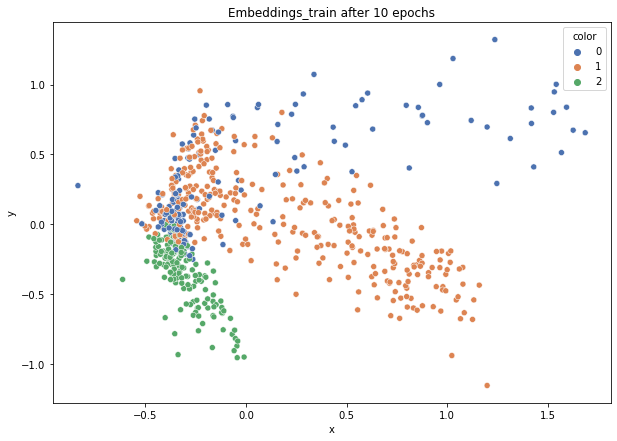

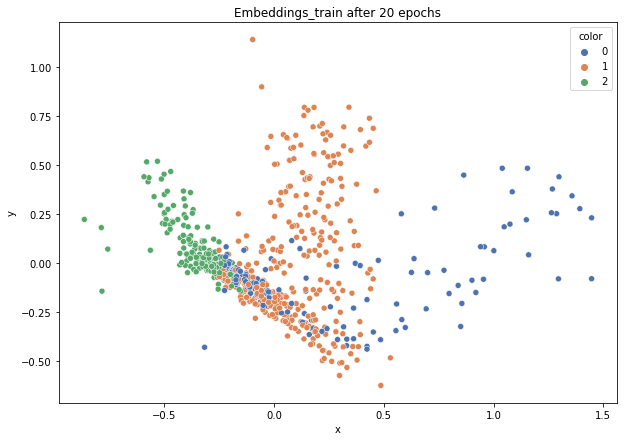

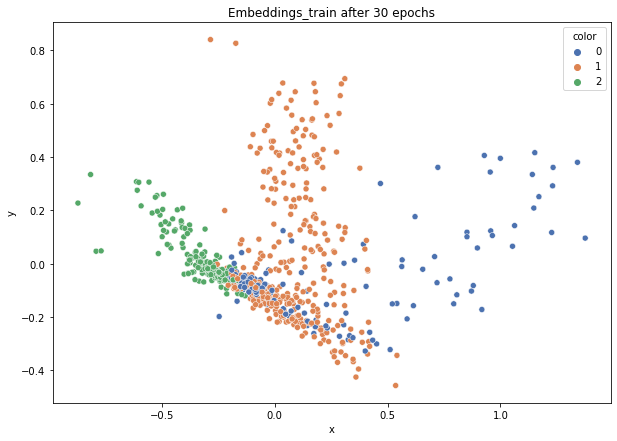

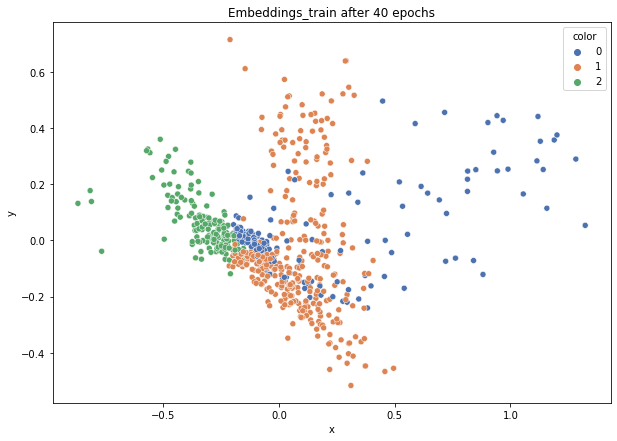

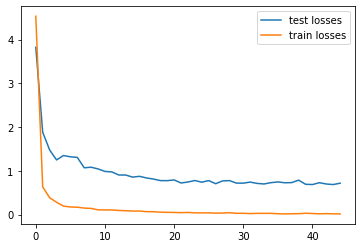

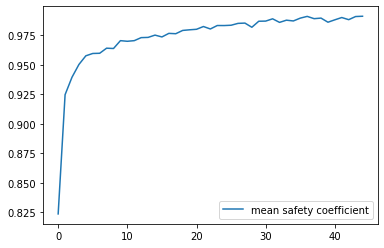

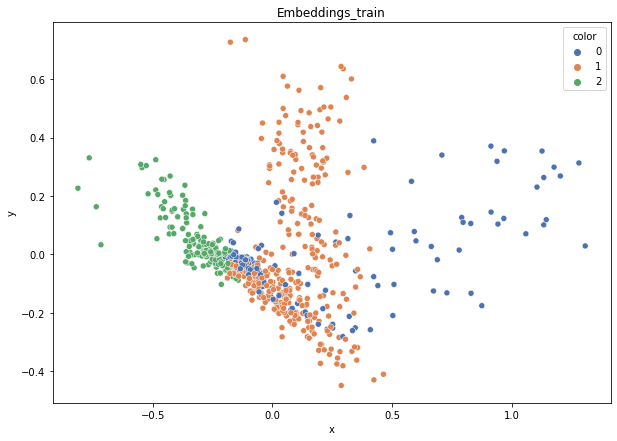

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.948
DT-f1-old+new-features: 0.954
DT-f1-old-features: 0.877
DT-gmean-new-features: 0.948
DT-gmean-old+new-features: 0.955
DT-gmean-old-features: 0.87
DT-minority_gmean-new-features: 0.096
DT-minority_gmean-old+new-features: 0.097
DT-minority_gmean-old-features: 0.09
KNN-f1-new-features: 0.964
KNN-f1-old+new-features: 0.937
KNN-f1-old-features: 0.937
KNN-gmean-new-features: 0.965
KNN-gmean-old+new-features: 0.935
KNN-gmean-old-features: 0.935
KNN-minority_gmean-new-features: 0.097
KNN-minority_gmean-old+new-features: 0.094
KNN-minority_gmean-old-features: 0.094
new_yeast


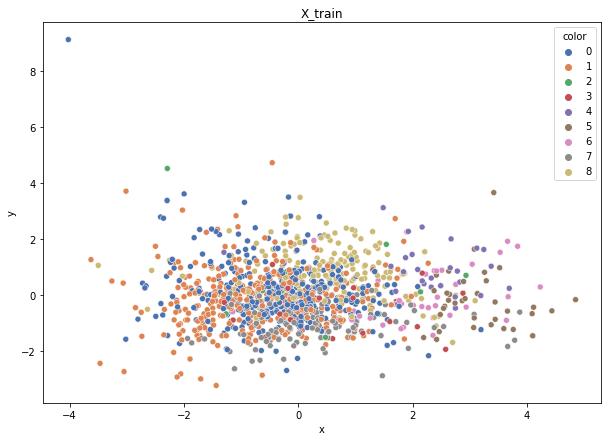

Class cardinalities: Counter({0: 370, 1: 343, 8: 195, 7: 135, 6: 40, 5: 36, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.024325906642526016, 0: 0.012820410257547495, 1: 0.013829597070823827, 5: 0.1317653276470159, 4: 0.16941256411759187, 6: 0.11858879488231433, 3: 0.19764799147052386, 7: 0.03513742070587091, 2: 0.2964719872057858}
Training autoencoder...


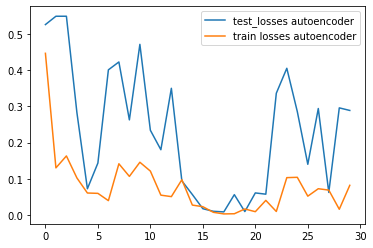

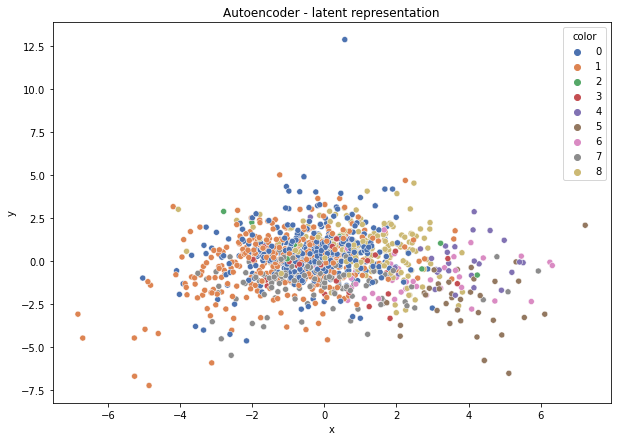

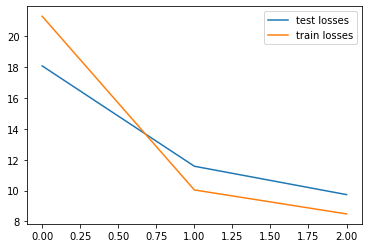

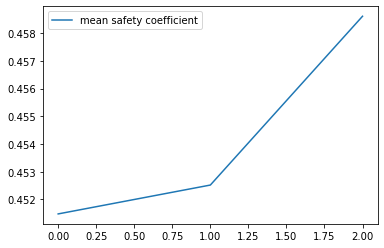

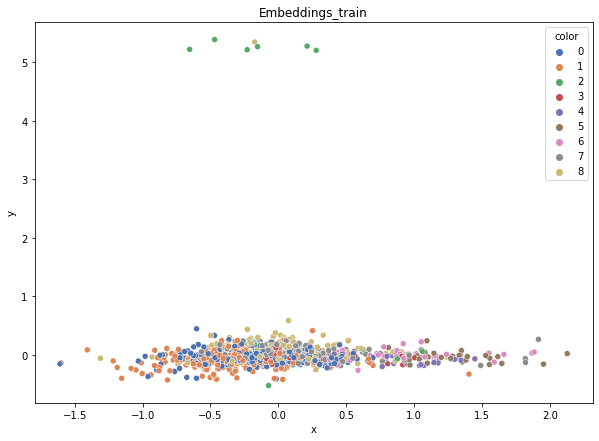

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.437
DT-f1-old+new-features: 0.428
DT-f1-old-features: 0.494
DT-gmean-new-features: 0.414
DT-gmean-old+new-features: 0.382
DT-gmean-old-features: 0.271
DT-minority_gmean-new-features: 0.026
DT-minority_gmean-old+new-features: 0.023
DT-minority_gmean-old-features: 0.016
KNN-f1-new-features: 0.533
KNN-f1-old+new-features: 0.552
KNN-f1-old-features: 0.545
KNN-gmean-new-features: 0.506
KNN-gmean-old+new-features: 0.514
KNN-gmean-old-features: 0.51
KNN-minority_gmean-new-features: 0.03
KNN-minority_gmean-old+new-features: 0.03
KNN-minority_gmean-old-features: 0.03


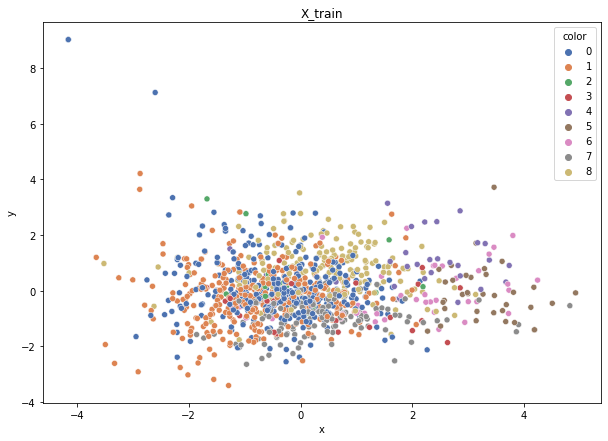

Class cardinalities: Counter({0: 371, 1: 343, 8: 195, 7: 134, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {1: 0.013814401543936261, 8: 0.02429917810035968, 0: 0.012771805200997676, 5: 0.13538113513057534, 6: 0.11556926169683263, 7: 0.035360744250523414, 3: 0.1974308220654224, 4: 0.16922641891321918, 2: 0.2961462330981336}
Training autoencoder...


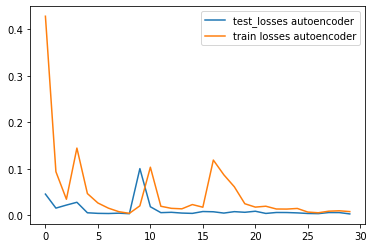

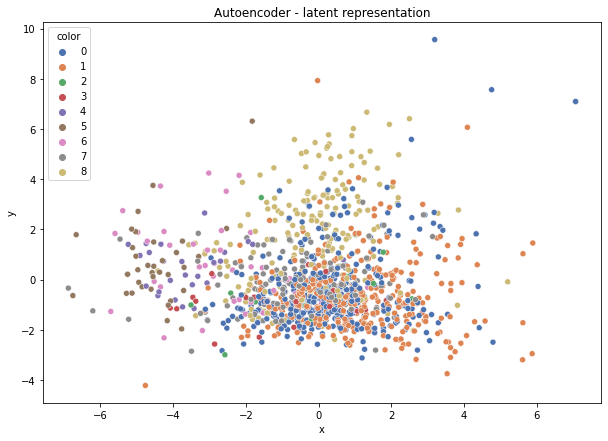

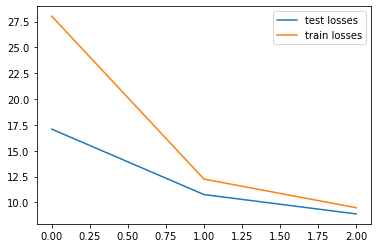

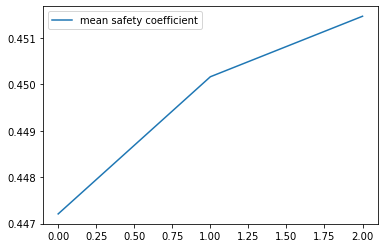

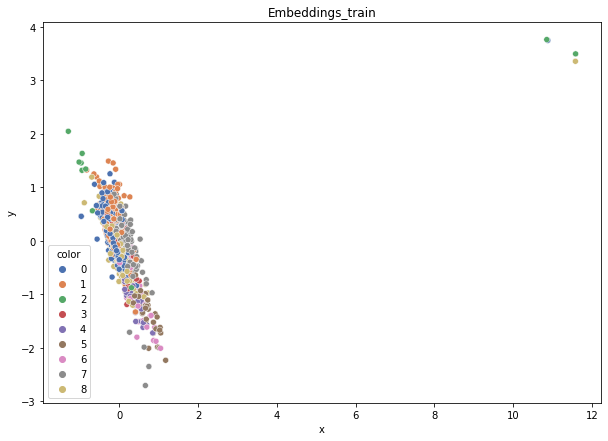

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.447
DT-f1-old+new-features: 0.426
DT-f1-old-features: 0.451
DT-gmean-new-features: 0.453
DT-gmean-old+new-features: 0.243
DT-gmean-old-features: 0.26
DT-minority_gmean-new-features: 0.027
DT-minority_gmean-old+new-features: 0.015
DT-minority_gmean-old-features: 0.016
KNN-f1-new-features: 0.535
KNN-f1-old+new-features: 0.503
KNN-f1-old-features: 0.494
KNN-gmean-new-features: 0.293
KNN-gmean-old+new-features: 0.271
KNN-gmean-old-features: 0.268
KNN-minority_gmean-new-features: 0.024
KNN-minority_gmean-old+new-features: 0.023
KNN-minority_gmean-old-features: 0.023


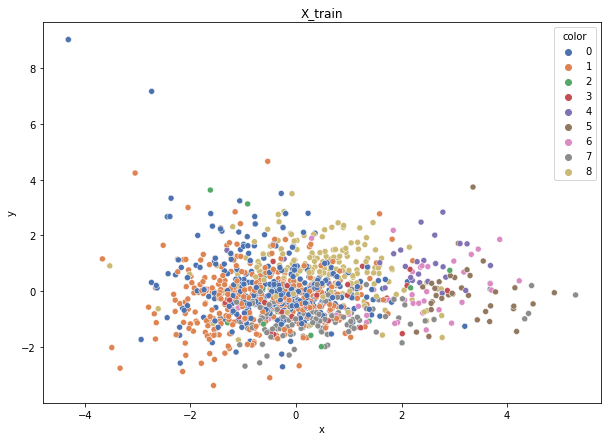

Class cardinalities: Counter({0: 371, 1: 343, 8: 195, 7: 134, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.024299178100359677, 1: 0.01381440154393626, 0: 0.012771805200997674, 5: 0.13538113513057534, 4: 0.16922641891321916, 6: 0.11556926169683261, 7: 0.03536074425052341, 3: 0.19743082206542237, 2: 0.29614623309813354}
Training autoencoder...


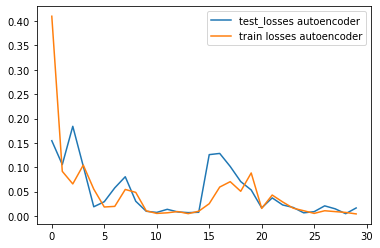

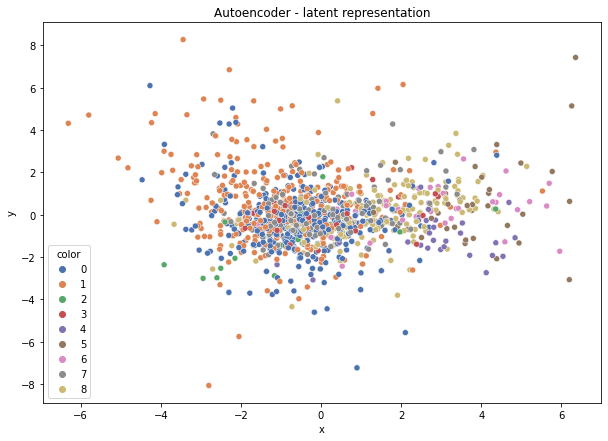

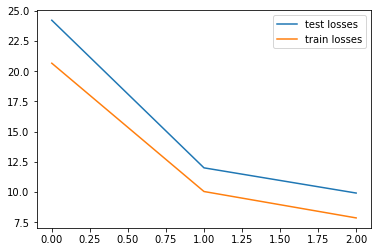

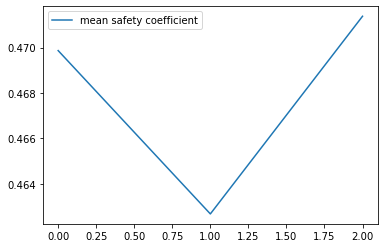

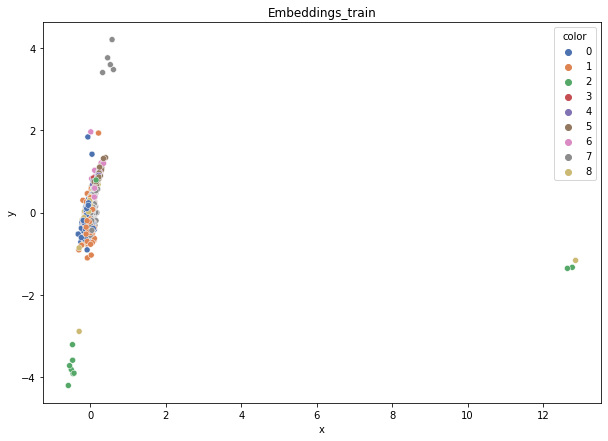

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.375
DT-f1-old+new-features: 0.463
DT-f1-old-features: 0.407
DT-gmean-new-features: 0.231
DT-gmean-old+new-features: 0.473
DT-gmean-old-features: 0.401
DT-minority_gmean-new-features: 0.015
DT-minority_gmean-old+new-features: 0.03
DT-minority_gmean-old-features: 0.026
KNN-f1-new-features: 0.414
KNN-f1-old+new-features: 0.449
KNN-f1-old-features: 0.451
KNN-gmean-new-features: 0.235
KNN-gmean-old+new-features: 0.423
KNN-gmean-old-features: 0.422
KNN-minority_gmean-new-features: 0.015
KNN-minority_gmean-old+new-features: 0.026
KNN-minority_gmean-old-features: 0.026


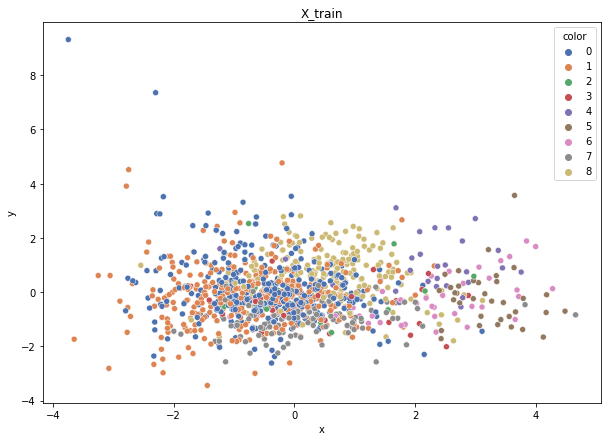

Class cardinalities: Counter({0: 370, 1: 344, 8: 195, 7: 134, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.024299315142460837, 1: 0.013774321083662392, 0: 0.012806395818323955, 5: 0.13538189865085323, 4: 0.16922737331356652, 6: 0.11556991348243568, 7: 0.03536094367746166, 3: 0.1974319355324943, 2: 0.29614790329874147}
Training autoencoder...


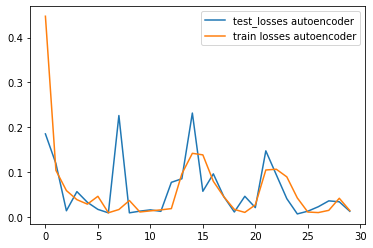

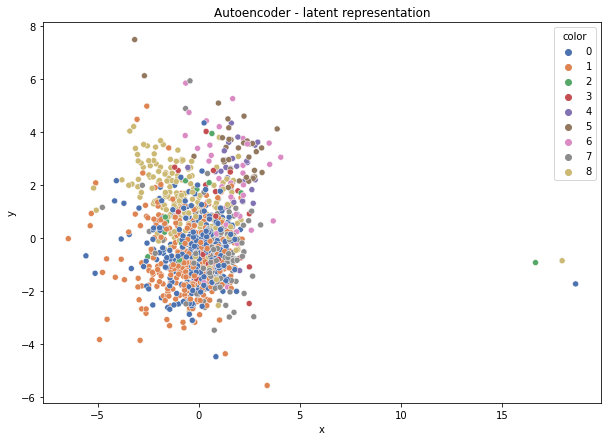

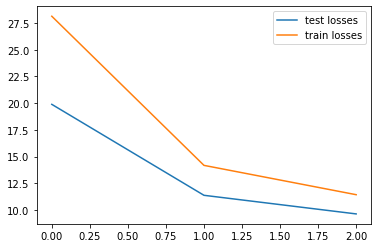

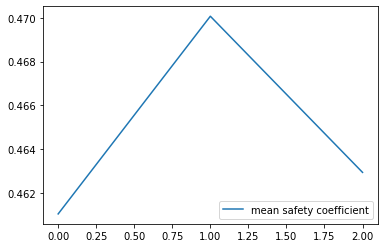

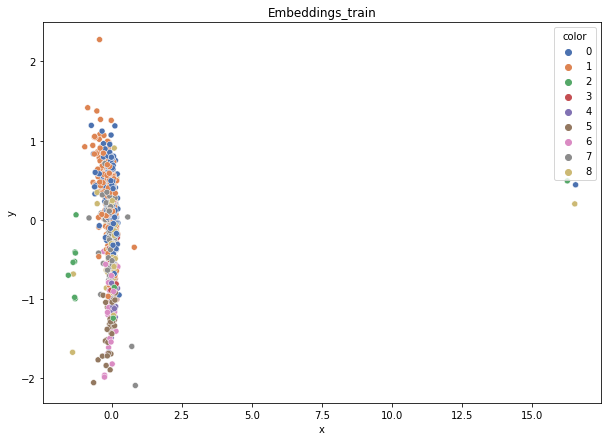

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.347
DT-f1-old+new-features: 0.408
DT-f1-old-features: 0.437
DT-gmean-new-features: 0.186
DT-gmean-old+new-features: 0.413
DT-gmean-old-features: 0.247
DT-minority_gmean-new-features: 0.012
DT-minority_gmean-old+new-features: 0.027
DT-minority_gmean-old-features: 0.016
KNN-f1-new-features: 0.505
KNN-f1-old+new-features: 0.498
KNN-f1-old-features: 0.492
KNN-gmean-new-features: 0.448
KNN-gmean-old+new-features: 0.442
KNN-gmean-old-features: 0.439
KNN-minority_gmean-new-features: 0.028
KNN-minority_gmean-old+new-features: 0.027
KNN-minority_gmean-old-features: 0.027


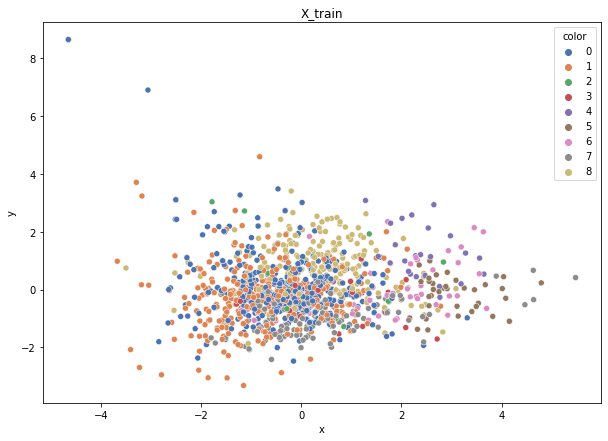

Class cardinalities: Counter({0: 370, 1: 343, 8: 196, 7: 135, 6: 41, 5: 35, 4: 28, 3: 24, 2: 16})
Weights: {8: 0.02418370057482606, 1: 0.013819257471329179, 0: 0.012810825169367322, 5: 0.13542872321902596, 4: 0.16928590402378244, 6: 0.11560988567477826, 7: 0.035111150464191915, 3: 0.1975002213610795, 2: 0.29625033204161927}
Training autoencoder...


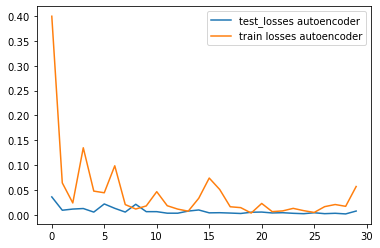

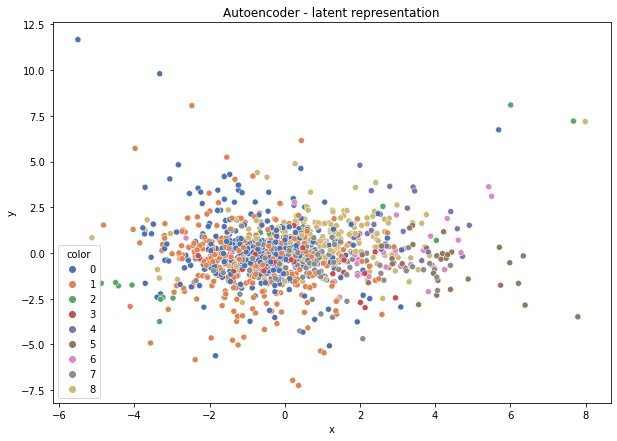

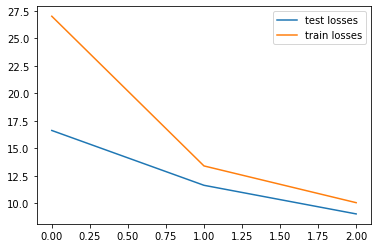

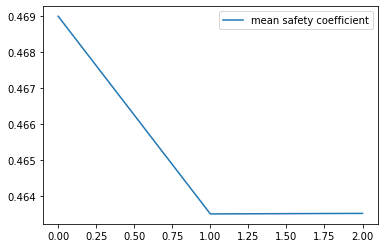

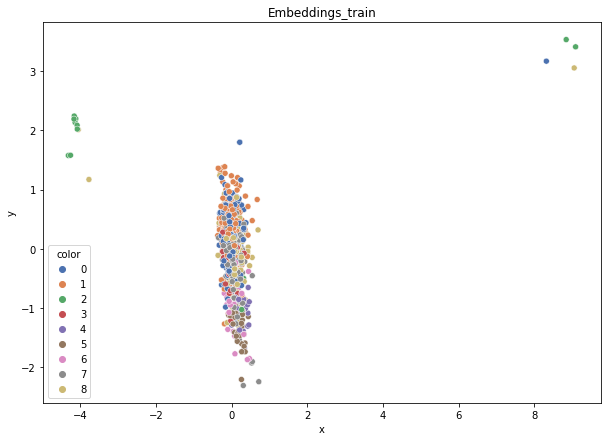

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.415
DT-f1-old+new-features: 0.408
DT-f1-old-features: 0.423
DT-gmean-new-features: 0.387
DT-gmean-old+new-features: 0.205
DT-gmean-old-features: 0.236
DT-minority_gmean-new-features: 0.023
DT-minority_gmean-old+new-features: 0.012
DT-minority_gmean-old-features: 0.014
KNN-f1-new-features: 0.446
KNN-f1-old+new-features: 0.452
KNN-f1-old-features: 0.452
KNN-gmean-new-features: 0.393
KNN-gmean-old+new-features: 0.402
KNN-gmean-old-features: 0.403
KNN-minority_gmean-new-features: 0.024
KNN-minority_gmean-old+new-features: 0.025
KNN-minority_gmean-old-features: 0.025
1czysty-cut


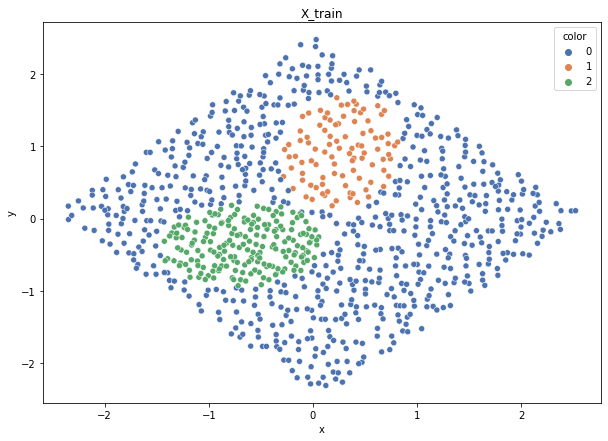

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


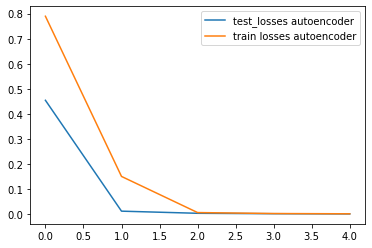

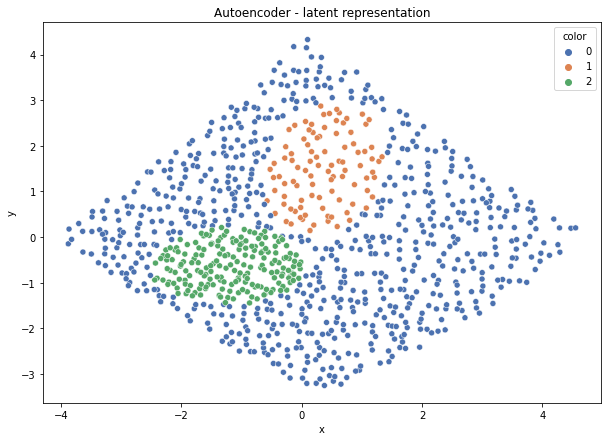

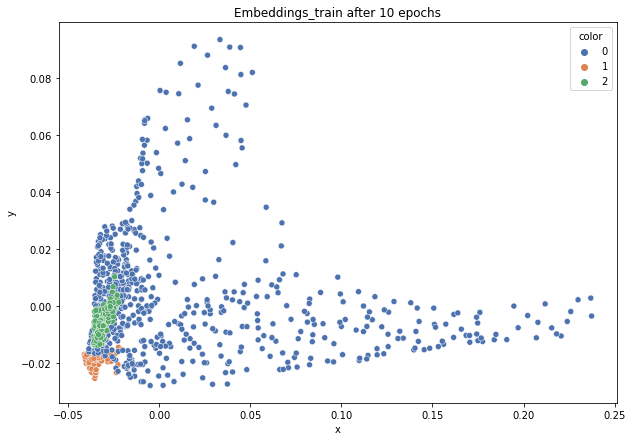

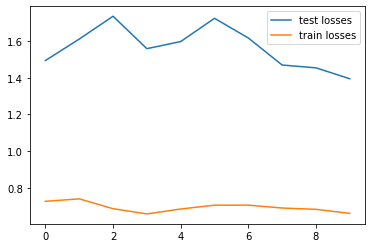

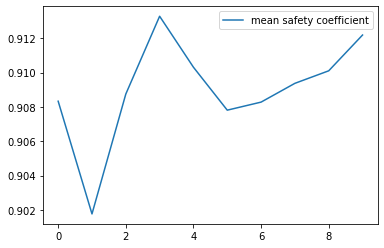

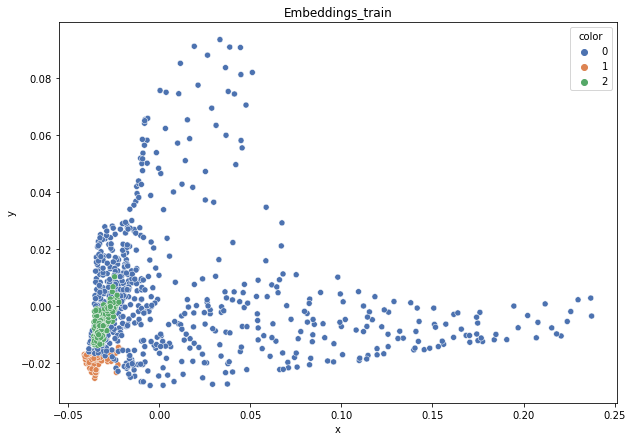

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.915
DT-f1-old+new-features: 0.946
DT-f1-old-features: 0.901
DT-gmean-new-features: 0.935
DT-gmean-old+new-features: 0.937
DT-gmean-old-features: 0.889
DT-minority_gmean-new-features: 0.095
DT-minority_gmean-old+new-features: 0.094
DT-minority_gmean-old-features: 0.09
KNN-f1-new-features: 0.924
KNN-f1-old+new-features: 0.937
KNN-f1-old-features: 0.937
KNN-gmean-new-features: 0.935
KNN-gmean-old+new-features: 0.941
KNN-gmean-old-features: 0.941
KNN-minority_gmean-new-features: 0.095
KNN-minority_gmean-old+new-features: 0.095
KNN-minority_gmean-old-features: 0.095


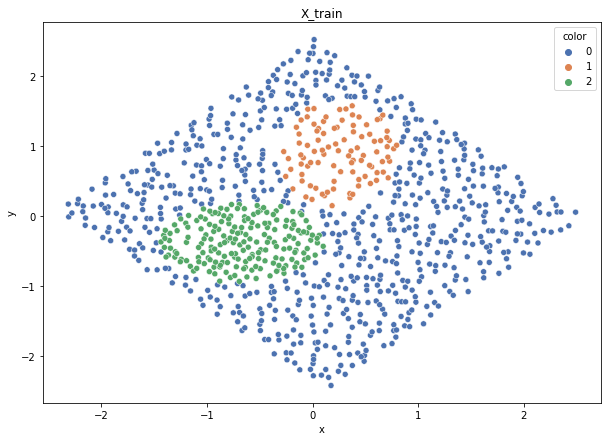

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


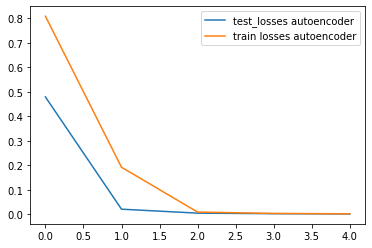

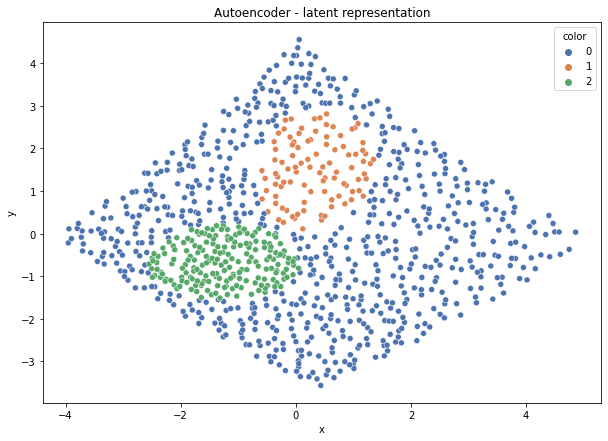

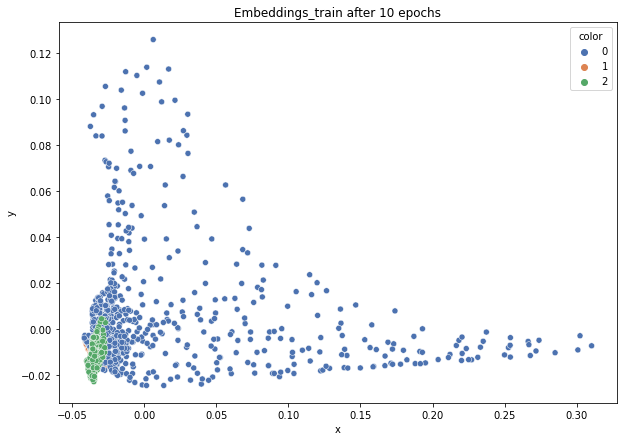

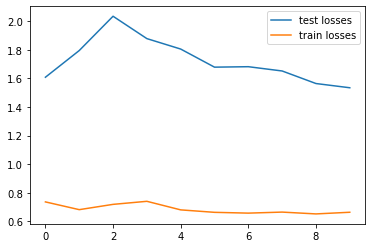

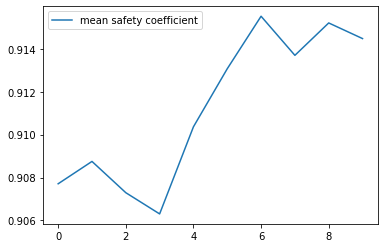

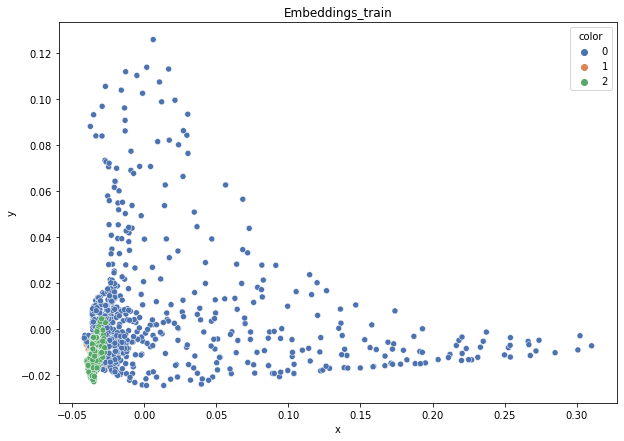

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.922
DT-f1-old+new-features: 0.917
DT-f1-old-features: 0.929
DT-gmean-new-features: 0.903
DT-gmean-old+new-features: 0.893
DT-gmean-old-features: 0.928
DT-minority_gmean-new-features: 0.091
DT-minority_gmean-old+new-features: 0.09
DT-minority_gmean-old-features: 0.094
KNN-f1-new-features: 0.94
KNN-f1-old+new-features: 0.945
KNN-f1-old-features: 0.945
KNN-gmean-new-features: 0.927
KNN-gmean-old+new-features: 0.934
KNN-gmean-old-features: 0.934
KNN-minority_gmean-new-features: 0.093
KNN-minority_gmean-old+new-features: 0.094
KNN-minority_gmean-old-features: 0.094


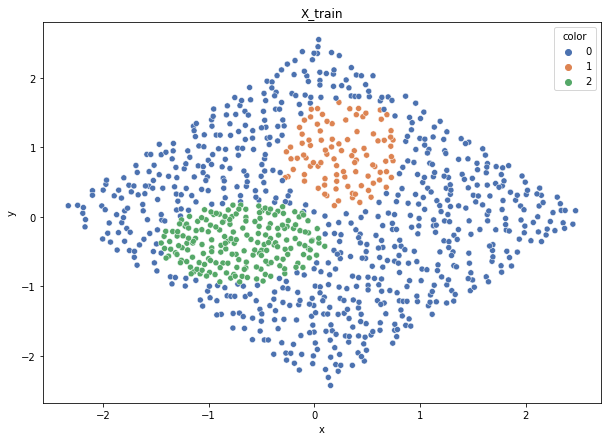

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


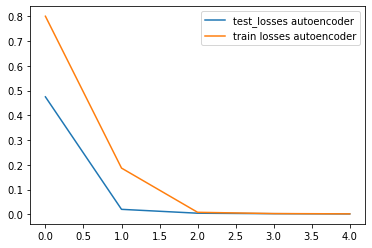

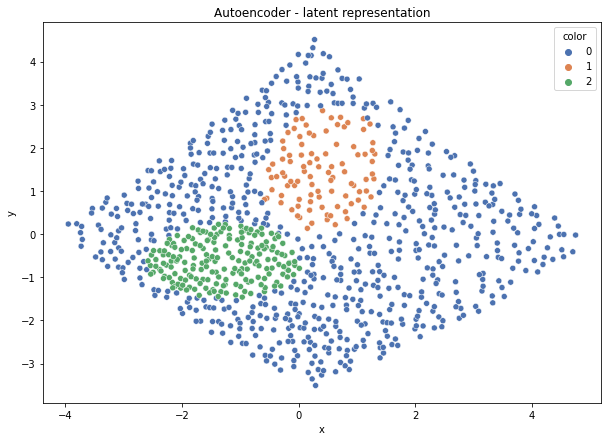

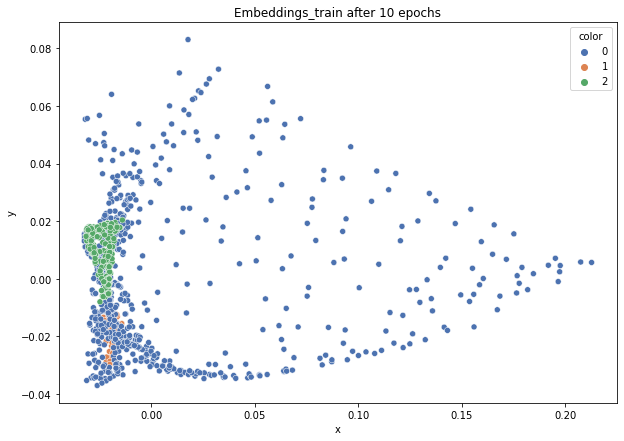

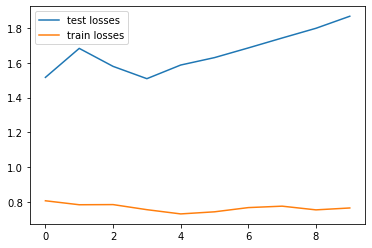

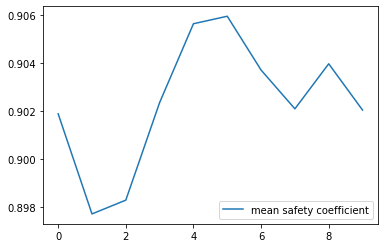

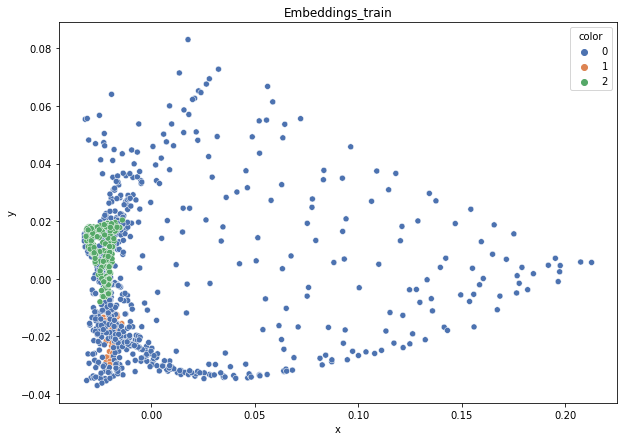

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.961
DT-f1-old+new-features: 0.984
DT-f1-old-features: 0.942
DT-gmean-new-features: 0.966
DT-gmean-old+new-features: 0.984
DT-gmean-old-features: 0.934
DT-minority_gmean-new-features: 0.097
DT-minority_gmean-old+new-features: 0.099
DT-minority_gmean-old-features: 0.094
KNN-f1-new-features: 0.963
KNN-f1-old+new-features: 0.957
KNN-f1-old-features: 0.957
KNN-gmean-new-features: 0.953
KNN-gmean-old+new-features: 0.933
KNN-gmean-old-features: 0.933
KNN-minority_gmean-new-features: 0.096
KNN-minority_gmean-old+new-features: 0.093
KNN-minority_gmean-old-features: 0.093


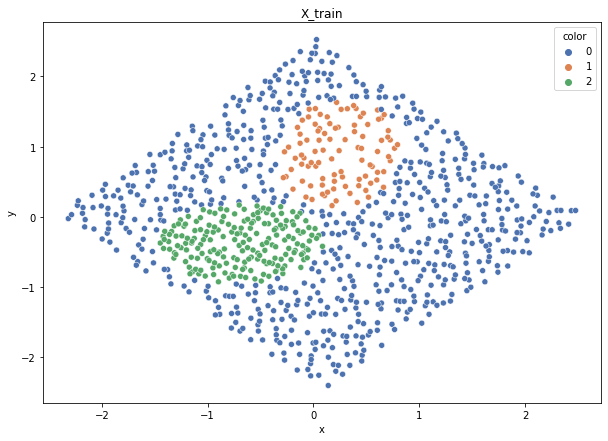

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


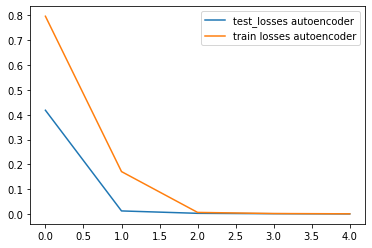

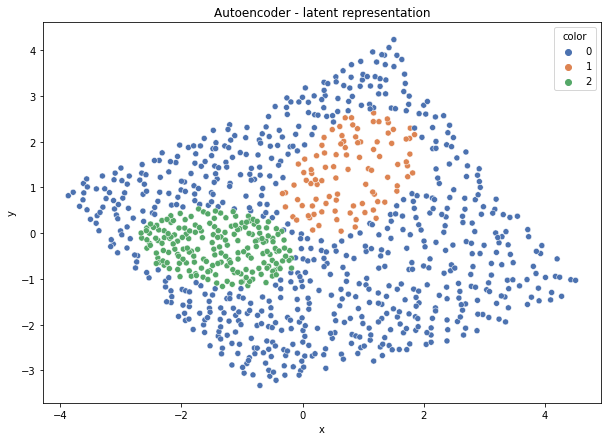

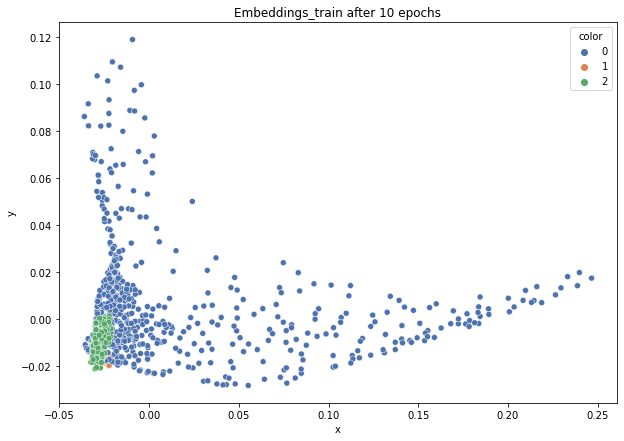

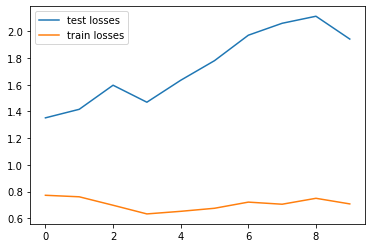

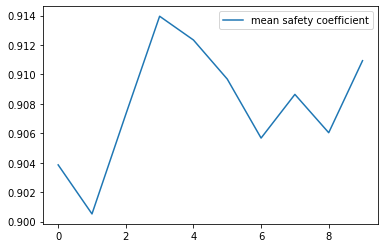

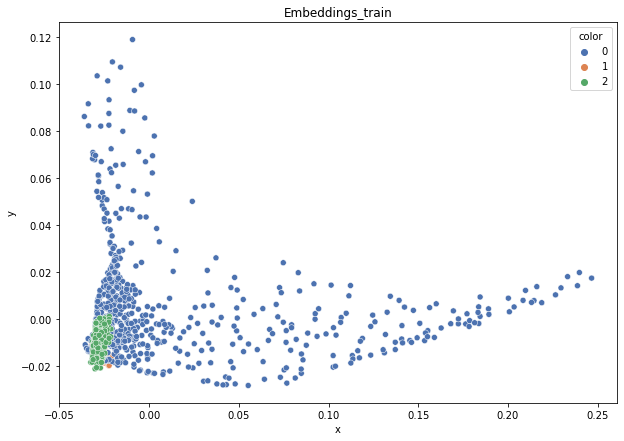

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.933
DT-f1-old+new-features: 0.947
DT-f1-old-features: 0.932
DT-gmean-new-features: 0.951
DT-gmean-old+new-features: 0.955
DT-gmean-old-features: 0.959
DT-minority_gmean-new-features: 0.096
DT-minority_gmean-old+new-features: 0.096
DT-minority_gmean-old-features: 0.098
KNN-f1-new-features: 0.944
KNN-f1-old+new-features: 0.931
KNN-f1-old-features: 0.931
KNN-gmean-new-features: 0.975
KNN-gmean-old+new-features: 0.957
KNN-gmean-old-features: 0.957
KNN-minority_gmean-new-features: 0.099
KNN-minority_gmean-old+new-features: 0.098
KNN-minority_gmean-old-features: 0.098


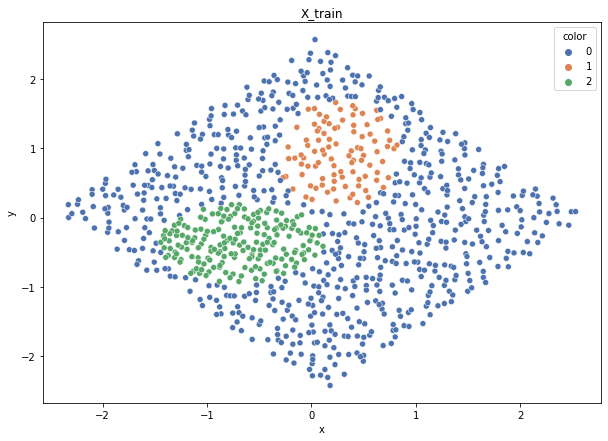

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


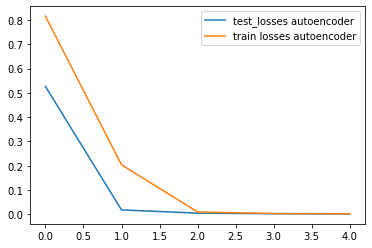

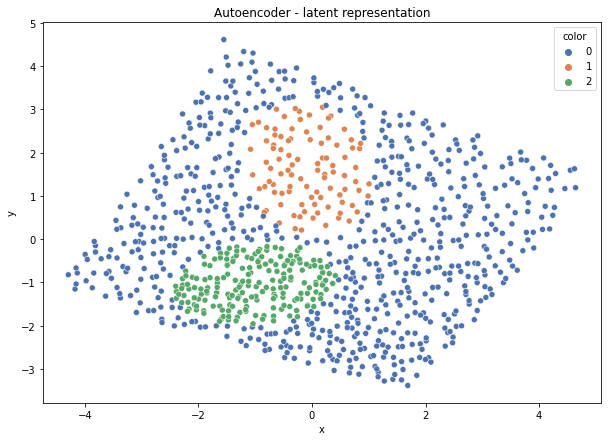

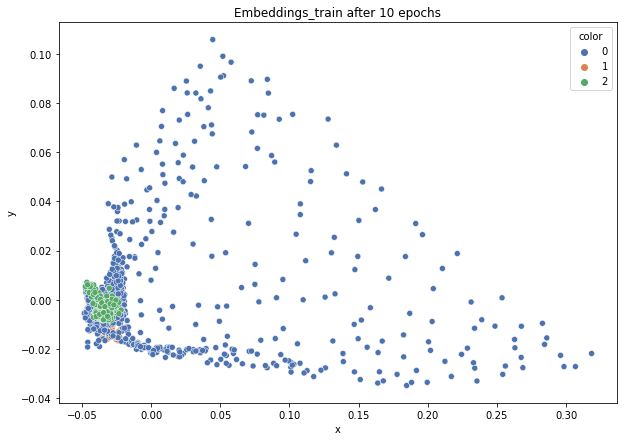

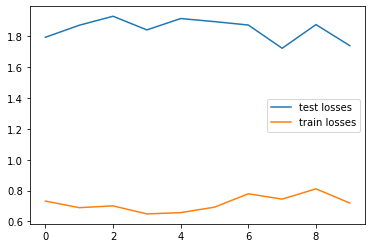

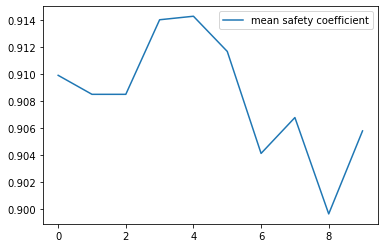

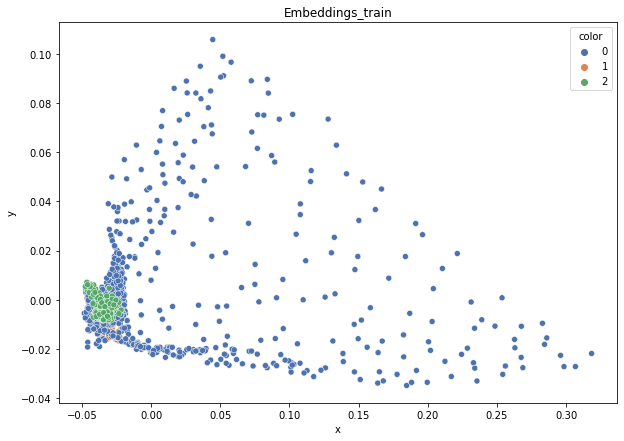

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.934
DT-f1-old+new-features: 0.974
DT-f1-old-features: 0.973
DT-gmean-new-features: 0.916
DT-gmean-old+new-features: 0.98
DT-gmean-old-features: 0.973
DT-minority_gmean-new-features: 0.092
DT-minority_gmean-old+new-features: 0.099
DT-minority_gmean-old-features: 0.098
KNN-f1-new-features: 0.962
KNN-f1-old+new-features: 0.958
KNN-f1-old-features: 0.958
KNN-gmean-new-features: 0.957
KNN-gmean-old+new-features: 0.955
KNN-gmean-old-features: 0.955
KNN-minority_gmean-new-features: 0.096
KNN-minority_gmean-old+new-features: 0.096
KNN-minority_gmean-old-features: 0.096
2delikatne-cut


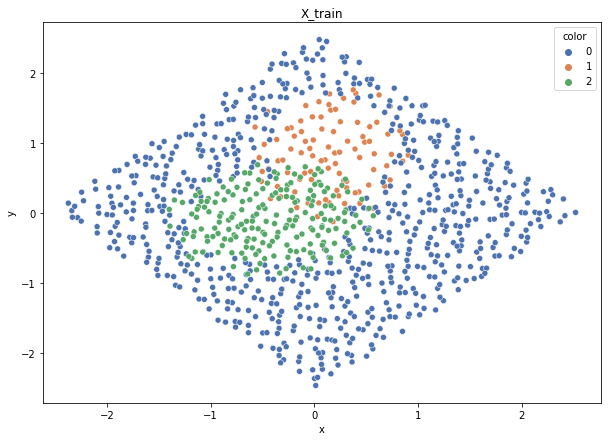

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


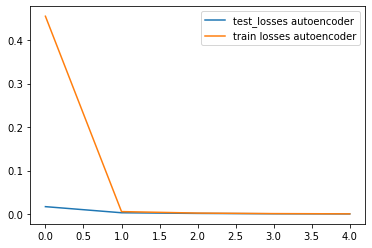

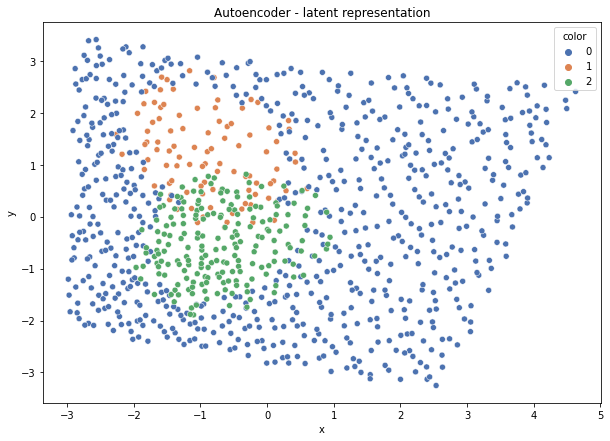

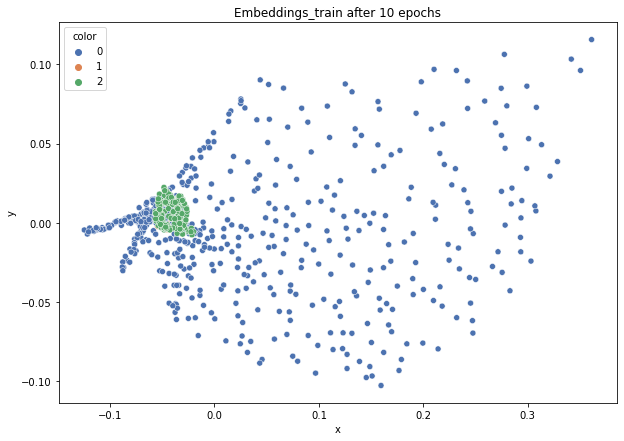

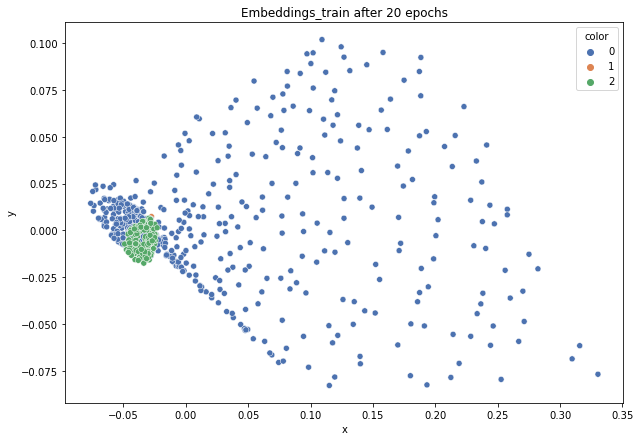

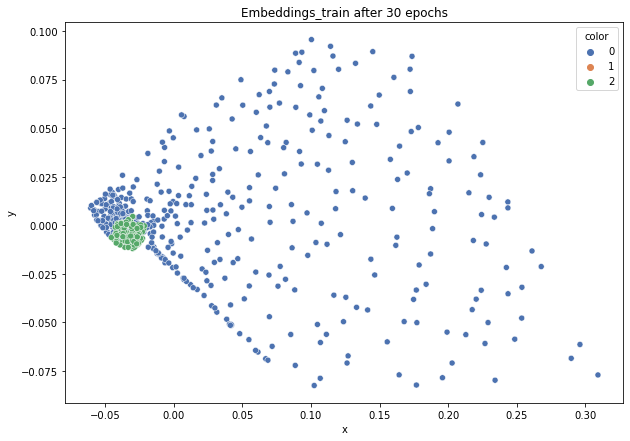

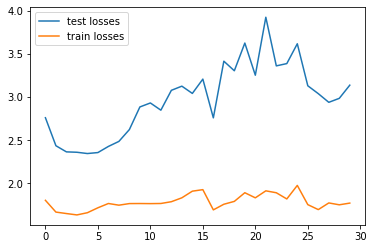

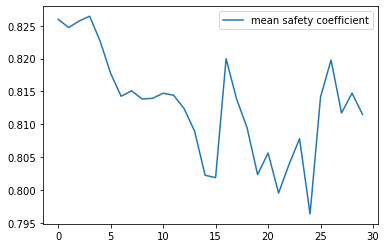

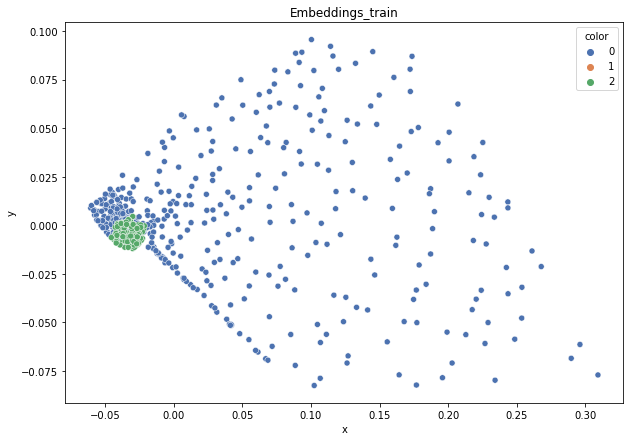

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.71
DT-f1-old+new-features: 0.717
DT-f1-old-features: 0.69
DT-gmean-new-features: 0.689
DT-gmean-old+new-features: 0.73
DT-gmean-old-features: 0.674
DT-minority_gmean-new-features: 0.071
DT-minority_gmean-old+new-features: 0.076
DT-minority_gmean-old-features: 0.07
KNN-f1-new-features: 0.695
KNN-f1-old+new-features: 0.693
KNN-f1-old-features: 0.693
KNN-gmean-new-features: 0.675
KNN-gmean-old+new-features: 0.674
KNN-gmean-old-features: 0.674
KNN-minority_gmean-new-features: 0.07
KNN-minority_gmean-old+new-features: 0.07
KNN-minority_gmean-old-features: 0.07


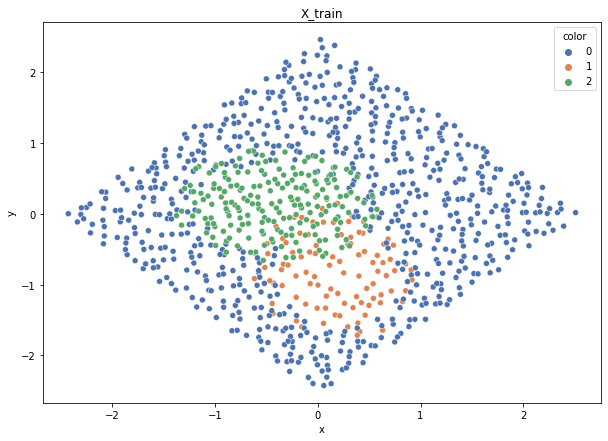

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


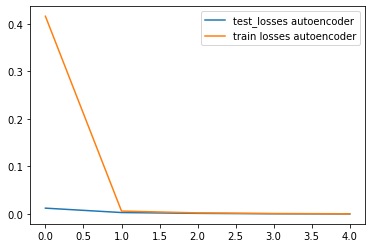

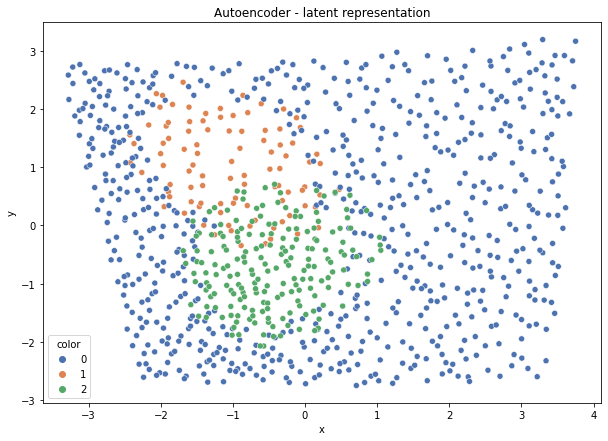

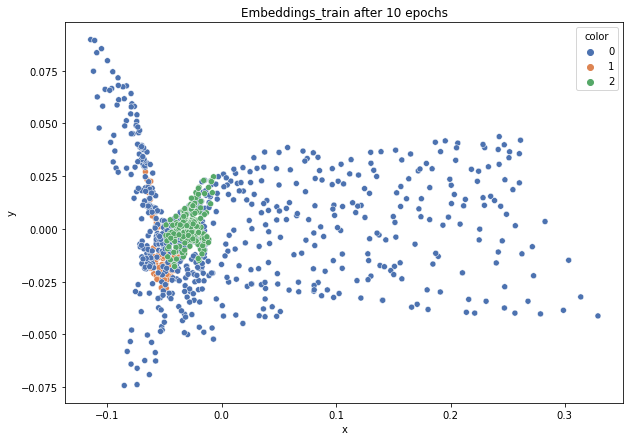

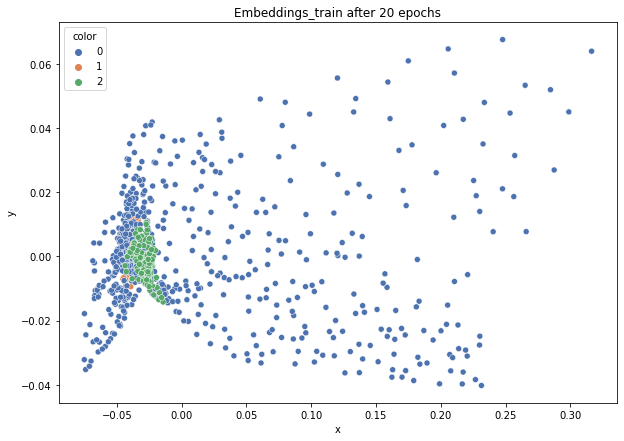

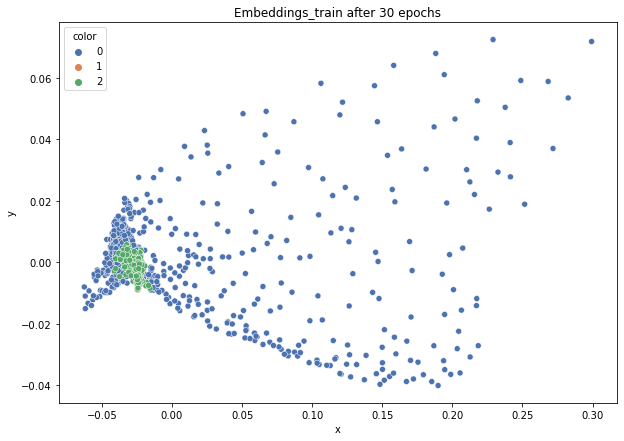

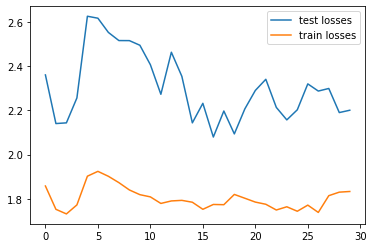

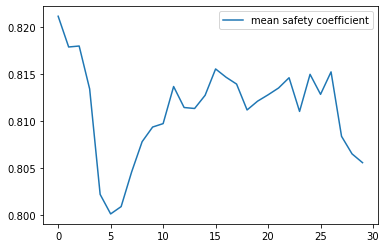

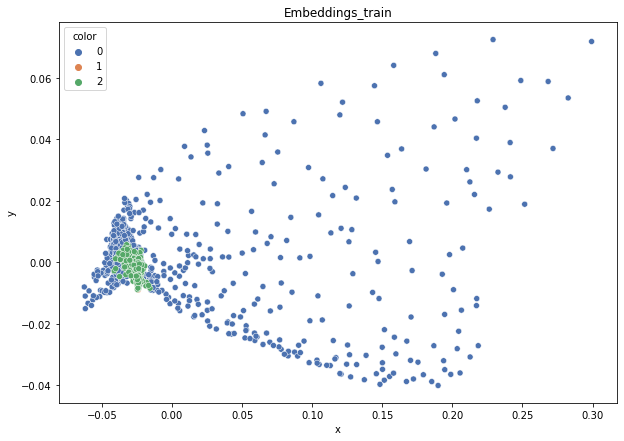

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.669
DT-f1-old+new-features: 0.758
DT-f1-old-features: 0.763
DT-gmean-new-features: 0.696
DT-gmean-old+new-features: 0.789
DT-gmean-old-features: 0.787
DT-minority_gmean-new-features: 0.074
DT-minority_gmean-old+new-features: 0.082
DT-minority_gmean-old-features: 0.082
KNN-f1-new-features: 0.7
KNN-f1-old+new-features: 0.742
KNN-f1-old-features: 0.742
KNN-gmean-new-features: 0.689
KNN-gmean-old+new-features: 0.727
KNN-gmean-old-features: 0.727
KNN-minority_gmean-new-features: 0.071
KNN-minority_gmean-old+new-features: 0.075
KNN-minority_gmean-old-features: 0.075


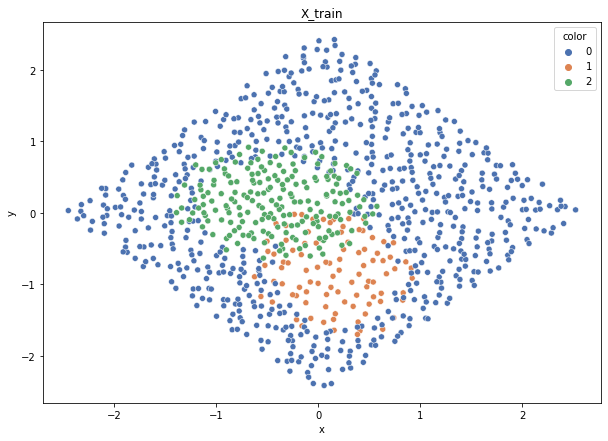

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


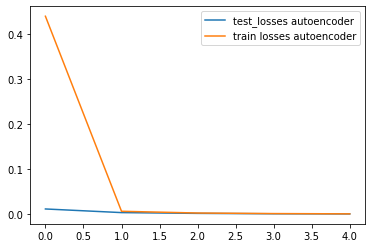

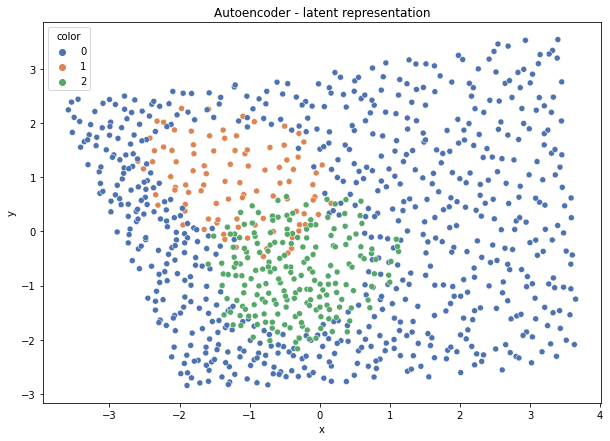

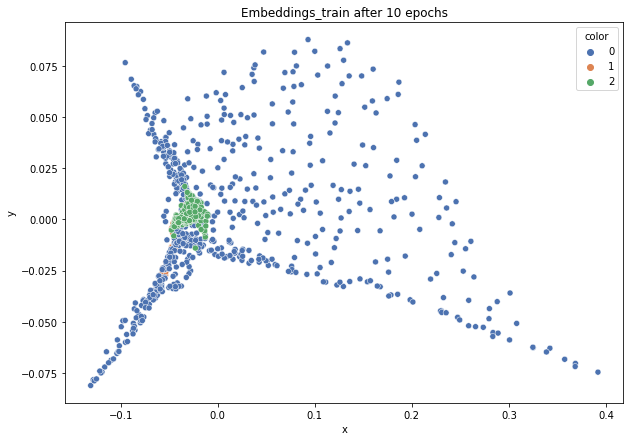

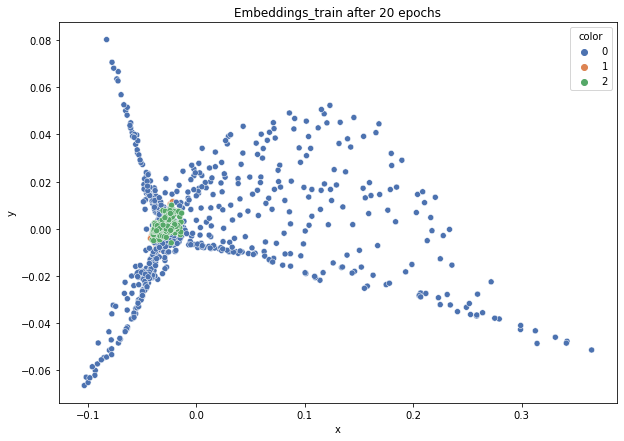

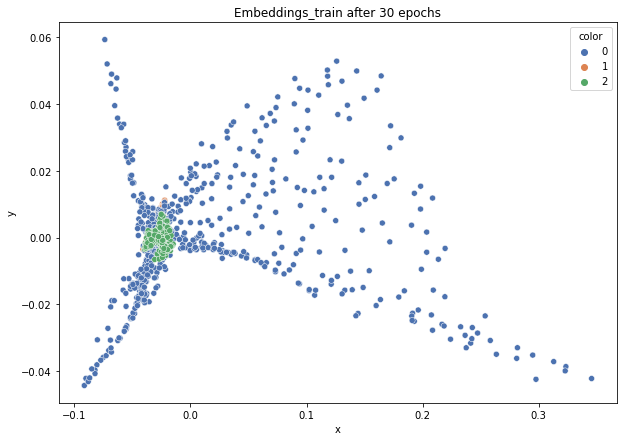

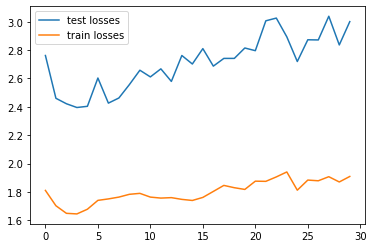

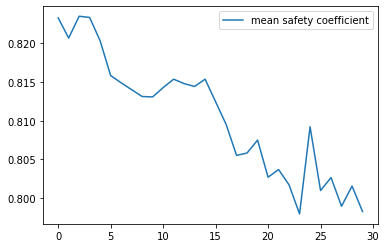

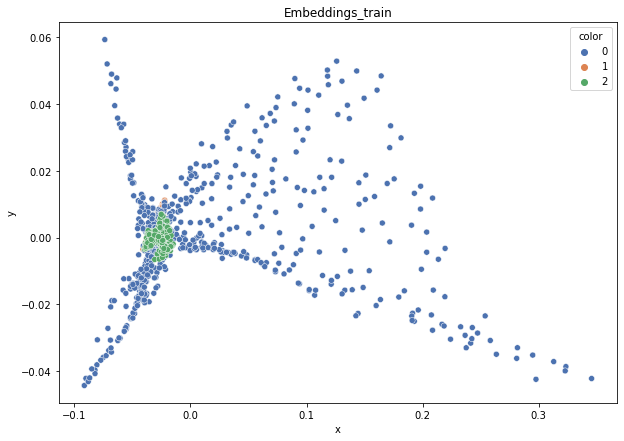

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.72
DT-f1-old+new-features: 0.767
DT-f1-old-features: 0.712
DT-gmean-new-features: 0.705
DT-gmean-old+new-features: 0.776
DT-gmean-old-features: 0.727
DT-minority_gmean-new-features: 0.073
DT-minority_gmean-old+new-features: 0.08
DT-minority_gmean-old-features: 0.076
KNN-f1-new-features: 0.73
KNN-f1-old+new-features: 0.666
KNN-f1-old-features: 0.666
KNN-gmean-new-features: 0.715
KNN-gmean-old+new-features: 0.636
KNN-gmean-old-features: 0.636
KNN-minority_gmean-new-features: 0.074
KNN-minority_gmean-old+new-features: 0.066
KNN-minority_gmean-old-features: 0.066


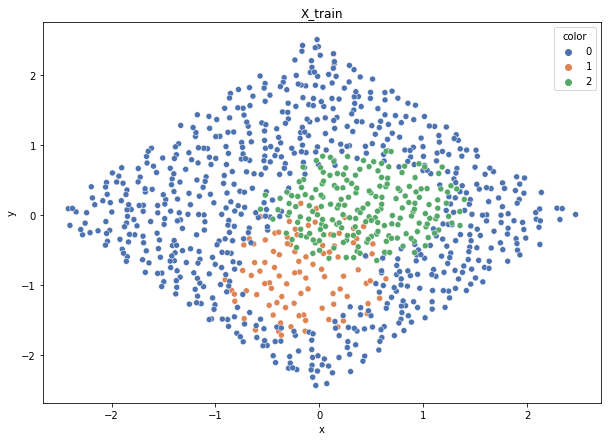

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


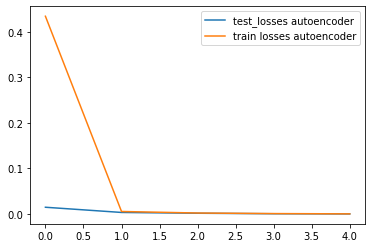

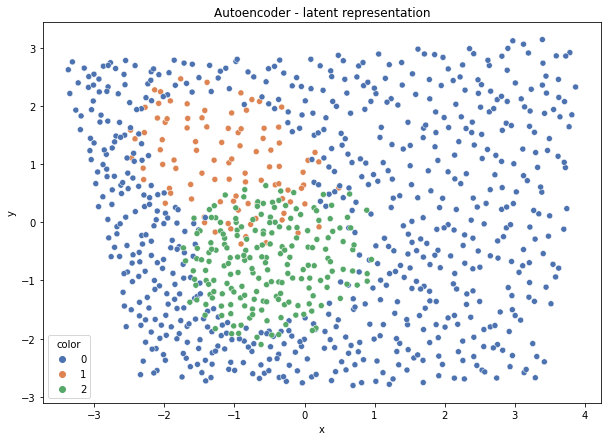

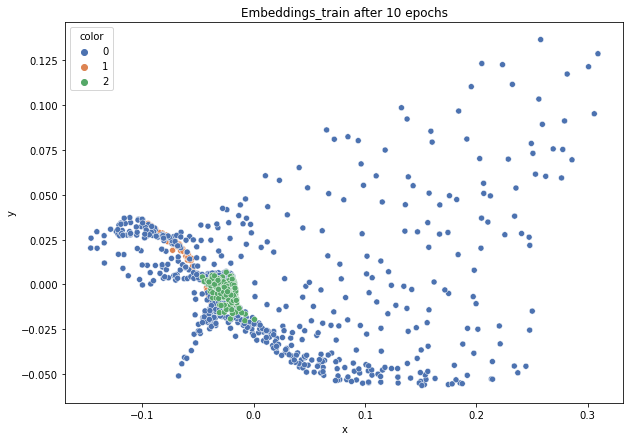

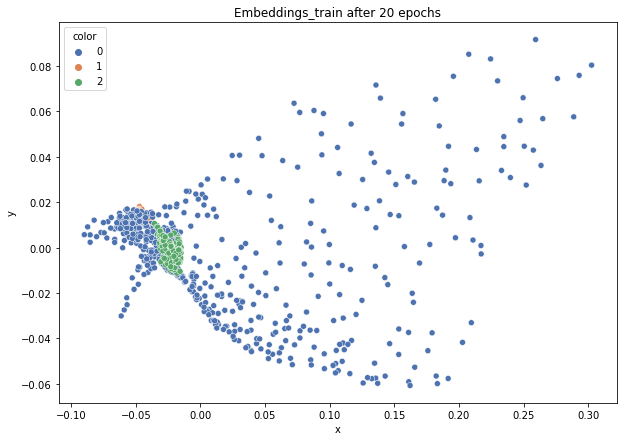

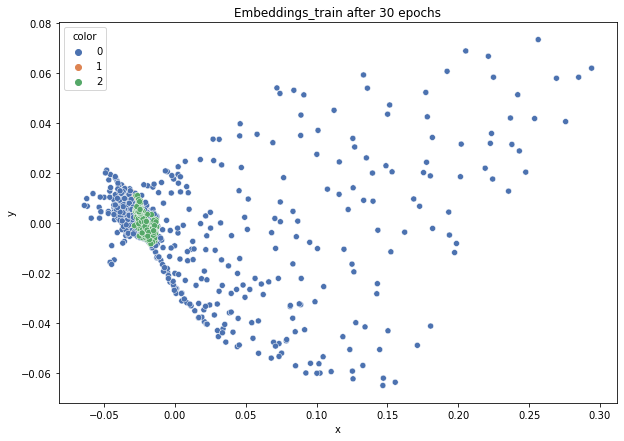

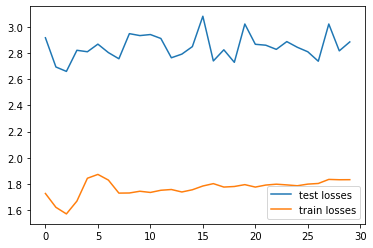

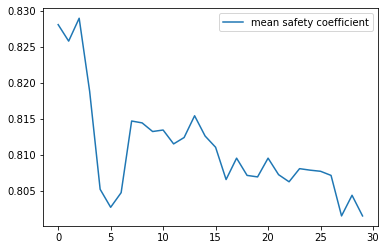

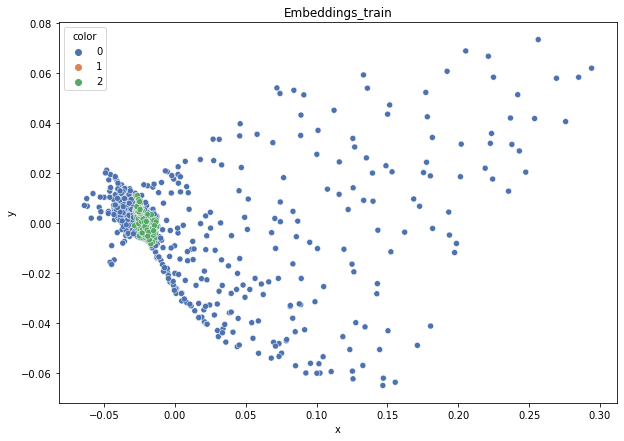

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.648
DT-f1-old+new-features: 0.695
DT-f1-old-features: 0.712
DT-gmean-new-features: 0.626
DT-gmean-old+new-features: 0.701
DT-gmean-old-features: 0.724
DT-minority_gmean-new-features: 0.066
DT-minority_gmean-old+new-features: 0.073
DT-minority_gmean-old-features: 0.076
KNN-f1-new-features: 0.703
KNN-f1-old+new-features: 0.73
KNN-f1-old-features: 0.73
KNN-gmean-new-features: 0.689
KNN-gmean-old+new-features: 0.735
KNN-gmean-old-features: 0.735
KNN-minority_gmean-new-features: 0.071
KNN-minority_gmean-old+new-features: 0.076
KNN-minority_gmean-old-features: 0.076


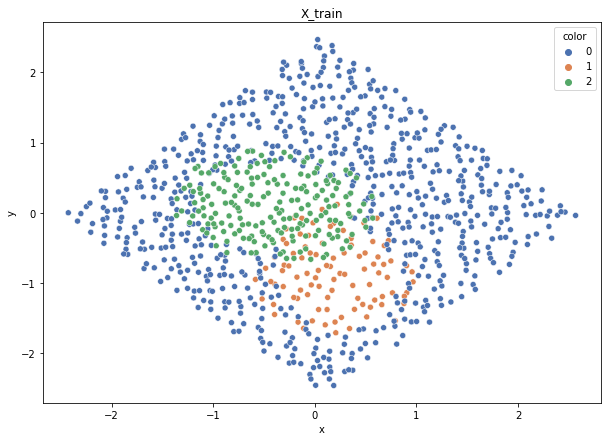

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


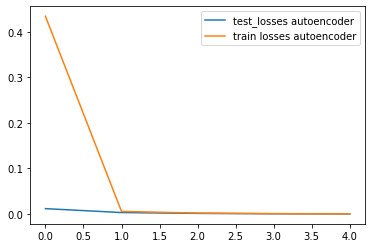

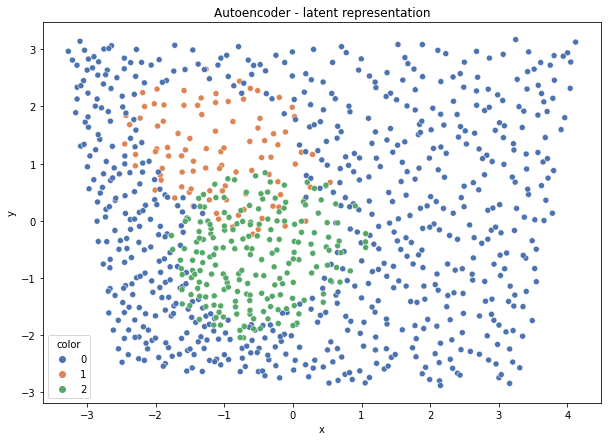

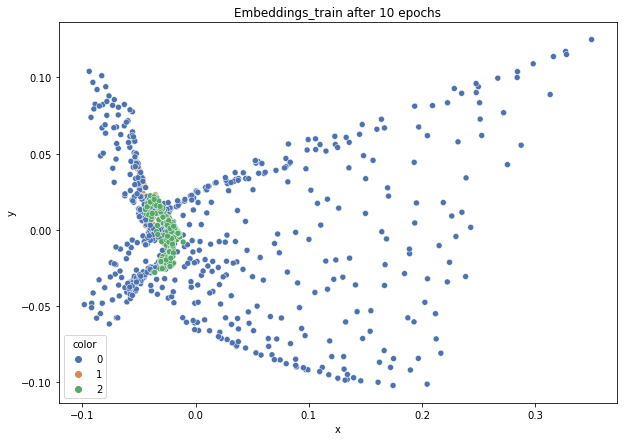

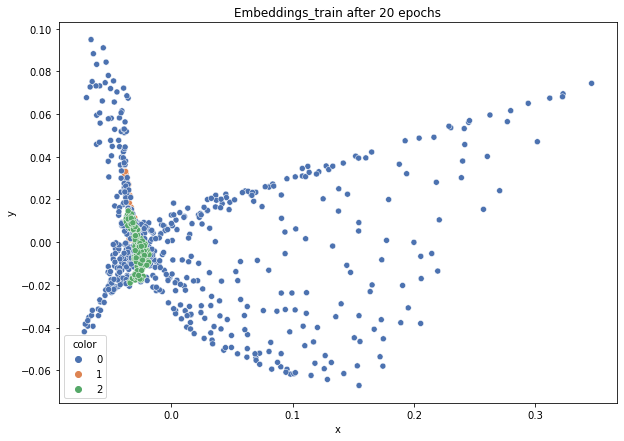

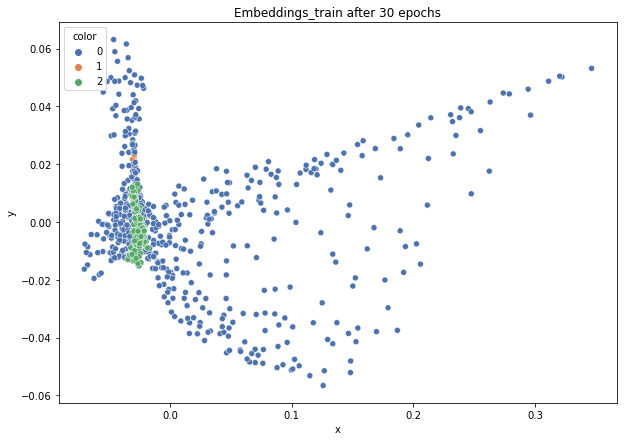

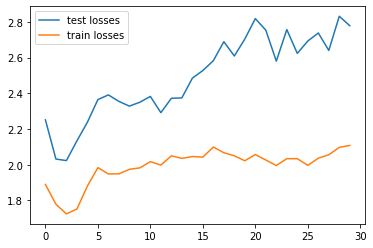

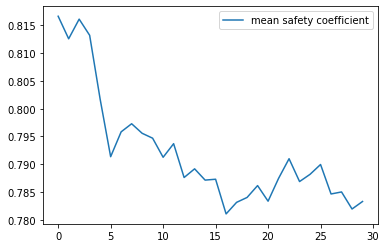

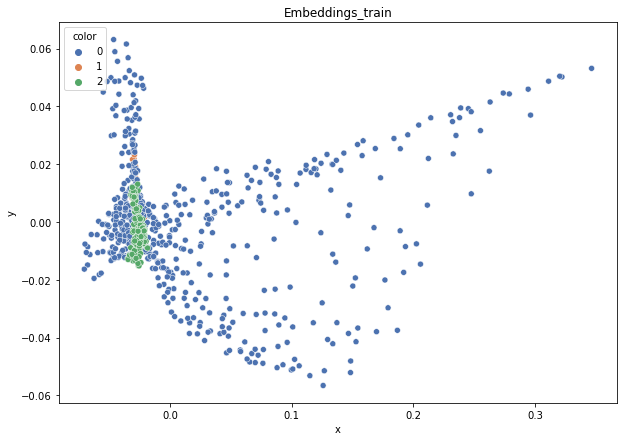

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.716
DT-f1-old+new-features: 0.704
DT-f1-old-features: 0.744
DT-gmean-new-features: 0.704
DT-gmean-old+new-features: 0.687
DT-gmean-old-features: 0.774
DT-minority_gmean-new-features: 0.073
DT-minority_gmean-old+new-features: 0.071
DT-minority_gmean-old-features: 0.082
KNN-f1-new-features: 0.725
KNN-f1-old+new-features: 0.669
KNN-f1-old-features: 0.669
KNN-gmean-new-features: 0.705
KNN-gmean-old+new-features: 0.62
KNN-gmean-old-features: 0.62
KNN-minority_gmean-new-features: 0.073
KNN-minority_gmean-old+new-features: 0.064
KNN-minority_gmean-old-features: 0.064
3mocniej-cut


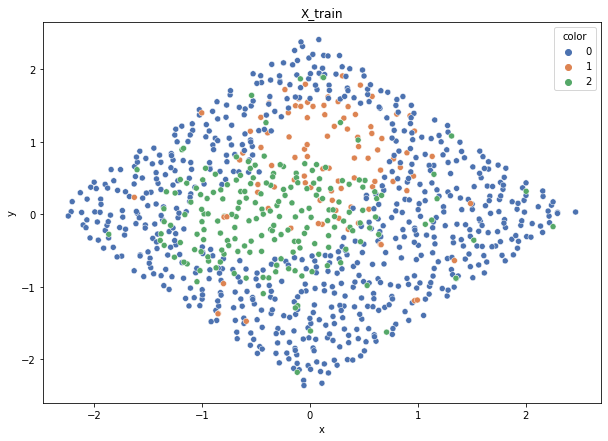

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


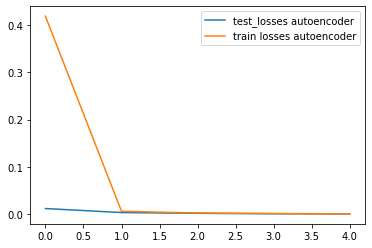

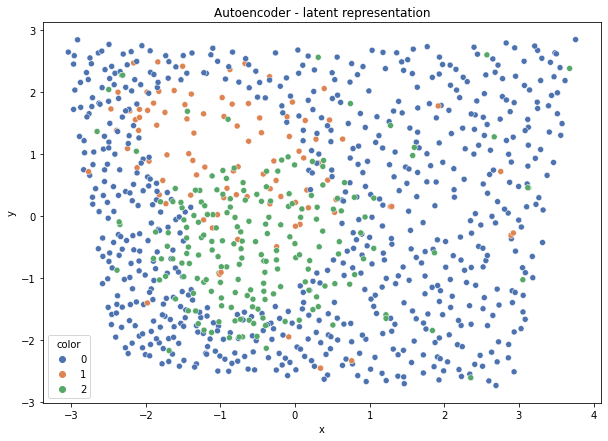

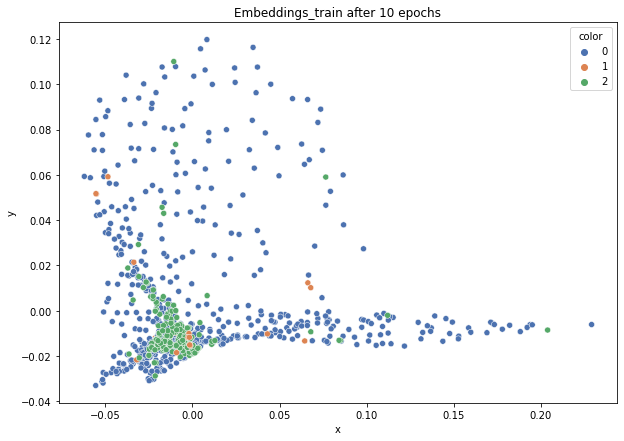

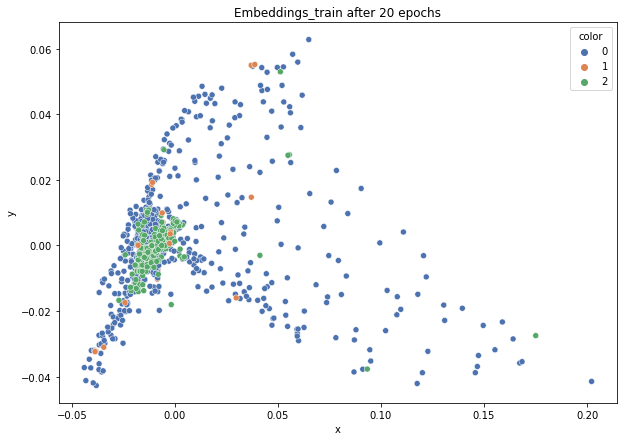

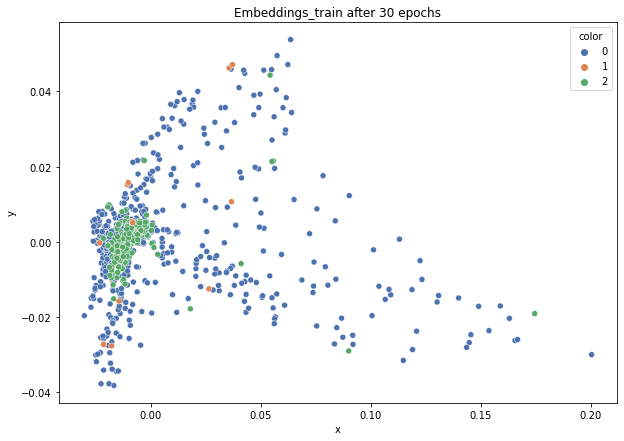

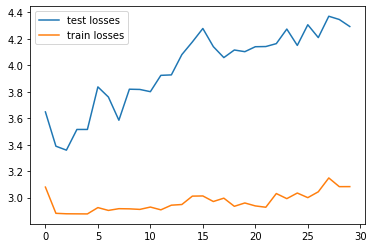

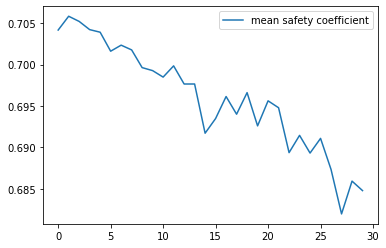

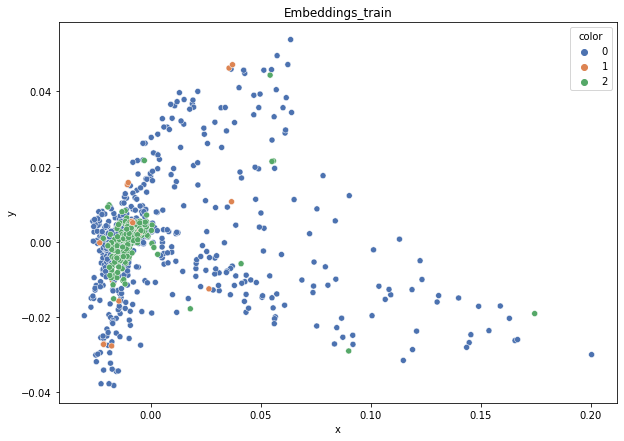

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.489
DT-f1-old+new-features: 0.519
DT-f1-old-features: 0.522
DT-gmean-new-features: 0.484
DT-gmean-old+new-features: 0.512
DT-gmean-old-features: 0.524
DT-minority_gmean-new-features: 0.054
DT-minority_gmean-old+new-features: 0.056
DT-minority_gmean-old-features: 0.059
KNN-f1-new-features: 0.431
KNN-f1-old+new-features: 0.537
KNN-f1-old-features: 0.537
KNN-gmean-new-features: 0.37
KNN-gmean-old+new-features: 0.502
KNN-gmean-old-features: 0.502
KNN-minority_gmean-new-features: 0.04
KNN-minority_gmean-old+new-features: 0.053
KNN-minority_gmean-old-features: 0.053


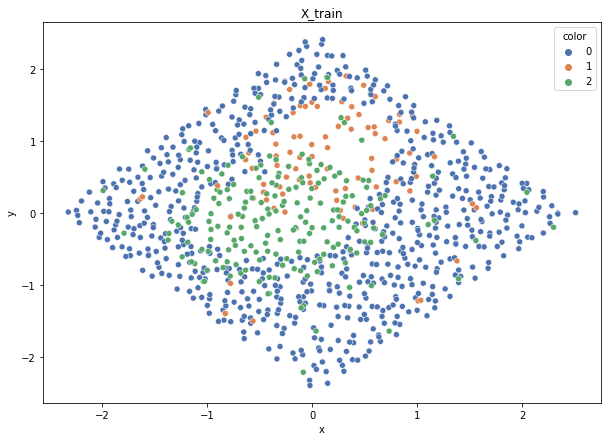

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


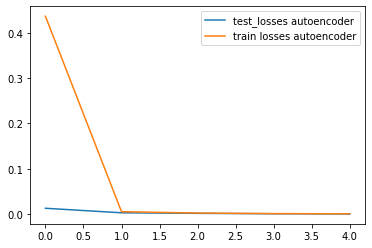

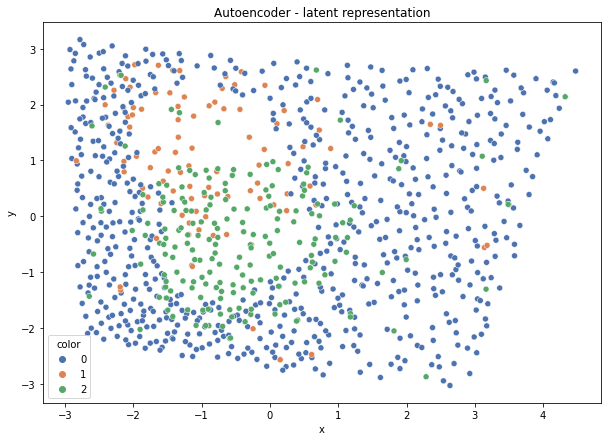

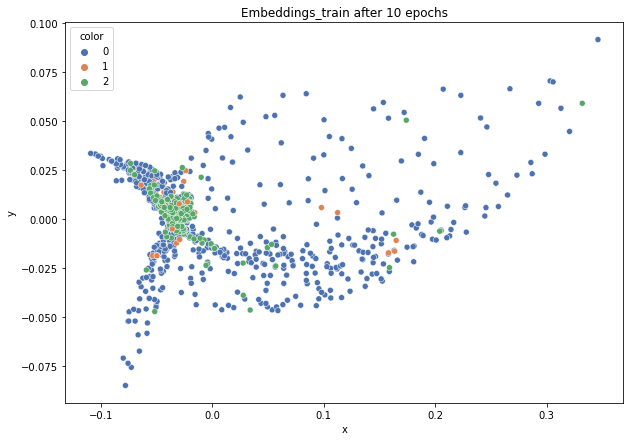

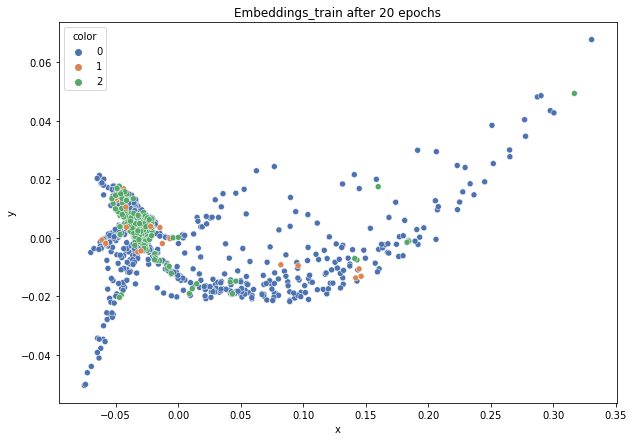

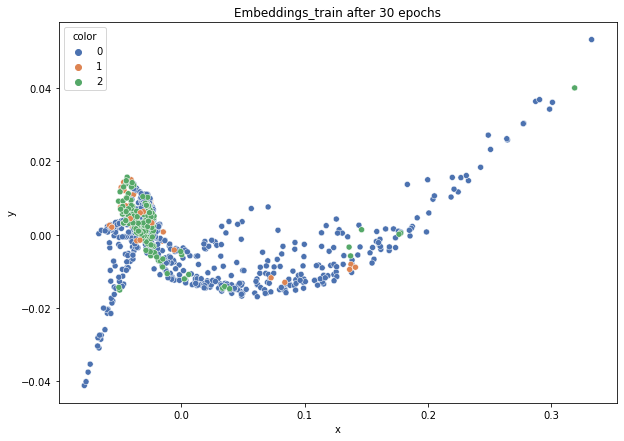

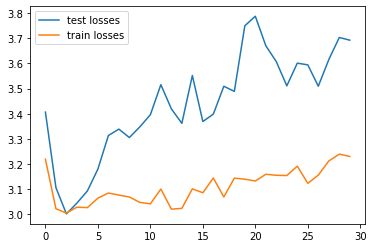

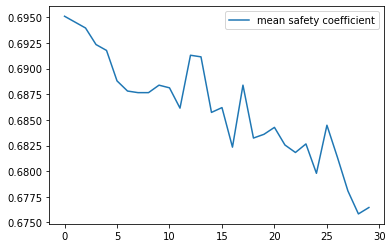

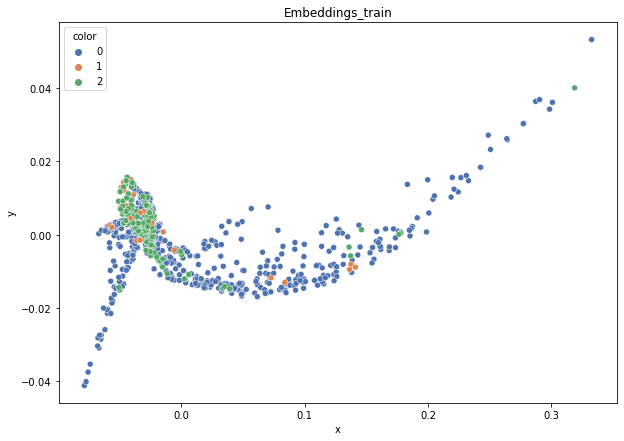

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.624
DT-f1-old+new-features: 0.605
DT-f1-old-features: 0.531
DT-gmean-new-features: 0.604
DT-gmean-old+new-features: 0.625
DT-gmean-old-features: 0.547
DT-minority_gmean-new-features: 0.064
DT-minority_gmean-old+new-features: 0.067
DT-minority_gmean-old-features: 0.06
KNN-f1-new-features: 0.587
KNN-f1-old+new-features: 0.533
KNN-f1-old-features: 0.536
KNN-gmean-new-features: 0.53
KNN-gmean-old+new-features: 0.478
KNN-gmean-old-features: 0.479
KNN-minority_gmean-new-features: 0.055
KNN-minority_gmean-old+new-features: 0.05
KNN-minority_gmean-old-features: 0.05


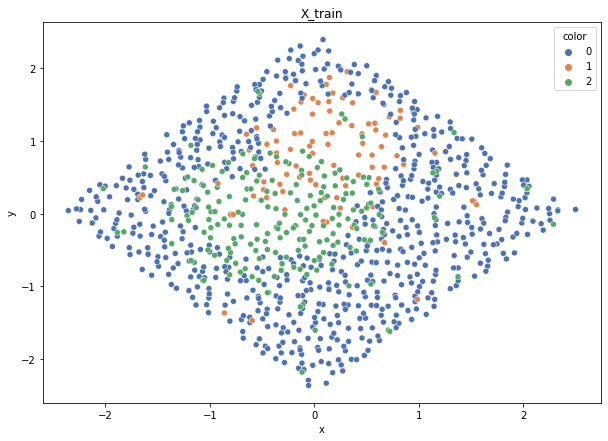

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


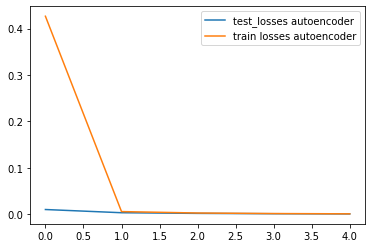

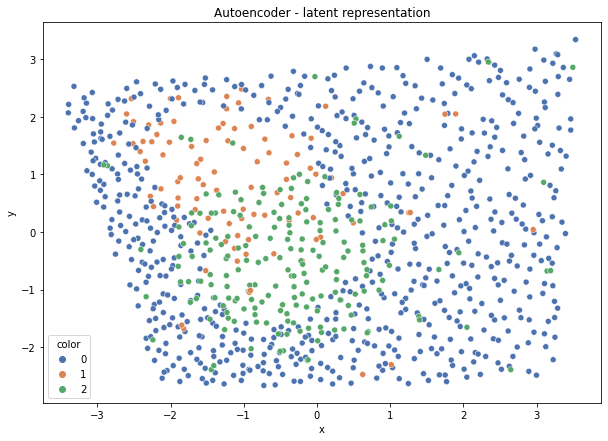

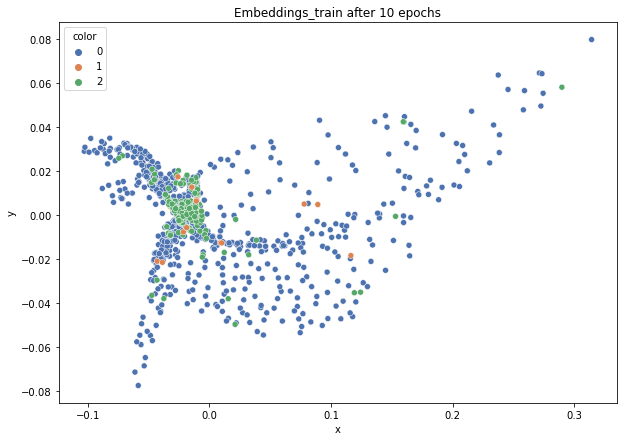

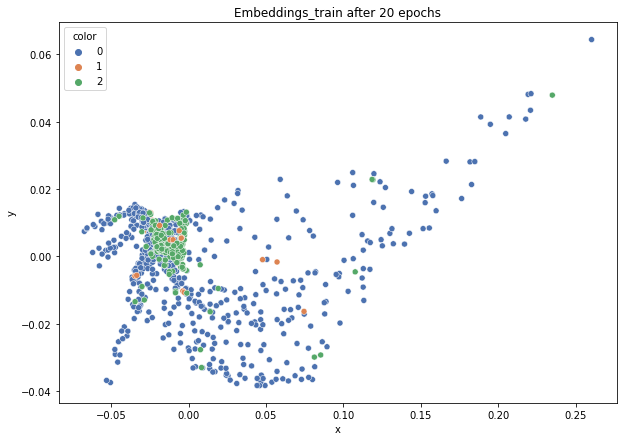

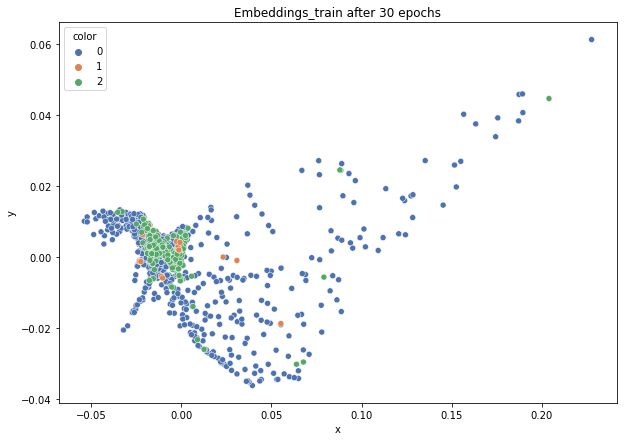

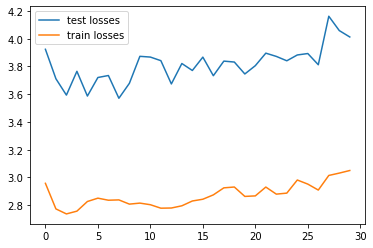

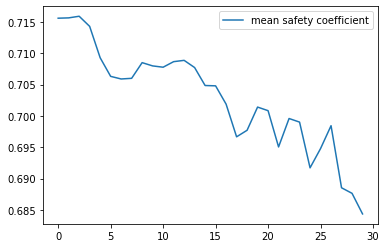

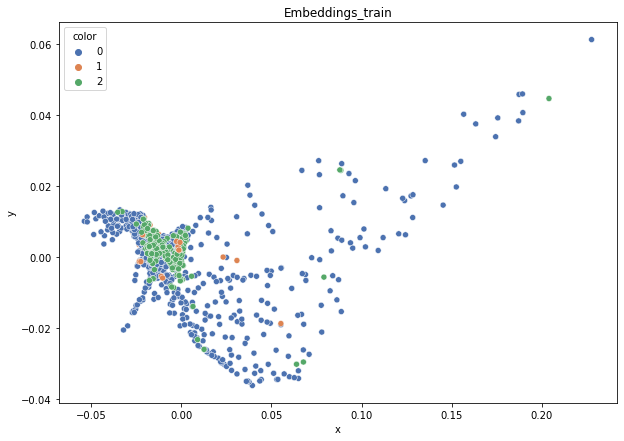

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.517
DT-f1-old+new-features: 0.497
DT-f1-old-features: 0.442
DT-gmean-new-features: 0.517
DT-gmean-old+new-features: 0.468
DT-gmean-old-features: 0.43
DT-minority_gmean-new-features: 0.057
DT-minority_gmean-old+new-features: 0.051
DT-minority_gmean-old-features: 0.049
KNN-f1-new-features: 0.45
KNN-f1-old+new-features: 0.438
KNN-f1-old-features: 0.438
KNN-gmean-new-features: 0.388
KNN-gmean-old+new-features: 0.373
KNN-gmean-old-features: 0.373
KNN-minority_gmean-new-features: 0.042
KNN-minority_gmean-old+new-features: 0.04
KNN-minority_gmean-old-features: 0.04


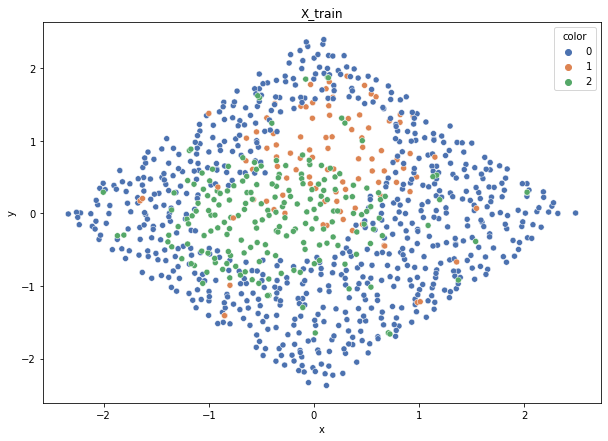

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


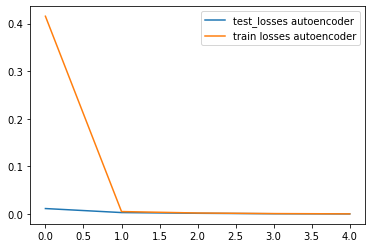

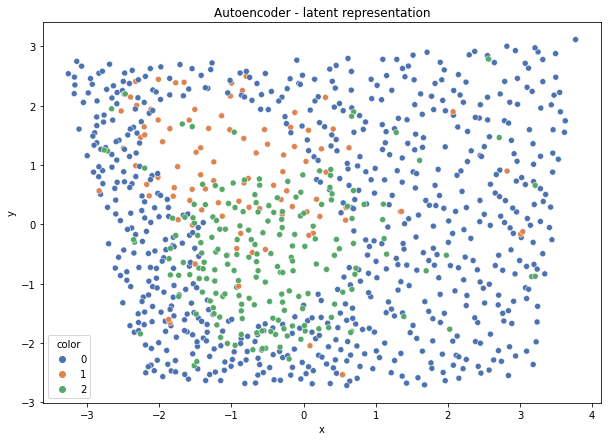

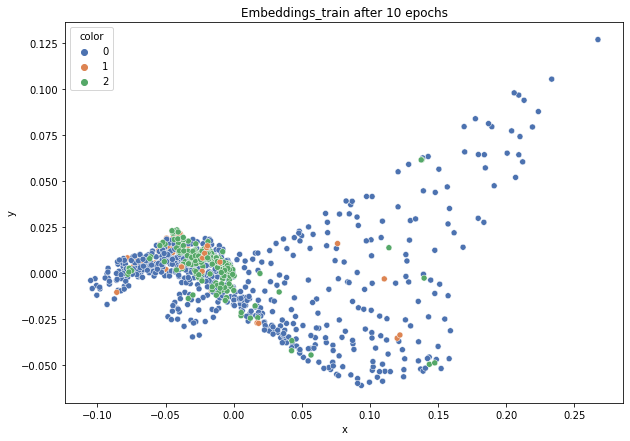

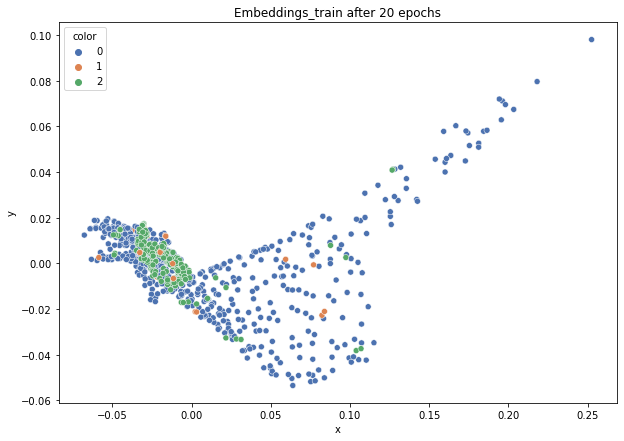

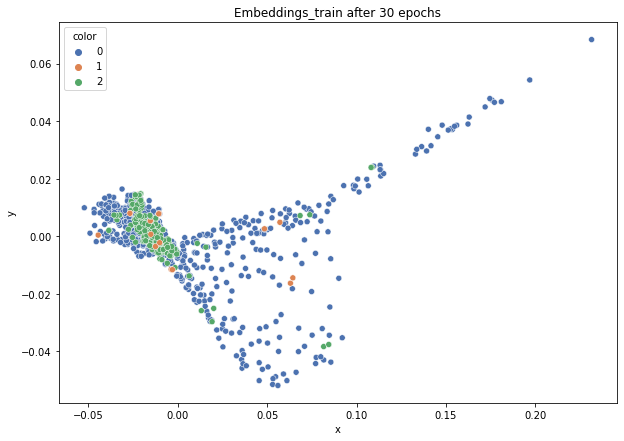

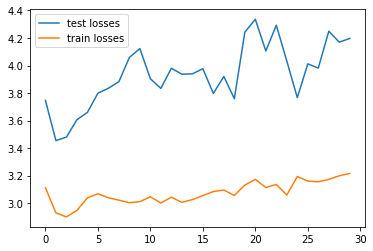

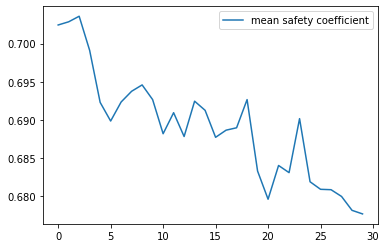

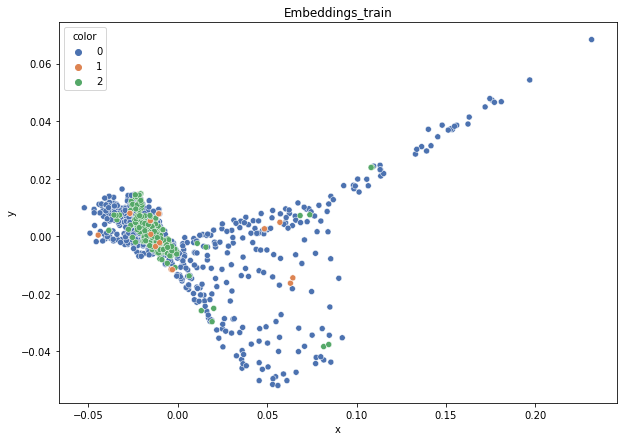

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.496
DT-f1-old+new-features: 0.499
DT-f1-old-features: 0.477
DT-gmean-new-features: 0.453
DT-gmean-old+new-features: 0.46
DT-gmean-old-features: 0.473
DT-minority_gmean-new-features: 0.049
DT-minority_gmean-old+new-features: 0.05
DT-minority_gmean-old-features: 0.053
KNN-f1-new-features: 0.495
KNN-f1-old+new-features: 0.51
KNN-f1-old-features: 0.51
KNN-gmean-new-features: 0.445
KNN-gmean-old+new-features: 0.464
KNN-gmean-old-features: 0.464
KNN-minority_gmean-new-features: 0.048
KNN-minority_gmean-old+new-features: 0.05
KNN-minority_gmean-old-features: 0.05


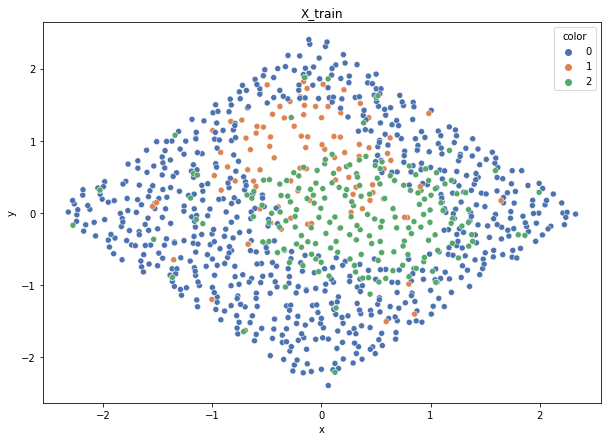

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


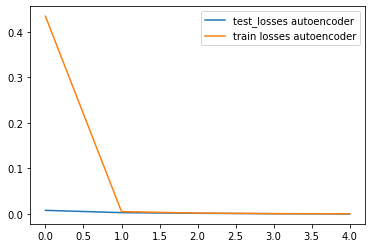

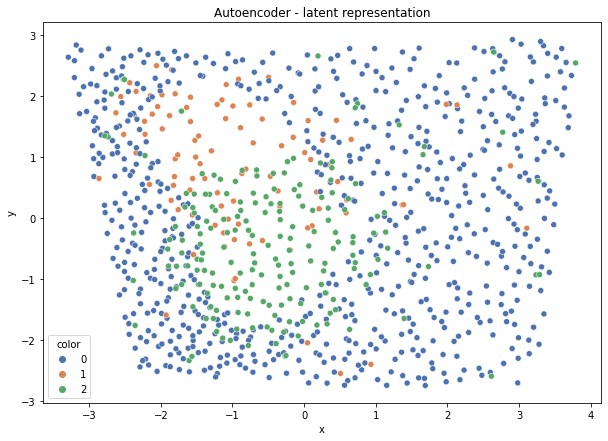

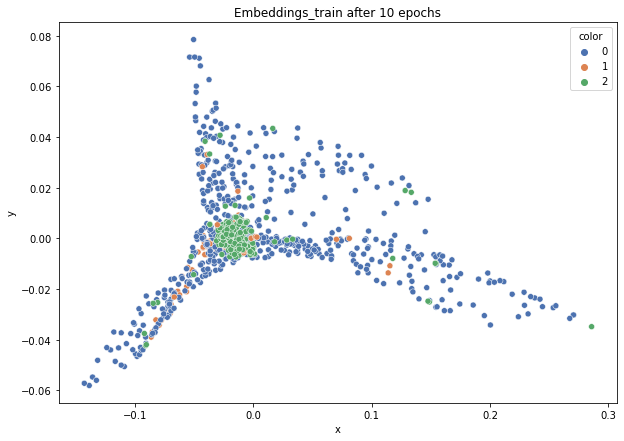

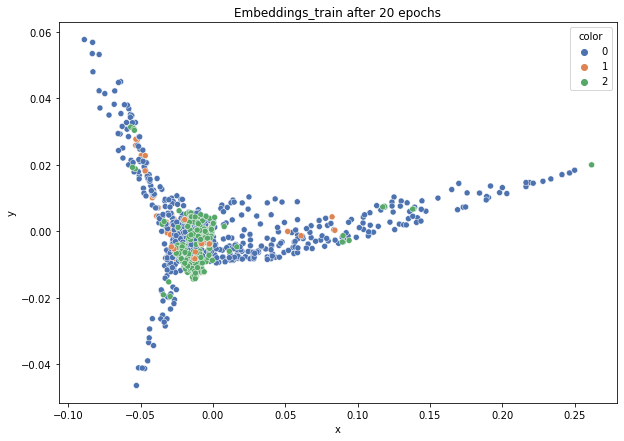

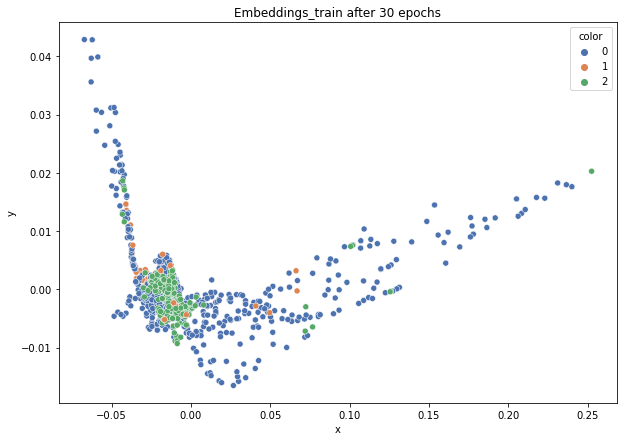

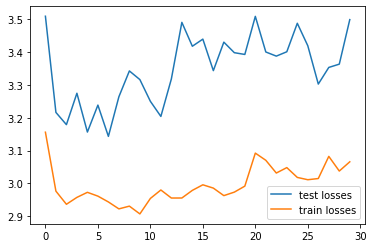

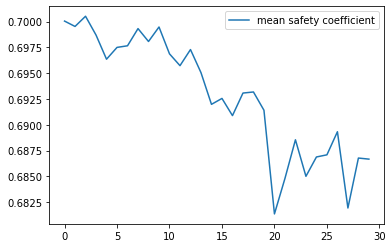

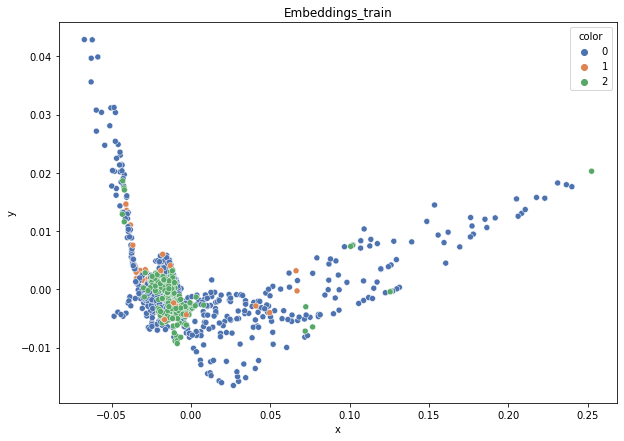

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.528
DT-f1-old+new-features: 0.512
DT-f1-old-features: 0.552
DT-gmean-new-features: 0.509
DT-gmean-old+new-features: 0.452
DT-gmean-old-features: 0.536
DT-minority_gmean-new-features: 0.055
DT-minority_gmean-old+new-features: 0.048
DT-minority_gmean-old-features: 0.058
KNN-f1-new-features: 0.507
KNN-f1-old+new-features: 0.522
KNN-f1-old-features: 0.522
KNN-gmean-new-features: 0.421
KNN-gmean-old+new-features: 0.471
KNN-gmean-old-features: 0.471
KNN-minority_gmean-new-features: 0.045
KNN-minority_gmean-old+new-features: 0.05
KNN-minority_gmean-old-features: 0.05
4delikatne-bezover-cut


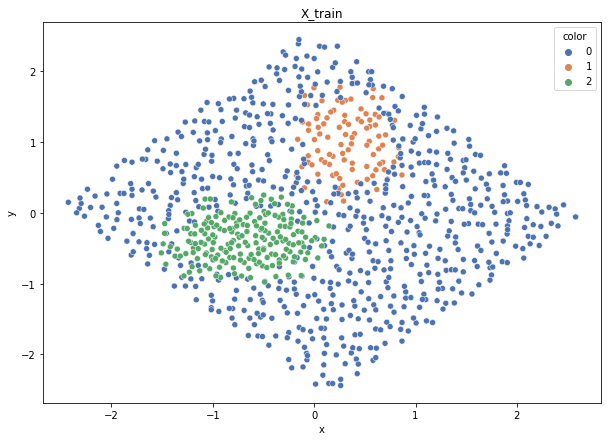

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


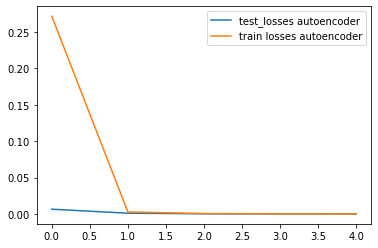

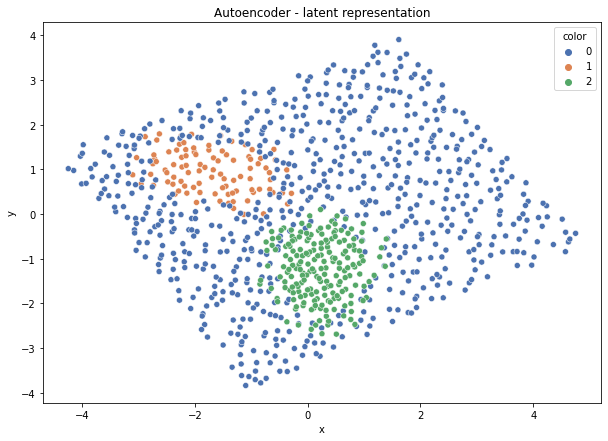

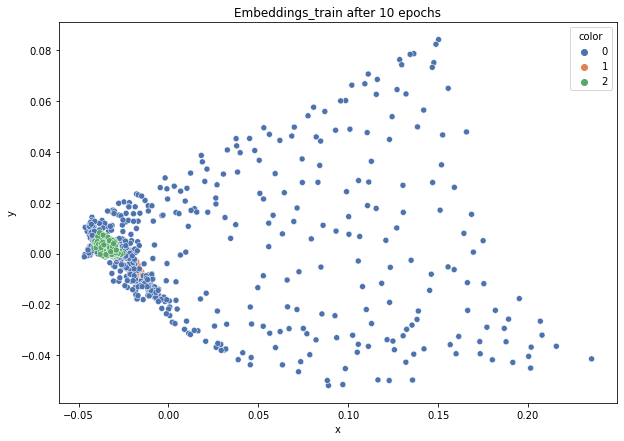

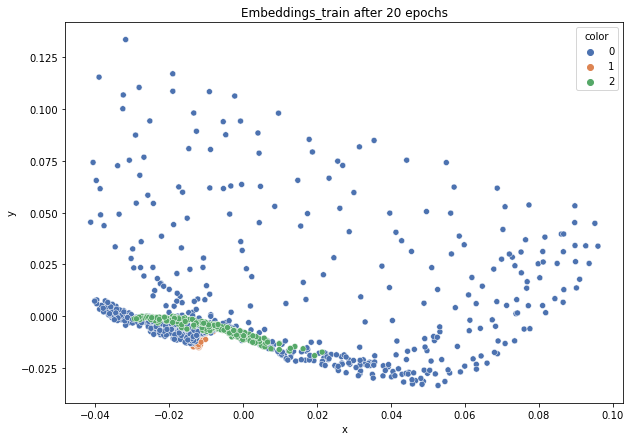

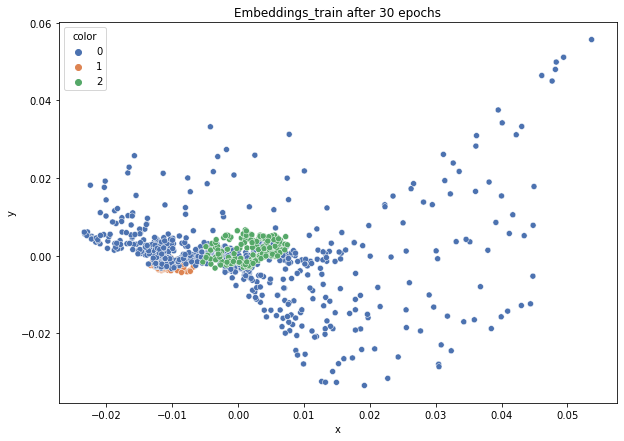

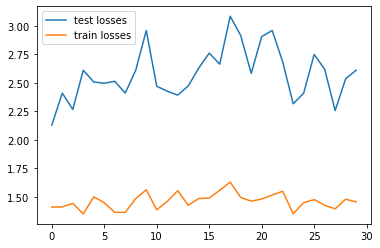

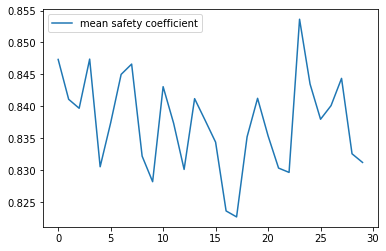

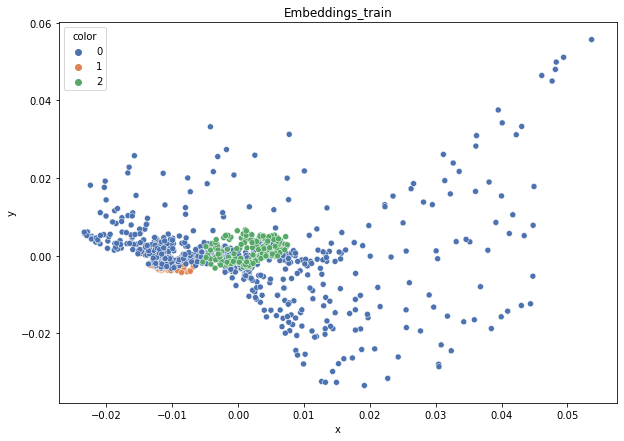

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.818
DT-f1-old+new-features: 0.789
DT-f1-old-features: 0.809
DT-gmean-new-features: 0.823
DT-gmean-old+new-features: 0.786
DT-gmean-old-features: 0.814
DT-minority_gmean-new-features: 0.085
DT-minority_gmean-old+new-features: 0.082
DT-minority_gmean-old-features: 0.085
KNN-f1-new-features: 0.743
KNN-f1-old+new-features: 0.772
KNN-f1-old-features: 0.772
KNN-gmean-new-features: 0.722
KNN-gmean-old+new-features: 0.746
KNN-gmean-old-features: 0.746
KNN-minority_gmean-new-features: 0.075
KNN-minority_gmean-old+new-features: 0.078
KNN-minority_gmean-old-features: 0.078


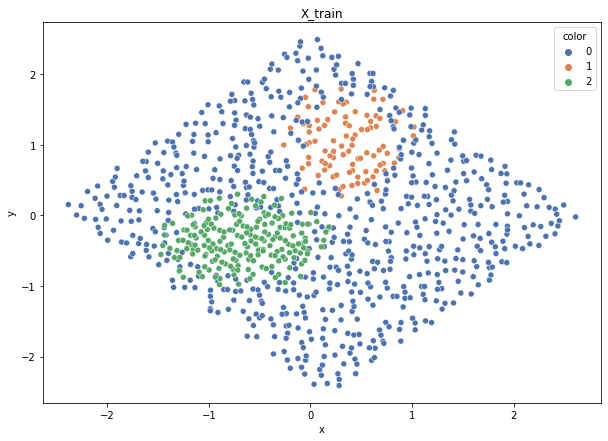

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


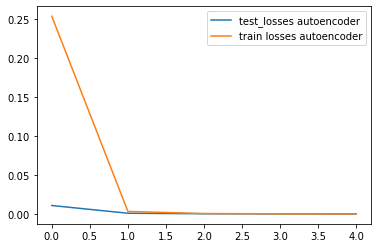

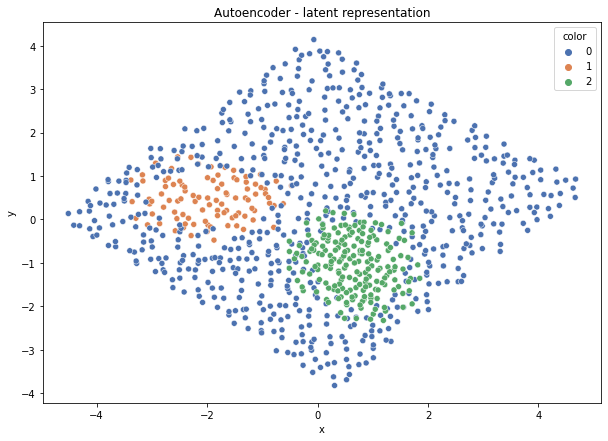

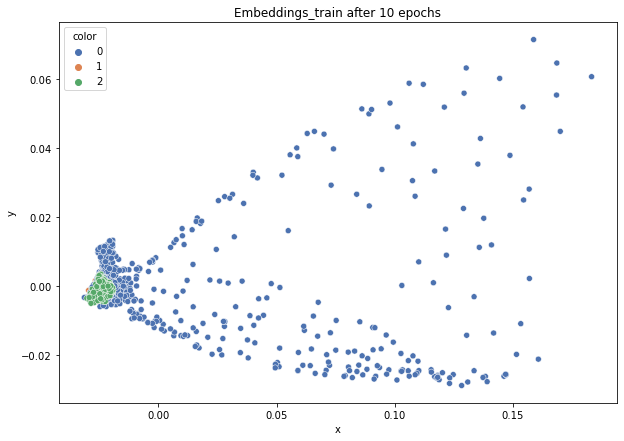

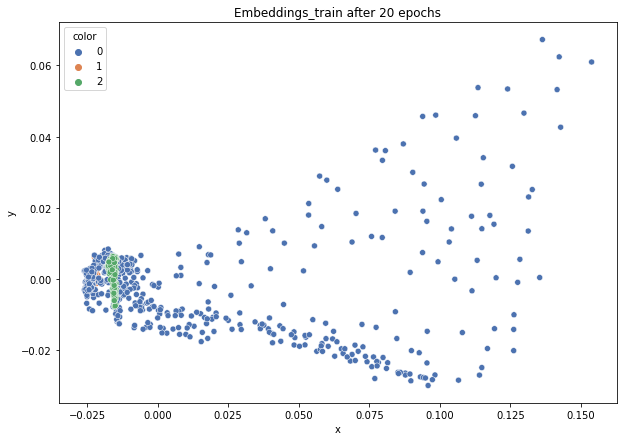

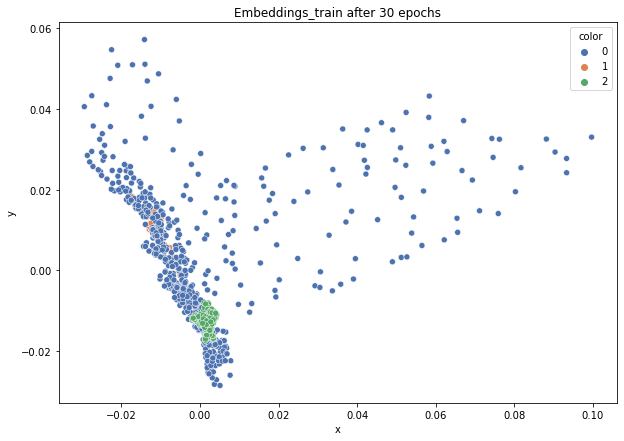

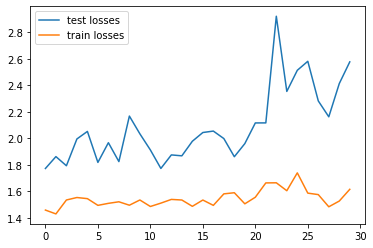

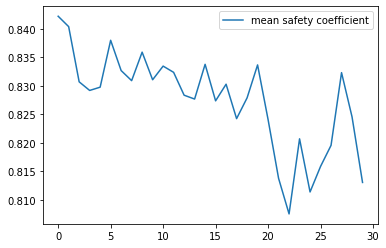

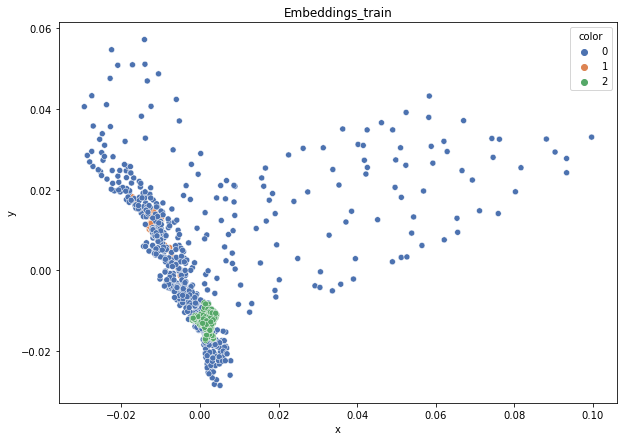

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.778
DT-f1-old+new-features: 0.793
DT-f1-old-features: 0.761
DT-gmean-new-features: 0.778
DT-gmean-old+new-features: 0.806
DT-gmean-old-features: 0.769
DT-minority_gmean-new-features: 0.081
DT-minority_gmean-old+new-features: 0.084
DT-minority_gmean-old-features: 0.08
KNN-f1-new-features: 0.758
KNN-f1-old+new-features: 0.767
KNN-f1-old-features: 0.767
KNN-gmean-new-features: 0.773
KNN-gmean-old+new-features: 0.776
KNN-gmean-old-features: 0.776
KNN-minority_gmean-new-features: 0.081
KNN-minority_gmean-old+new-features: 0.081
KNN-minority_gmean-old-features: 0.081


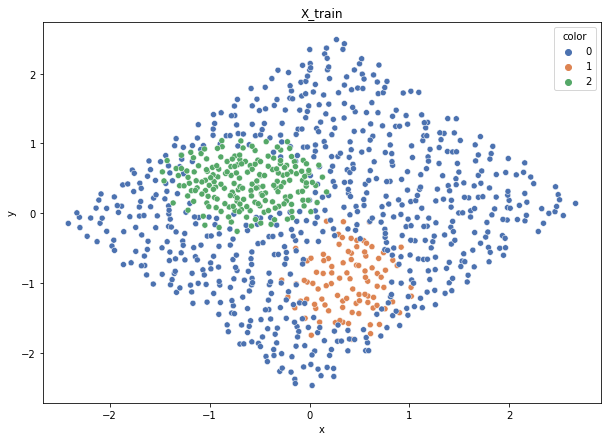

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


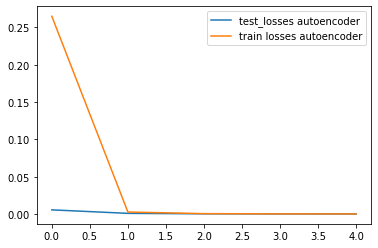

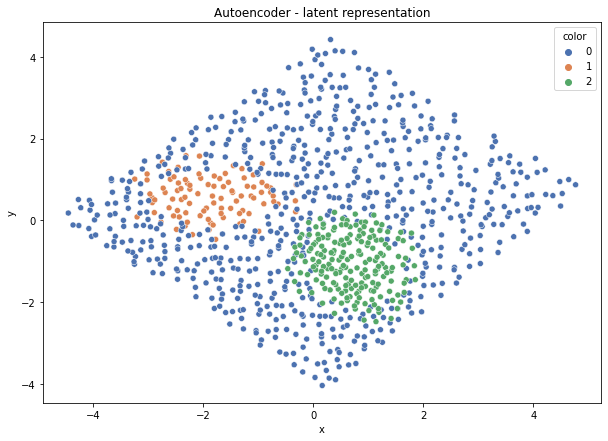

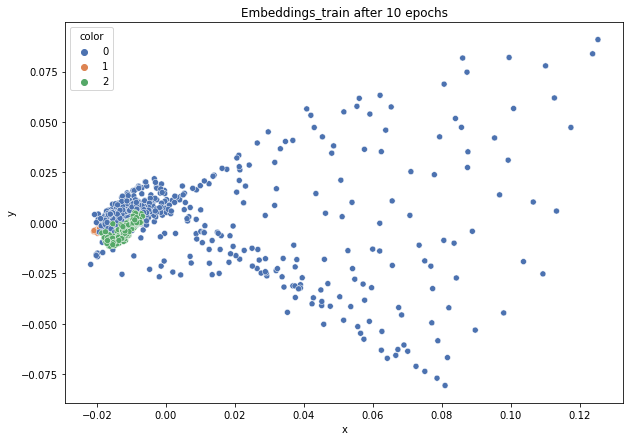

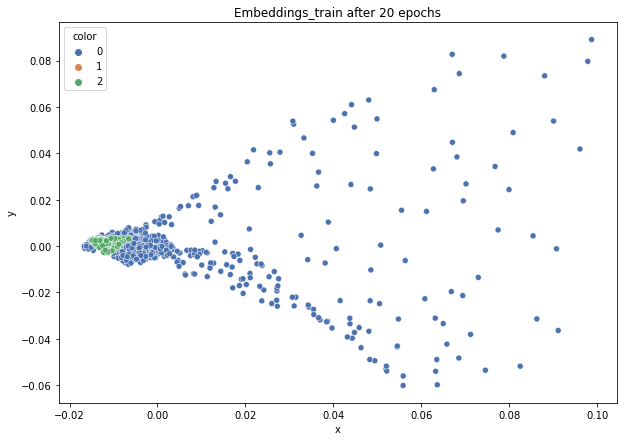

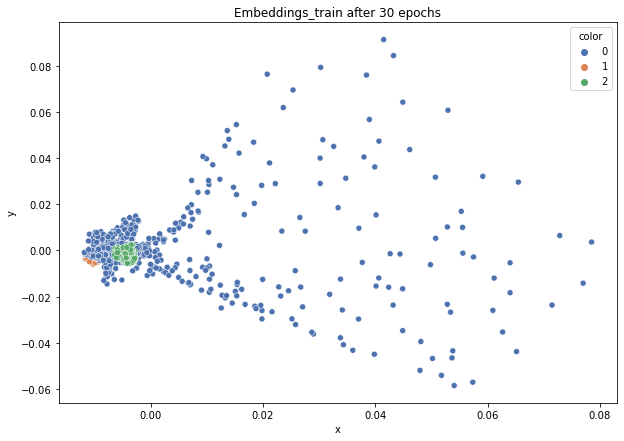

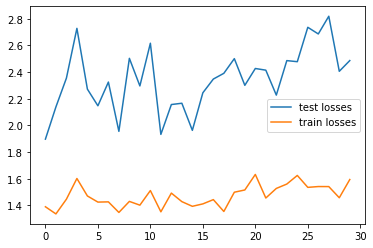

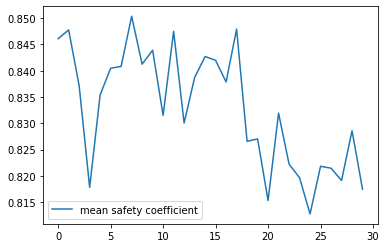

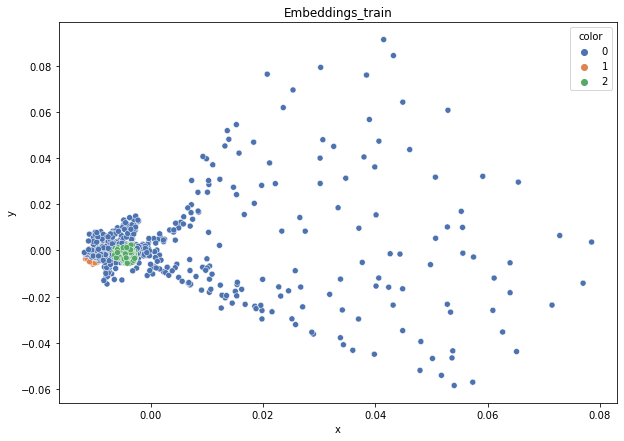

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.784
DT-f1-old+new-features: 0.764
DT-f1-old-features: 0.785
DT-gmean-new-features: 0.763
DT-gmean-old+new-features: 0.734
DT-gmean-old-features: 0.785
DT-minority_gmean-new-features: 0.079
DT-minority_gmean-old+new-features: 0.076
DT-minority_gmean-old-features: 0.082
KNN-f1-new-features: 0.764
KNN-f1-old+new-features: 0.766
KNN-f1-old-features: 0.766
KNN-gmean-new-features: 0.764
KNN-gmean-old+new-features: 0.744
KNN-gmean-old-features: 0.744
KNN-minority_gmean-new-features: 0.08
KNN-minority_gmean-old+new-features: 0.077
KNN-minority_gmean-old-features: 0.077


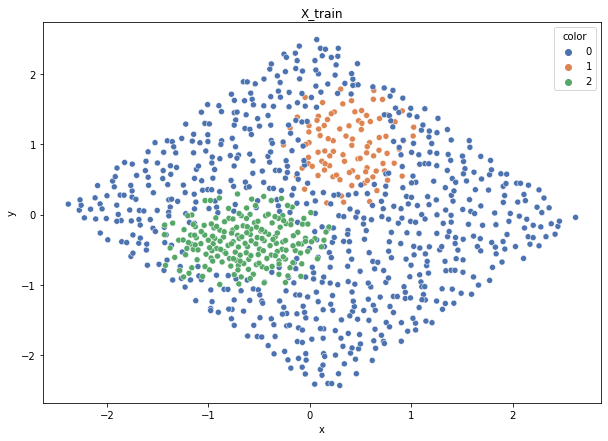

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


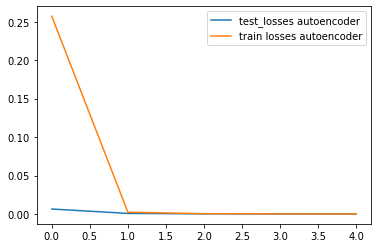

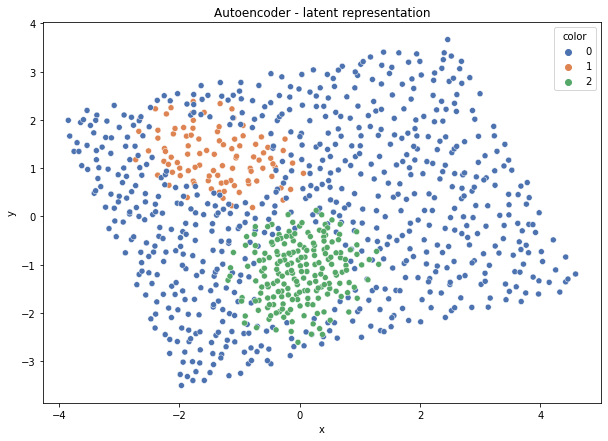

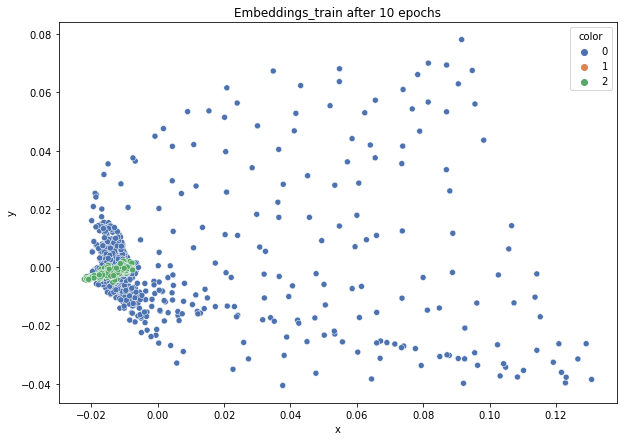

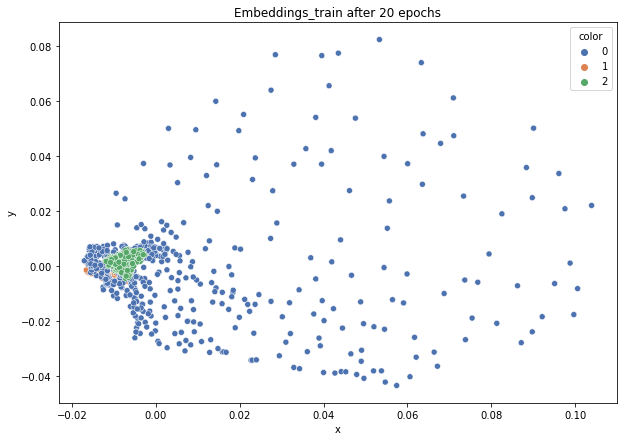

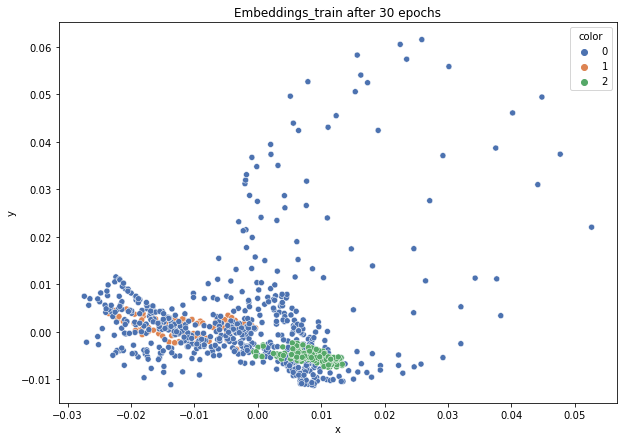

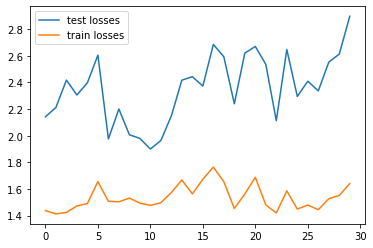

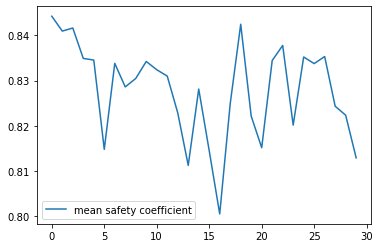

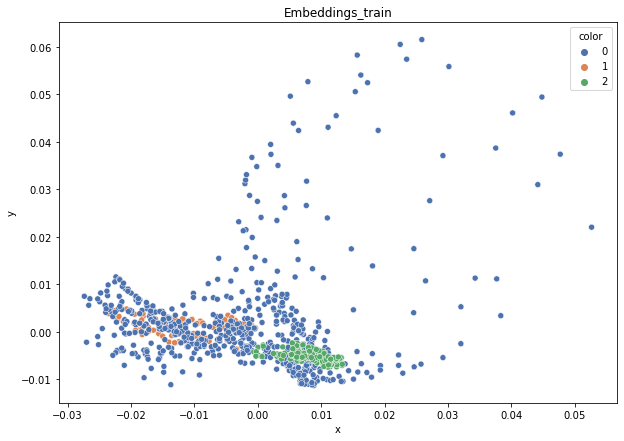

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.798
DT-f1-old+new-features: 0.781
DT-f1-old-features: 0.805
DT-gmean-new-features: 0.822
DT-gmean-old+new-features: 0.833
DT-gmean-old-features: 0.831
DT-minority_gmean-new-features: 0.086
DT-minority_gmean-old+new-features: 0.089
DT-minority_gmean-old-features: 0.087
KNN-f1-new-features: 0.769
KNN-f1-old+new-features: 0.747
KNN-f1-old-features: 0.747
KNN-gmean-new-features: 0.767
KNN-gmean-old+new-features: 0.749
KNN-gmean-old-features: 0.749
KNN-minority_gmean-new-features: 0.08
KNN-minority_gmean-old+new-features: 0.079
KNN-minority_gmean-old-features: 0.079


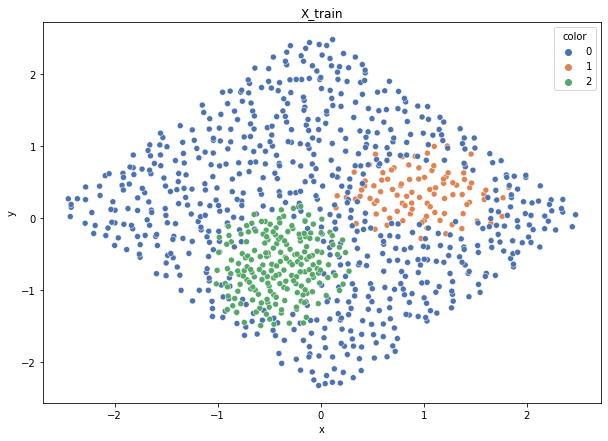

Class cardinalities: Counter({0: 672, 2: 192, 1: 96})
Weights: {1: 0.6086956521739131, 0: 0.08695652173913043, 2: 0.30434782608695654}
Training autoencoder...


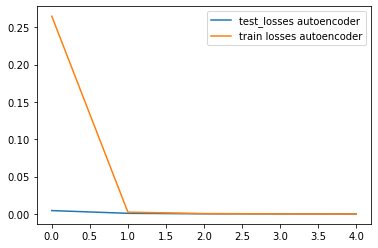

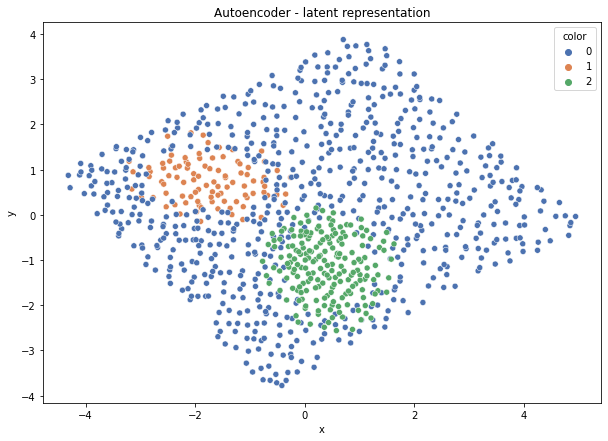

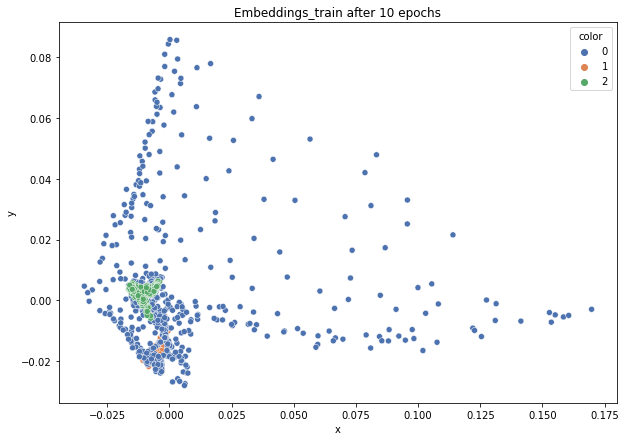

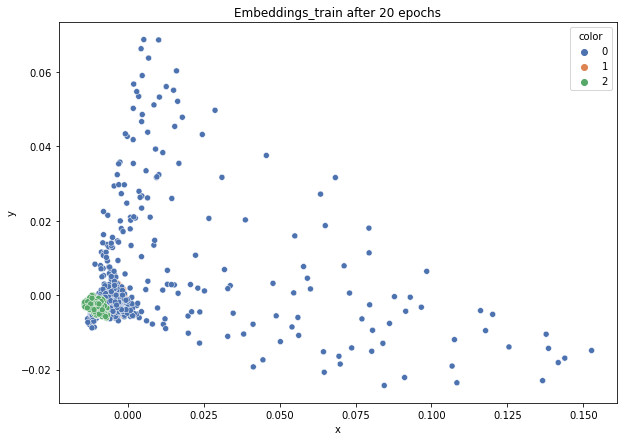

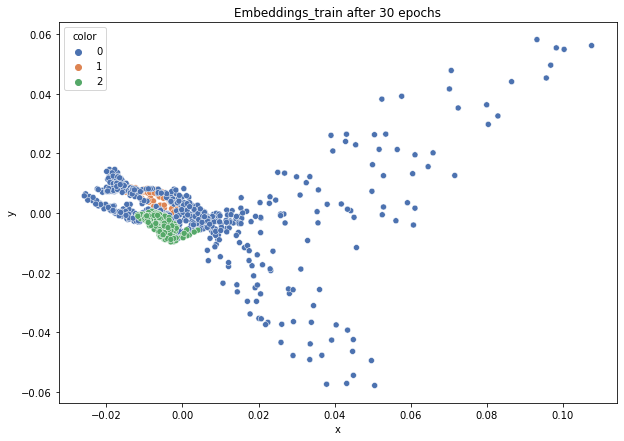

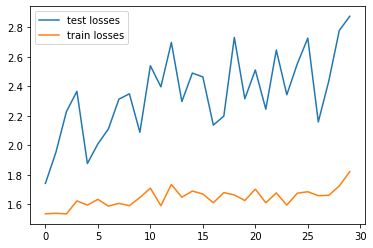

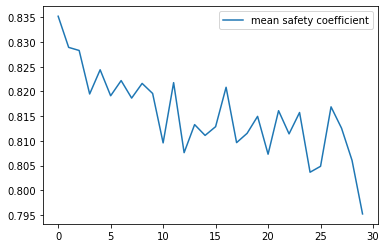

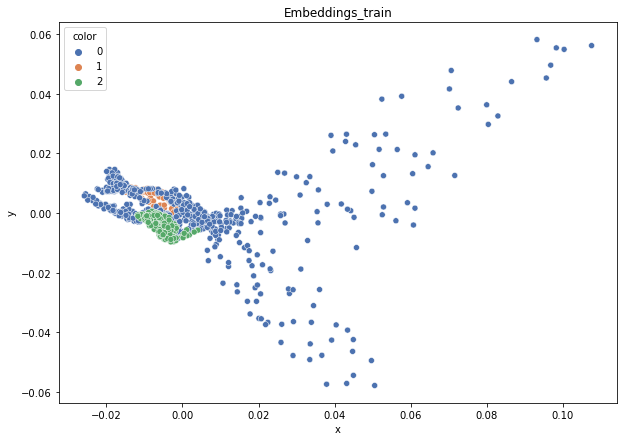

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.808
DT-f1-old+new-features: 0.825
DT-f1-old-features: 0.821
DT-gmean-new-features: 0.82
DT-gmean-old+new-features: 0.817
DT-gmean-old-features: 0.866
DT-minority_gmean-new-features: 0.085
DT-minority_gmean-old+new-features: 0.084
DT-minority_gmean-old-features: 0.091
KNN-f1-new-features: 0.793
KNN-f1-old+new-features: 0.786
KNN-f1-old-features: 0.786
KNN-gmean-new-features: 0.804
KNN-gmean-old+new-features: 0.788
KNN-gmean-old-features: 0.788
KNN-minority_gmean-new-features: 0.084
KNN-minority_gmean-old+new-features: 0.082
KNN-minority_gmean-old-features: 0.082
balance-scale


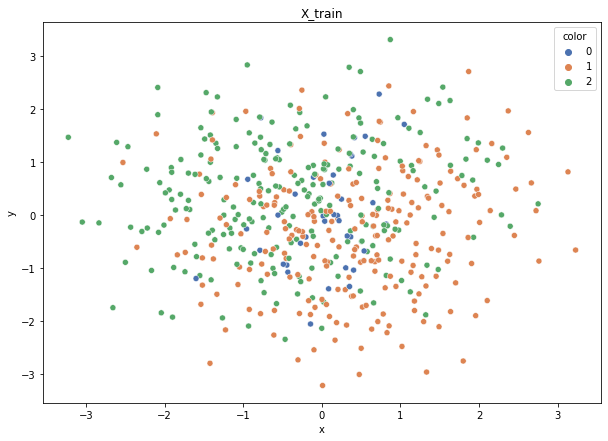

Class cardinalities: Counter({1: 231, 2: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.1266928236932034, 1: 0.12614436991098174}
Training autoencoder...


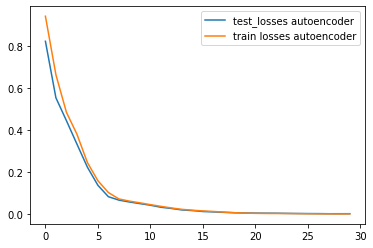

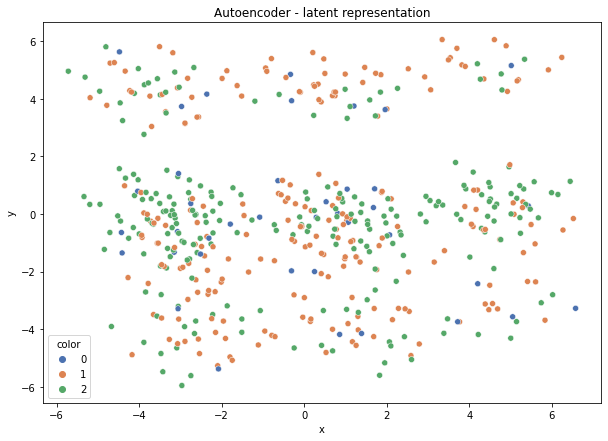

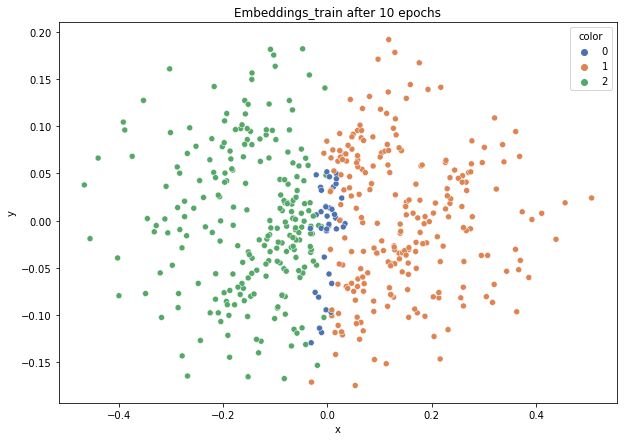

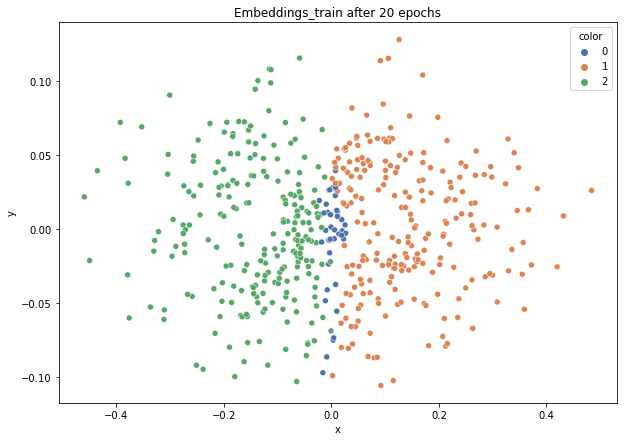

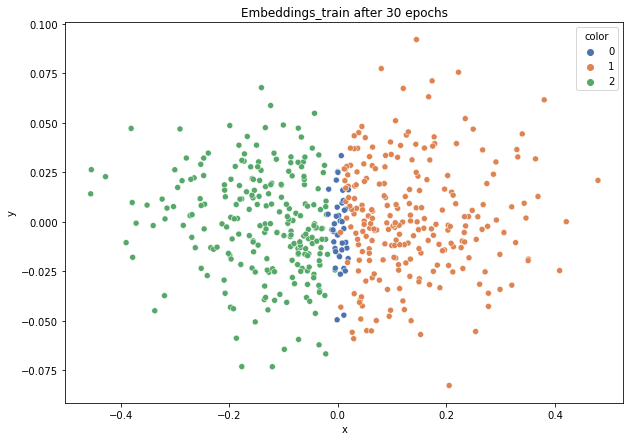

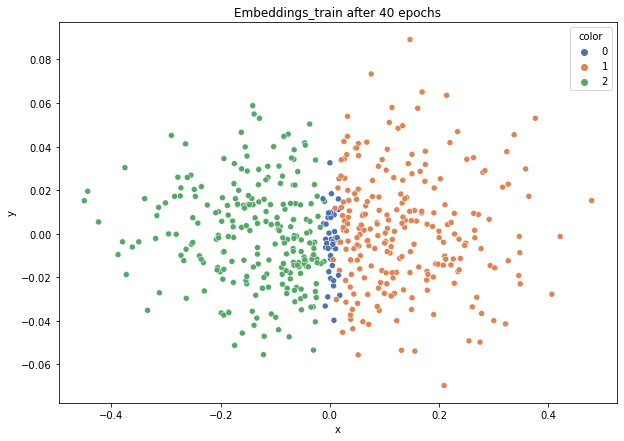

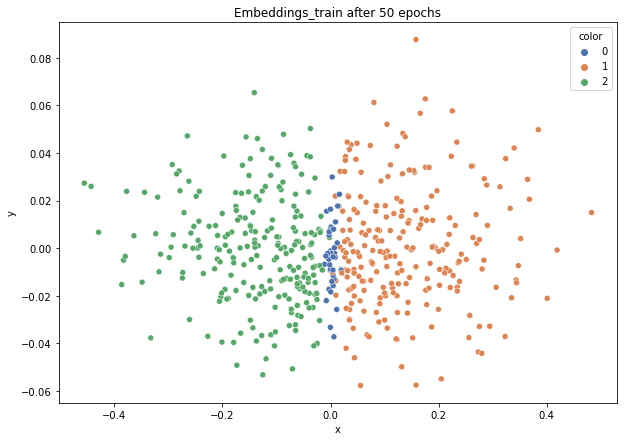

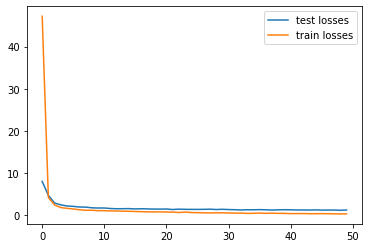

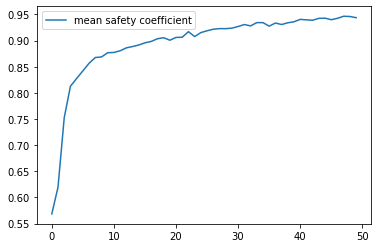

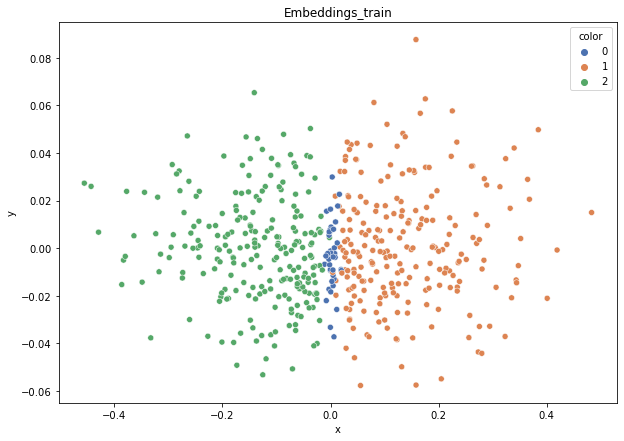

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.799
DT-f1-old+new-features: 0.799
DT-f1-old-features: 0.568
DT-gmean-new-features: 0.766
DT-gmean-old+new-features: 0.766
DT-gmean-old-features: 0.088
DT-minority_gmean-new-features: 0.008
DT-minority_gmean-old+new-features: 0.008
DT-minority_gmean-old-features: 0.001
KNN-f1-new-features: 0.829
KNN-f1-old+new-features: 0.592
KNN-f1-old-features: 0.568
KNN-gmean-new-features: 0.78
KNN-gmean-old+new-features: 0.093
KNN-gmean-old-features: 0.09
KNN-minority_gmean-new-features: 0.008
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001


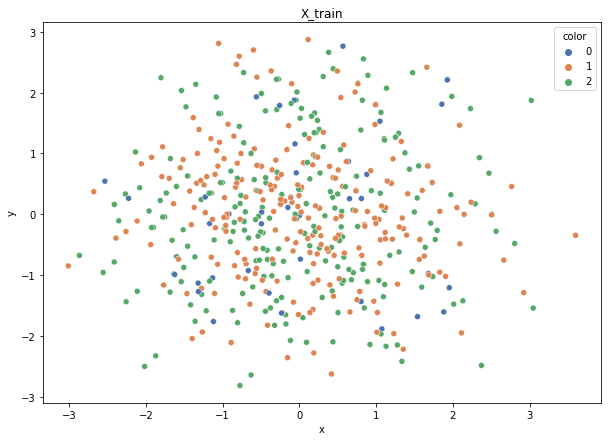

Class cardinalities: Counter({1: 231, 2: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.1266928236932034, 1: 0.12614436991098174}
Training autoencoder...


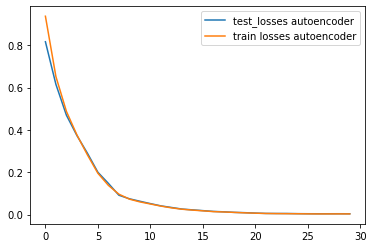

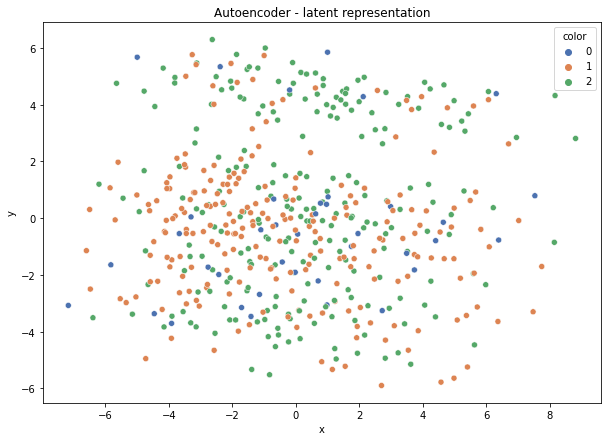

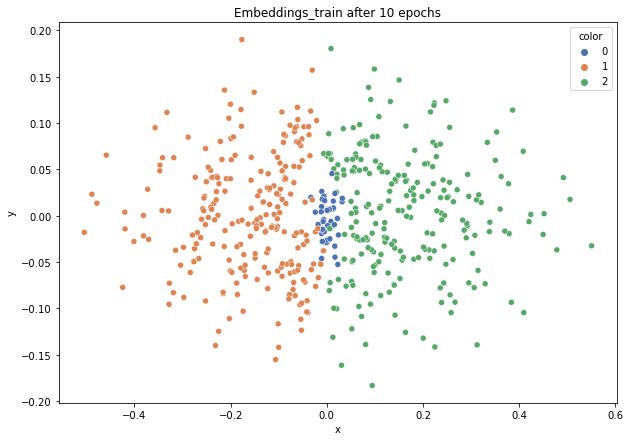

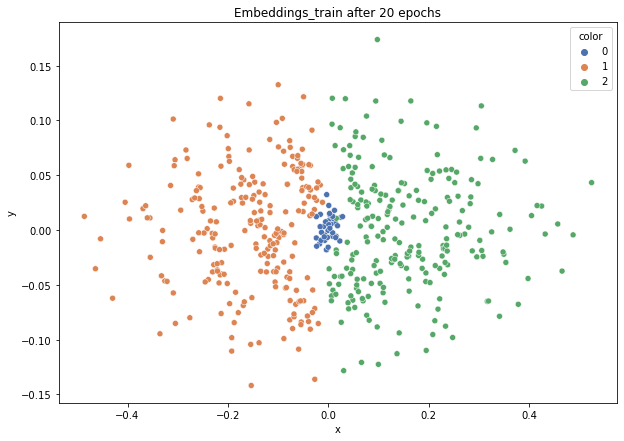

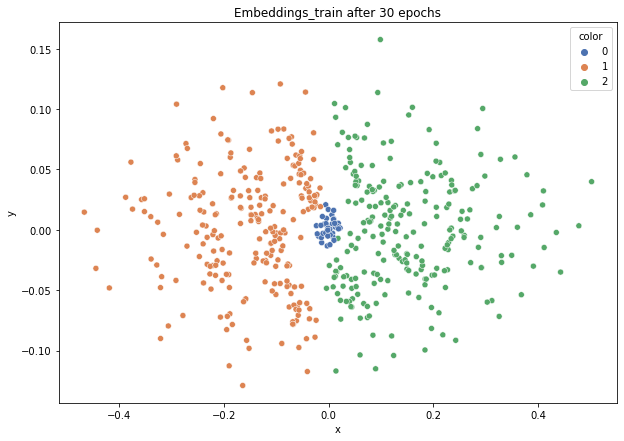

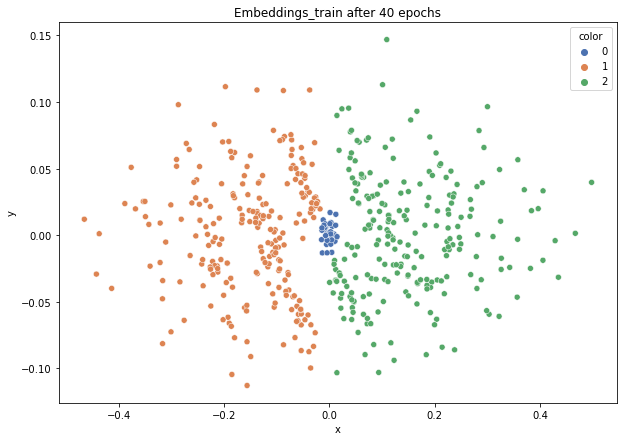

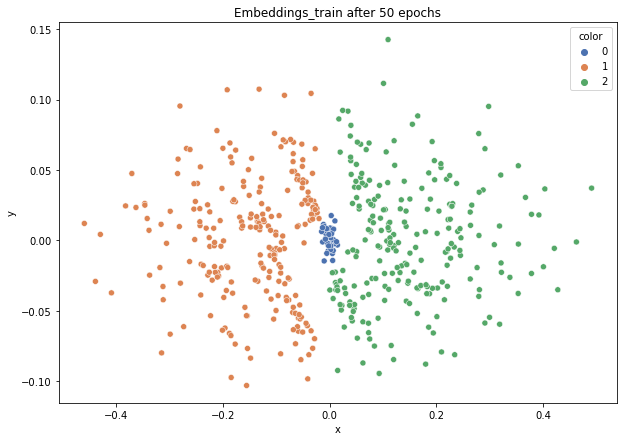

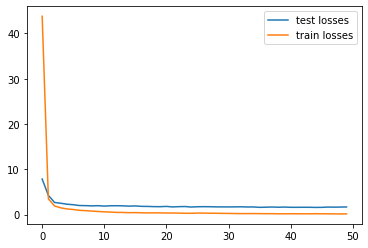

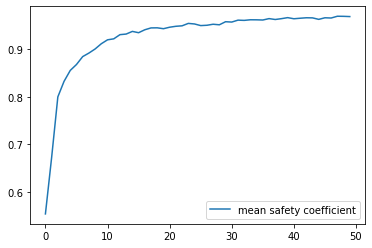

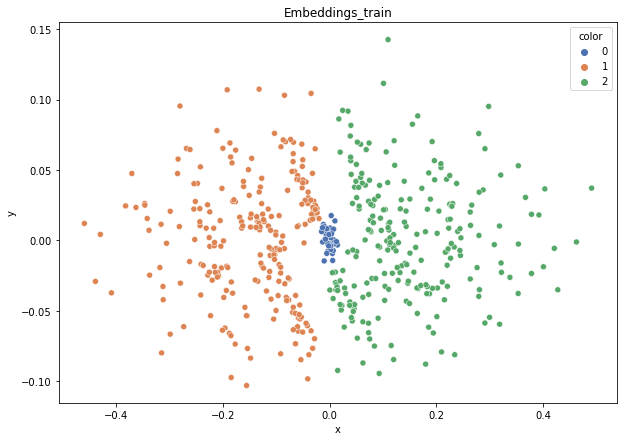

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.799
DT-f1-old+new-features: 0.799
DT-f1-old-features: 0.638
DT-gmean-new-features: 0.761
DT-gmean-old+new-features: 0.761
DT-gmean-old-features: 0.585
DT-minority_gmean-new-features: 0.008
DT-minority_gmean-old+new-features: 0.008
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.933
KNN-f1-old+new-features: 0.583
KNN-f1-old-features: 0.545
KNN-gmean-new-features: 0.917
KNN-gmean-old+new-features: 0.092
KNN-gmean-old-features: 0.088
KNN-minority_gmean-new-features: 0.009
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001


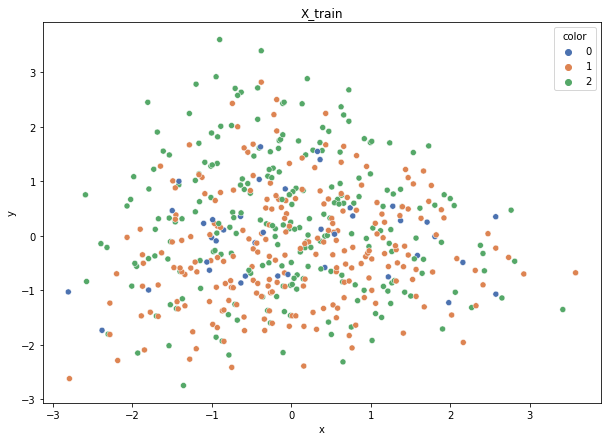

Class cardinalities: Counter({2: 231, 1: 230, 0: 39})
Weights: {2: 0.12614436991098174, 1: 0.1266928236932034, 0: 0.7471628063958148}
Training autoencoder...


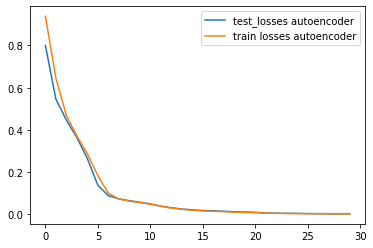

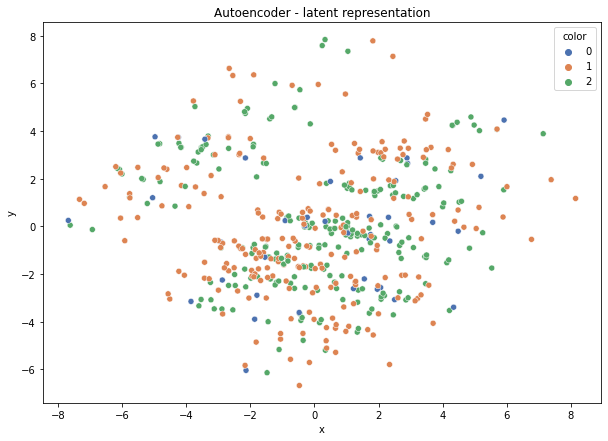

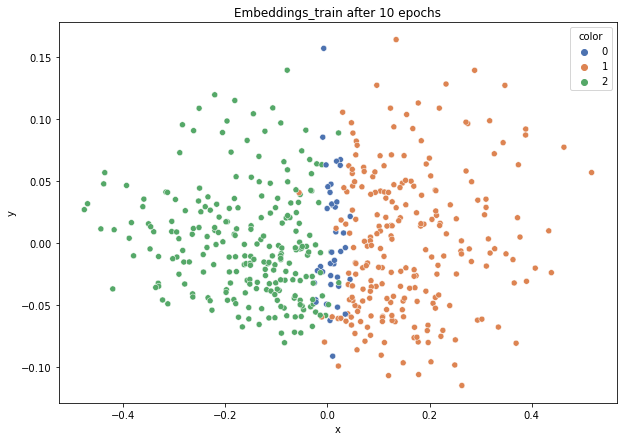

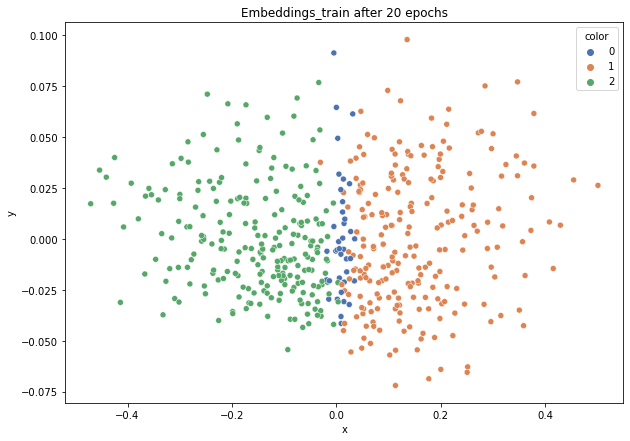

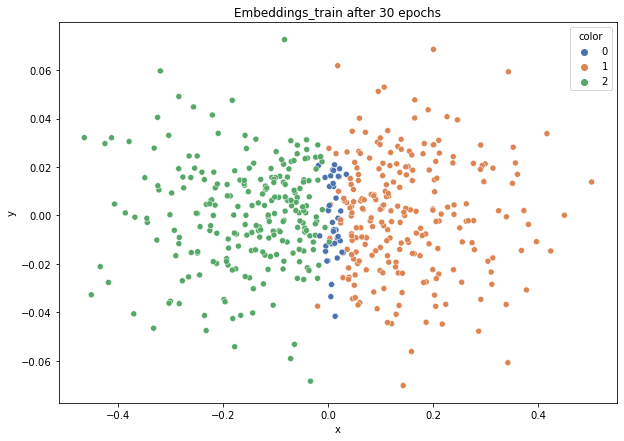

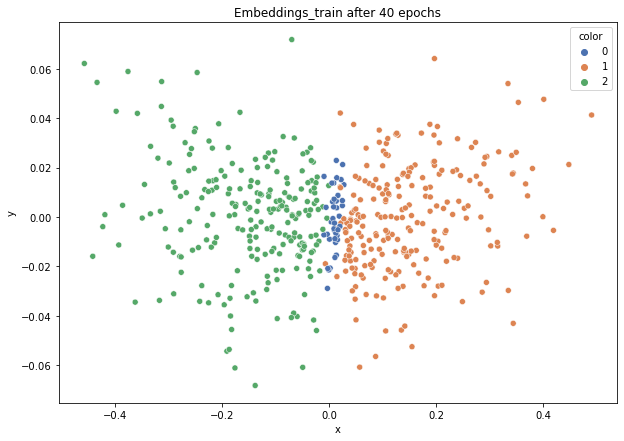

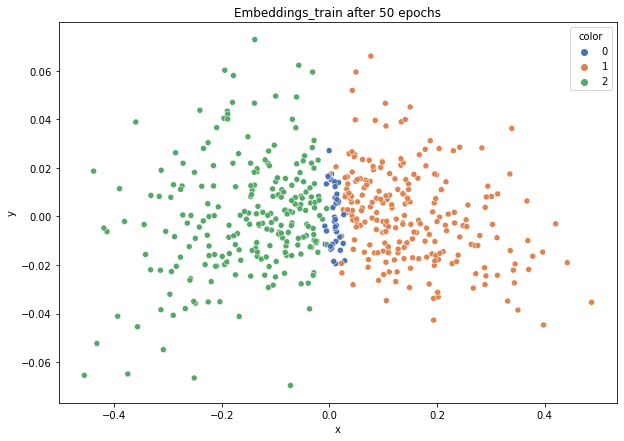

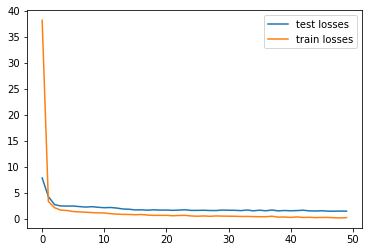

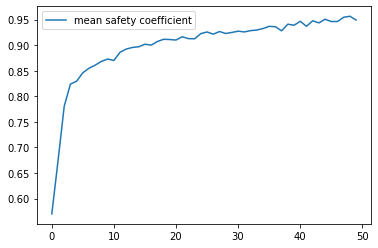

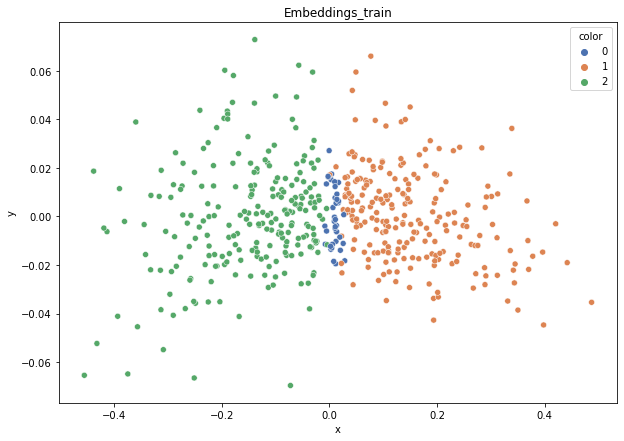

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.857
DT-f1-old+new-features: 0.782
DT-f1-old-features: 0.655
DT-gmean-new-features: 0.857
DT-gmean-old+new-features: 0.756
DT-gmean-old-features: 0.597
DT-minority_gmean-new-features: 0.009
DT-minority_gmean-old+new-features: 0.008
DT-minority_gmean-old-features: 0.007
KNN-f1-new-features: 0.802
KNN-f1-old+new-features: 0.595
KNN-f1-old-features: 0.566
KNN-gmean-new-features: 0.799
KNN-gmean-old+new-features: 0.093
KNN-gmean-old-features: 0.09
KNN-minority_gmean-new-features: 0.008
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001


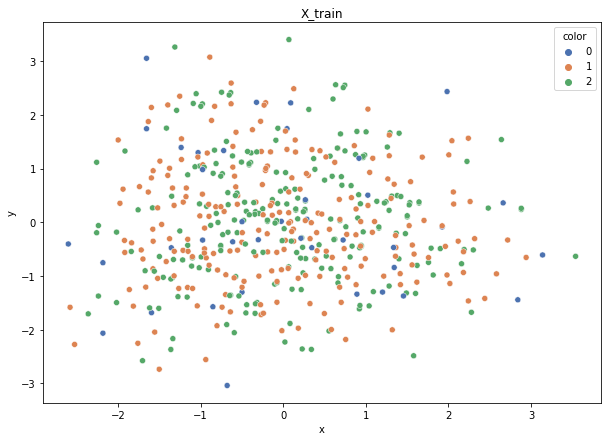

Class cardinalities: Counter({2: 231, 1: 230, 0: 39})
Weights: {0: 0.7471628063958148, 2: 0.12614436991098174, 1: 0.1266928236932034}
Training autoencoder...


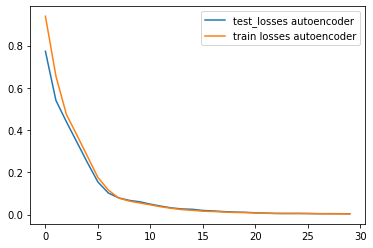

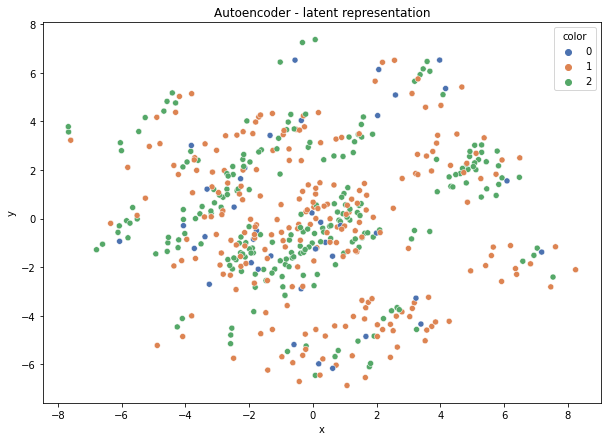

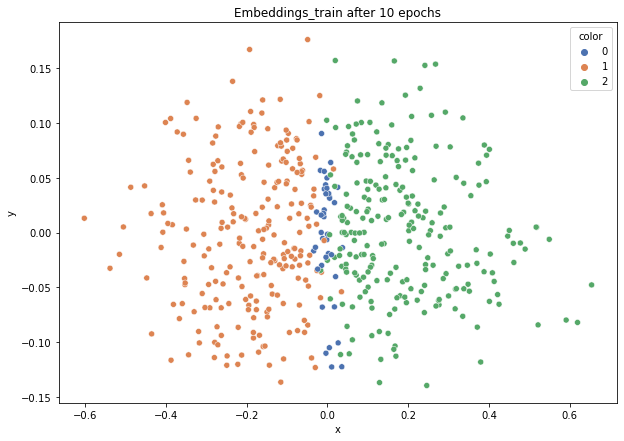

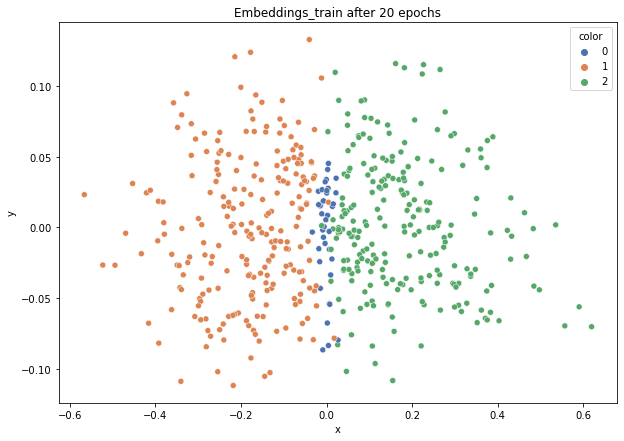

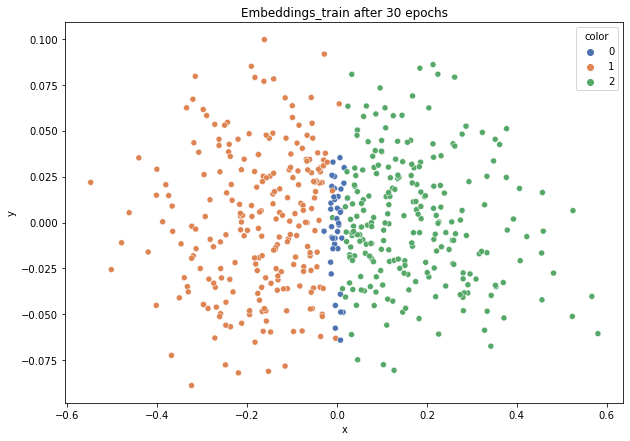

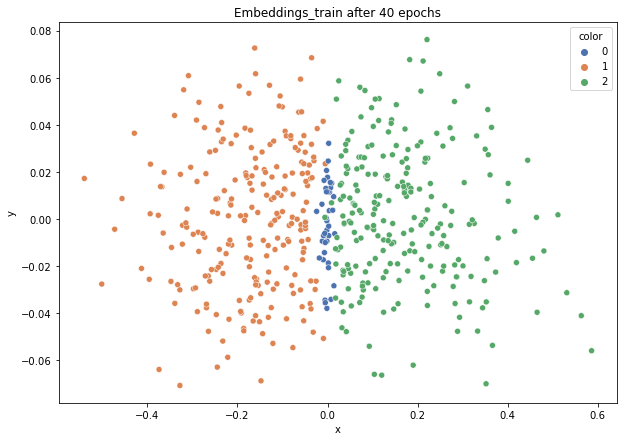

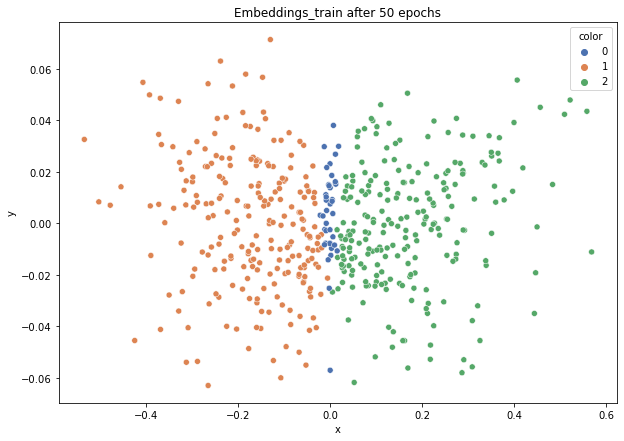

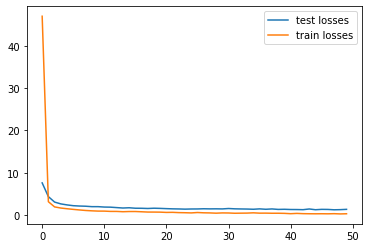

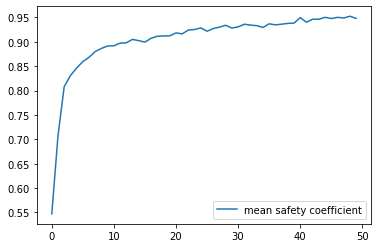

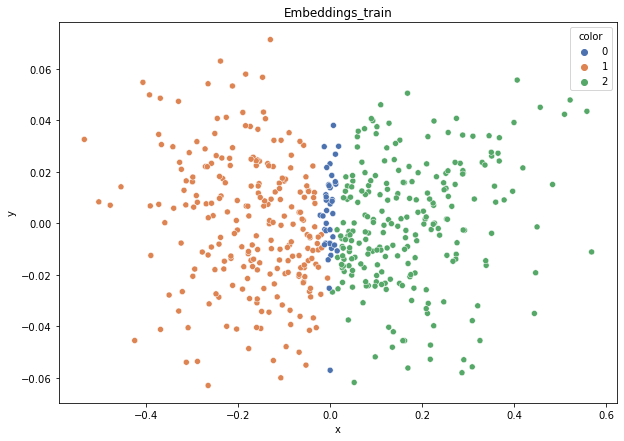

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.711
DT-f1-old+new-features: 0.738
DT-f1-old-features: 0.582
DT-gmean-new-features: 0.564
DT-gmean-old+new-features: 0.578
DT-gmean-old-features: 0.397
DT-minority_gmean-new-features: 0.006
DT-minority_gmean-old+new-features: 0.006
DT-minority_gmean-old-features: 0.005
KNN-f1-new-features: 0.843
KNN-f1-old+new-features: 0.6
KNN-f1-old-features: 0.562
KNN-gmean-new-features: 0.824
KNN-gmean-old+new-features: 0.093
KNN-gmean-old-features: 0.089
KNN-minority_gmean-new-features: 0.008
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001


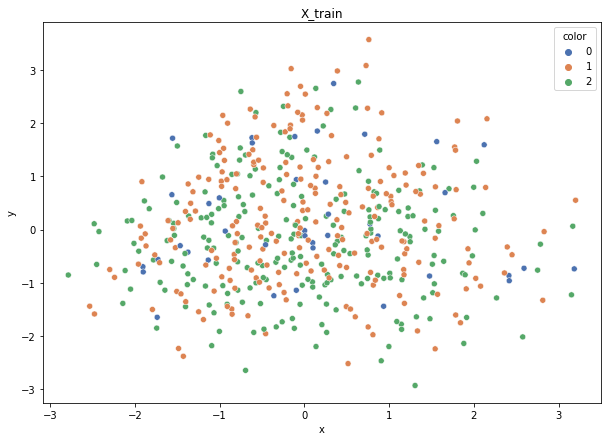

Class cardinalities: Counter({2: 230, 1: 230, 0: 40})
Weights: {0: 0.7419354838709677, 2: 0.12903225806451613, 1: 0.12903225806451613}
Training autoencoder...


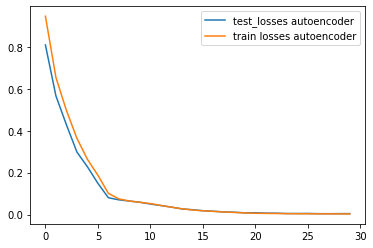

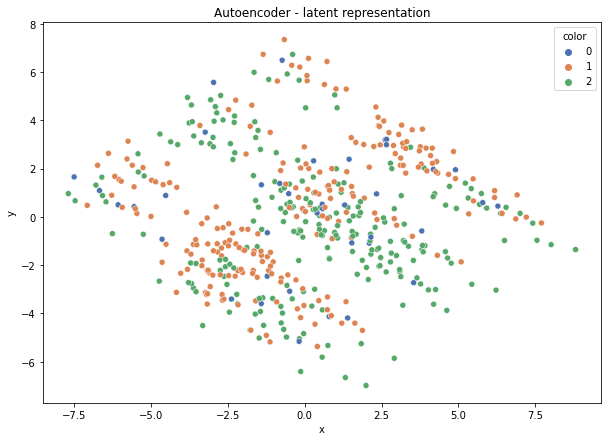

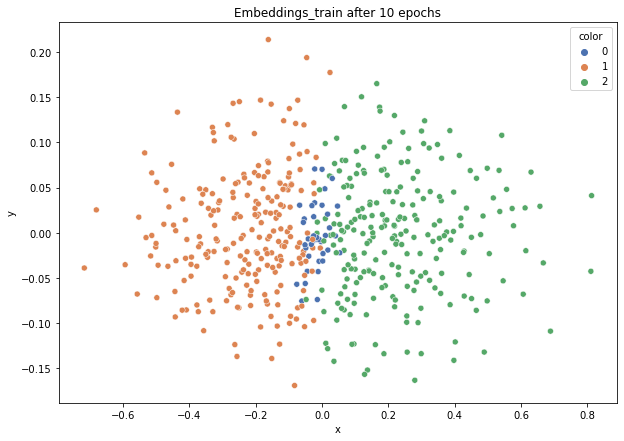

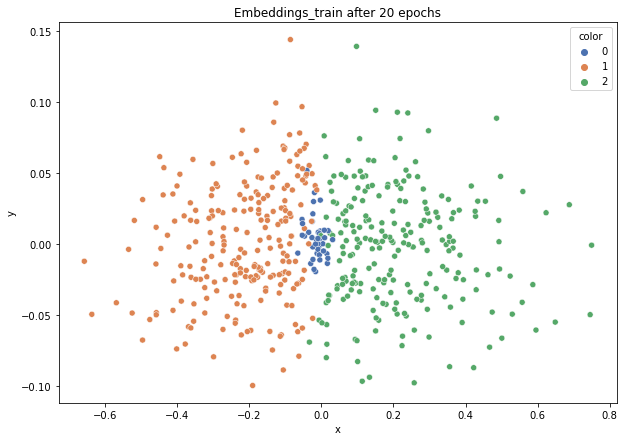

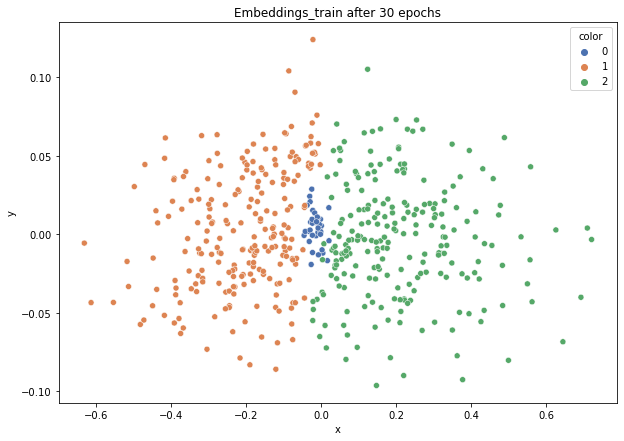

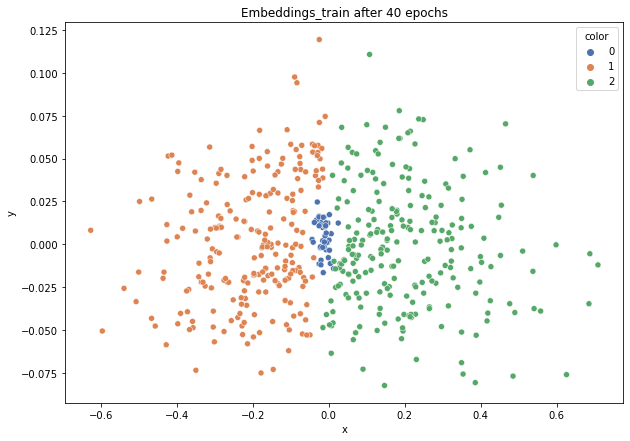

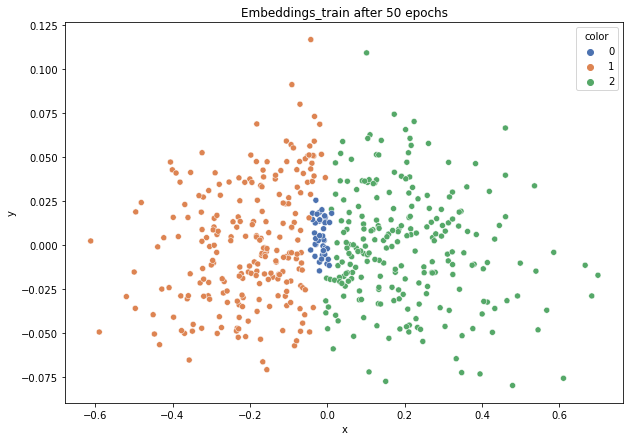

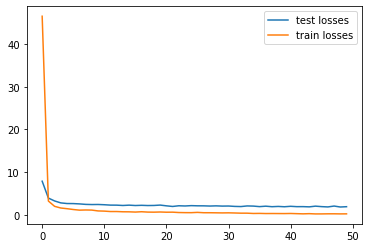

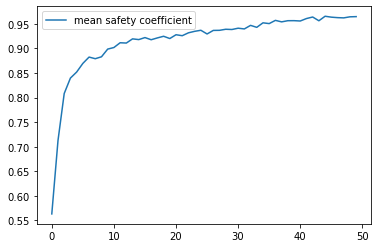

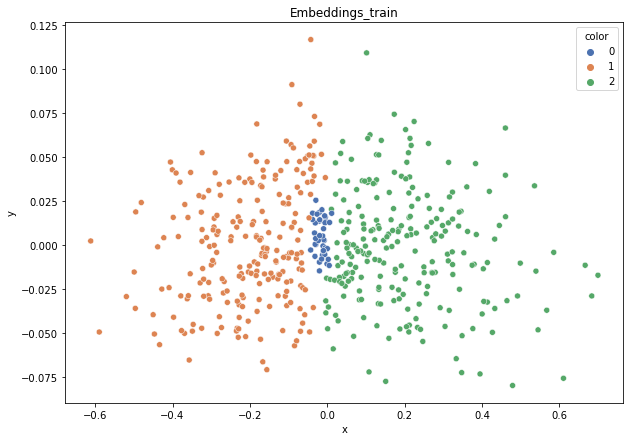

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.787
DT-f1-old+new-features: 0.826
DT-f1-old-features: 0.582
DT-gmean-new-features: 0.778
DT-gmean-old+new-features: 0.833
DT-gmean-old-features: 0.415
DT-minority_gmean-new-features: 0.024
DT-minority_gmean-old+new-features: 0.026
DT-minority_gmean-old-features: 0.005
KNN-f1-new-features: 0.904
KNN-f1-old+new-features: 0.564
KNN-f1-old-features: 0.563
KNN-gmean-new-features: 0.953
KNN-gmean-old+new-features: 0.09
KNN-gmean-old-features: 0.089
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 0.001
KNN-minority_gmean-old-features: 0.001
cleveland


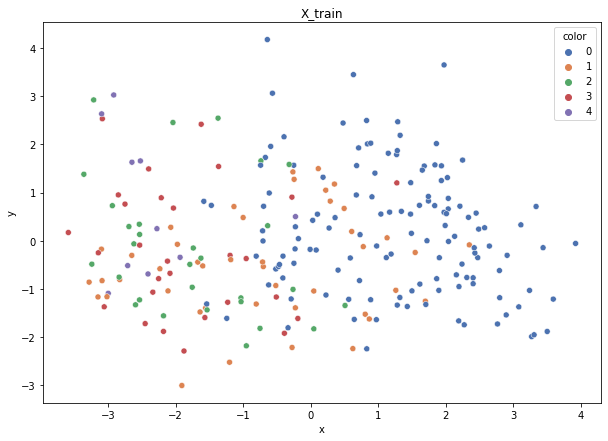

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 10})
Weights: {0: 0.03806176471590889, 2: 0.1719341785442781, 1: 0.11332025404054694, 3: 0.17807468492085946, 4: 0.4986091177784065}
Training autoencoder...


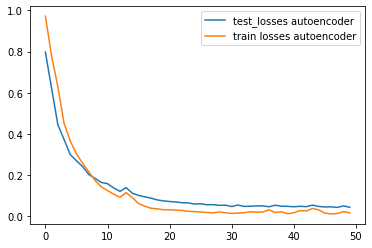

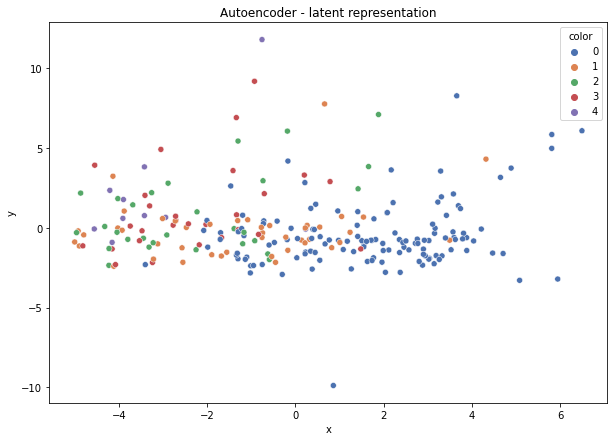

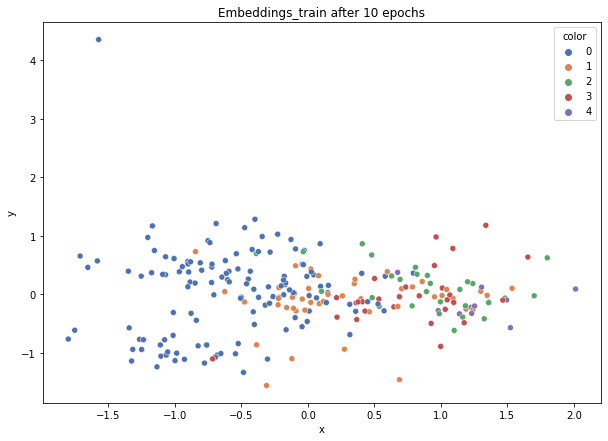

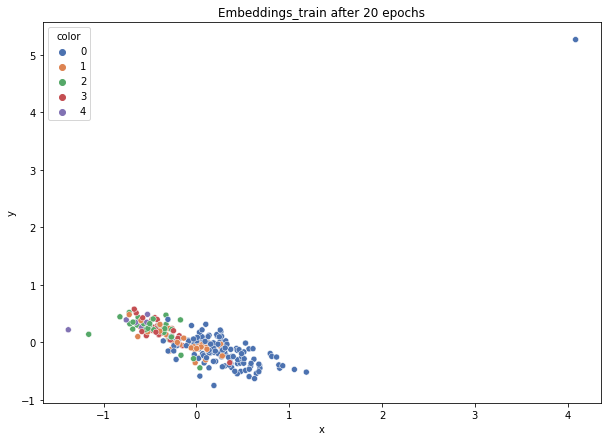

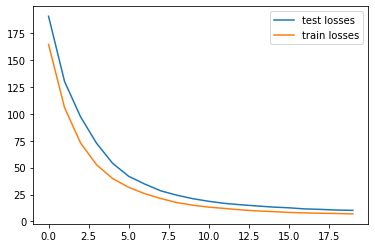

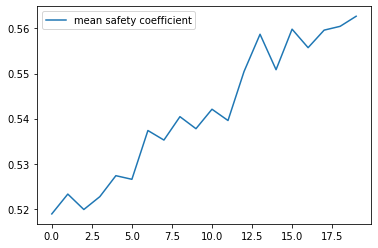

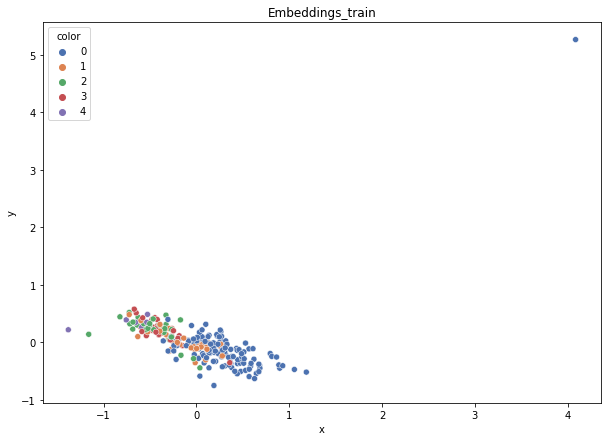

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.339
DT-f1-old+new-features: 0.293
DT-f1-old-features: 0.266
DT-gmean-new-features: 0.112
DT-gmean-old+new-features: 0.044
DT-gmean-old-features: 0.098
DT-minority_gmean-new-features: 0.029
DT-minority_gmean-old+new-features: 0.012
DT-minority_gmean-old-features: 0.026
KNN-f1-new-features: 0.328
KNN-f1-old+new-features: 0.297
KNN-f1-old-features: 0.275
KNN-gmean-new-features: 0.113
KNN-gmean-old+new-features: 0.097
KNN-gmean-old-features: 0.089
KNN-minority_gmean-new-features: 0.029
KNN-minority_gmean-old+new-features: 0.026
KNN-minority_gmean-old-features: 0.024


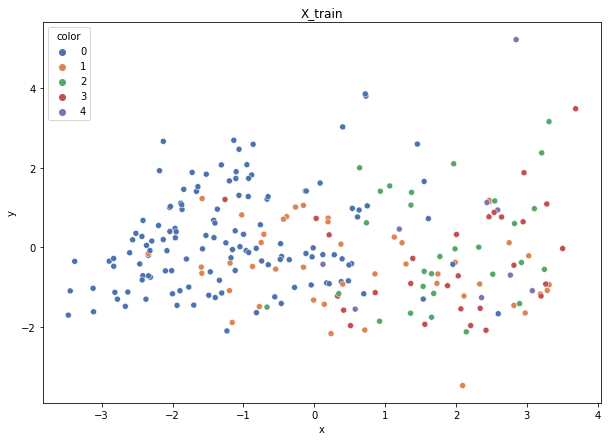

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 10})
Weights: {0: 0.03806176471590889, 2: 0.1719341785442781, 1: 0.11332025404054694, 3: 0.17807468492085946, 4: 0.4986091177784065}
Training autoencoder...


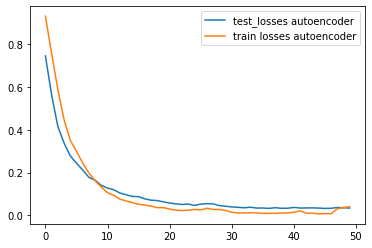

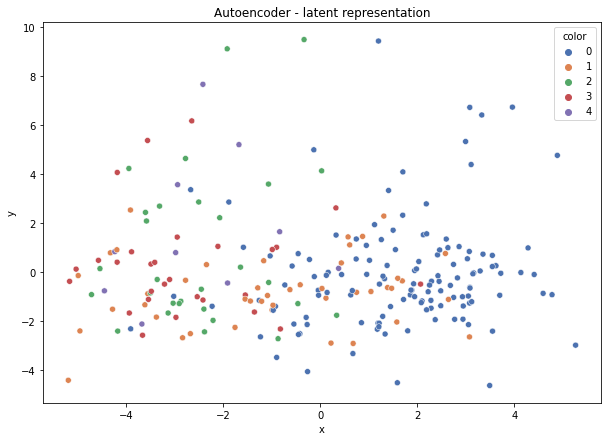

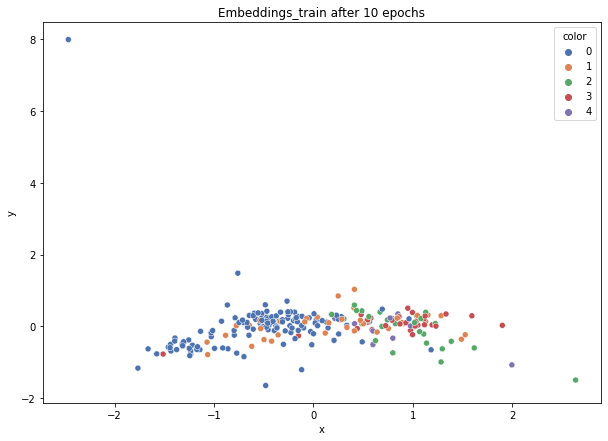

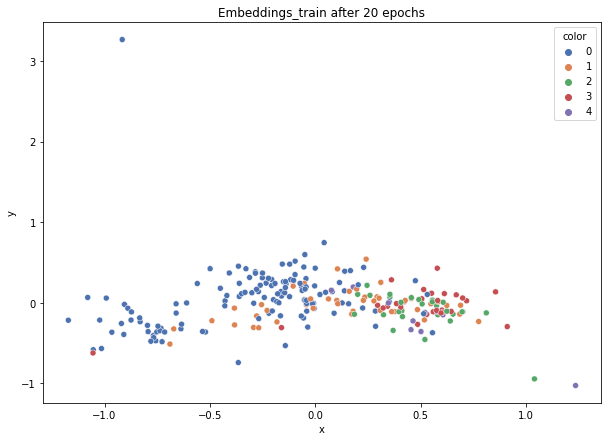

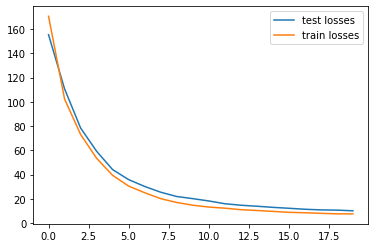

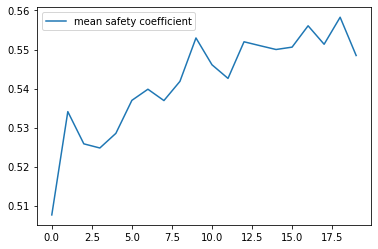

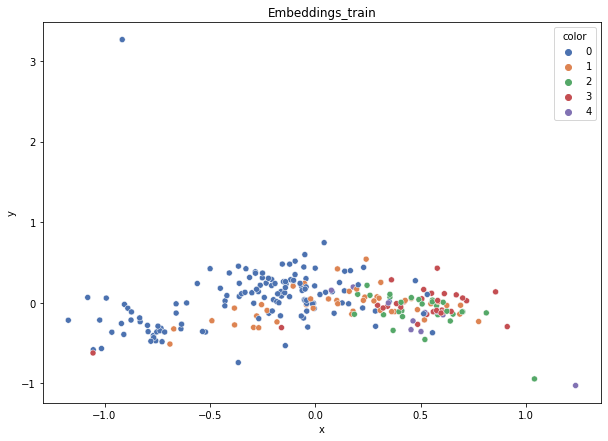

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.372
DT-f1-old+new-features: 0.337
DT-f1-old-features: 0.281
DT-gmean-new-features: 0.366
DT-gmean-old+new-features: 0.117
DT-gmean-old-features: 0.101
DT-minority_gmean-new-features: 0.1
DT-minority_gmean-old+new-features: 0.032
DT-minority_gmean-old-features: 0.027
KNN-f1-new-features: 0.344
KNN-f1-old+new-features: 0.357
KNN-f1-old-features: 0.356
KNN-gmean-new-features: 0.12
KNN-gmean-old+new-features: 0.122
KNN-gmean-old-features: 0.122
KNN-minority_gmean-new-features: 0.032
KNN-minority_gmean-old+new-features: 0.033
KNN-minority_gmean-old-features: 0.033


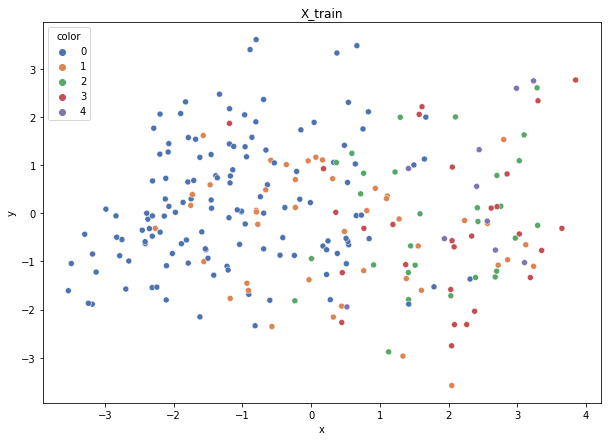

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 10})
Weights: {0: 0.03806176471590889, 3: 0.17807468492085946, 1: 0.11332025404054694, 2: 0.1719341785442781, 4: 0.4986091177784065}
Training autoencoder...


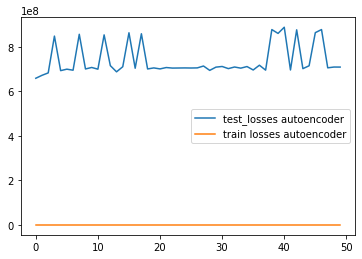

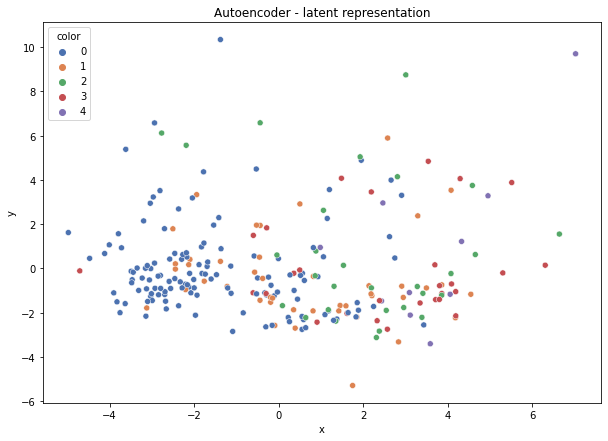

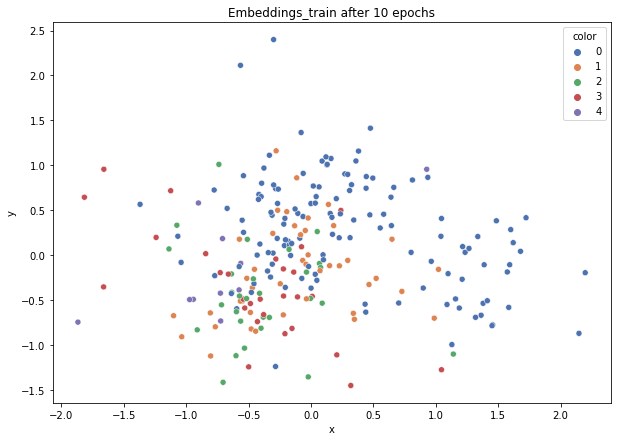

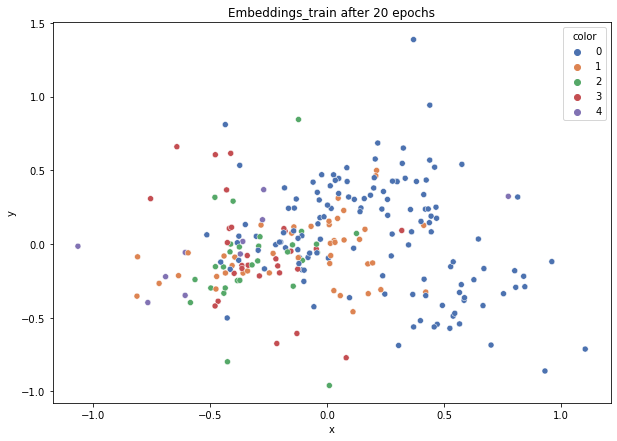

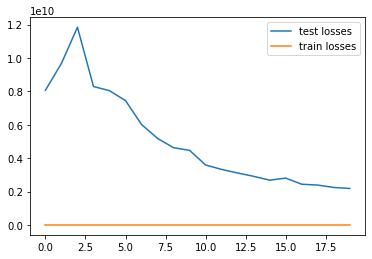

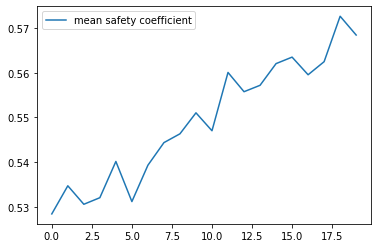

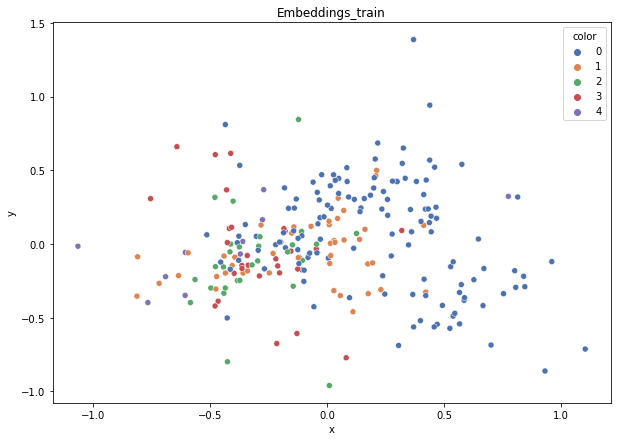

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.339
DT-f1-old+new-features: 0.319
DT-f1-old-features: 0.368
DT-gmean-new-features: 0.339
DT-gmean-old+new-features: 0.298
DT-gmean-old-features: 0.128
DT-minority_gmean-new-features: 0.094
DT-minority_gmean-old+new-features: 0.082
DT-minority_gmean-old-features: 0.034
KNN-f1-new-features: 0.366
KNN-f1-old+new-features: 0.336
KNN-f1-old-features: 0.325
KNN-gmean-new-features: 0.311
KNN-gmean-old+new-features: 0.115
KNN-gmean-old-features: 0.109
KNN-minority_gmean-new-features: 0.082
KNN-minority_gmean-old+new-features: 0.031
KNN-minority_gmean-old-features: 0.029


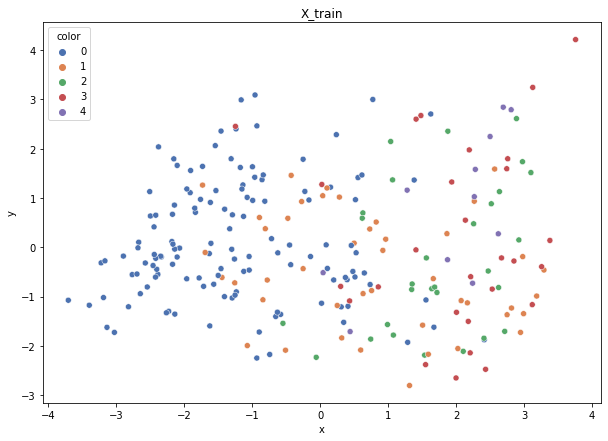

Class cardinalities: Counter({0: 131, 1: 44, 2: 29, 3: 28, 4: 11})
Weights: {0: 0.03986894846317969, 2: 0.18009766374746689, 1: 0.11870073292446681, 3: 0.18652972316701927, 4: 0.47480293169786725}
Training autoencoder...


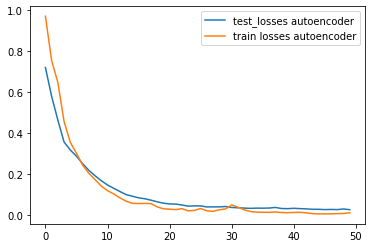

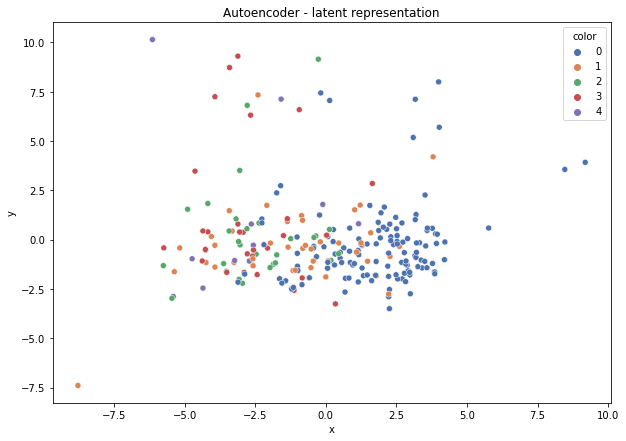

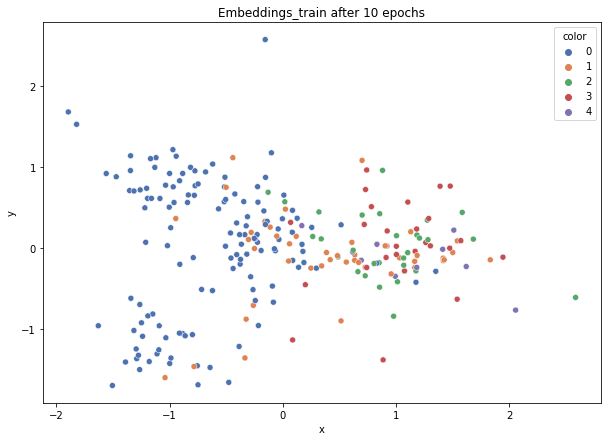

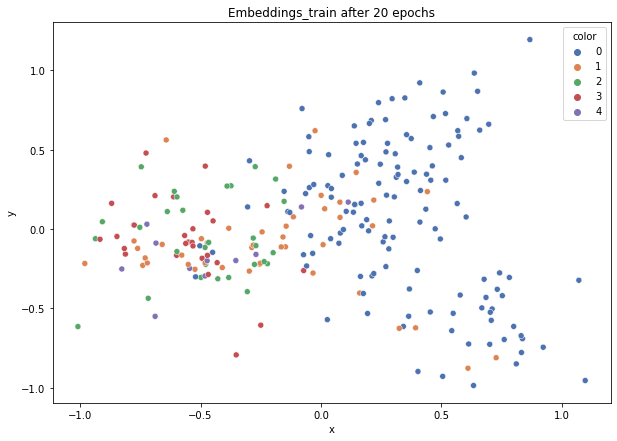

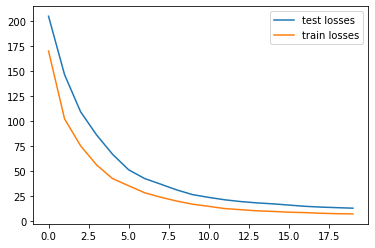

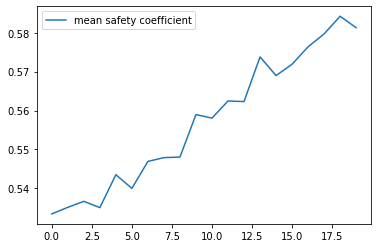

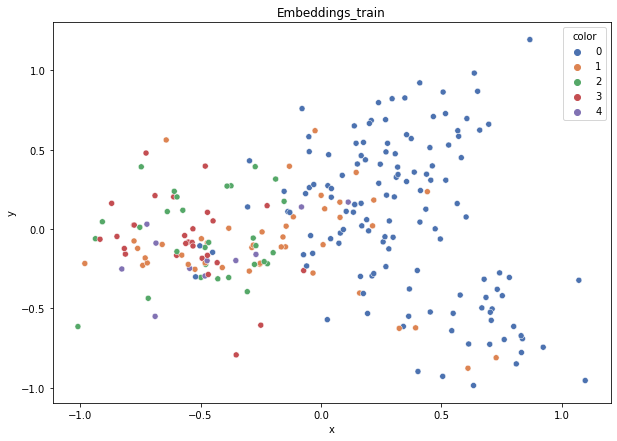

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.279
DT-f1-old+new-features: 0.263
DT-f1-old-features: 0.305
DT-gmean-new-features: 0.095
DT-gmean-old+new-features: 0.088
DT-gmean-old-features: 0.112
DT-minority_gmean-new-features: 0.026
DT-minority_gmean-old+new-features: 0.024
DT-minority_gmean-old-features: 0.031
KNN-f1-new-features: 0.278
KNN-f1-old+new-features: 0.3
KNN-f1-old-features: 0.254
KNN-gmean-new-features: 0.094
KNN-gmean-old+new-features: 0.097
KNN-gmean-old-features: 0.036
KNN-minority_gmean-new-features: 0.026
KNN-minority_gmean-old+new-features: 0.026
KNN-minority_gmean-old-features: 0.01


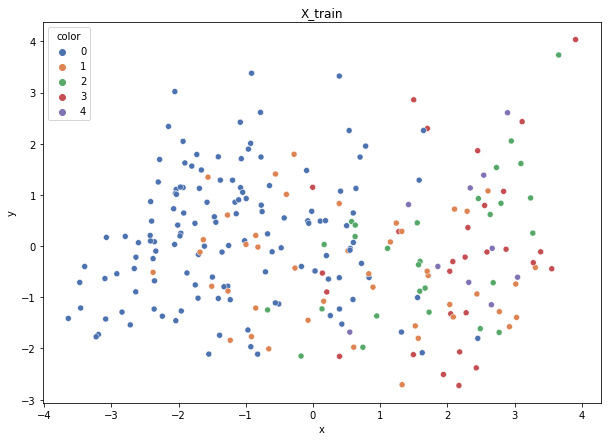

Class cardinalities: Counter({0: 132, 1: 44, 2: 28, 3: 28, 4: 11})
Weights: {2: 0.18539325842696627, 1: 0.11797752808988764, 0: 0.03932584269662921, 3: 0.18539325842696627, 4: 0.47191011235955055}
Training autoencoder...


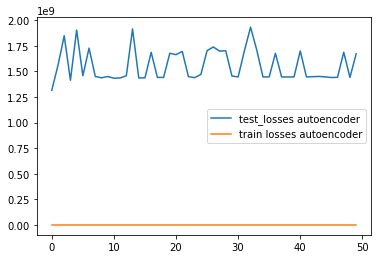

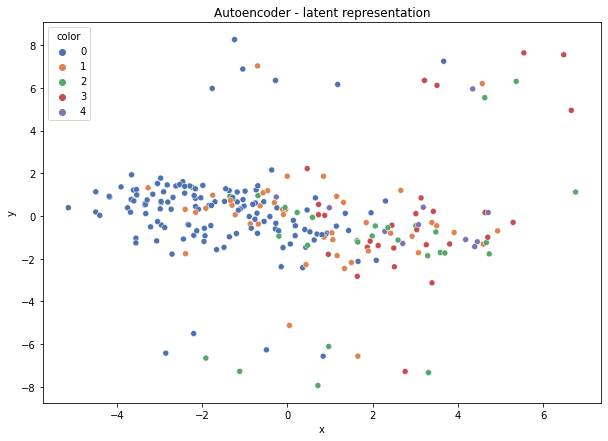

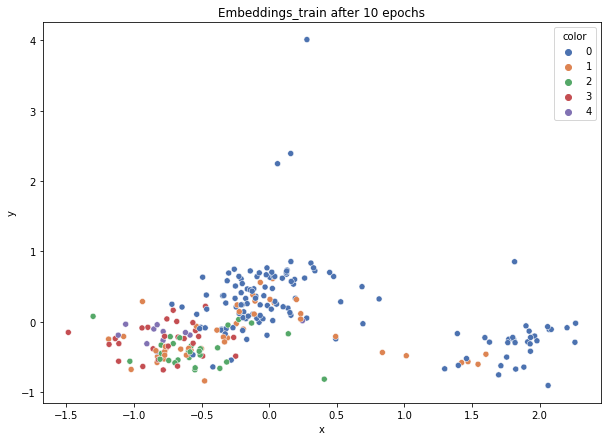

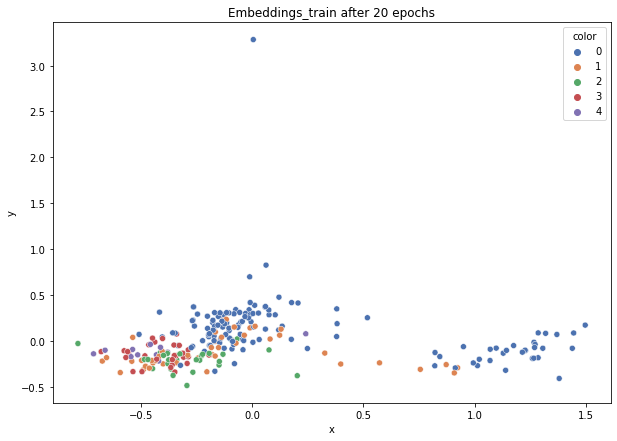

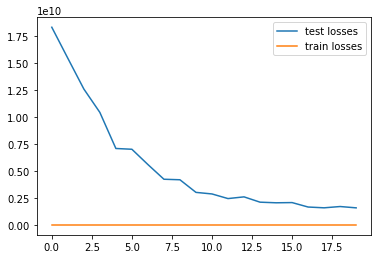

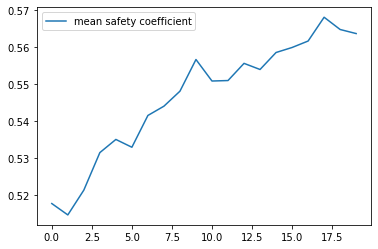

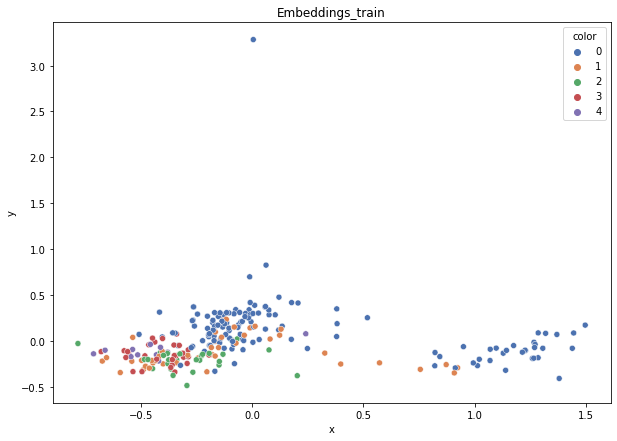

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.325
DT-f1-old+new-features: 0.399
DT-f1-old-features: 0.227
DT-gmean-new-features: 0.108
DT-gmean-old+new-features: 0.361
DT-gmean-old-features: 0.03
DT-minority_gmean-new-features: 0.029
DT-minority_gmean-old+new-features: 0.094
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.309
KNN-f1-old+new-features: 0.282
KNN-f1-old-features: 0.275
KNN-gmean-new-features: 0.092
KNN-gmean-old+new-features: 0.035
KNN-gmean-old-features: 0.035
KNN-minority_gmean-new-features: 0.024
KNN-minority_gmean-old+new-features: 0.009
KNN-minority_gmean-old-features: 0.009
cleveland_v2


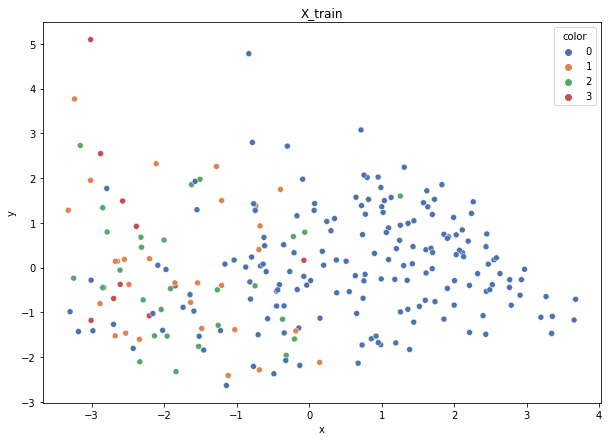

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 10})
Weights: {0: 0.032483898067768135, 1: 0.19602352282273874, 2: 0.20302436292355083, 3: 0.5684682161859423}
Training autoencoder...


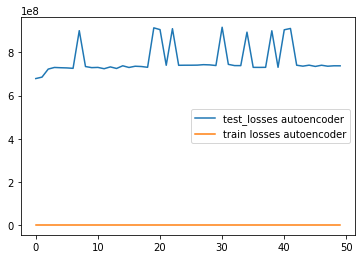

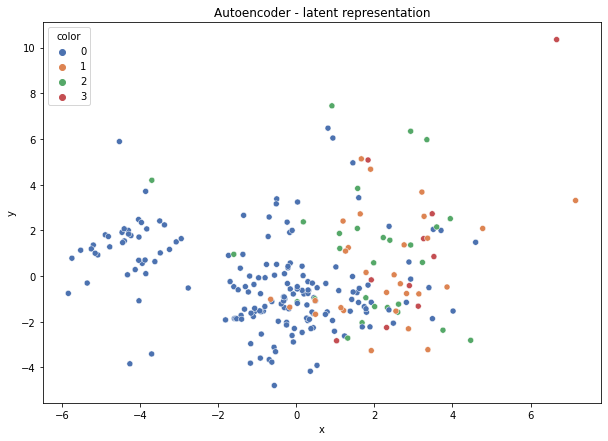

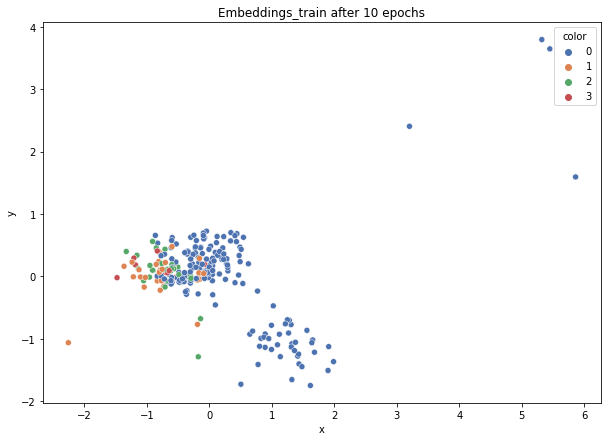

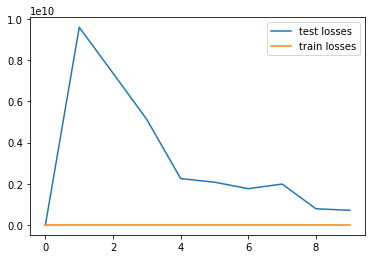

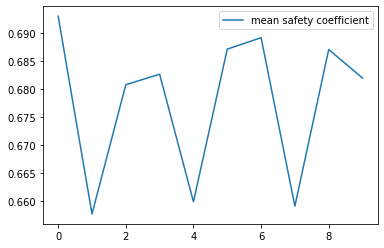

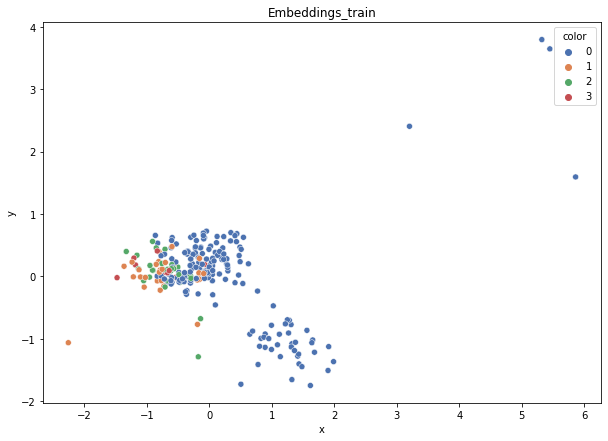

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.308
DT-f1-old+new-features: 0.301
DT-f1-old-features: 0.358
DT-gmean-new-features: 0.077
DT-gmean-old+new-features: 0.076
DT-gmean-old-features: 0.099
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.014
DT-minority_gmean-old-features: 0.019
KNN-f1-new-features: 0.321
KNN-f1-old+new-features: 0.241
KNN-f1-old-features: 0.238
KNN-gmean-new-features: 0.077
KNN-gmean-old+new-features: 0.019
KNN-gmean-old-features: 0.018
KNN-minority_gmean-new-features: 0.014
KNN-minority_gmean-old+new-features: 0.003
KNN-minority_gmean-old-features: 0.003


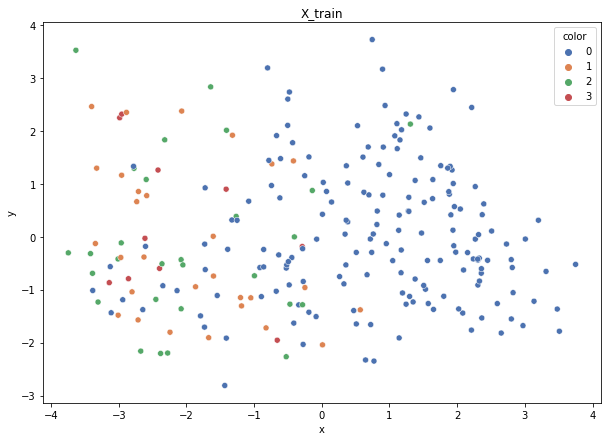

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 10})
Weights: {0: 0.032483898067768135, 1: 0.19602352282273874, 2: 0.20302436292355083, 3: 0.5684682161859423}
Training autoencoder...


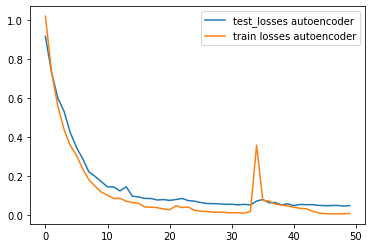

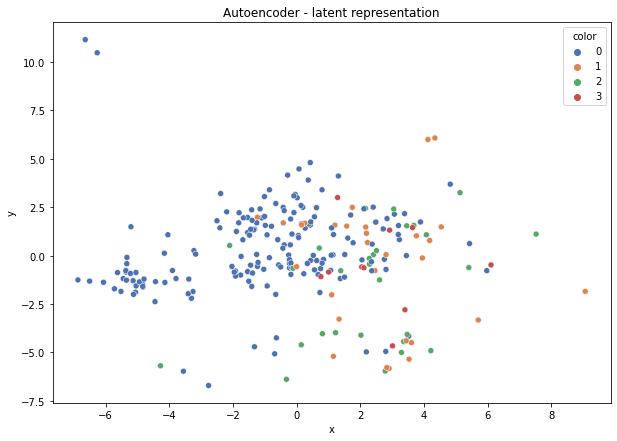

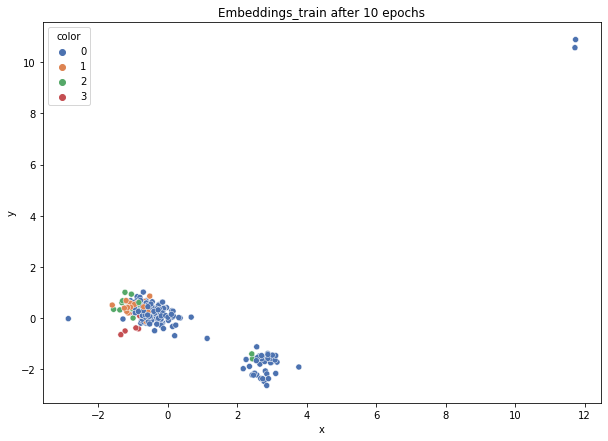

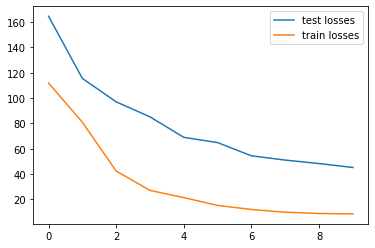

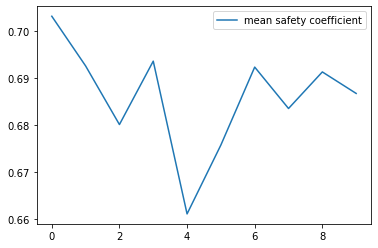

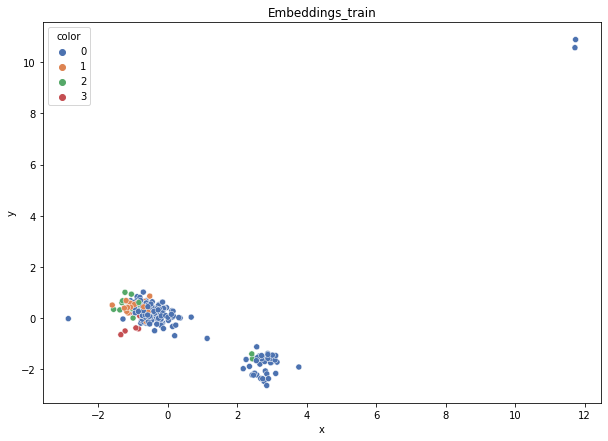

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.318
DT-f1-old+new-features: 0.259
DT-f1-old-features: 0.484
DT-gmean-new-features: 0.076
DT-gmean-old+new-features: 0.062
DT-gmean-old-features: 0.546
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.012
DT-minority_gmean-old-features: 0.105
KNN-f1-new-features: 0.313
KNN-f1-old+new-features: 0.365
KNN-f1-old-features: 0.39
KNN-gmean-new-features: 0.076
KNN-gmean-old+new-features: 0.099
KNN-gmean-old-features: 0.11
KNN-minority_gmean-new-features: 0.014
KNN-minority_gmean-old+new-features: 0.019
KNN-minority_gmean-old-features: 0.021


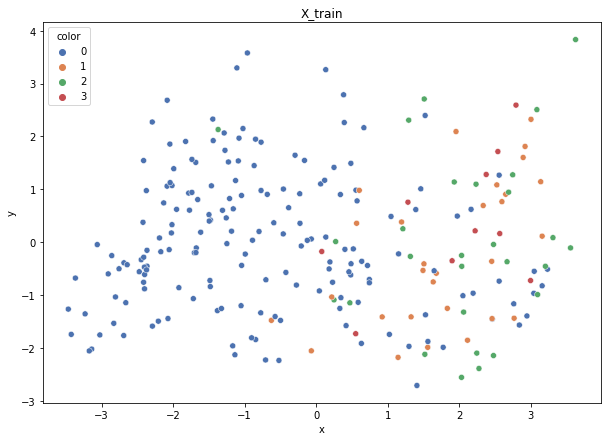

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 10})
Weights: {0: 0.032483898067768135, 1: 0.19602352282273874, 2: 0.20302436292355083, 3: 0.5684682161859423}
Training autoencoder...


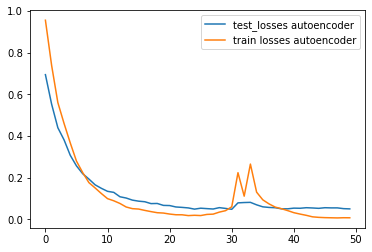

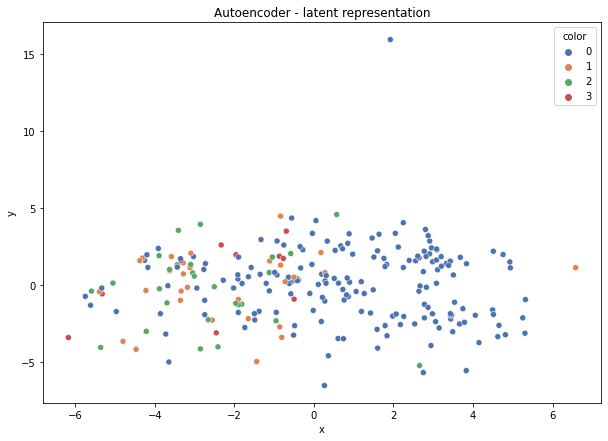

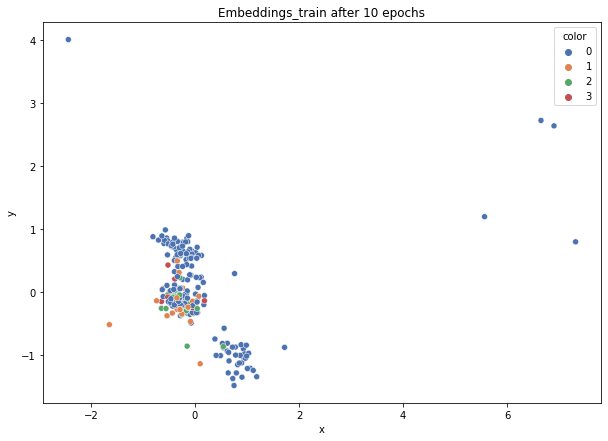

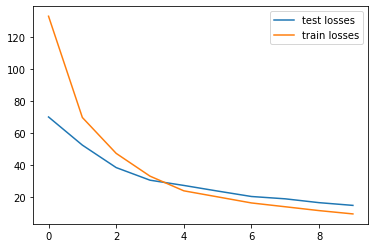

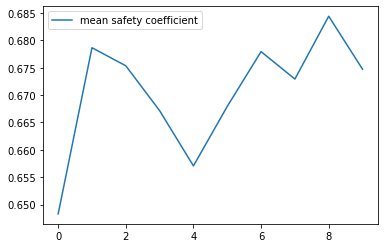

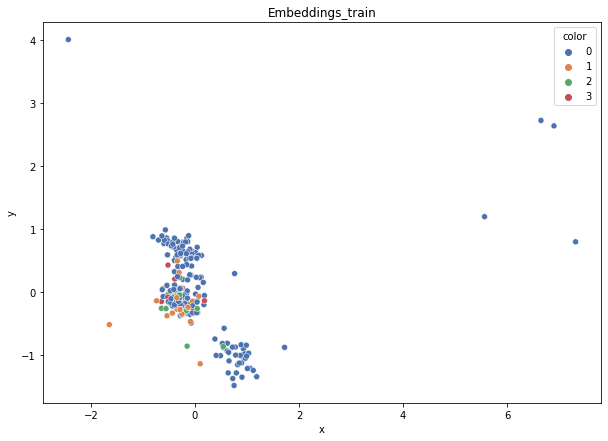

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.242
DT-f1-old+new-features: 0.291
DT-f1-old-features: 0.295
DT-gmean-new-features: 0.018
DT-gmean-old+new-features: 0.024
DT-gmean-old-features: 0.075
DT-minority_gmean-new-features: 0.003
DT-minority_gmean-old+new-features: 0.005
DT-minority_gmean-old-features: 0.014
KNN-f1-new-features: 0.293
KNN-f1-old+new-features: 0.336
KNN-f1-old-features: 0.356
KNN-gmean-new-features: 0.065
KNN-gmean-old+new-features: 0.078
KNN-gmean-old-features: 0.079
KNN-minority_gmean-new-features: 0.012
KNN-minority_gmean-old+new-features: 0.014
KNN-minority_gmean-old-features: 0.014


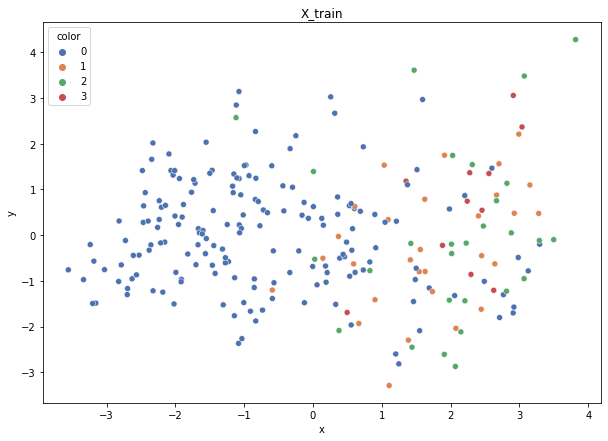

Class cardinalities: Counter({0: 175, 1: 29, 2: 28, 3: 11})
Weights: {1: 0.20670586024536255, 0: 0.03425411398351722, 2: 0.21408821239698264, 3: 0.5449518133741377}
Training autoencoder...


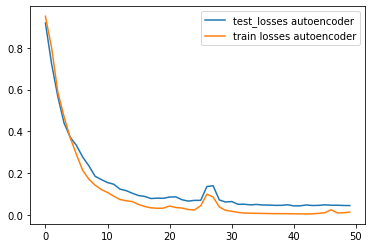

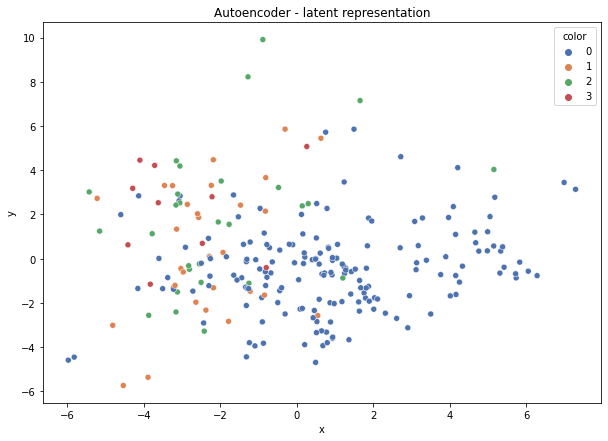

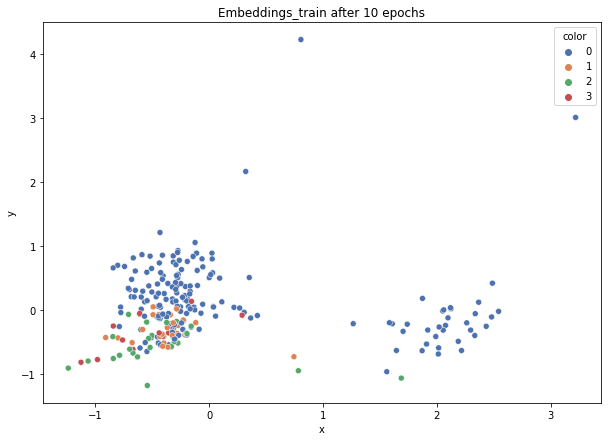

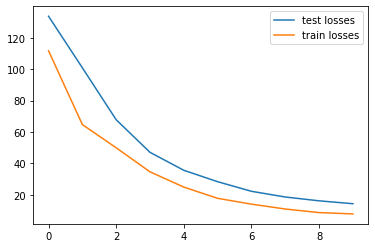

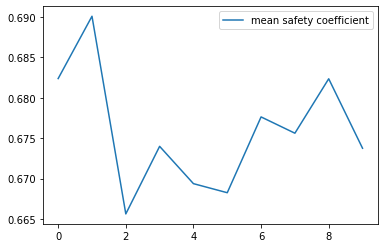

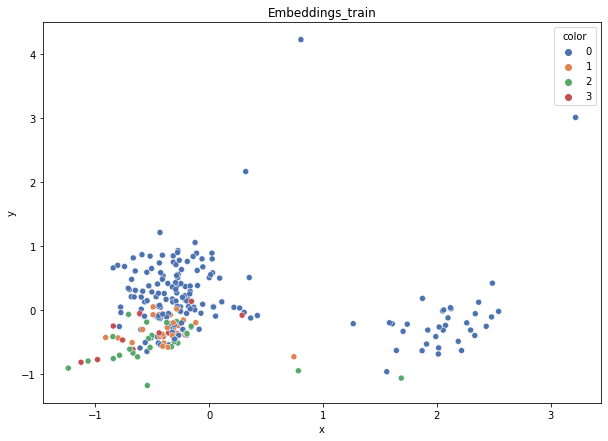

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.327
DT-f1-old+new-features: 0.296
DT-f1-old-features: 0.238
DT-gmean-new-features: 0.077
DT-gmean-old+new-features: 0.075
DT-gmean-old-features: 0.018
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.014
DT-minority_gmean-old-features: 0.003
KNN-f1-new-features: 0.323
KNN-f1-old+new-features: 0.29
KNN-f1-old-features: 0.283
KNN-gmean-new-features: 0.025
KNN-gmean-old+new-features: 0.023
KNN-gmean-old-features: 0.022
KNN-minority_gmean-new-features: 0.005
KNN-minority_gmean-old+new-features: 0.004
KNN-minority_gmean-old-features: 0.004


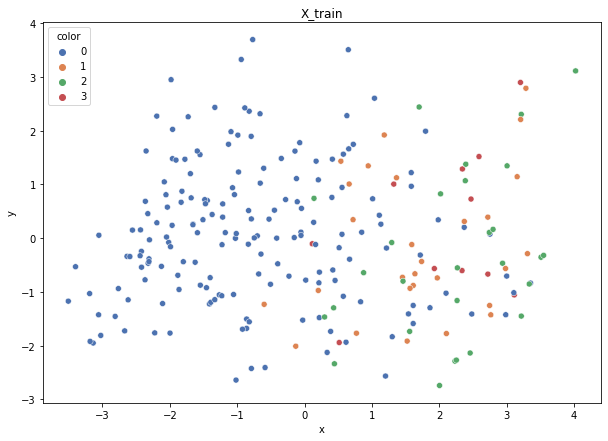

Class cardinalities: Counter({0: 176, 1: 28, 2: 28, 3: 11})
Weights: {0: 0.03381642512077295, 1: 0.21256038647342995, 2: 0.21256038647342995, 3: 0.5410628019323672}
Training autoencoder...


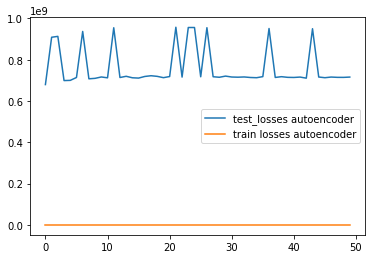

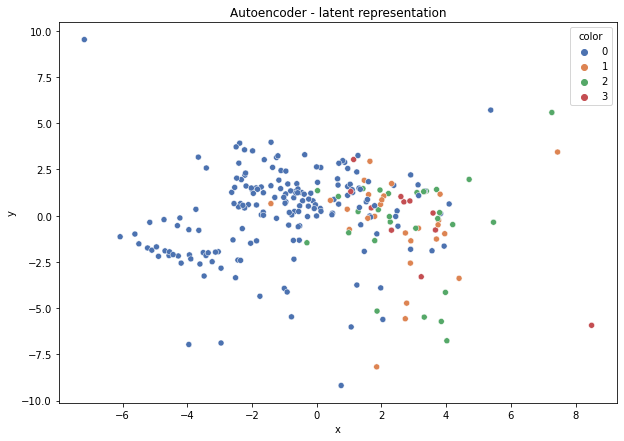

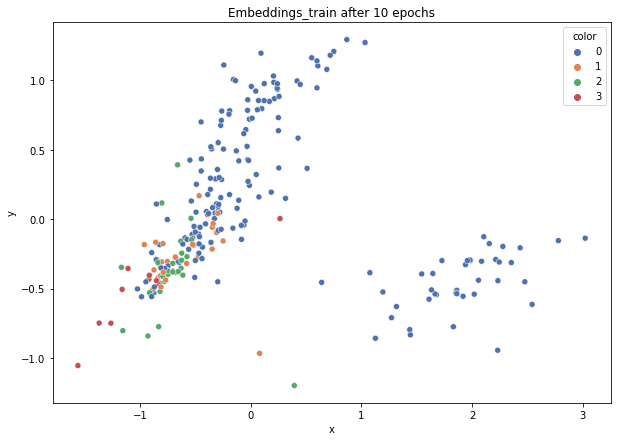

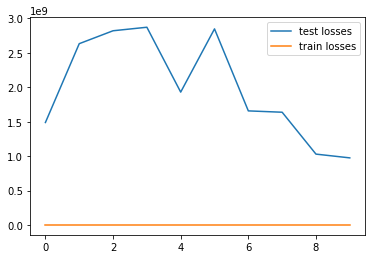

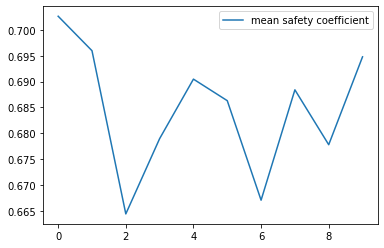

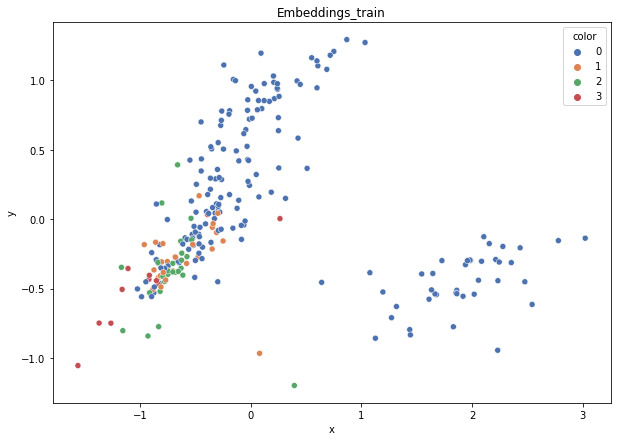

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.41
DT-f1-old+new-features: 0.367
DT-f1-old-features: 0.335
DT-gmean-new-features: 0.098
DT-gmean-old+new-features: 0.096
DT-gmean-old-features: 0.092
DT-minority_gmean-new-features: 0.018
DT-minority_gmean-old+new-features: 0.018
DT-minority_gmean-old-features: 0.018
KNN-f1-new-features: 0.293
KNN-f1-old+new-features: 0.337
KNN-f1-old-features: 0.37
KNN-gmean-new-features: 0.021
KNN-gmean-old+new-features: 0.087
KNN-gmean-old-features: 0.096
KNN-minority_gmean-new-features: 0.004
KNN-minority_gmean-old+new-features: 0.016
KNN-minority_gmean-old-features: 0.018
glass


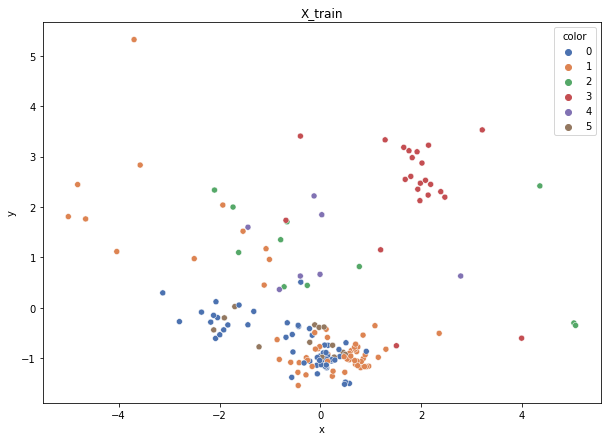

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 13, 2: 11, 4: 7})
Weights: {0: 0.04597401674853029, 1: 0.042205654719962245, 3: 0.1119367364312042, 5: 0.1980419183013613, 2: 0.2340495398106997, 4: 0.36779213398824234}
Training autoencoder...


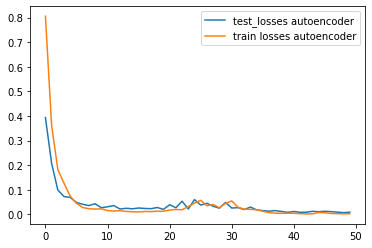

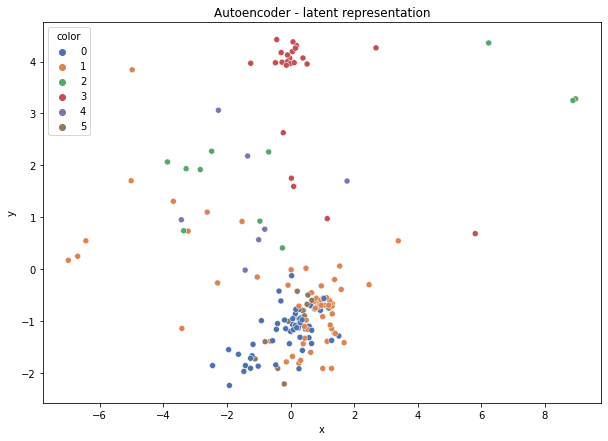

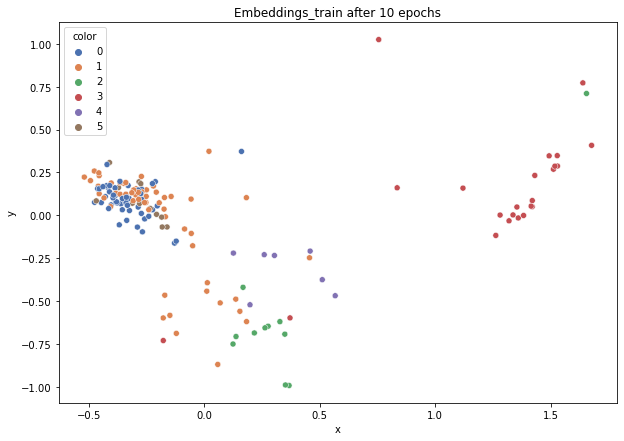

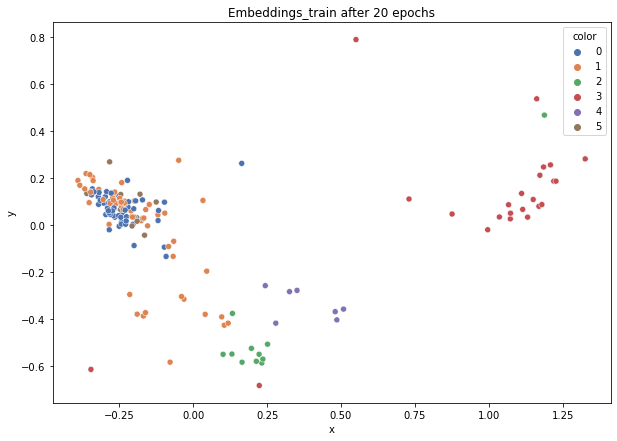

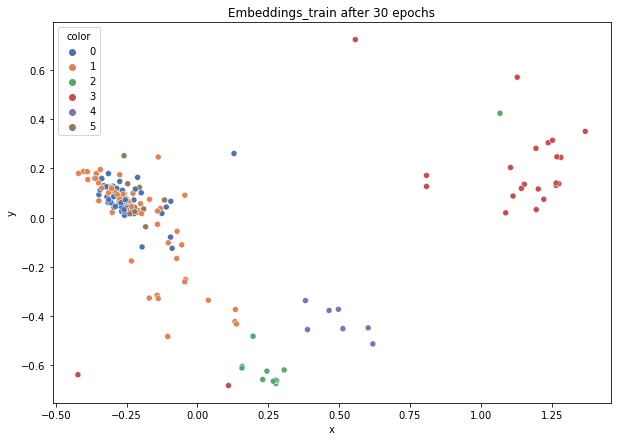

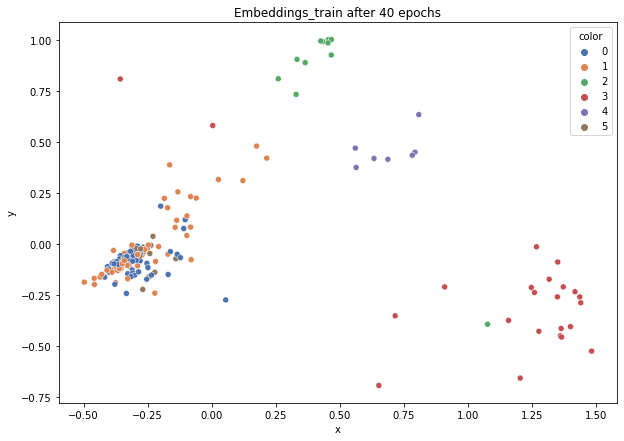

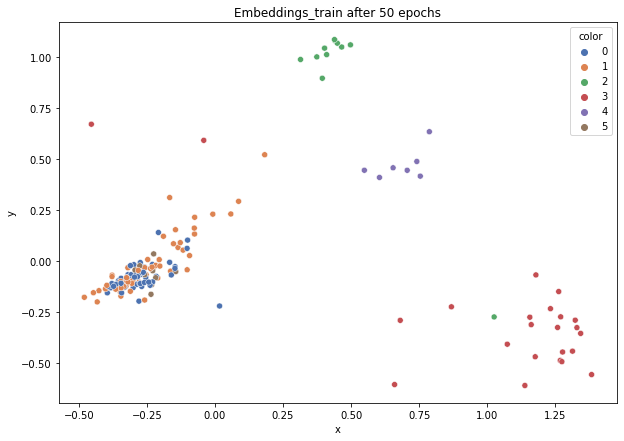

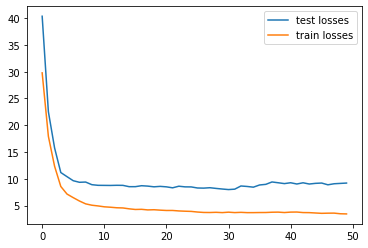

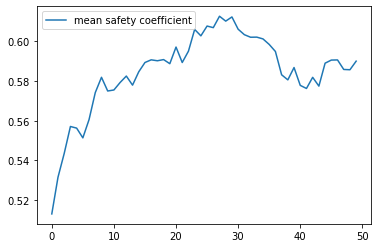

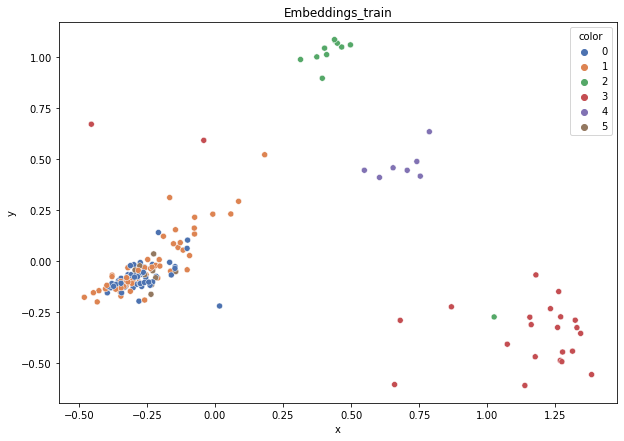

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.482
DT-f1-old+new-features: 0.549
DT-f1-old-features: 0.711
DT-gmean-new-features: 0.177
DT-gmean-old+new-features: 0.194
DT-gmean-old-features: 0.742
DT-minority_gmean-new-features: 0.01
DT-minority_gmean-old+new-features: 0.019
DT-minority_gmean-old-features: 0.165
KNN-f1-new-features: 0.761
KNN-f1-old+new-features: 0.747
KNN-f1-old-features: 0.747
KNN-gmean-new-features: 0.713
KNN-gmean-old+new-features: 0.701
KNN-gmean-old-features: 0.701
KNN-minority_gmean-new-features: 0.126
KNN-minority_gmean-old+new-features: 0.048
KNN-minority_gmean-old-features: 0.048


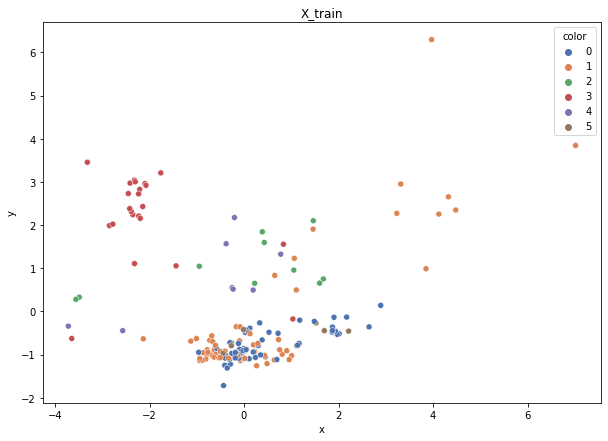

Class cardinalities: Counter({1: 60, 0: 56, 3: 24, 5: 13, 2: 10, 4: 8})
Weights: {5: 0.2034390893678857, 4: 0.33058852022281426, 1: 0.0440784693630419, 0: 0.047226931460402036, 3: 0.11019617340760475, 2: 0.2644708161782514}
Training autoencoder...


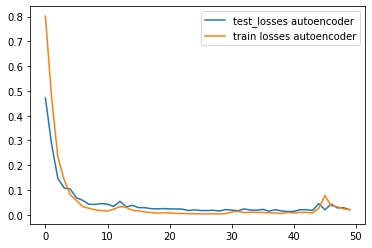

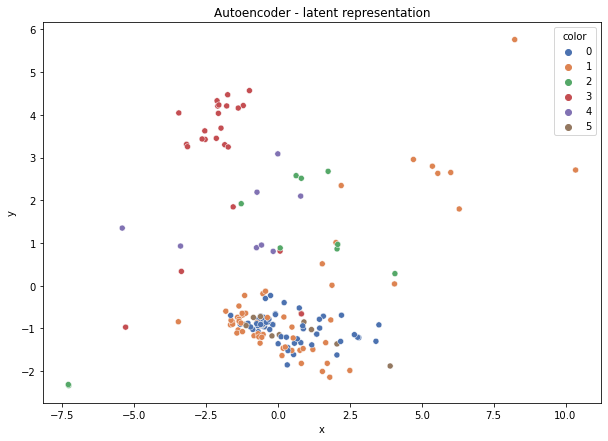

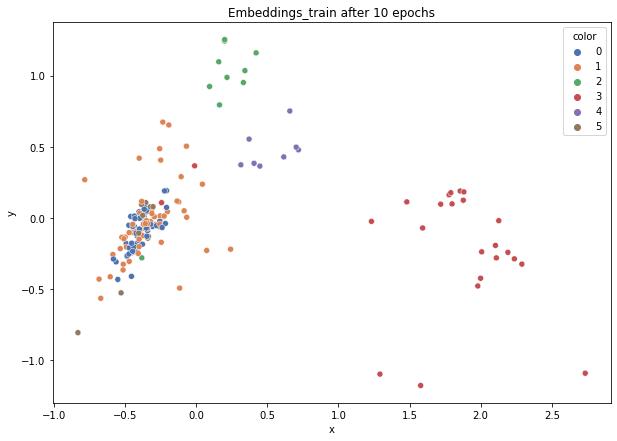

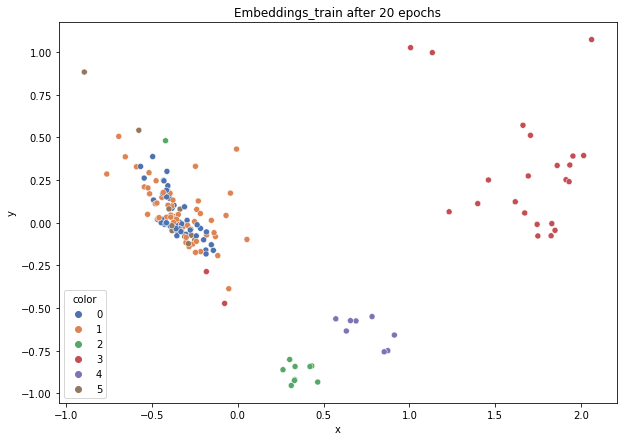

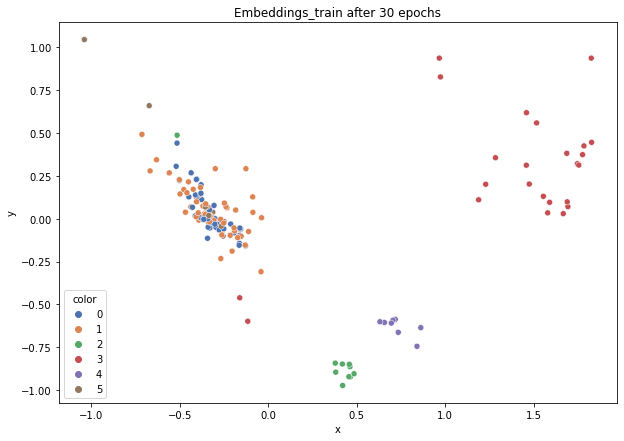

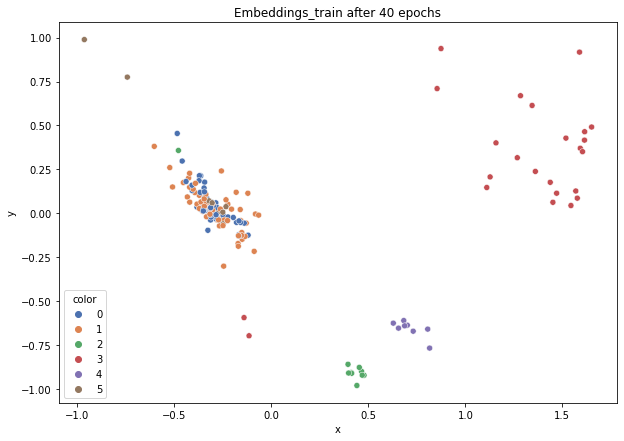

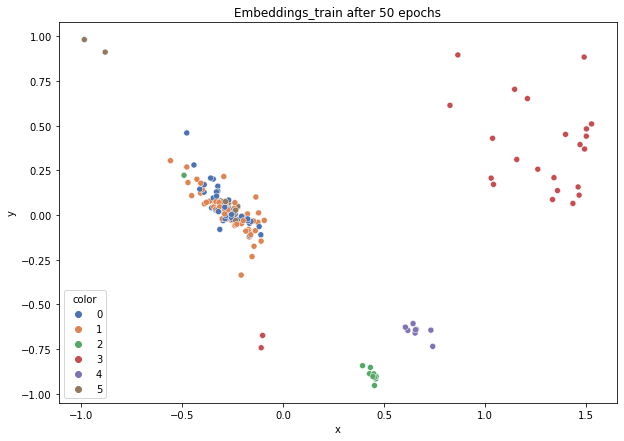

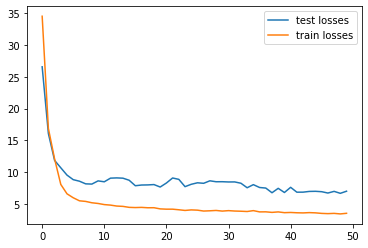

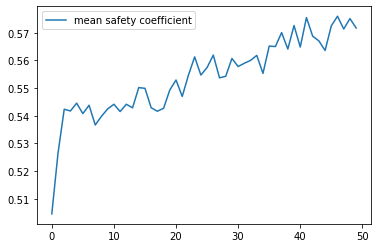

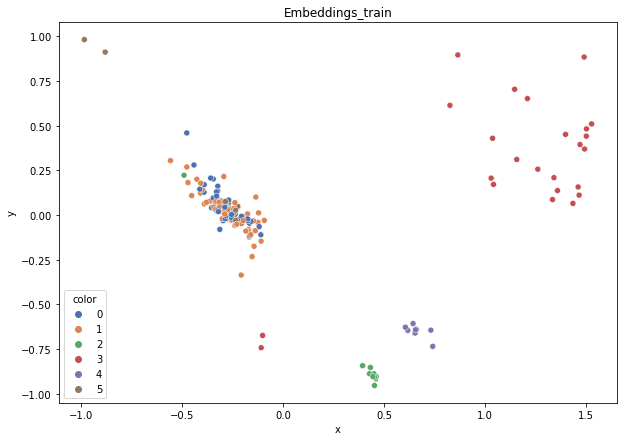

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.405
DT-f1-old+new-features: 0.366
DT-f1-old-features: 0.53
DT-gmean-new-features: 0.072
DT-gmean-old+new-features: 0.068
DT-gmean-old-features: 0.232
DT-minority_gmean-new-features: 0.003
DT-minority_gmean-old+new-features: 0.003
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.704
KNN-f1-old+new-features: 0.568
KNN-f1-old-features: 0.568
KNN-gmean-new-features: 0.681
KNN-gmean-old+new-features: 0.557
KNN-gmean-old-features: 0.557
KNN-minority_gmean-new-features: 0.044
KNN-minority_gmean-old+new-features: 0.021
KNN-minority_gmean-old-features: 0.021


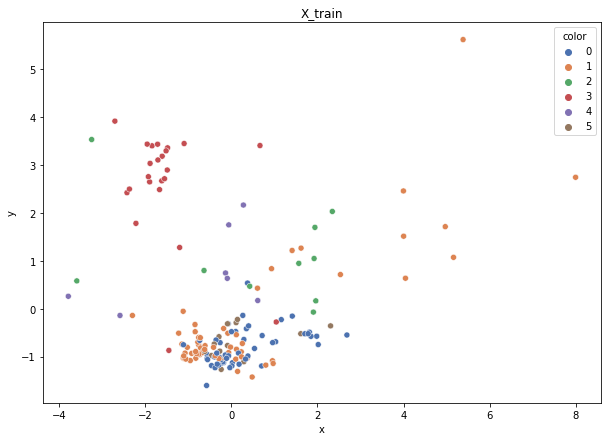

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 14, 2: 10, 4: 7})
Weights: {0: 0.04555224384573926, 5: 0.18220897538295705, 4: 0.3644179507659141, 1: 0.04181845336658031, 3: 0.11090981110266952, 2: 0.2550925655361399}
Training autoencoder...


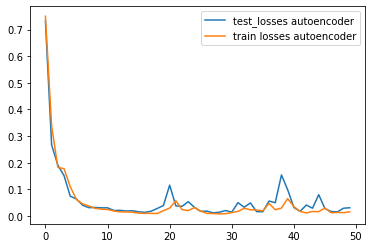

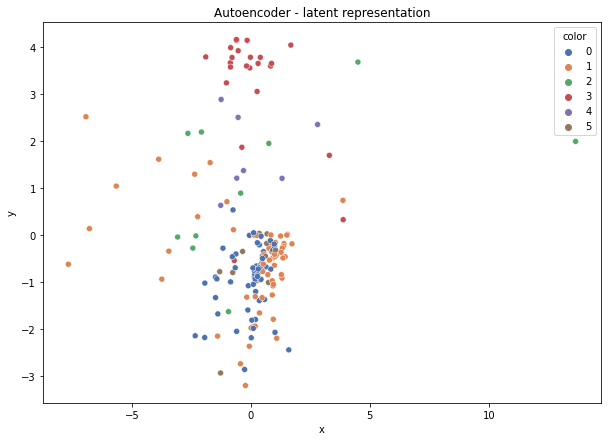

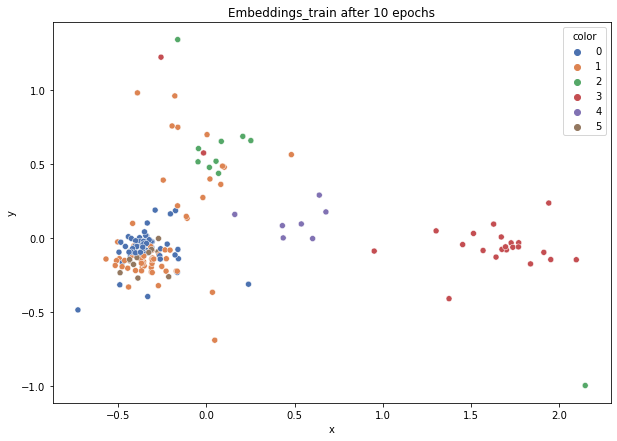

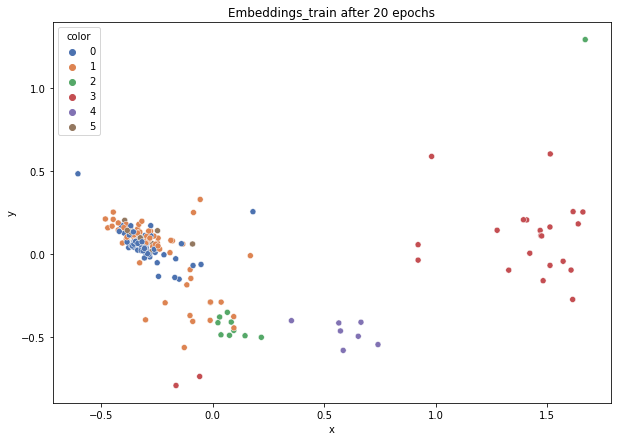

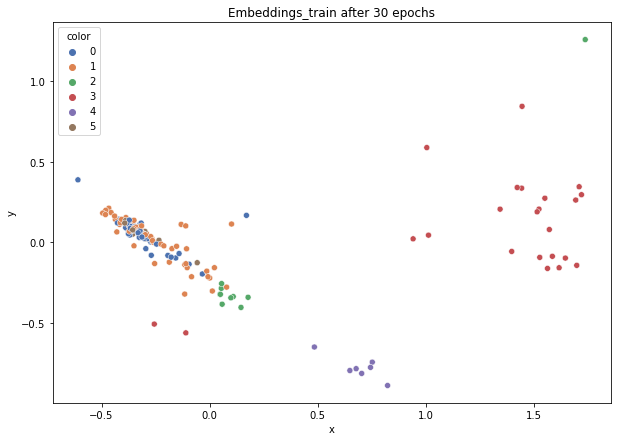

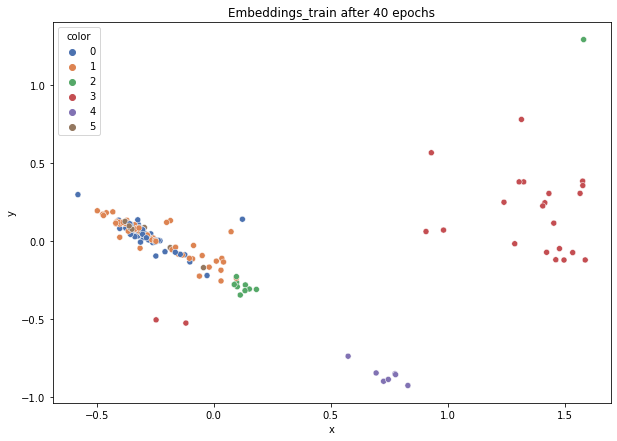

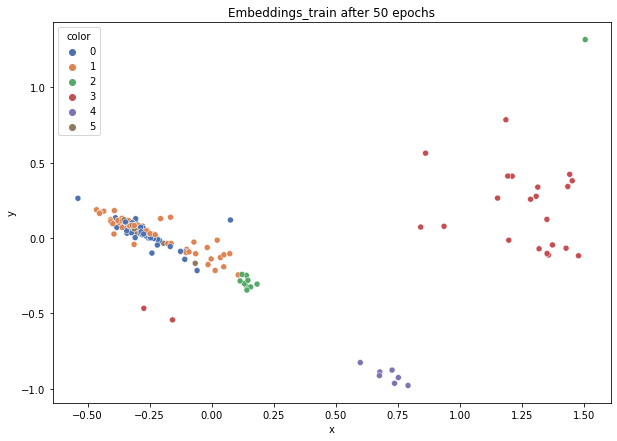

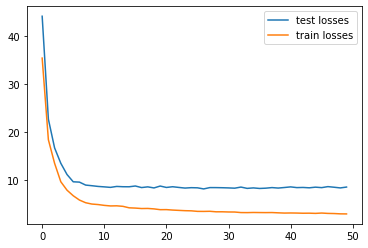

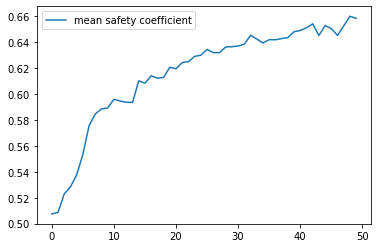

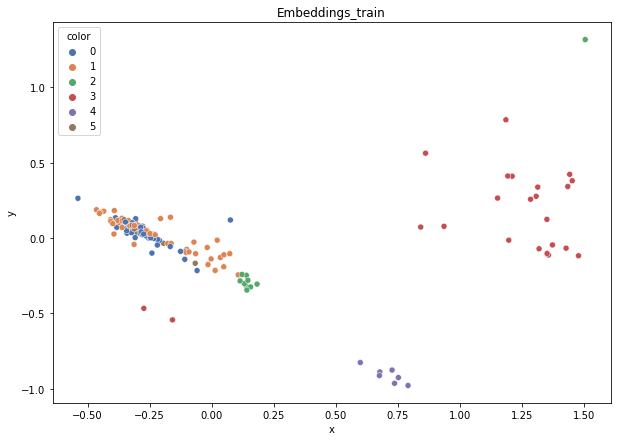

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.719
DT-f1-old+new-features: 0.788
DT-f1-old-features: 0.607
DT-gmean-new-features: 0.709
DT-gmean-old+new-features: 0.781
DT-gmean-old-features: 0.25
DT-minority_gmean-new-features: 0.15
DT-minority_gmean-old+new-features: 0.15
DT-minority_gmean-old-features: 0.032
KNN-f1-new-features: 0.705
KNN-f1-old+new-features: 0.661
KNN-f1-old-features: 0.661
KNN-gmean-new-features: 0.642
KNN-gmean-old+new-features: 0.246
KNN-gmean-old-features: 0.246
KNN-minority_gmean-new-features: 0.114
KNN-minority_gmean-old+new-features: 0.014
KNN-minority_gmean-old-features: 0.014


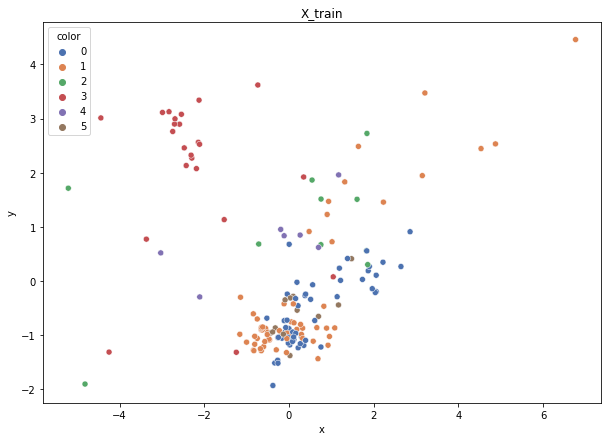

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 14, 2: 10, 4: 7})
Weights: {0: 0.04555224384573926, 5: 0.18220897538295705, 4: 0.3644179507659141, 1: 0.04181845336658031, 3: 0.11090981110266952, 2: 0.2550925655361399}
Training autoencoder...


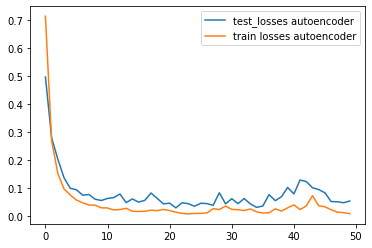

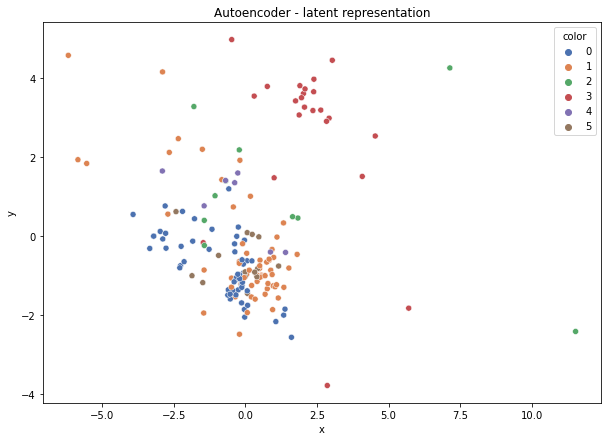

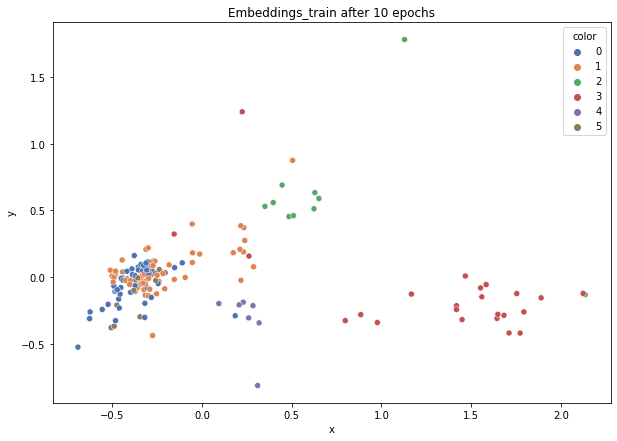

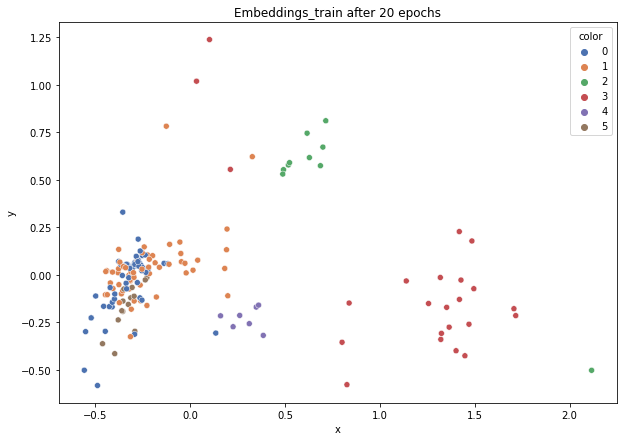

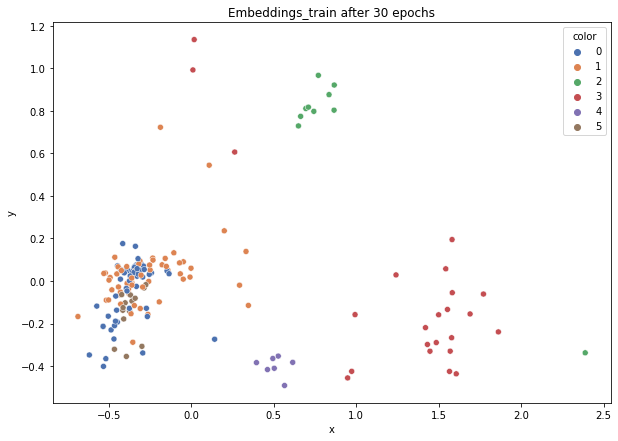

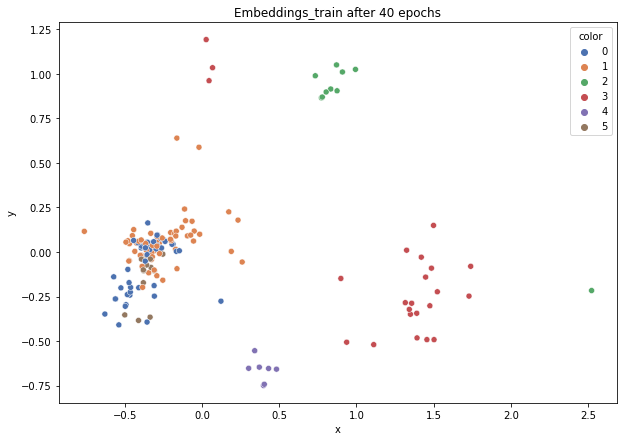

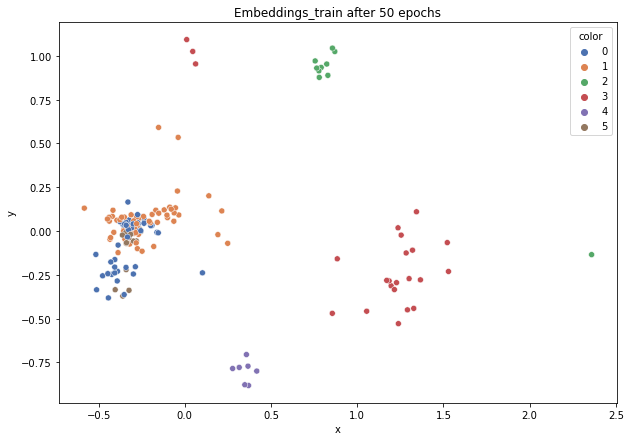

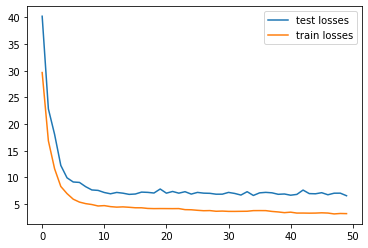

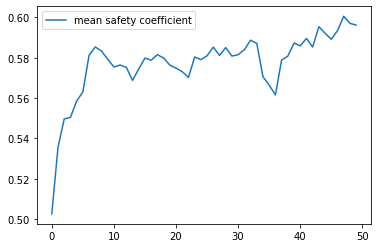

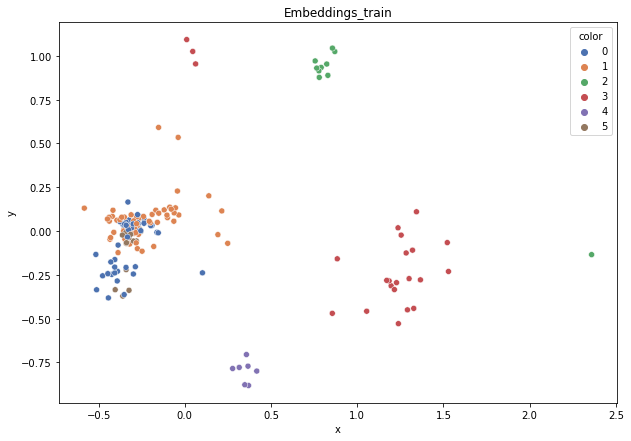

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.59
DT-f1-old+new-features: 0.656
DT-f1-old-features: 0.646
DT-gmean-new-features: 0.526
DT-gmean-old+new-features: 0.592
DT-gmean-old-features: 0.681
DT-minority_gmean-new-features: 0.041
DT-minority_gmean-old+new-features: 0.103
DT-minority_gmean-old-features: 0.161
KNN-f1-new-features: 0.604
KNN-f1-old+new-features: 0.651
KNN-f1-old-features: 0.641
KNN-gmean-new-features: 0.544
KNN-gmean-old+new-features: 0.595
KNN-gmean-old-features: 0.587
KNN-minority_gmean-new-features: 0.022
KNN-minority_gmean-old+new-features: 0.041
KNN-minority_gmean-old-features: 0.041


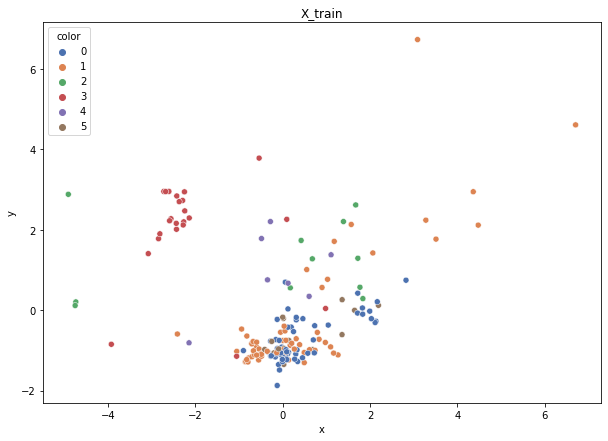

Class cardinalities: Counter({1: 61, 0: 56, 3: 23, 5: 14, 2: 11, 4: 7})
Weights: {0: 0.04663368999308034, 5: 0.18653475997232136, 4: 0.3730695199446427, 1: 0.04281125638709015, 3: 0.11354289737445648, 2: 0.237407876328409}
Training autoencoder...


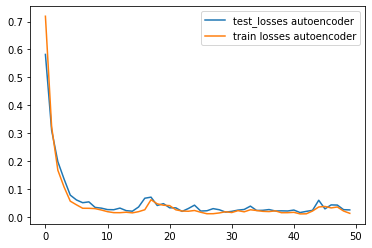

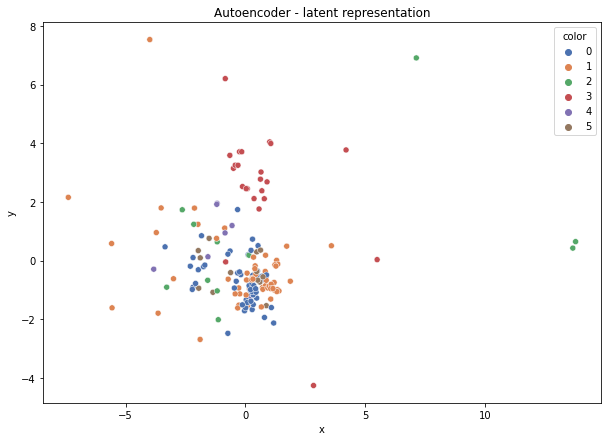

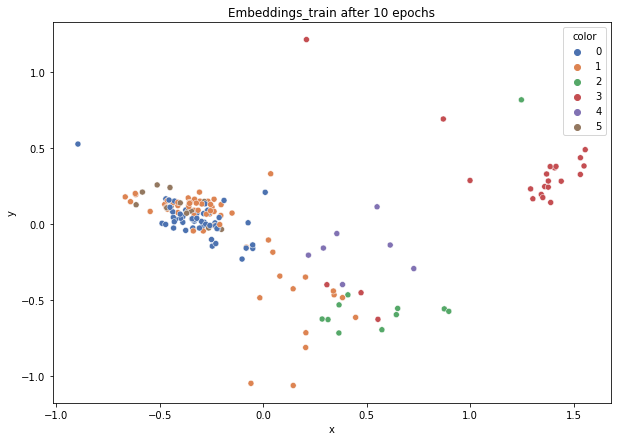

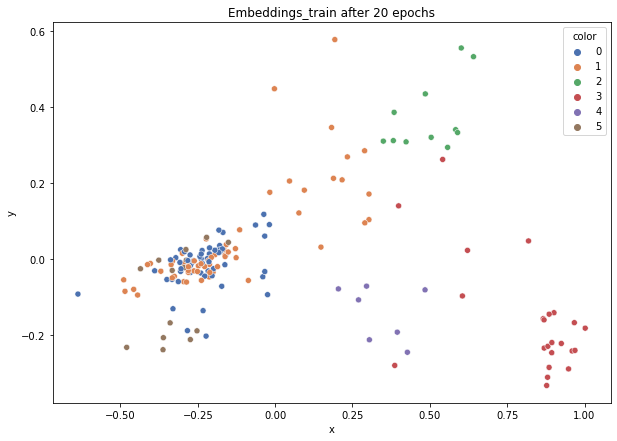

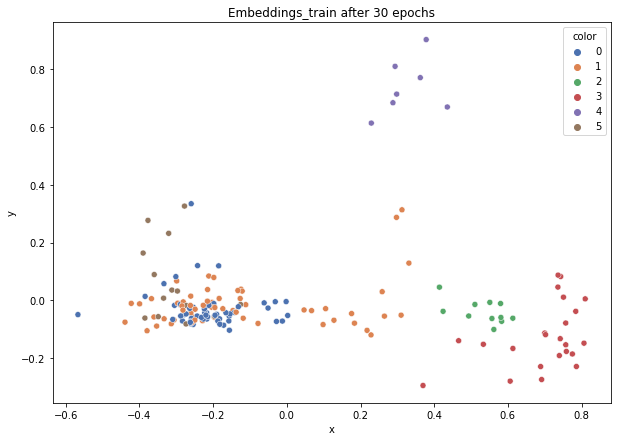

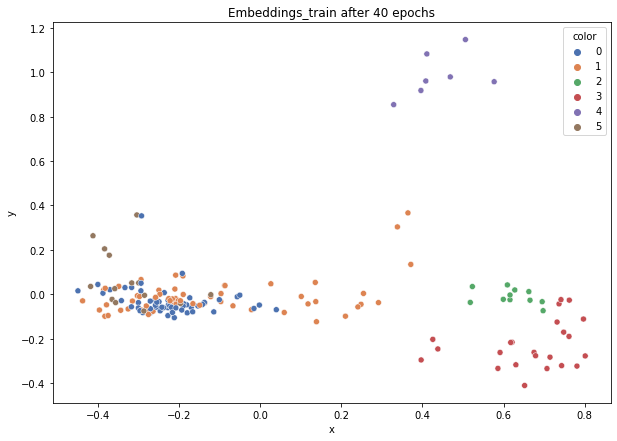

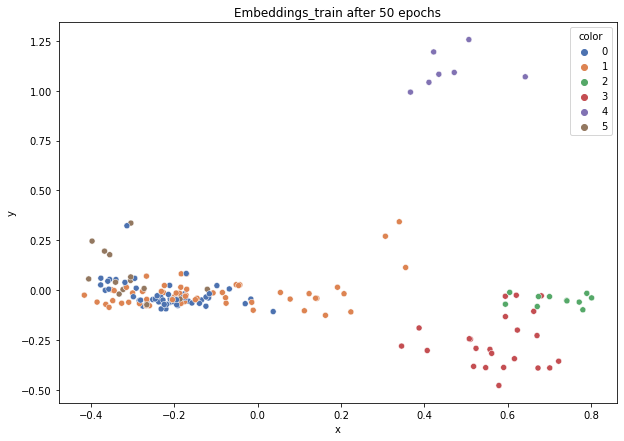

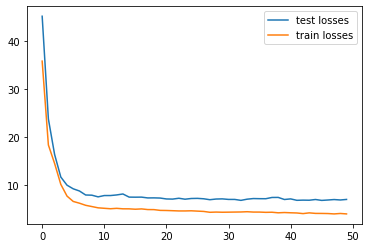

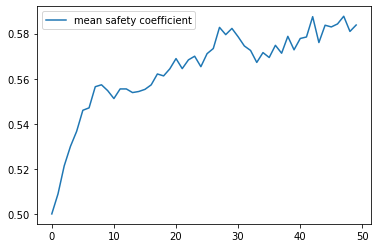

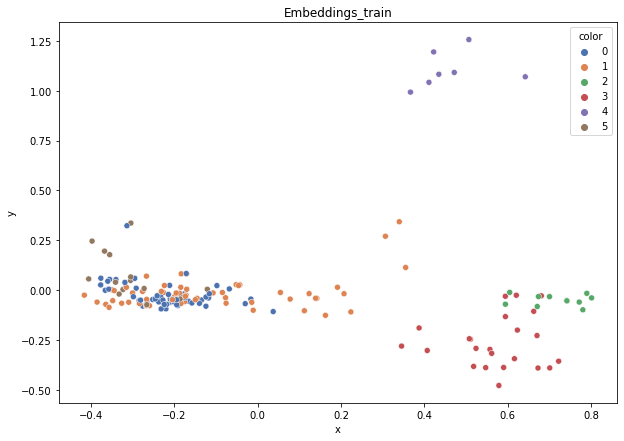

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.727
DT-f1-old+new-features: 0.703
DT-f1-old-features: 0.73
DT-gmean-new-features: 0.697
DT-gmean-old+new-features: 0.683
DT-gmean-old-features: 0.737
DT-minority_gmean-new-features: 0.051
DT-minority_gmean-old+new-features: 0.135
DT-minority_gmean-old-features: 0.051
KNN-f1-new-features: 0.695
KNN-f1-old+new-features: 0.678
KNN-f1-old-features: 0.678
KNN-gmean-new-features: 0.632
KNN-gmean-old+new-features: 0.681
KNN-gmean-old-features: 0.681
KNN-minority_gmean-new-features: 0.044
KNN-minority_gmean-old+new-features: 0.051
KNN-minority_gmean-old-features: 0.051
new_ecoli


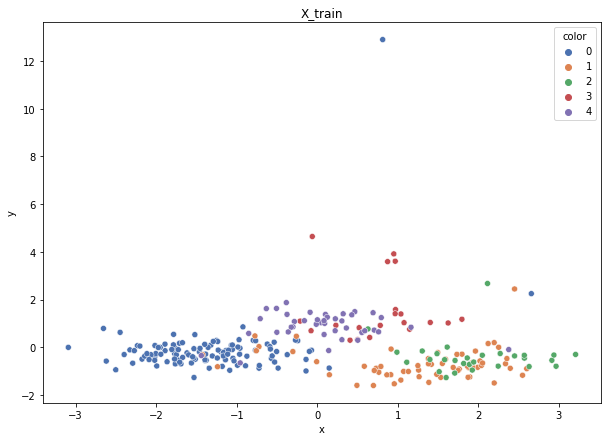

Class cardinalities: Counter({0: 116, 1: 61, 4: 41, 2: 30, 3: 20})
Weights: {0: 0.0649452946471851, 1: 0.1235025275257946, 2: 0.2511218059691157, 3: 0.37668270895367356, 4: 0.183747662904231}
Training autoencoder...


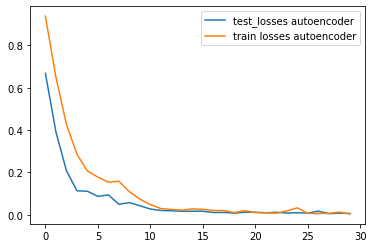

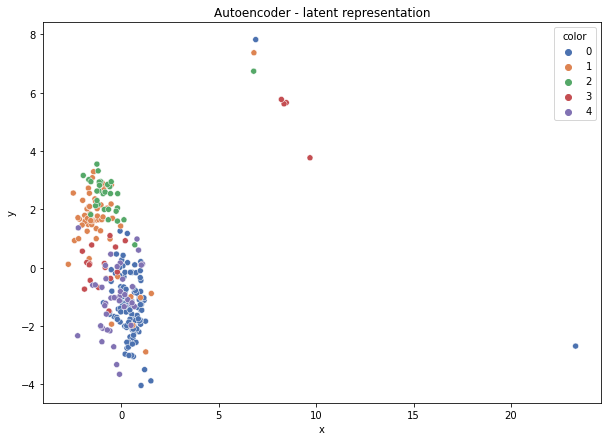

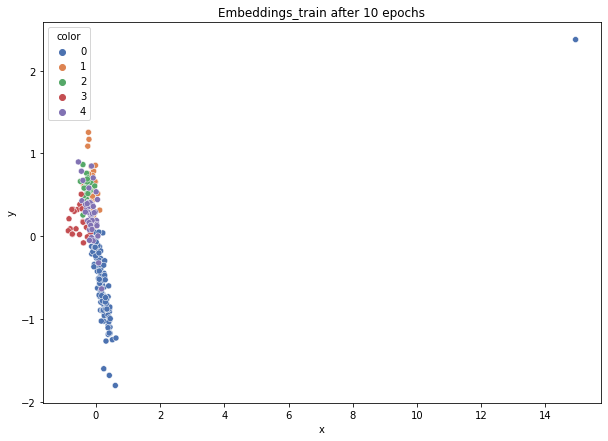

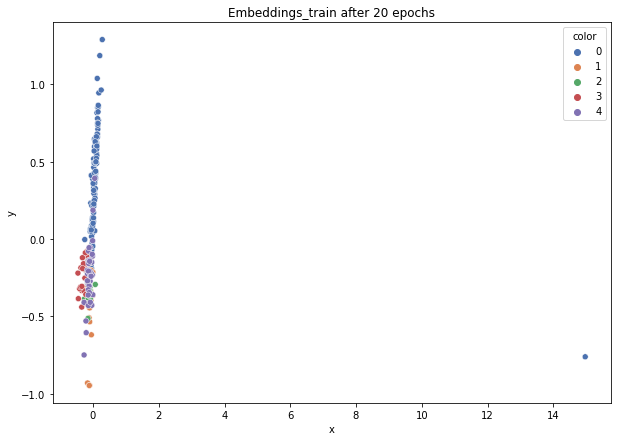

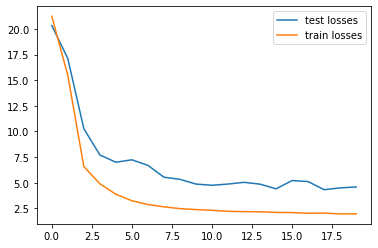

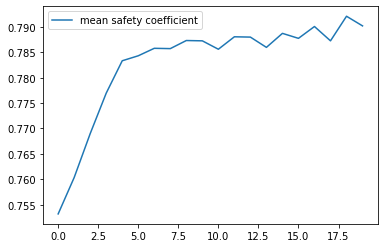

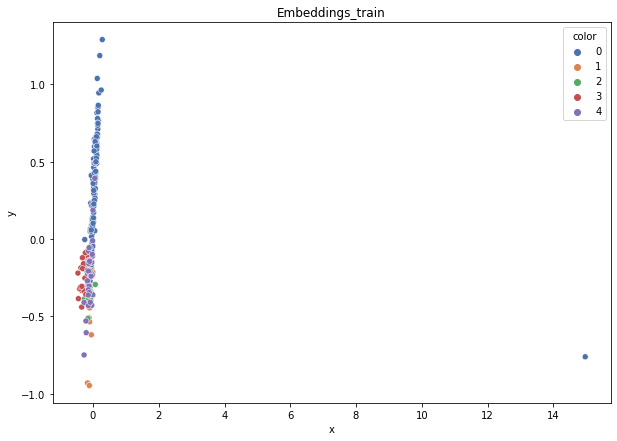

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.784
DT-f1-old+new-features: 0.66
DT-f1-old-features: 0.634
DT-gmean-new-features: 0.77
DT-gmean-old+new-features: 0.671
DT-gmean-old-features: 0.537
DT-minority_gmean-new-features: 0.054
DT-minority_gmean-old+new-features: 0.048
DT-minority_gmean-old-features: 0.04
KNN-f1-new-features: 0.843
KNN-f1-old+new-features: 0.788
KNN-f1-old-features: 0.749
KNN-gmean-new-features: 0.822
KNN-gmean-old+new-features: 0.757
KNN-gmean-old-features: 0.719
KNN-minority_gmean-new-features: 0.055
KNN-minority_gmean-old+new-features: 0.052
KNN-minority_gmean-old-features: 0.05


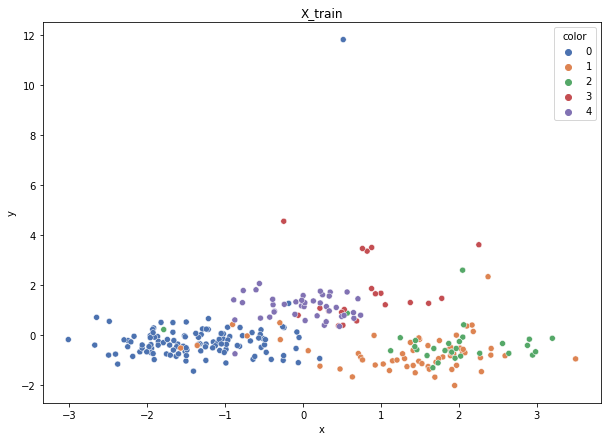

Class cardinalities: Counter({0: 116, 1: 61, 4: 42, 2: 30, 3: 20})
Weights: {0: 0.06523067522150933, 1: 0.12404521845401774, 2: 0.25222527752316937, 3: 0.3783379162847541, 4: 0.18016091251654956}
Training autoencoder...


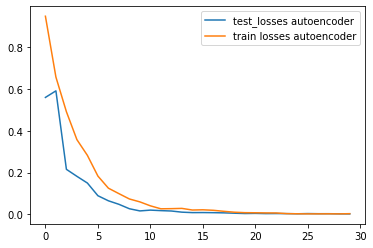

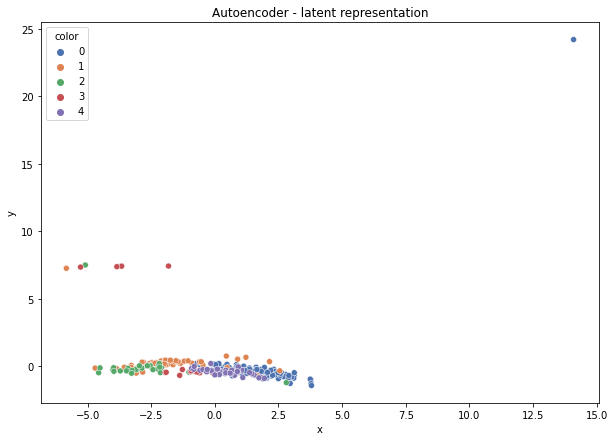

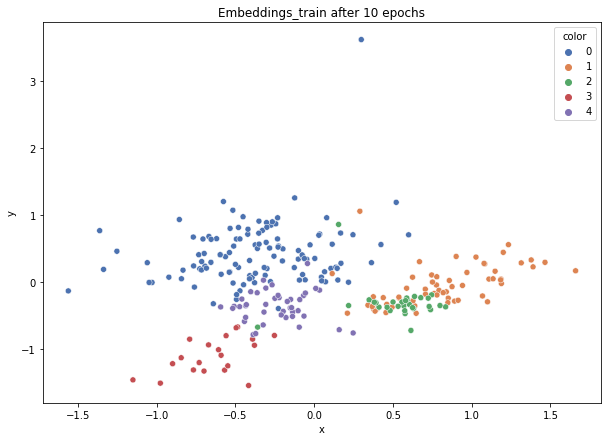

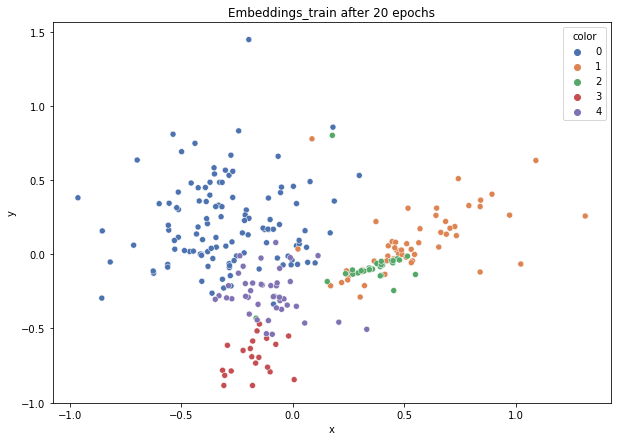

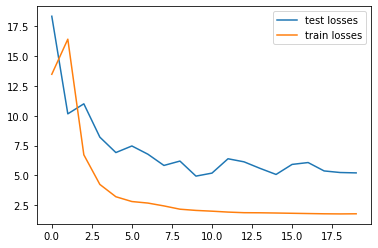

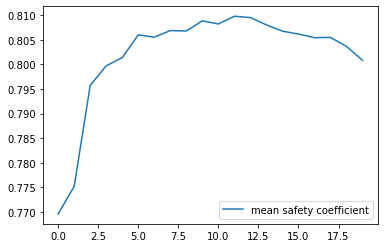

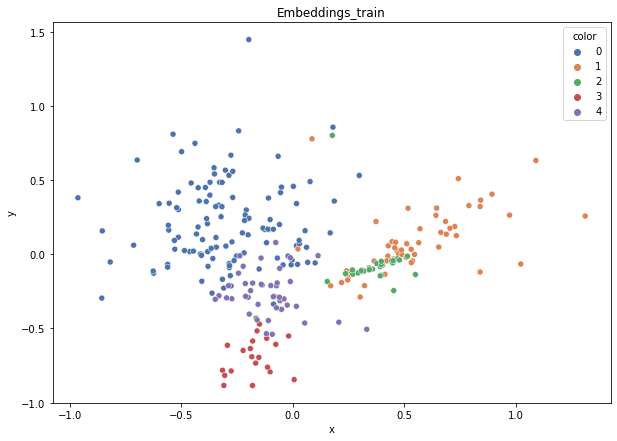

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.831
DT-f1-old+new-features: 0.817
DT-f1-old-features: 0.707
DT-gmean-new-features: 0.827
DT-gmean-old+new-features: 0.809
DT-gmean-old-features: 0.688
DT-minority_gmean-new-features: 0.054
DT-minority_gmean-old+new-features: 0.053
DT-minority_gmean-old-features: 0.049
KNN-f1-new-features: 0.829
KNN-f1-old+new-features: 0.706
KNN-f1-old-features: 0.728
KNN-gmean-new-features: 0.815
KNN-gmean-old+new-features: 0.678
KNN-gmean-old-features: 0.709
KNN-minority_gmean-new-features: 0.053
KNN-minority_gmean-old+new-features: 0.049
KNN-minority_gmean-old-features: 0.051


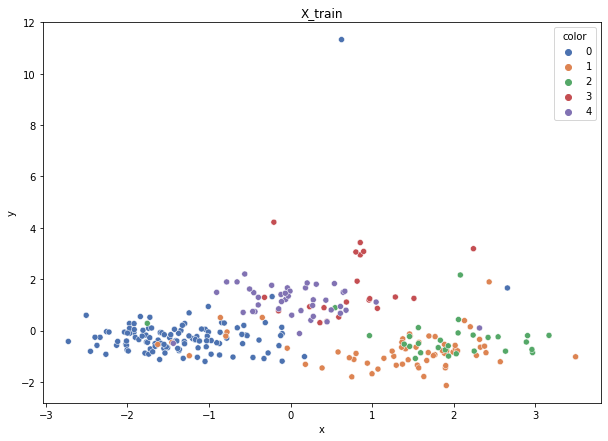

Class cardinalities: Counter({0: 116, 1: 62, 4: 42, 2: 29, 3: 20})
Weights: {0: 0.06479675120436358, 1: 0.12123263128558347, 2: 0.2591870048174543, 3: 0.37582115698530877, 4: 0.17896245570728986}
Training autoencoder...


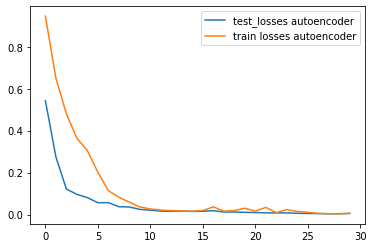

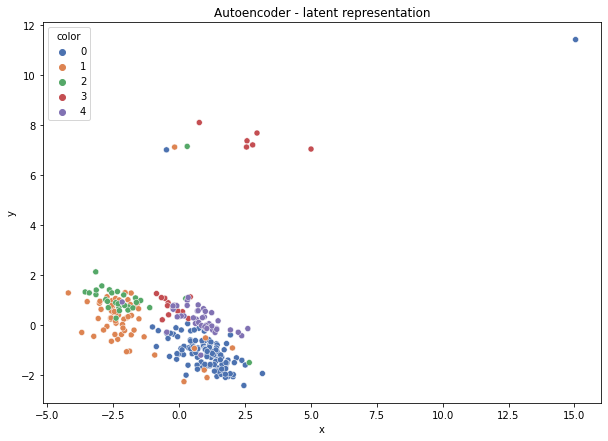

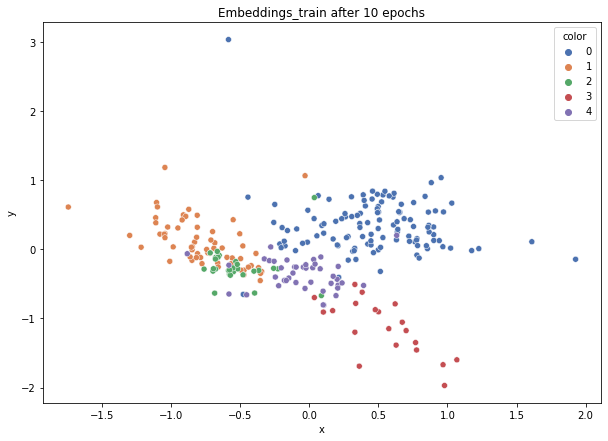

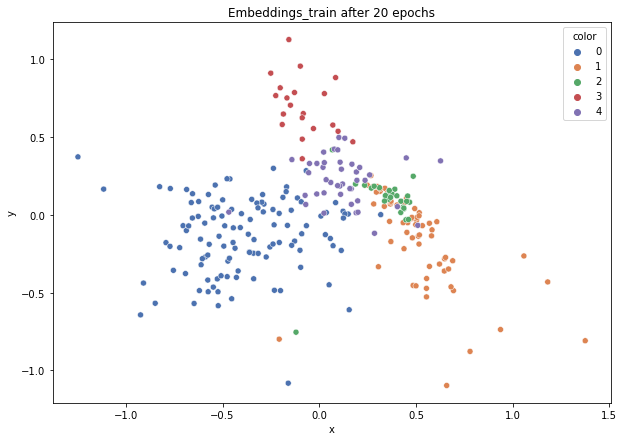

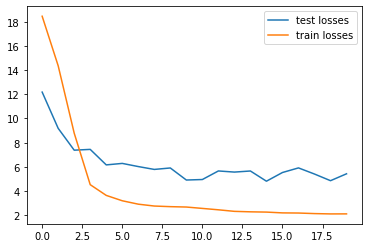

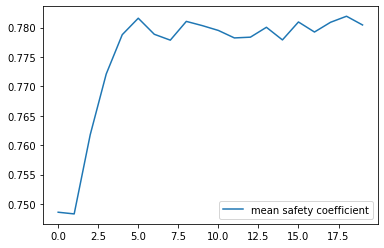

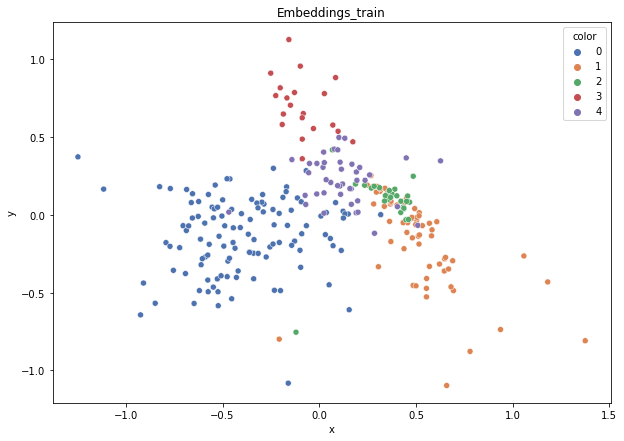

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.853
DT-f1-old+new-features: 0.861
DT-f1-old-features: 0.722
DT-gmean-new-features: 0.851
DT-gmean-old+new-features: 0.871
DT-gmean-old-features: 0.69
DT-minority_gmean-new-features: 0.057
DT-minority_gmean-old+new-features: 0.059
DT-minority_gmean-old-features: 0.046
KNN-f1-new-features: 0.832
KNN-f1-old+new-features: 0.846
KNN-f1-old-features: 0.862
KNN-gmean-new-features: 0.798
KNN-gmean-old+new-features: 0.794
KNN-gmean-old-features: 0.815
KNN-minority_gmean-new-features: 0.053
KNN-minority_gmean-old+new-features: 0.051
KNN-minority_gmean-old-features: 0.053


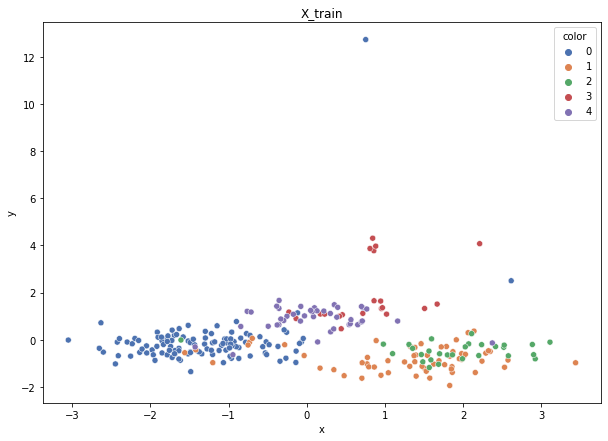

Class cardinalities: Counter({0: 116, 1: 62, 4: 42, 2: 29, 3: 20})
Weights: {0: 0.06479675120436358, 1: 0.12123263128558347, 2: 0.2591870048174543, 3: 0.37582115698530877, 4: 0.17896245570728986}
Training autoencoder...


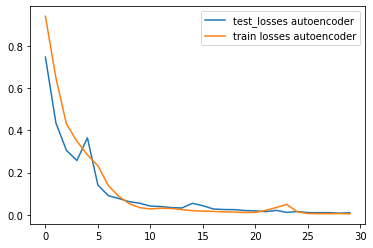

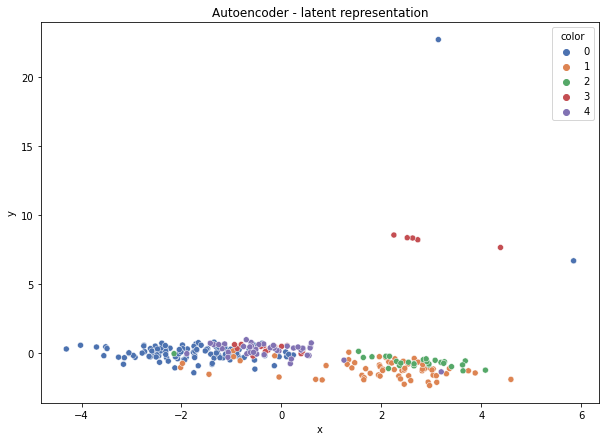

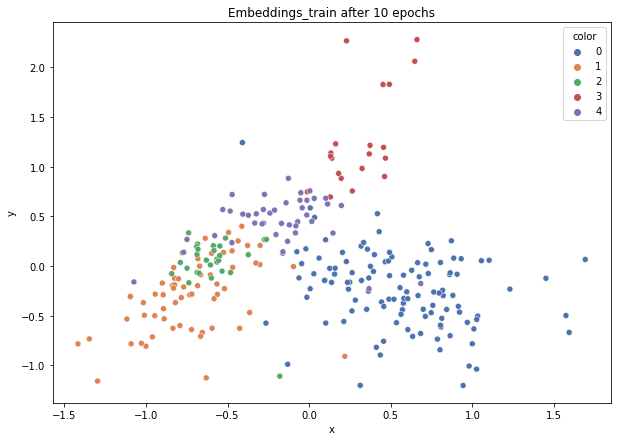

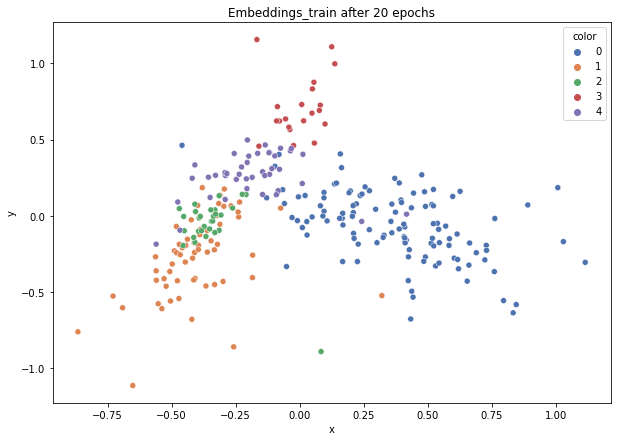

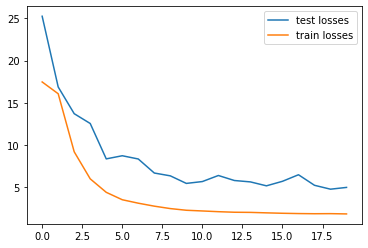

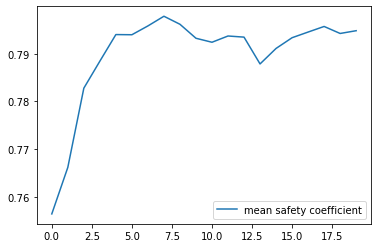

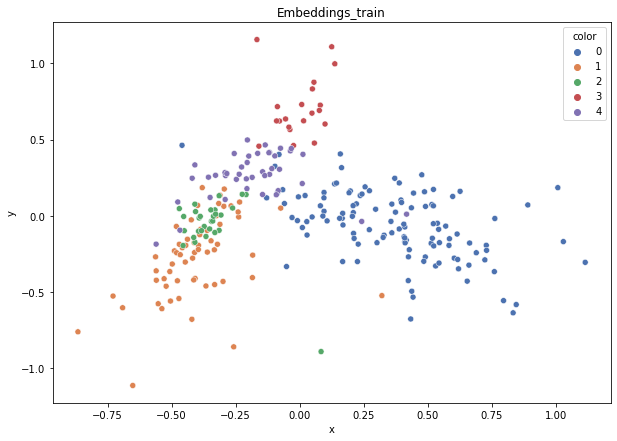

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.756
DT-f1-old+new-features: 0.799
DT-f1-old-features: 0.649
DT-gmean-new-features: 0.77
DT-gmean-old+new-features: 0.809
DT-gmean-old-features: 0.606
DT-minority_gmean-new-features: 0.151
DT-minority_gmean-old+new-features: 0.157
DT-minority_gmean-old-features: 0.105
KNN-f1-new-features: 0.758
KNN-f1-old+new-features: 0.792
KNN-f1-old-features: 0.817
KNN-gmean-new-features: 0.729
KNN-gmean-old+new-features: 0.761
KNN-gmean-old-features: 0.782
KNN-minority_gmean-new-features: 0.053
KNN-minority_gmean-old+new-features: 0.051
KNN-minority_gmean-old-features: 0.053


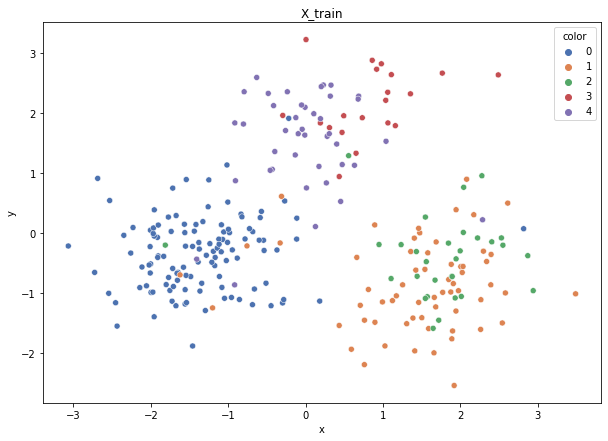

Class cardinalities: Counter({0: 116, 1: 62, 4: 41, 2: 30, 3: 20})
Weights: {0: 0.06507492234699798, 1: 0.12175308052018977, 2: 0.25162303307505884, 3: 0.3774345496125883, 4: 0.18411441444516502}
Training autoencoder...


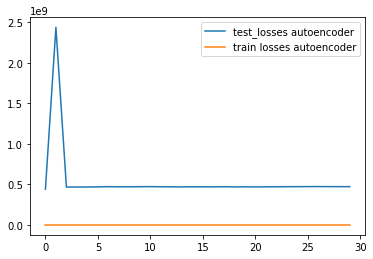

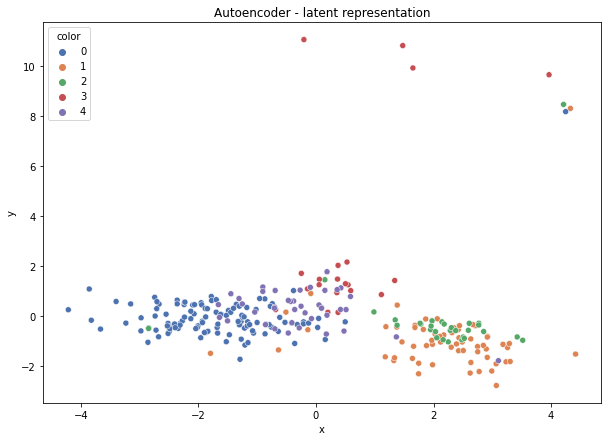

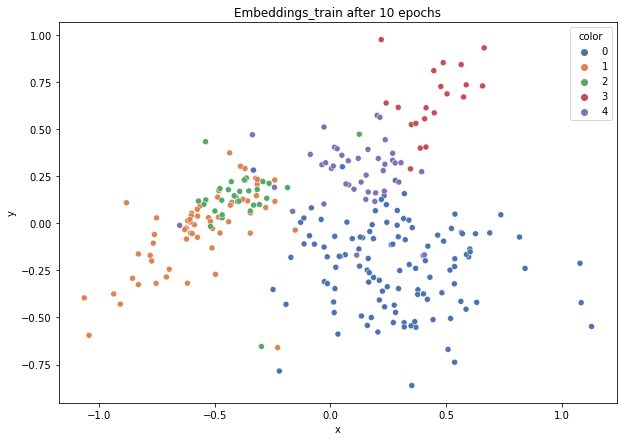

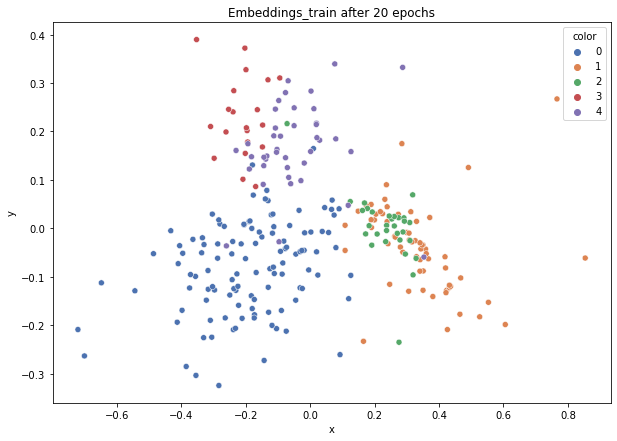

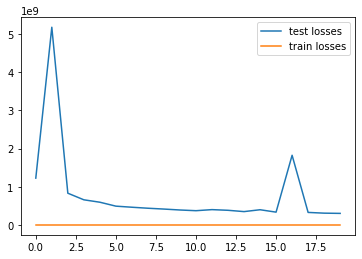

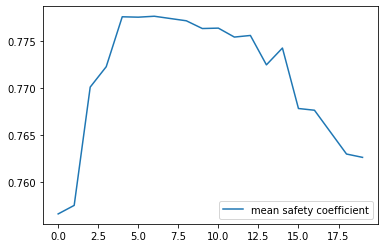

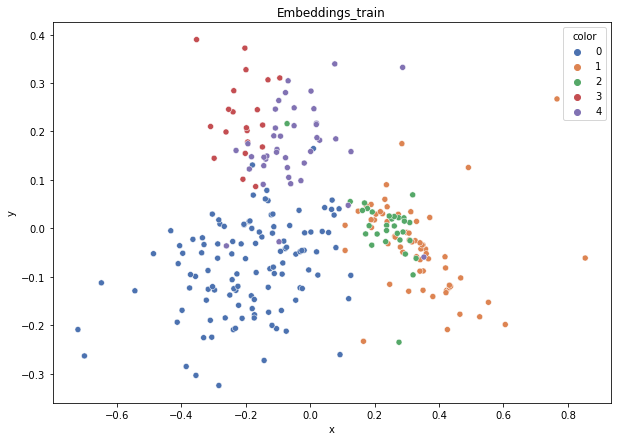

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.666
DT-f1-old+new-features: 0.704
DT-f1-old-features: 0.793
DT-gmean-new-features: 0.658
DT-gmean-old+new-features: 0.68
DT-gmean-old-features: 0.822
DT-minority_gmean-new-features: 0.048
DT-minority_gmean-old+new-features: 0.046
DT-minority_gmean-old-features: 0.155
KNN-f1-new-features: 0.787
KNN-f1-old+new-features: 0.82
KNN-f1-old-features: 0.808
KNN-gmean-new-features: 0.8
KNN-gmean-old+new-features: 0.827
KNN-gmean-old-features: 0.84
KNN-minority_gmean-new-features: 0.055
KNN-minority_gmean-old+new-features: 0.151
KNN-minority_gmean-old-features: 0.155
new_led7digit


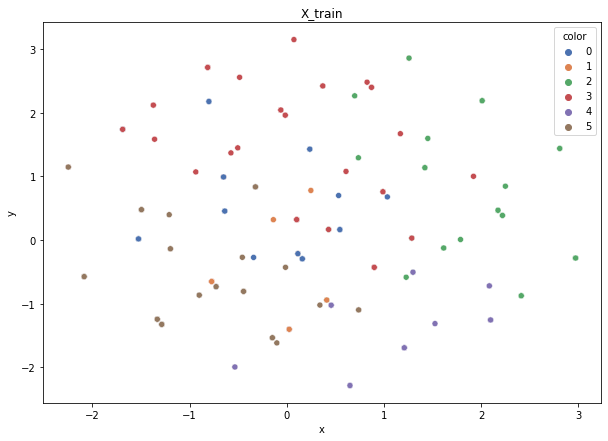

Class cardinalities: Counter({3: 87, 5: 79, 0: 78, 2: 75, 4: 41, 1: 40})
Weights: {0: 0.12859532399632337, 2: 0.1337391369561763, 3: 0.11529235944497956, 4: 0.24464476272471275, 5: 0.1269675350849775, 1: 0.25076088179283057}
Training autoencoder...


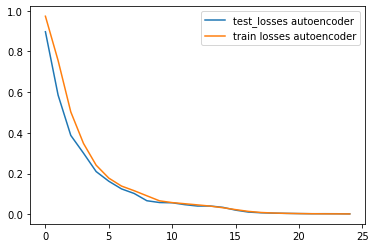

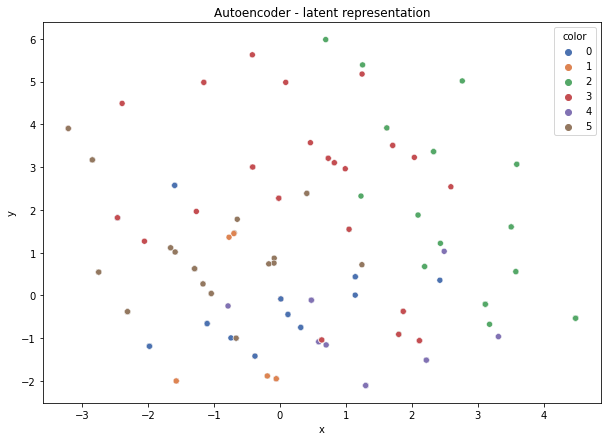

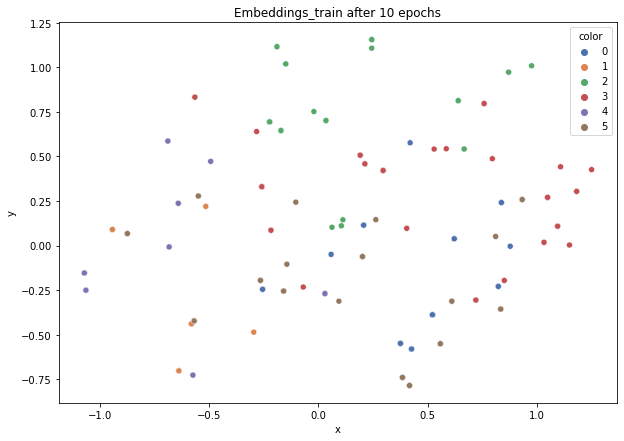

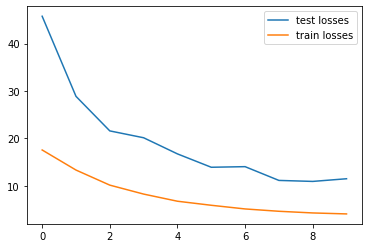

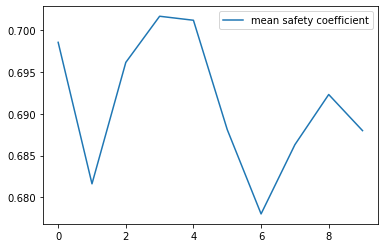

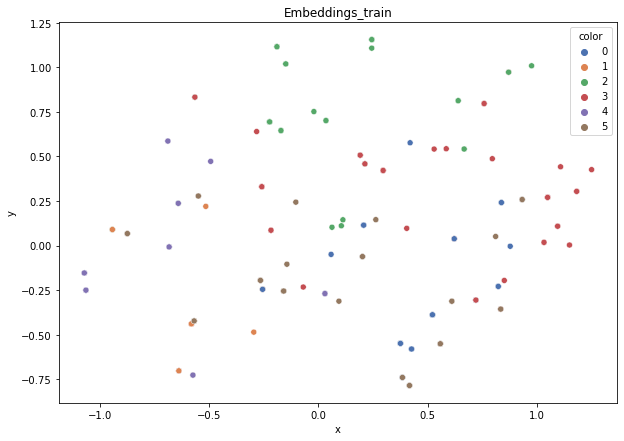

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.758
DT-f1-old+new-features: 0.769
DT-f1-old-features: 0.789
DT-gmean-new-features: 0.763
DT-gmean-old+new-features: 0.773
DT-gmean-old-features: 0.797
DT-minority_gmean-new-features: 0.014
DT-minority_gmean-old+new-features: 0.014
DT-minority_gmean-old-features: 0.014
KNN-f1-new-features: 0.612
KNN-f1-old+new-features: 0.749
KNN-f1-old-features: 0.741
KNN-gmean-new-features: 0.246
KNN-gmean-old+new-features: 0.726
KNN-gmean-old-features: 0.719
KNN-minority_gmean-new-features: 0.003
KNN-minority_gmean-old+new-features: 0.008
KNN-minority_gmean-old-features: 0.008


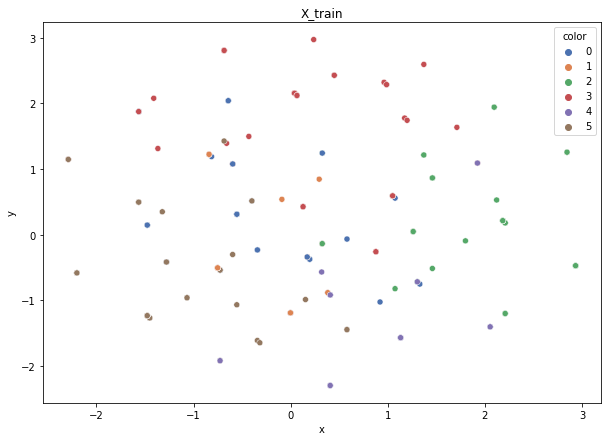

Class cardinalities: Counter({3: 87, 5: 80, 0: 78, 2: 75, 4: 41, 1: 39})
Weights: {0: 0.1279755802357915, 2: 0.13309460344522317, 3: 0.114736727107951, 4: 0.2434657380095546, 5: 0.12477619072989674, 1: 0.255951160471583}
Training autoencoder...


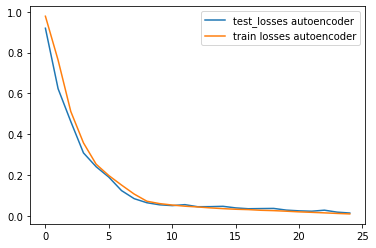

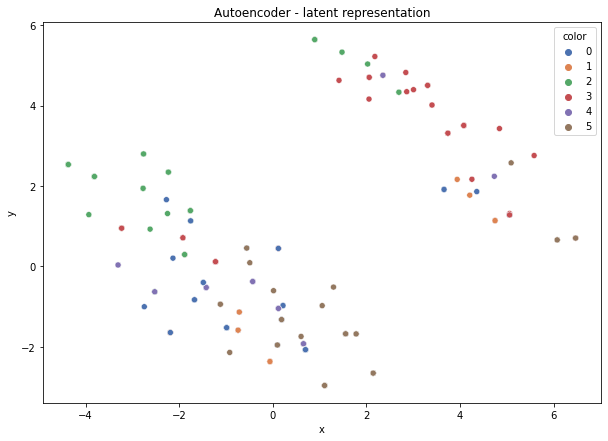

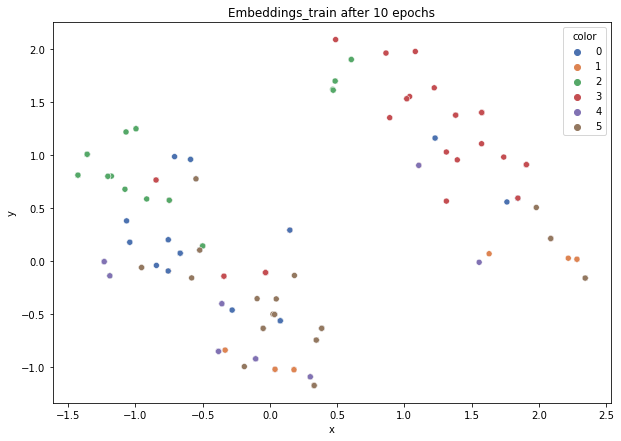

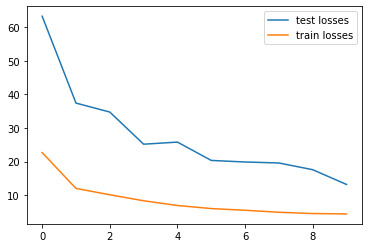

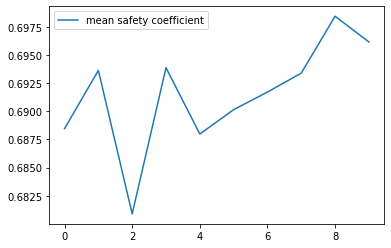

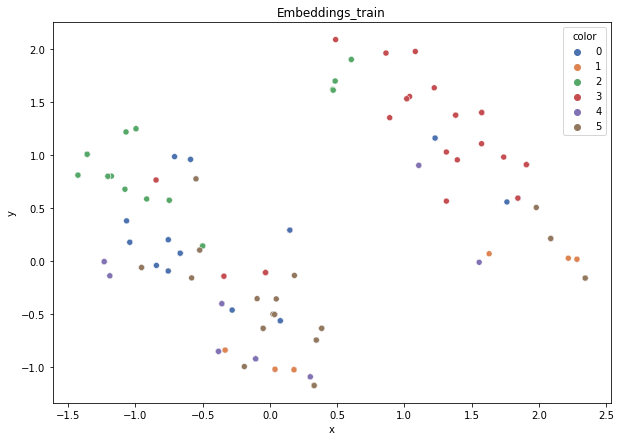

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.74
DT-f1-old+new-features: 0.718
DT-f1-old-features: 0.779
DT-gmean-new-features: 0.715
DT-gmean-old+new-features: 0.689
DT-gmean-old-features: 0.755
DT-minority_gmean-new-features: 0.013
DT-minority_gmean-old+new-features: 0.012
DT-minority_gmean-old-features: 0.008
KNN-f1-new-features: 0.767
KNN-f1-old+new-features: 0.688
KNN-f1-old-features: 0.692
KNN-gmean-new-features: 0.736
KNN-gmean-old+new-features: 0.649
KNN-gmean-old-features: 0.283
KNN-minority_gmean-new-features: 0.008
KNN-minority_gmean-old+new-features: 0.008
KNN-minority_gmean-old-features: 0.004


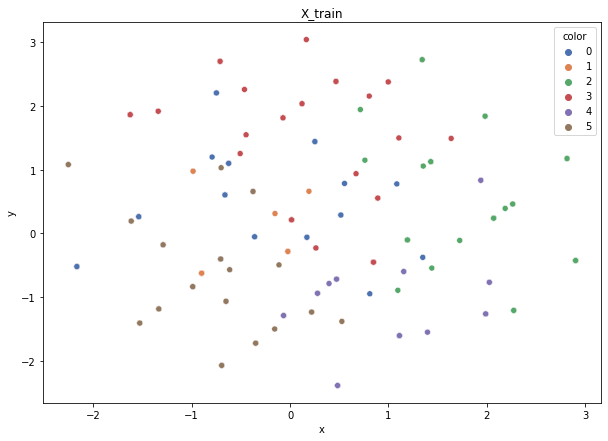

Class cardinalities: Counter({3: 86, 5: 79, 0: 78, 2: 76, 4: 42, 1: 39})
Weights: {0: 0.12857143873483481, 2: 0.1319548976489094, 3: 0.11661130489903622, 4: 0.23877552907897892, 5: 0.12694395216857107, 1: 0.25714287746966963}
Training autoencoder...


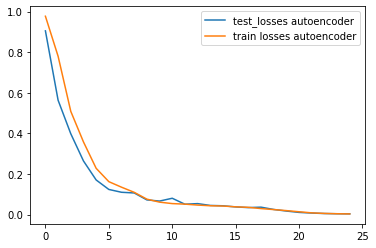

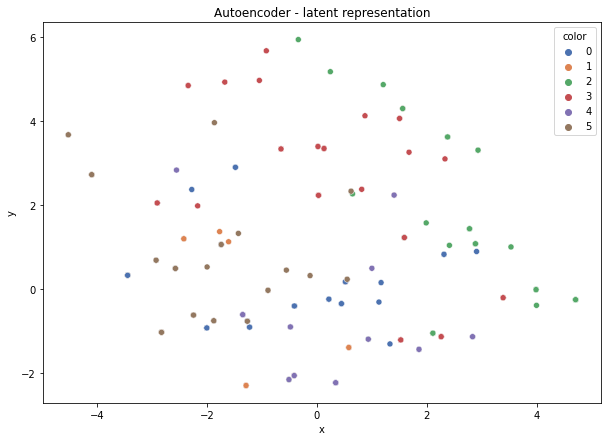

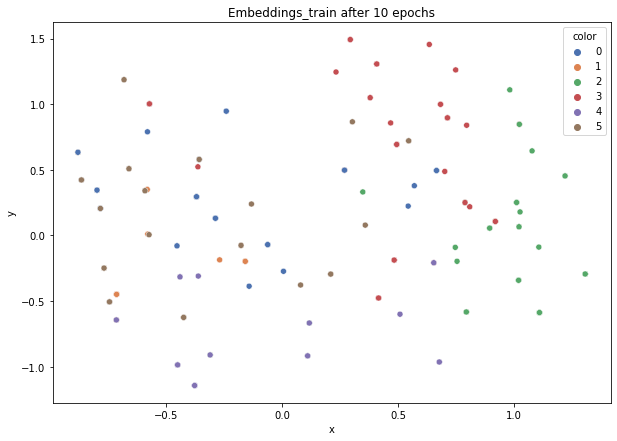

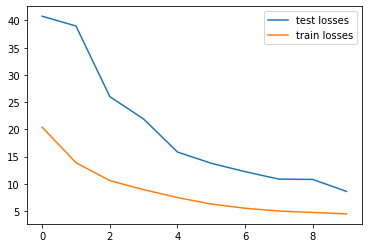

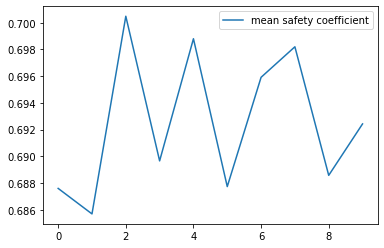

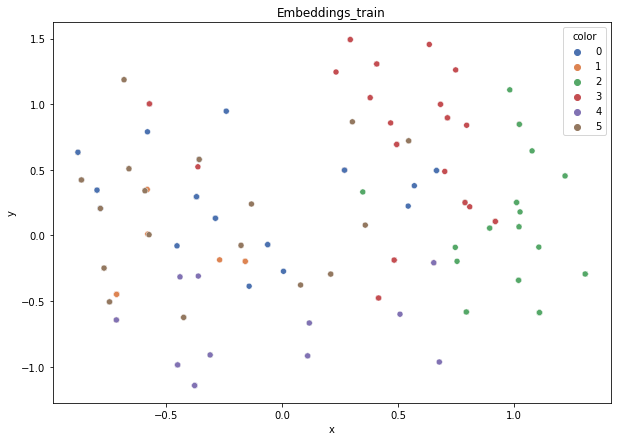

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.764
DT-f1-old+new-features: 0.775
DT-f1-old-features: 0.782
DT-gmean-new-features: 0.77
DT-gmean-old+new-features: 0.783
DT-gmean-old-features: 0.783
DT-minority_gmean-new-features: 0.081
DT-minority_gmean-old+new-features: 0.084
DT-minority_gmean-old-features: 0.081
KNN-f1-new-features: 0.71
KNN-f1-old+new-features: 0.731
KNN-f1-old-features: 0.739
KNN-gmean-new-features: 0.668
KNN-gmean-old+new-features: 0.731
KNN-gmean-old-features: 0.739
KNN-minority_gmean-new-features: 0.024
KNN-minority_gmean-old+new-features: 0.081
KNN-minority_gmean-old-features: 0.081


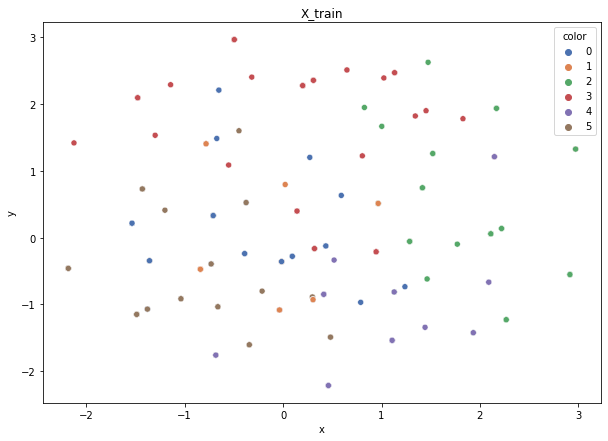

Class cardinalities: Counter({3: 86, 0: 79, 5: 79, 2: 75, 4: 42, 1: 39})
Weights: {0: 0.12692720893782067, 2: 0.13369666008117112, 3: 0.11659592448939342, 4: 0.23874403585923412, 5: 0.12692720893782067, 1: 0.2571089616945598}
Training autoencoder...


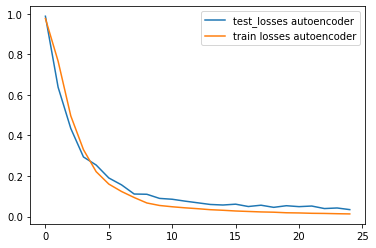

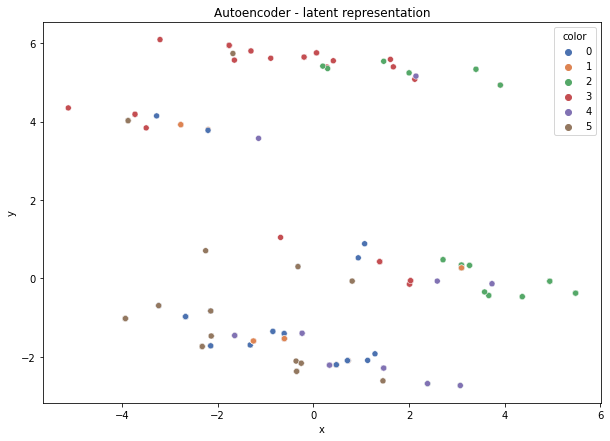

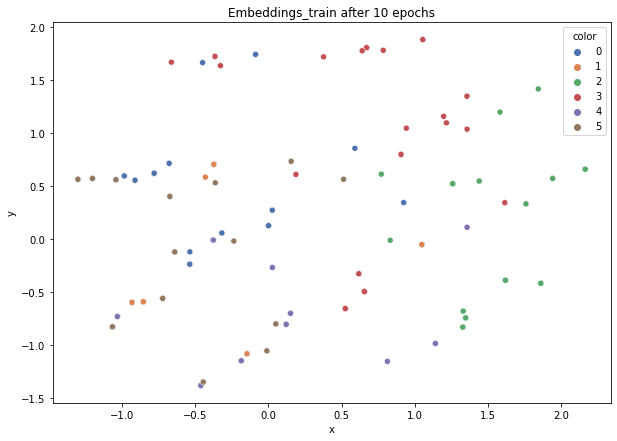

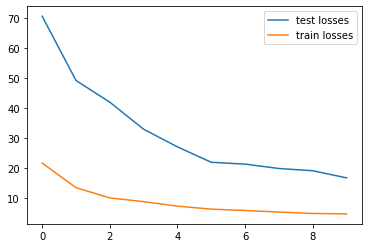

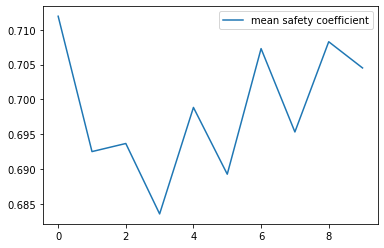

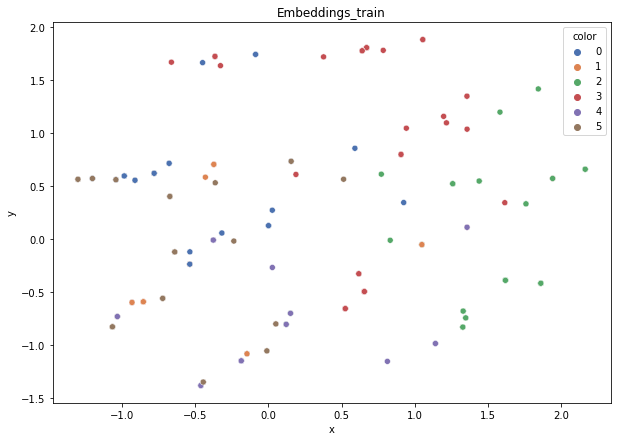

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.723
DT-f1-old+new-features: 0.725
DT-f1-old-features: 0.716
DT-gmean-new-features: 0.711
DT-gmean-old+new-features: 0.706
DT-gmean-old-features: 0.698
DT-minority_gmean-new-features: 0.029
DT-minority_gmean-old+new-features: 0.03
DT-minority_gmean-old-features: 0.03
KNN-f1-new-features: 0.783
KNN-f1-old+new-features: 0.773
KNN-f1-old-features: 0.714
KNN-gmean-new-features: 0.772
KNN-gmean-old+new-features: 0.764
KNN-gmean-old-features: 0.704
KNN-minority_gmean-new-features: 0.029
KNN-minority_gmean-old+new-features: 0.029
KNN-minority_gmean-old-features: 0.029


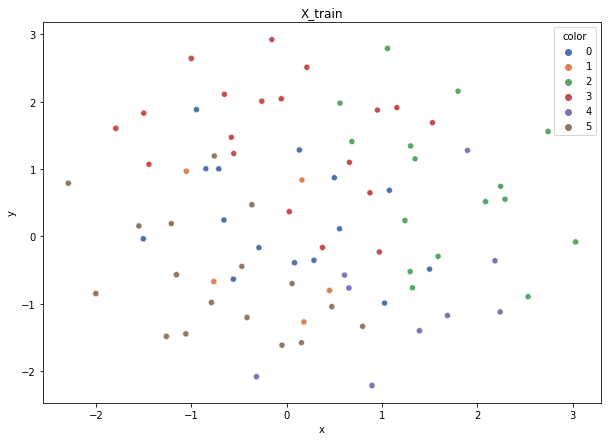

Class cardinalities: Counter({3: 86, 0: 79, 5: 79, 2: 75, 4: 42, 1: 39})
Weights: {0: 0.12692720893782067, 2: 0.13369666008117112, 3: 0.11659592448939342, 4: 0.23874403585923412, 5: 0.12692720893782067, 1: 0.2571089616945598}
Training autoencoder...


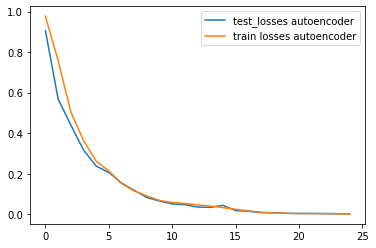

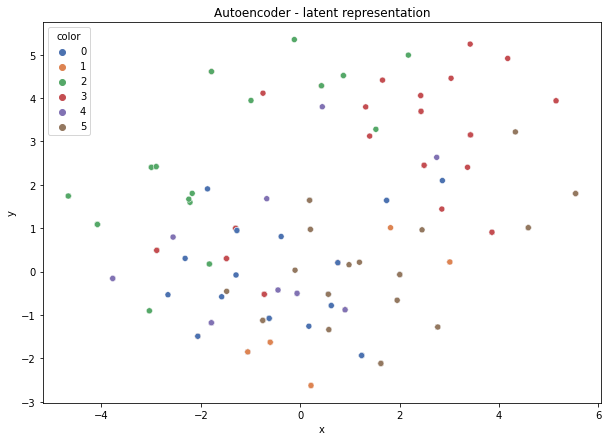

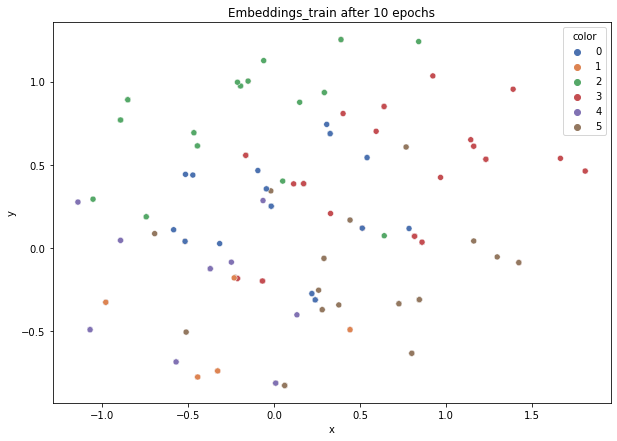

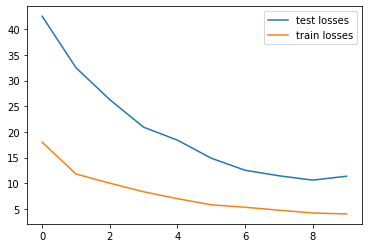

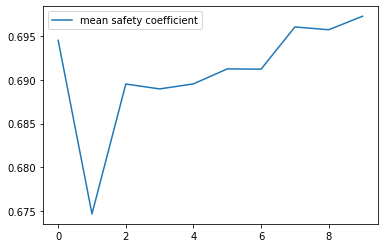

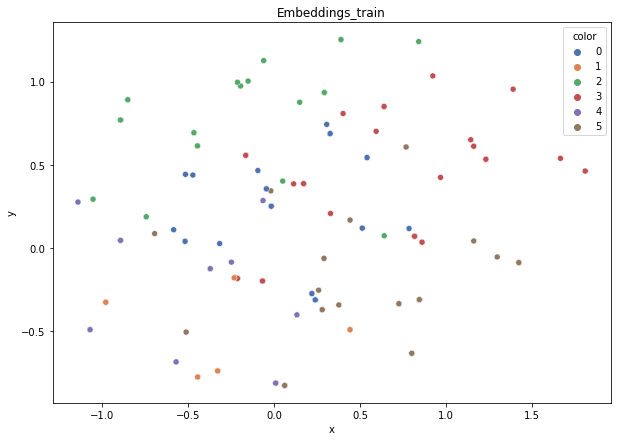

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.802
DT-f1-old+new-features: 0.777
DT-f1-old-features: 0.802
DT-gmean-new-features: 0.806
DT-gmean-old+new-features: 0.781
DT-gmean-old-features: 0.806
DT-minority_gmean-new-features: 0.027
DT-minority_gmean-old+new-features: 0.027
DT-minority_gmean-old-features: 0.027
KNN-f1-new-features: 0.811
KNN-f1-old+new-features: 0.803
KNN-f1-old-features: 0.785
KNN-gmean-new-features: 0.814
KNN-gmean-old+new-features: 0.806
KNN-gmean-old-features: 0.796
KNN-minority_gmean-new-features: 0.028
KNN-minority_gmean-old+new-features: 0.028
KNN-minority_gmean-old-features: 0.029
new_winequality-red


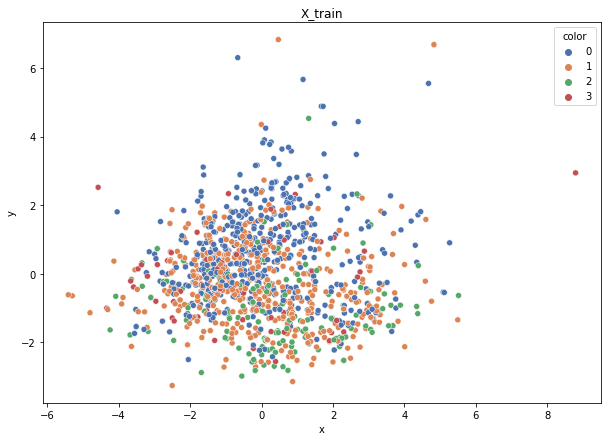

Class cardinalities: Counter({0: 544, 1: 511, 2: 159, 3: 65})
Weights: {0: 0.07217510080141348, 1: 0.07683611513888246, 2: 0.246938709660182, 3: 0.6040500743995221}
Training autoencoder...


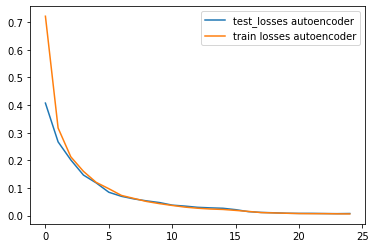

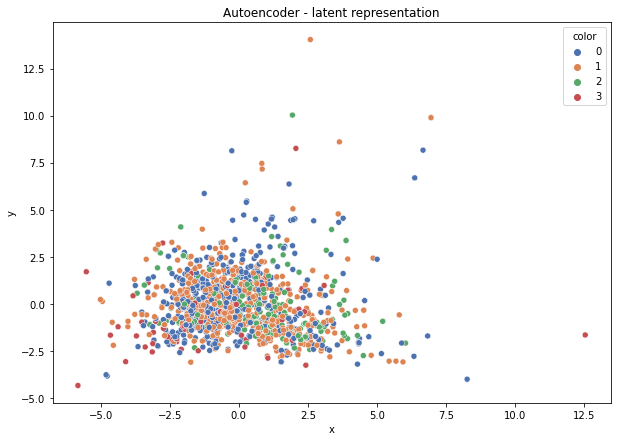

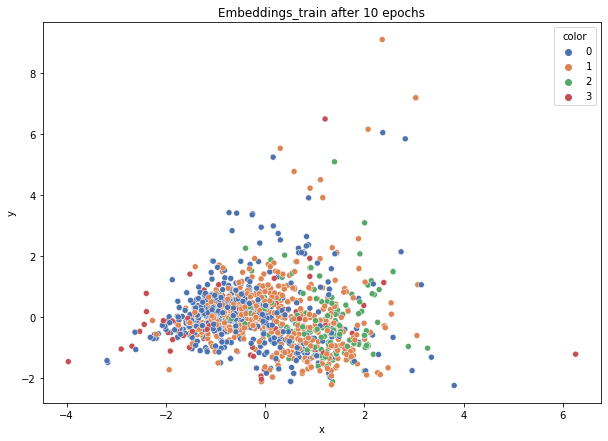

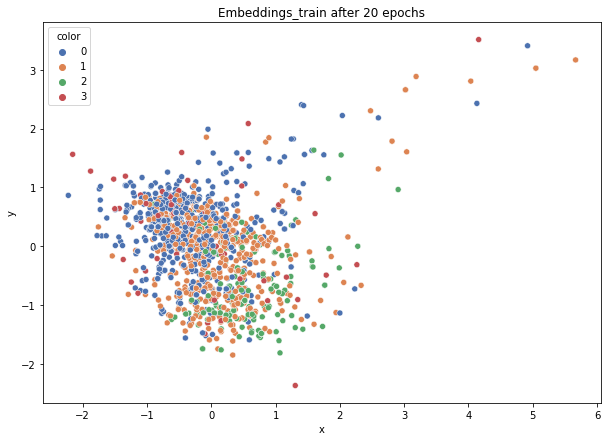

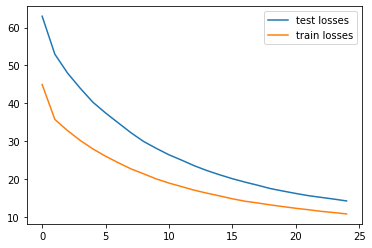

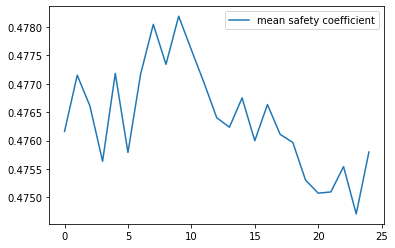

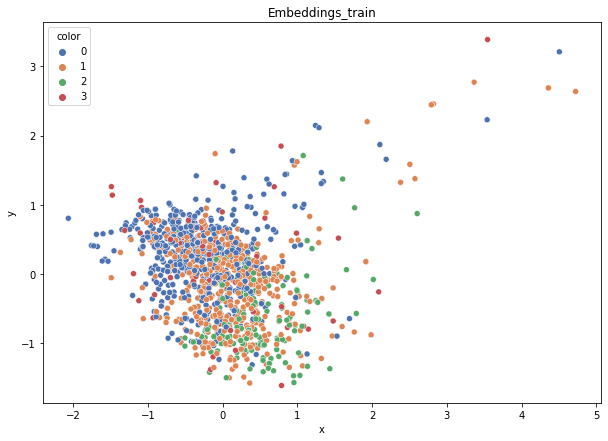

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.516
DT-f1-old+new-features: 0.523
DT-f1-old-features: 0.503
DT-gmean-new-features: 0.519
DT-gmean-old+new-features: 0.463
DT-gmean-old-features: 0.368
DT-minority_gmean-new-features: 0.021
DT-minority_gmean-old+new-features: 0.018
DT-minority_gmean-old-features: 0.014
KNN-f1-new-features: 0.558
KNN-f1-old+new-features: 0.564
KNN-f1-old-features: 0.555
KNN-gmean-new-features: 0.51
KNN-gmean-old+new-features: 0.494
KNN-gmean-old-features: 0.487
KNN-minority_gmean-new-features: 0.019
KNN-minority_gmean-old+new-features: 0.018
KNN-minority_gmean-old-features: 0.018


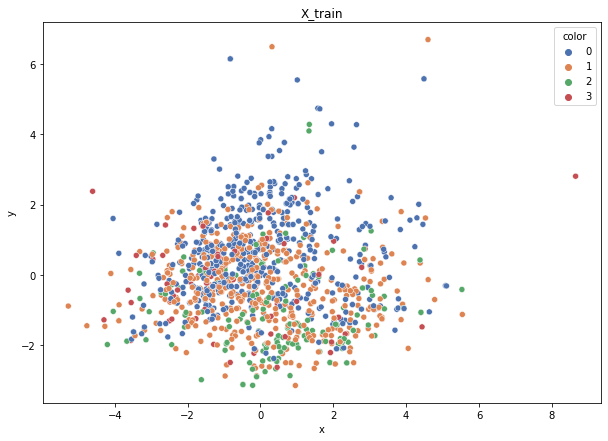

Class cardinalities: Counter({0: 545, 1: 510, 2: 159, 3: 65})
Weights: {0: 0.072041356277607, 1: 0.07698537092410943, 2: 0.24693420862450194, 3: 0.6040390641737817}
Training autoencoder...


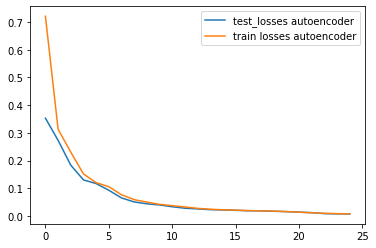

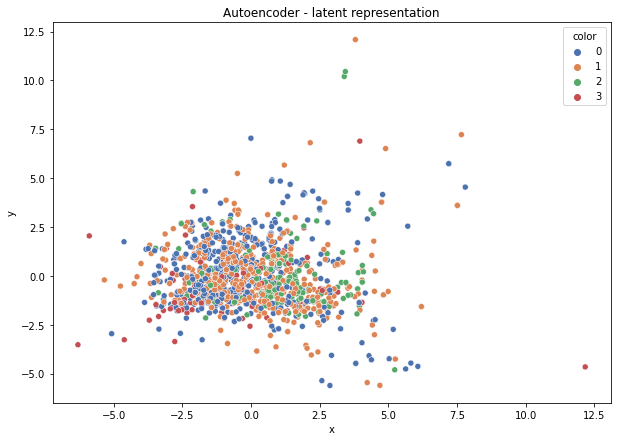

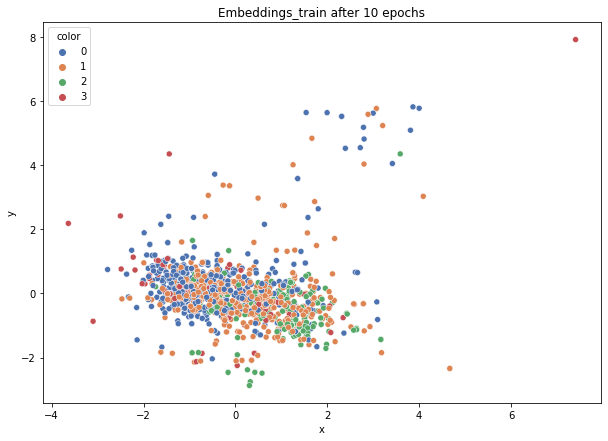

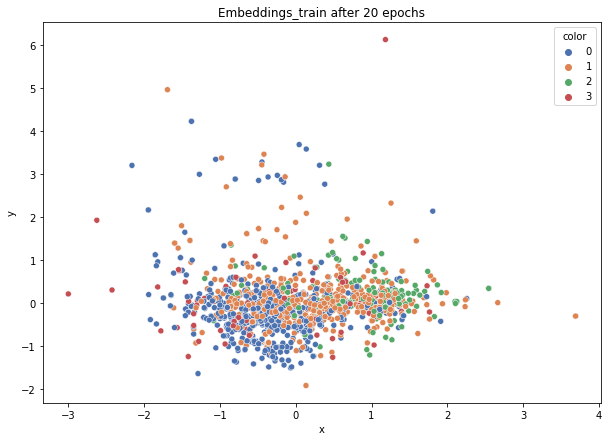

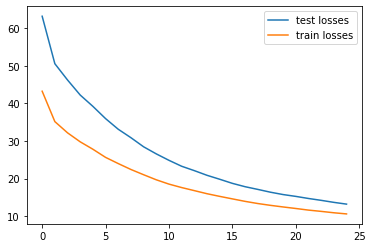

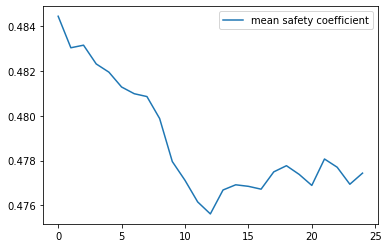

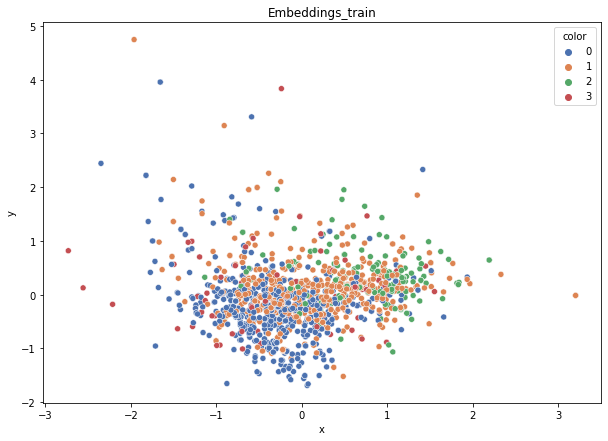

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.507
DT-f1-old+new-features: 0.458
DT-f1-old-features: 0.505
DT-gmean-new-features: 0.49
DT-gmean-old+new-features: 0.422
DT-gmean-old-features: 0.48
DT-minority_gmean-new-features: 0.019
DT-minority_gmean-old+new-features: 0.017
DT-minority_gmean-old-features: 0.019
KNN-f1-new-features: 0.537
KNN-f1-old+new-features: 0.558
KNN-f1-old-features: 0.555
KNN-gmean-new-features: 0.495
KNN-gmean-old+new-features: 0.511
KNN-gmean-old-features: 0.512
KNN-minority_gmean-new-features: 0.019
KNN-minority_gmean-old+new-features: 0.019
KNN-minority_gmean-old-features: 0.02


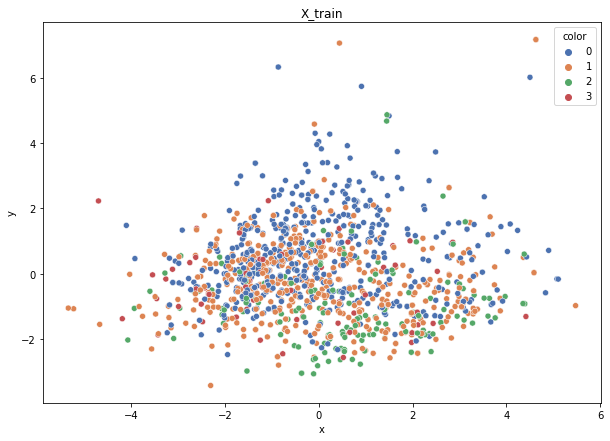

Class cardinalities: Counter({0: 545, 1: 510, 2: 159, 3: 65})
Weights: {0: 0.072041356277607, 1: 0.07698537092410943, 2: 0.24693420862450194, 3: 0.6040390641737817}
Training autoencoder...


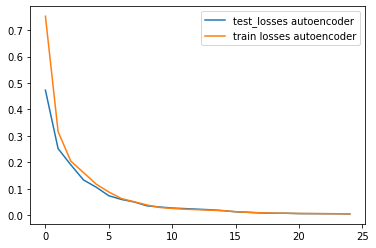

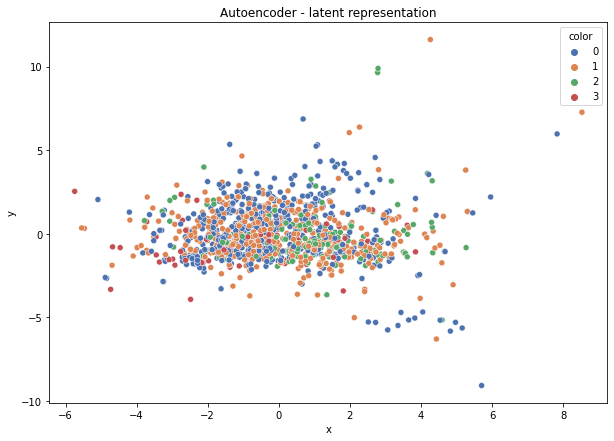

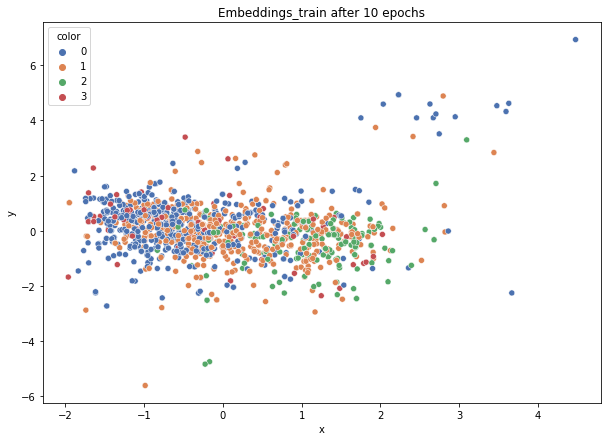

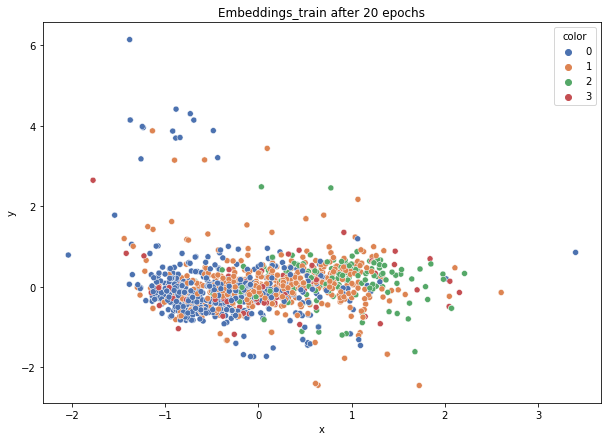

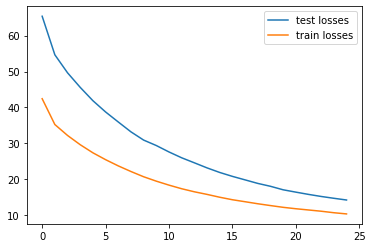

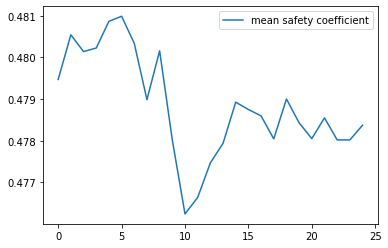

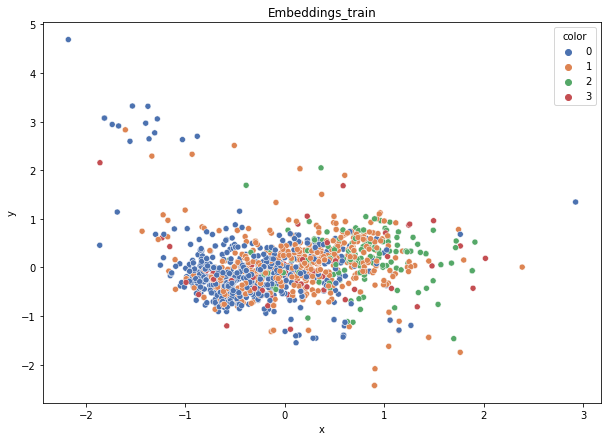

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.46
DT-f1-old+new-features: 0.441
DT-f1-old-features: 0.514
DT-gmean-new-features: 0.442
DT-gmean-old+new-features: 0.336
DT-gmean-old-features: 0.468
DT-minority_gmean-new-features: 0.019
DT-minority_gmean-old+new-features: 0.014
DT-minority_gmean-old-features: 0.019
KNN-f1-new-features: 0.581
KNN-f1-old+new-features: 0.562
KNN-f1-old-features: 0.544
KNN-gmean-new-features: 0.536
KNN-gmean-old+new-features: 0.524
KNN-gmean-old-features: 0.516
KNN-minority_gmean-new-features: 0.021
KNN-minority_gmean-old+new-features: 0.02
KNN-minority_gmean-old-features: 0.02


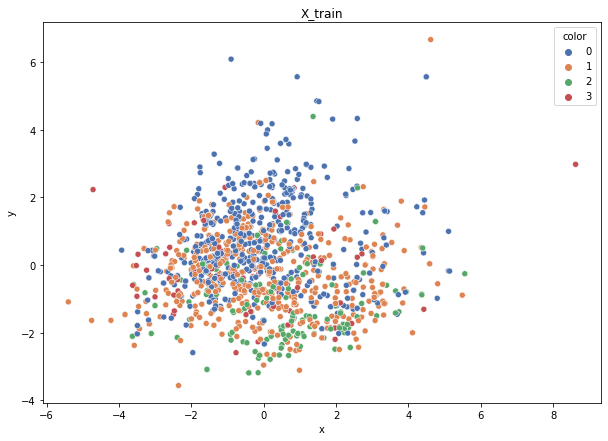

Class cardinalities: Counter({0: 545, 1: 510, 2: 160, 3: 64})
Weights: {0: 0.07147706120661339, 2: 0.24346873973502686, 3: 0.6086718493375671, 1: 0.07638234972079273}
Training autoencoder...


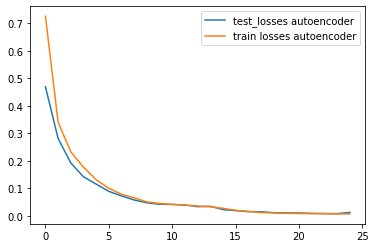

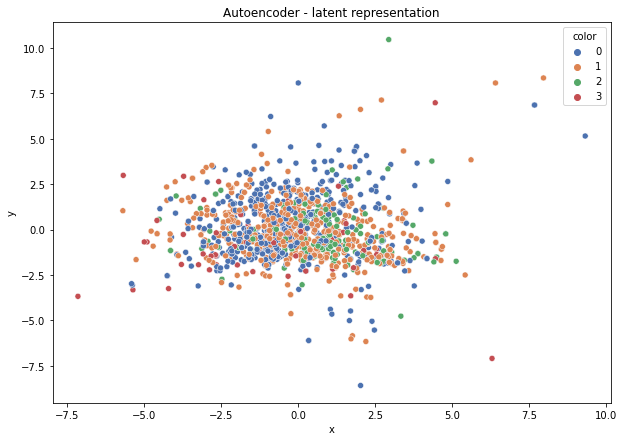

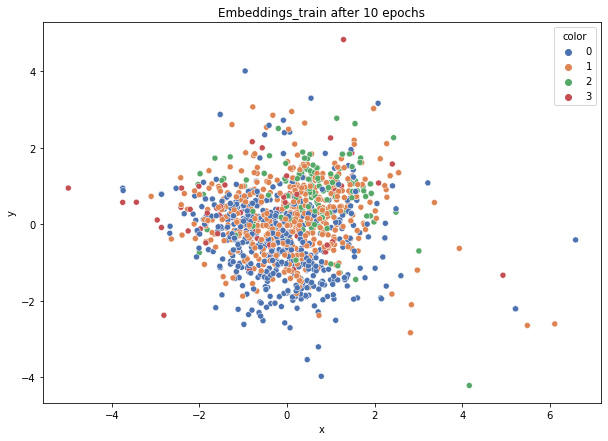

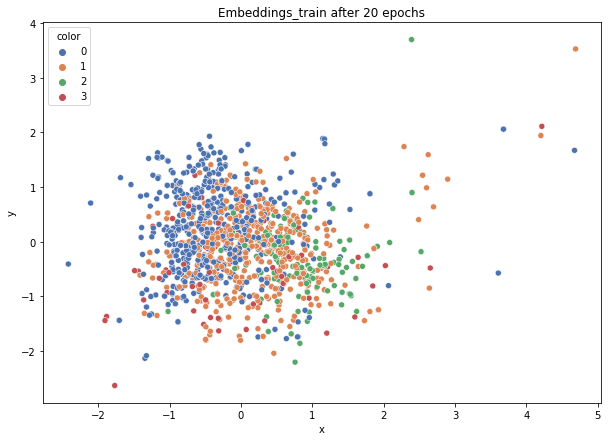

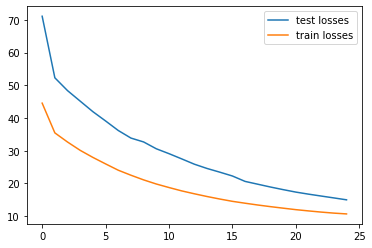

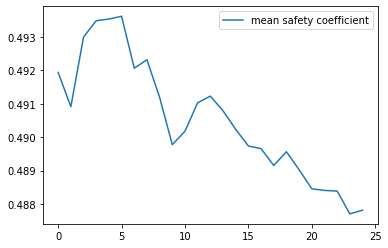

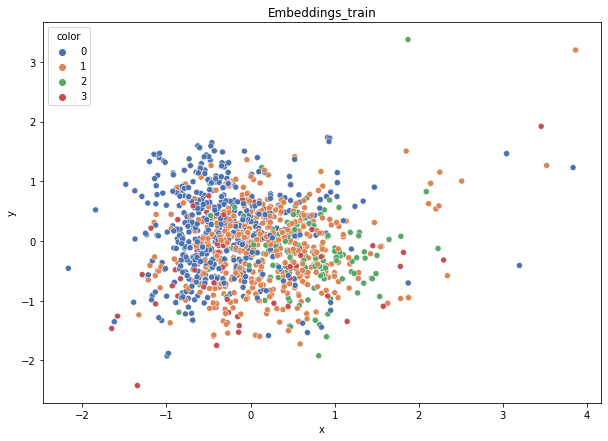

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.403
DT-f1-old+new-features: 0.483
DT-f1-old-features: 0.427
DT-gmean-new-features: 0.366
DT-gmean-old+new-features: 0.501
DT-gmean-old-features: 0.378
DT-minority_gmean-new-features: 0.015
DT-minority_gmean-old+new-features: 0.021
DT-minority_gmean-old-features: 0.015
KNN-f1-new-features: 0.491
KNN-f1-old+new-features: 0.483
KNN-f1-old-features: 0.486
KNN-gmean-new-features: 0.435
KNN-gmean-old+new-features: 0.424
KNN-gmean-old-features: 0.421
KNN-minority_gmean-new-features: 0.017
KNN-minority_gmean-old+new-features: 0.017
KNN-minority_gmean-old-features: 0.016


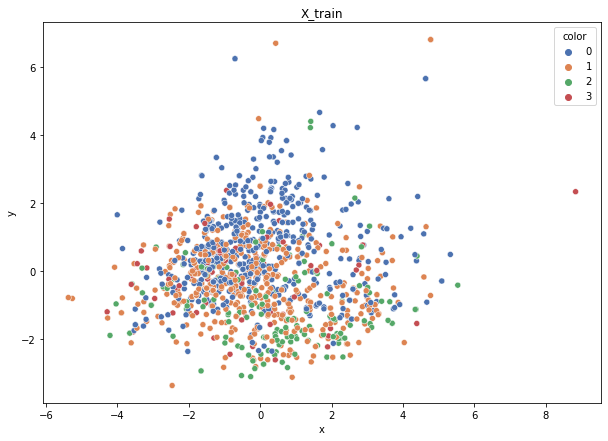

Class cardinalities: Counter({0: 545, 1: 511, 2: 159, 3: 65})
Weights: {0: 0.07205221139741194, 1: 0.07684629199919668, 2: 0.24697141642509127, 3: 0.6041300801783002}
Training autoencoder...


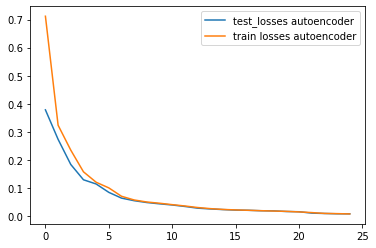

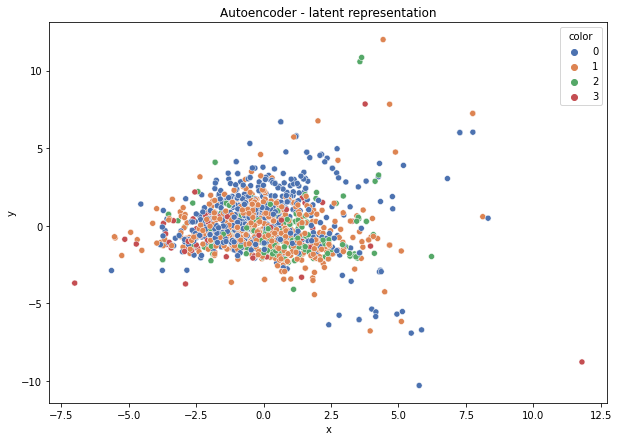

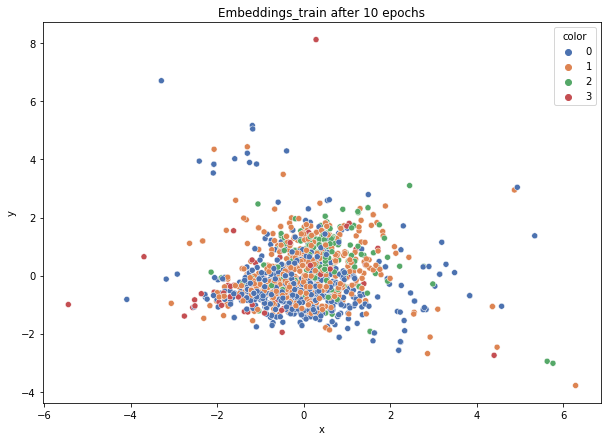

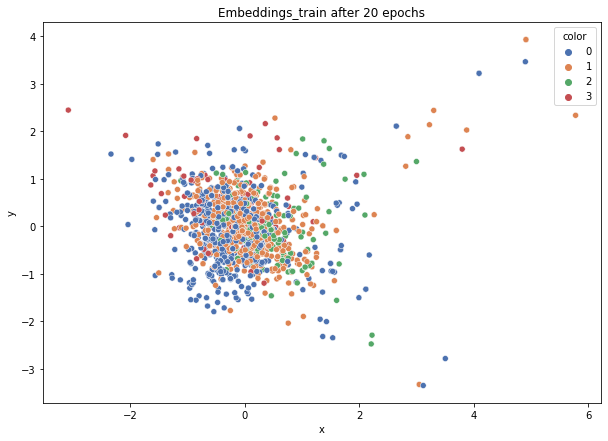

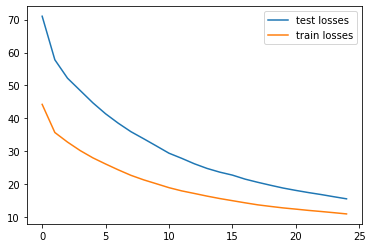

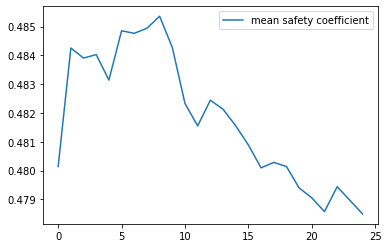

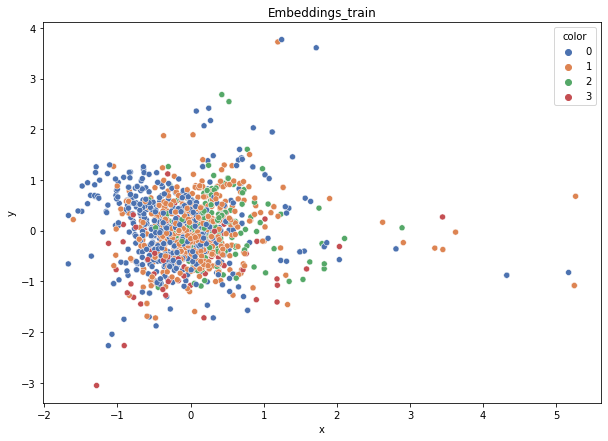

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.451
DT-f1-old+new-features: 0.482
DT-f1-old-features: 0.463
DT-gmean-new-features: 0.392
DT-gmean-old+new-features: 0.357
DT-gmean-old-features: 0.399
DT-minority_gmean-new-features: 0.017
DT-minority_gmean-old+new-features: 0.014
DT-minority_gmean-old-features: 0.017
KNN-f1-new-features: 0.541
KNN-f1-old+new-features: 0.531
KNN-f1-old-features: 0.537
KNN-gmean-new-features: 0.484
KNN-gmean-old+new-features: 0.435
KNN-gmean-old-features: 0.437
KNN-minority_gmean-new-features: 0.019
KNN-minority_gmean-old+new-features: 0.017
KNN-minority_gmean-old-features: 0.017
thyroid-newthyroid


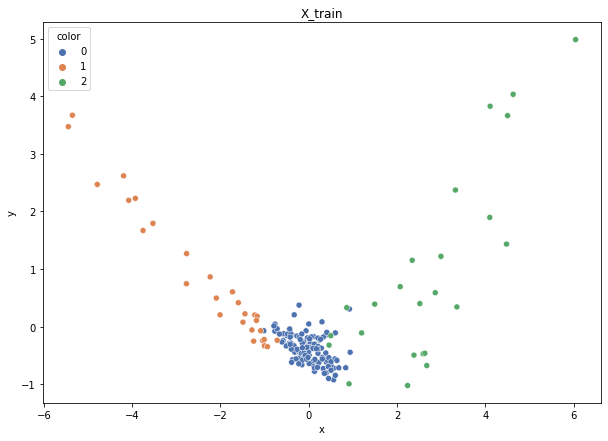

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


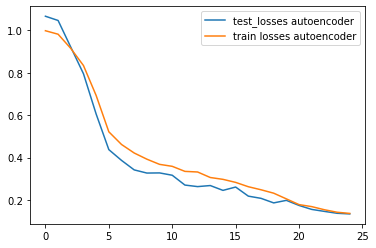

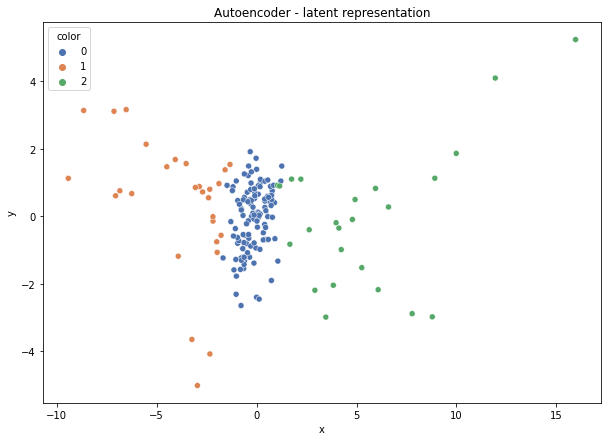

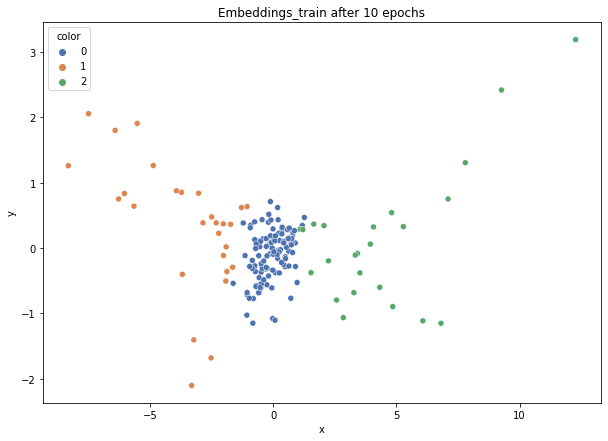

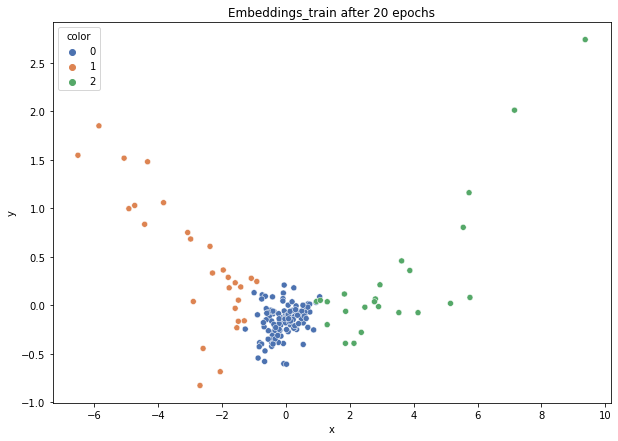

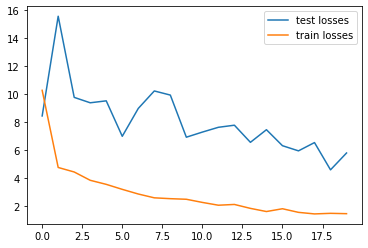

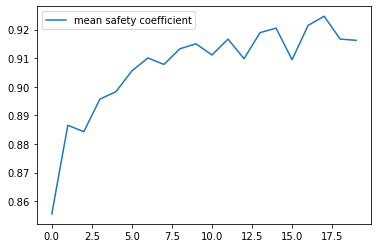

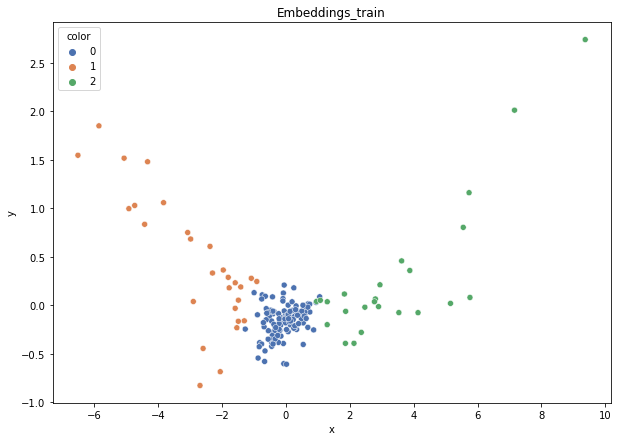

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.964
DT-f1-old+new-features: 0.964
DT-f1-old-features: 0.902
DT-gmean-new-features: 0.941
DT-gmean-old+new-features: 0.941
DT-gmean-old-features: 0.884
DT-minority_gmean-new-features: 0.094
DT-minority_gmean-old+new-features: 0.094
DT-minority_gmean-old-features: 0.089
KNN-f1-new-features: 0.964
KNN-f1-old+new-features: 0.964
KNN-f1-old-features: 0.964
KNN-gmean-new-features: 0.941
KNN-gmean-old+new-features: 0.941
KNN-gmean-old-features: 0.941
KNN-minority_gmean-new-features: 0.094
KNN-minority_gmean-old+new-features: 0.094
KNN-minority_gmean-old-features: 0.094


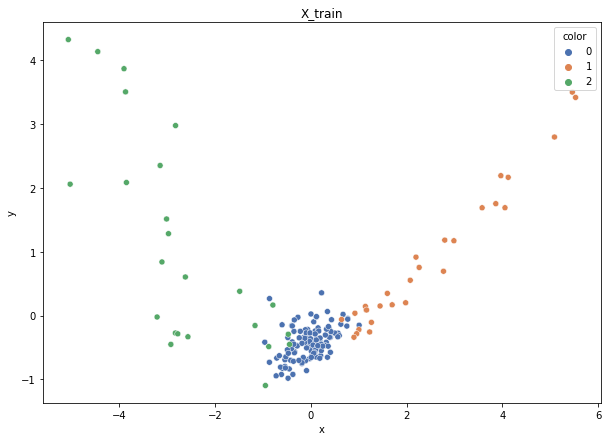

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


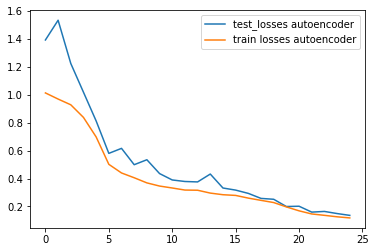

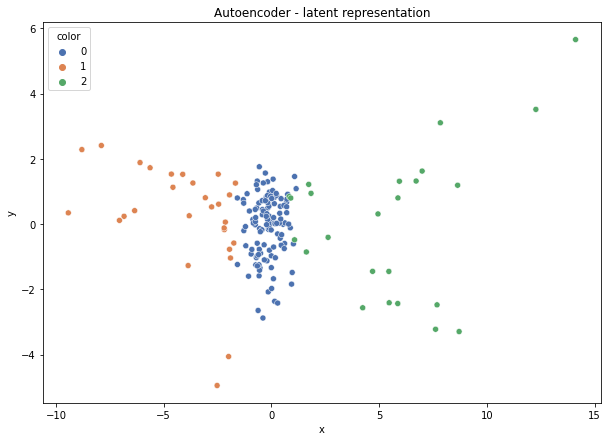

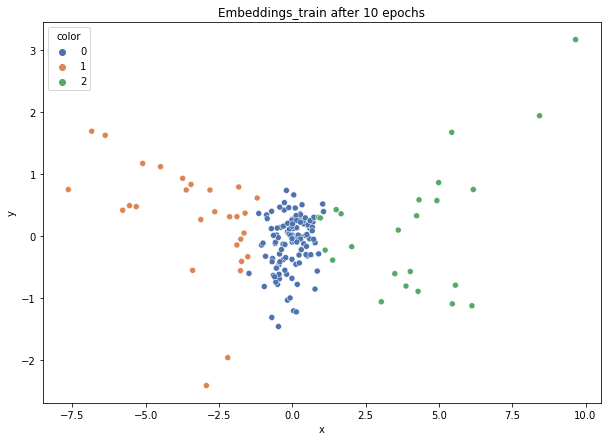

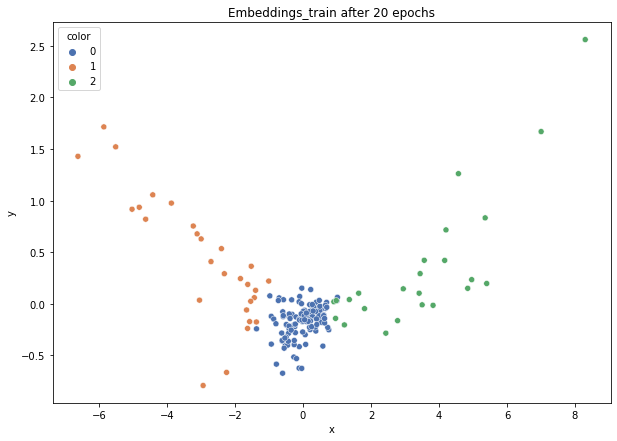

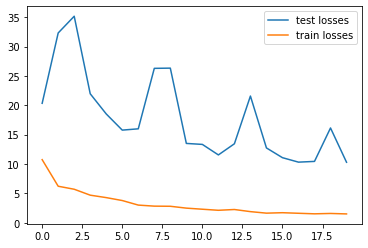

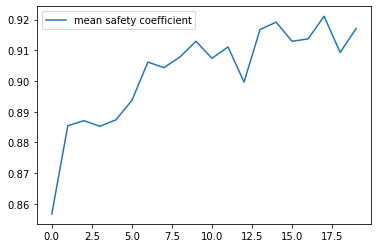

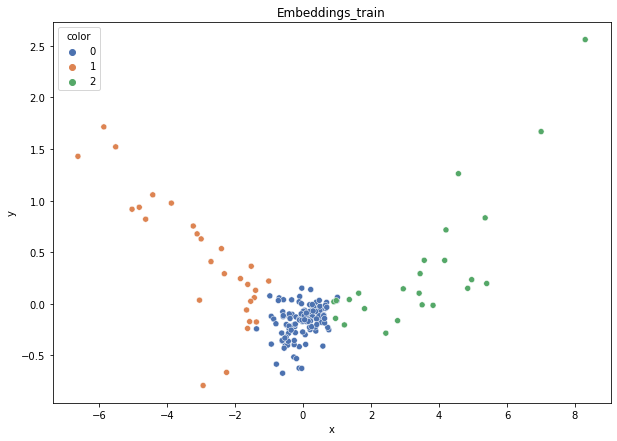

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.969
DT-f1-old+new-features: 0.969
DT-f1-old-features: 0.947
DT-gmean-new-features: 0.95
DT-gmean-old+new-features: 0.95
DT-gmean-old-features: 0.977
DT-minority_gmean-new-features: 0.095
DT-minority_gmean-old+new-features: 0.095
DT-minority_gmean-old-features: 1.0
KNN-f1-new-features: 1.0
KNN-f1-old+new-features: 1.0
KNN-f1-old-features: 0.972
KNN-gmean-new-features: 1.0
KNN-gmean-old+new-features: 1.0
KNN-gmean-old-features: 0.989
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


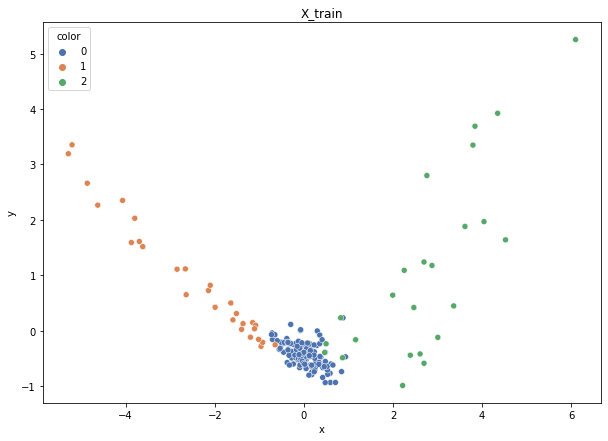

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


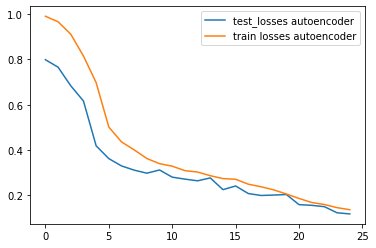

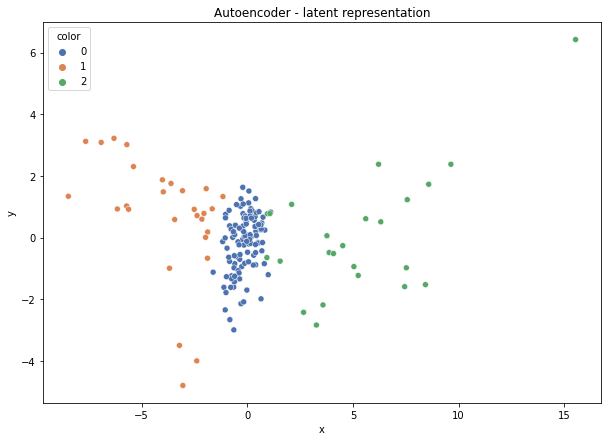

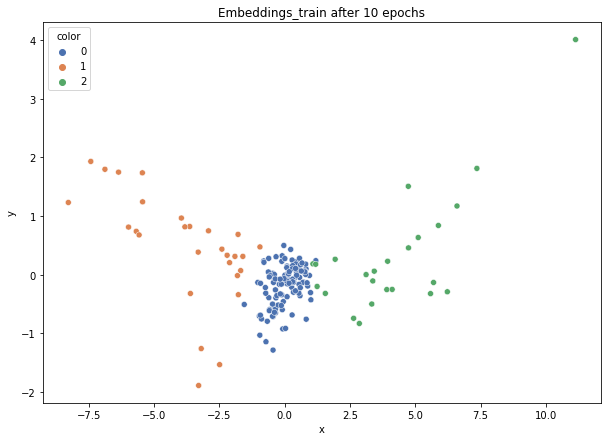

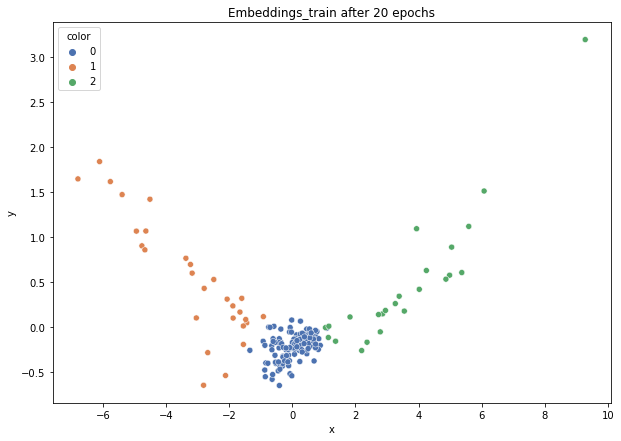

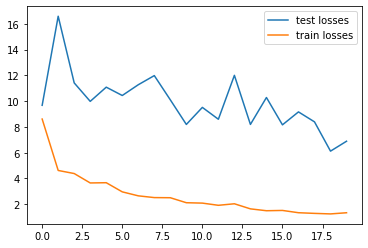

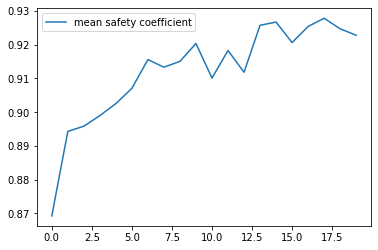

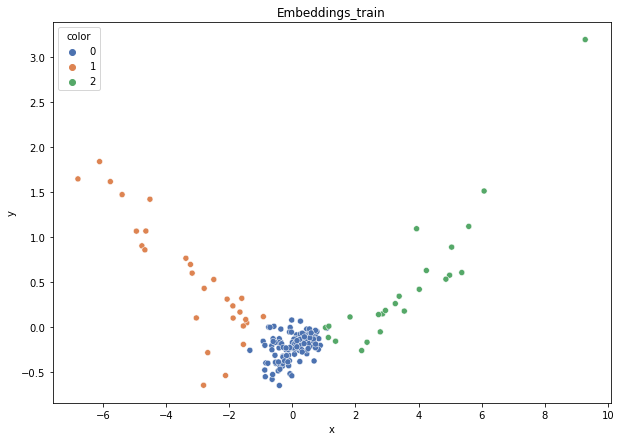

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

DT-f1-new-features: 0.941
DT-f1-old+new-features: 0.941
DT-f1-old-features: 0.905
DT-gmean-new-features: 0.977
DT-gmean-old+new-features: 0.977
DT-gmean-old-features: 0.92
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 0.094
KNN-f1-new-features: 0.906
KNN-f1-old+new-features: 0.933
KNN-f1-old-features: 0.902
KNN-gmean-new-features: 0.884
KNN-gmean-old+new-features: 0.93
KNN-gmean-old-features: 0.884
KNN-minority_gmean-new-features: 0.089
KNN-minority_gmean-old+new-features: 0.094
KNN-minority_gmean-old-features: 0.089


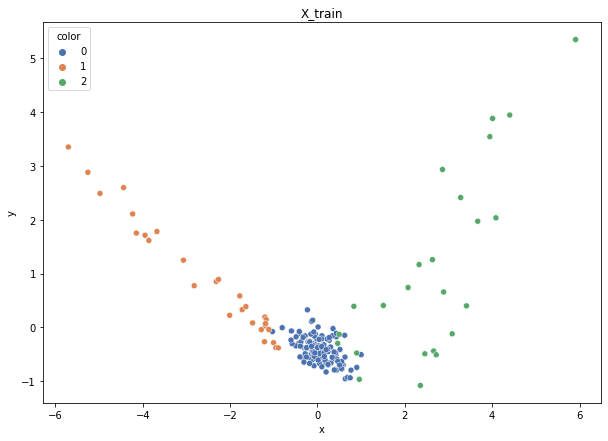

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


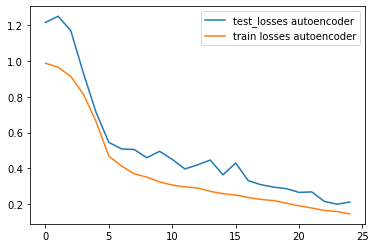

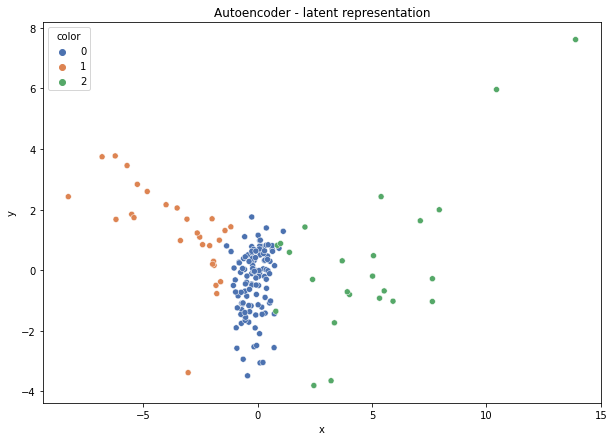

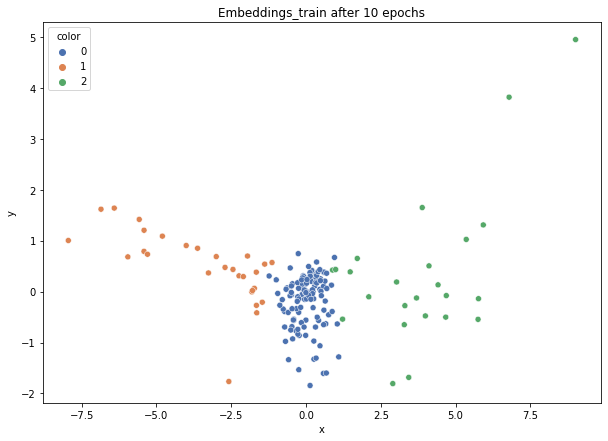

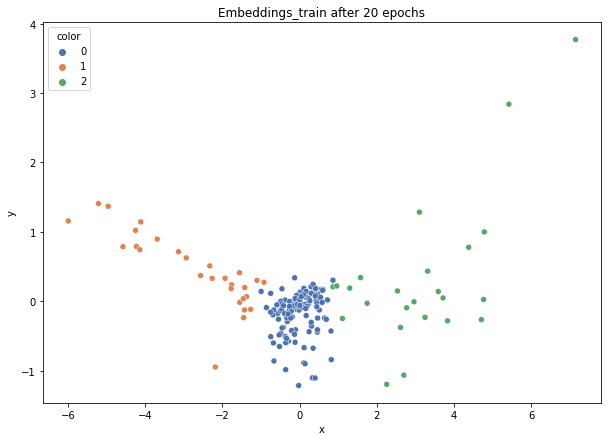

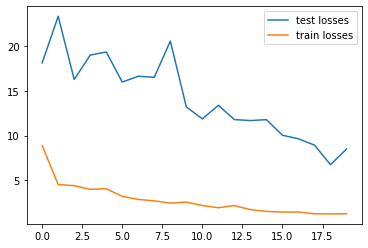

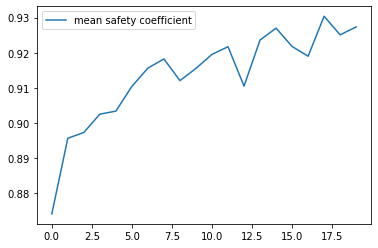

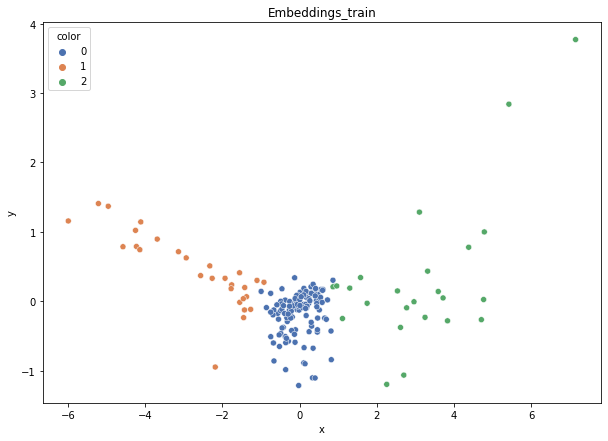

/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


DT-f1-new-features: 0.972
DT-f1-old+new-features: 0.972
DT-f1-old-features: 0.902
DT-gmean-new-features: 0.989
DT-gmean-old+new-features: 0.989
DT-gmean-old-features: 0.884
DT-minority_gmean-new-features: 1.0
DT-minority_gmean-old+new-features: 1.0
DT-minority_gmean-old-features: 0.089
KNN-f1-new-features: 0.972
KNN-f1-old+new-features: 0.972
KNN-f1-old-features: 0.941
KNN-gmean-new-features: 0.989
KNN-gmean-old+new-features: 0.989
KNN-gmean-old-features: 0.977
KNN-minority_gmean-new-features: 1.0
KNN-minority_gmean-old+new-features: 1.0
KNN-minority_gmean-old-features: 1.0


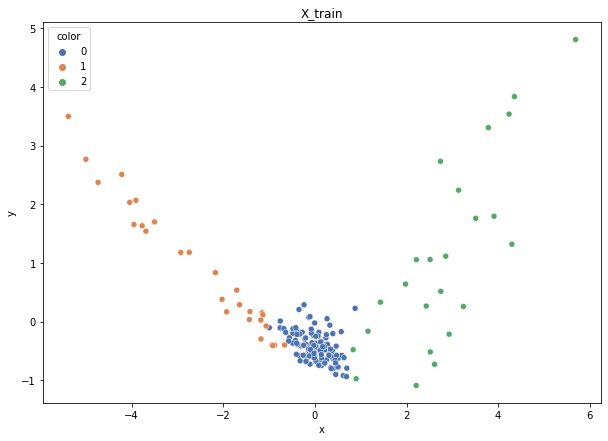

Class cardinalities: Counter({0: 120, 1: 28, 2: 24})
Weights: {0: 0.09722222222222222, 1: 0.41666666666666663, 2: 0.4861111111111111}
Training autoencoder...


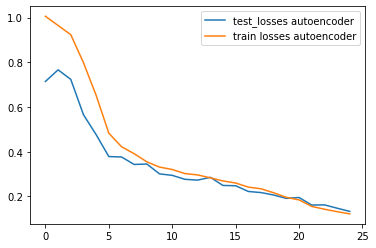

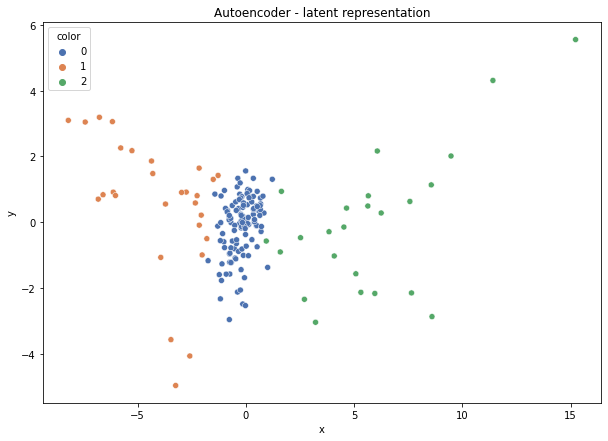

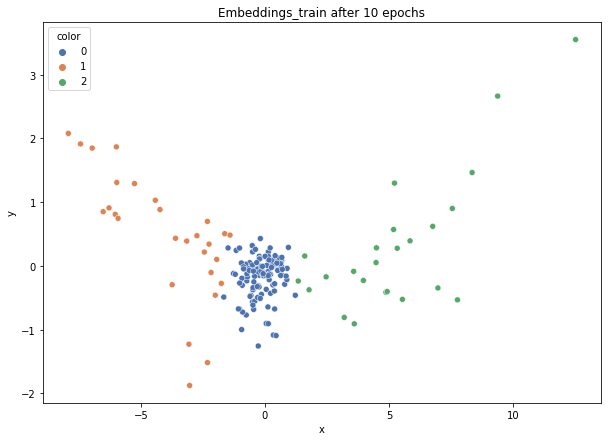

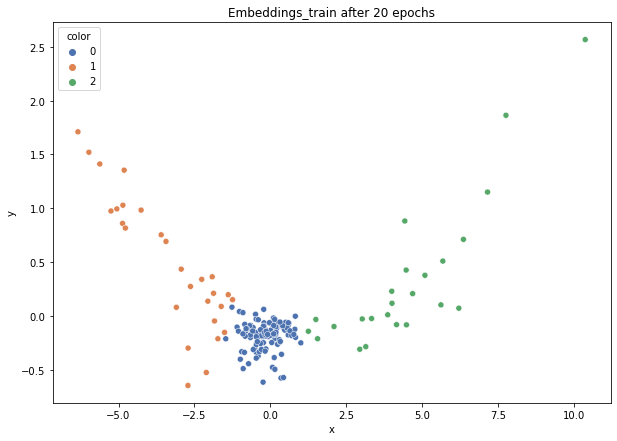

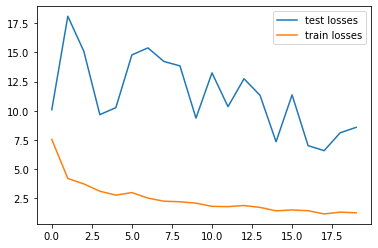

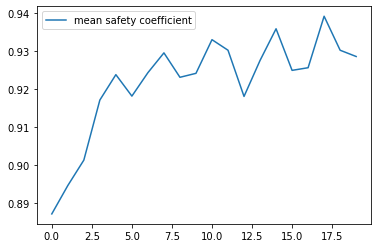

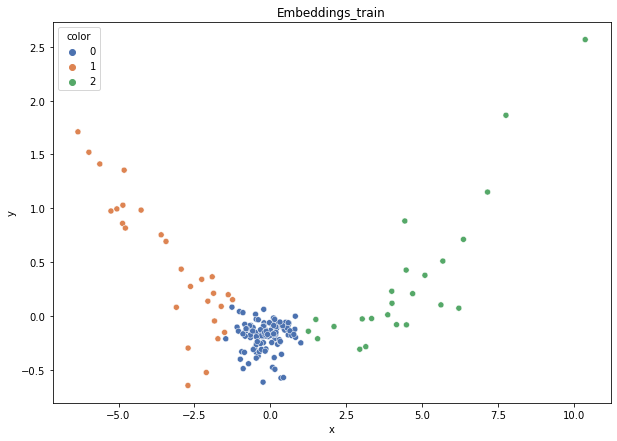

DT-f1-new-features: 0.923
DT-f1-old+new-features: 0.923
DT-f1-old-features: 0.893
DT-gmean-new-features: 0.874
DT-gmean-old+new-features: 0.874
DT-gmean-old-features: 0.864
DT-minority_gmean-new-features: 0.087
DT-minority_gmean-old+new-features: 0.087
DT-minority_gmean-old-features: 0.087
KNN-f1-new-features: 0.923
KNN-f1-old+new-features: 0.873
KNN-f1-old-features: 0.873
KNN-gmean-new-features: 0.874
KNN-gmean-old+new-features: 0.794
KNN-gmean-old-features: 0.794
KNN-minority_gmean-new-features: 0.087
KNN-minority_gmean-old+new-features: 0.079
KNN-minority_gmean-old-features: 0.079


/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/dhorna/anaconda3/envs/mgr/lib/python3.7/site-packages/sklearn

In [16]:
result_dict = defaultdict(list)

std_dict = defaultdict(list)

safety_dict = defaultdict(list)

if test_all_ds:
    ds_names = dt_name_to_cols_to_encode.keys()
else:
    ds_names = [ds_name]
for dataset_name in ds_names:
    print(dataset_name)
    result_dict["dataset"].append(dataset_name)
    fold_result_dict = defaultdict(list)

    safety_dict["dataset"].append(dataset_name)
    fold_safety_dict = defaultdict(list)

    X, y = datasets[dataset_name]['data'], datasets[dataset_name]['target']
    X_encoded, y = datasets[f"{dataset_name}_encoded"]['data'], datasets[f"{dataset_name}_encoded"]['target']

    skf = StratifiedKFold(n_splits=5, random_state=0, shuffle=True)
    n_splits = skf.get_n_splits(X, y)

    folds = []
    if test_on_all_folds:
        folds = skf.split(X, y)
    else:
        folds = list(skf.split(X, y))[2:3]

    for train_index, test_index in folds:
#         try:
        X_train, X_test = X[train_index], X[test_index]
        X_train_norm, X_test_norm = standardize(X_train, X_test)
        y_train, y_test = y[train_index], y[test_index]


        X_train_enc, X_test_enc = X_encoded[train_index], X_encoded[test_index]
        X_train_enc, X_test_enc = standardize(X_train_enc, X_test_enc)


        # PCA X_train
        pca = PCA(n_components=2)
        pca.fit(X_train_enc)
        plot_embeddings(pca.transform(X_train_enc), y_train)
        plt.title("X_train")
        plt.show()

        weights = ex.weights_calculation_strategy1(X_train, y_train)
        cfg =  config[dataset_name]
        # pretrain ANN triplets
        autoenc_cfg = autoencoder_config[dataset_name]
        embeddings_train, embeddings_test = ex.train_triplets(X_train_enc, y_train, X_test_enc, y_test, weights,cfg, pca, autoenc_cfg, k_dict[dataset_name], dataset_name)

        s_dict = calc_safety5(embeddings_test, y_test)
        for k, v in s_dict.items():
            fold_safety_dict[f"emb-{k}"].append(v)

        s_dict = calc_safety5(X_test_enc, y_test)
        for k,v in s_dict.items():
            fold_safety_dict[f"raw-{k}"].append(v)

        # PCA embeddings_train
        pca = PCA(n_components=2)
        plot_embeddings(pca.fit_transform(embeddings_train), y_train)
        plt.title("Embeddings_train")
        plt.show()

        X_train_new = np.hstack([X_train_norm, embeddings_train])
        X_test_new = np.hstack([X_test_norm, embeddings_test])

        classifiers = instantiate_classifiers()
        for clf_name, clf in classifiers.items():
            clf.fit(X_train_norm, y_train)
            preds = clf.predict(X_test_norm)

            gmean = gmean_score(y_test, preds)
            f1 = f1_score(y_test, preds, average='macro')
            
            minority_classes = dt_name_minority_classes[dataset_name]
            minority_mask = np.argwhere([label in minority_classes for label in y_test]).ravel()
            gmean_minority = gmean_score(y_test[minority_mask], preds[minority_mask])
            
            fold_result_dict[f"{clf_name}-f1-old-features"].append(f1)
            fold_result_dict[f"{clf_name}-gmean-old-features"].append(gmean)
            fold_result_dict[f"{clf_name}-minority_gmean-old-features"].append(gmean_minority)


        classifiers = instantiate_classifiers()
        for clf_name, clf in classifiers.items():
            clf.fit(X_train_new, y_train)
            preds = clf.predict(X_test_new)

            gmean = gmean_score(y_test, preds)
            f1 = f1_score(y_test, preds, average='macro')
            
            minority_classes = dt_name_minority_classes[dataset_name]
            minority_mask = np.argwhere([label in minority_classes for label in y_test]).ravel()
            gmean_minority = gmean_score(y_test[minority_mask], preds[minority_mask])
            
            
            fold_result_dict[f"{clf_name}-f1-old+new-features"].append(f1)
            fold_result_dict[f"{clf_name}-gmean-old+new-features"].append(gmean)
            fold_result_dict[f"{clf_name}-minority_gmean-old+new-features"].append(gmean_minority)
            
            
        classifiers = instantiate_classifiers()
        for clf_name, clf in classifiers.items():
            clf.fit(embeddings_train, y_train)
            preds = clf.predict(embeddings_test)

            gmean = gmean_score(y_test, preds)
            f1 = f1_score(y_test, preds, average='macro')
            
            minority_classes = dt_name_minority_classes[dataset_name]
            minority_mask = np.argwhere([label in minority_classes for label in y_test]).ravel()
            gmean_minority = gmean_score(y_test[minority_mask], preds[minority_mask])
            
            fold_result_dict[f"{clf_name}-f1-new-features"].append(f1)
            fold_result_dict[f"{clf_name}-gmean-new-features"].append(gmean)
            fold_result_dict[f"{clf_name}-minority_gmean-new-features"].append(gmean_minority)
            
        for key in sorted(list(fold_result_dict.keys())):
            print(f"{key}: {np.round(fold_result_dict[key][-1],3)}")

    for k in fold_result_dict:
        result_dict[k].append(np.mean(fold_result_dict[k]))
        
    for k in fold_result_dict:
        std_dict[f"{k}-std"].append(np.std(fold_result_dict[k], ddof=1))

    for k in fold_safety_dict:
        safety_dict[k].append(np.sum(fold_safety_dict[k]) / X.shape[0])

In [17]:
results_df = pd.DataFrame.from_dict(result_dict)

In [18]:
std_df = pd.DataFrame.from_dict(std_dict)

In [19]:
safety_df = pd.DataFrame.from_dict(safety_dict)

In [20]:
results_df

,dataset,DT-f1-old-features,DT-gmean-old-features,DT-minority_gmean-old-features,KNN-f1-old-features,KNN-gmean-old-features,KNN-minority_gmean-old-features,DT-f1-old+new-features,DT-gmean-old+new-features,DT-minority_gmean-old+new-features,KNN-f1-old+new-features,KNN-gmean-old+new-features,KNN-minority_gmean-old+new-features,DT-f1-new-features,DT-gmean-new-features,DT-minority_gmean-new-features,KNN-f1-new-features,KNN-gmean-new-features,KNN-minority_gmean-new-features
0,cmc,0.467266,0.470278,0.007653,0.422592,0.412867,0.006848,0.460029,0.456844,0.007329,0.420818,0.412677,0.006988,0.411639,0.414102,0.007372,0.421352,0.416979,0.007028
1,dermatology,0.949703,0.951222,1.000000,0.937131,0.932309,1.000000,0.899606,0.890171,0.416432,0.951779,0.948097,1.000000,0.853865,0.839435,0.416432,0.946040,0.946595,1.000000
2,hayes-roth,0.851208,0.838449,1.000000,0.672362,0.636136,0.014118,0.880006,0.874386,1.000000,0.808968,0.792158,0.611019,0.880006,0.874386,1.000000,0.890704,0.886473,1.000000
3,new_vehicle,0.896672,0.898498,0.092997,0.912321,0.912341,0.093402,0.933841,0.932742,0.094632,0.914721,0.914868,0.093583,0.922680,0.923188,0.093973,0.967213,0.966860,0.275032
4,new_yeast,0.442388,0.282887,0.017781,0.486925,0.408416,0.026117,0.426383,0.343341,0.021382,0.490791,0.410201,0.026197,0.404127,0.334347,0.020695,0.486617,0.375055,0.024128
5,1czysty-cut,0.935490,0.936512,0.094798,0.945528,0.943824,0.095391,0.953697,0.949947,0.095639,0.945528,0.943824,0.095391,0.933053,0.934221,0.094410,0.946646,0.949387,0.095947
6,2delikatne-cut,0.724198,0.737376,0.077039,0.699865,0.678350,0.070180,0.728283,0.736630,0.076639,0.699865,0.678350,0.070180,0.692505,0.684203,0.071438,0.710769,0.694576,0.071815
7,3mocniej-cut,0.504810,0.502048,0.055608,0.508642,0.457700,0.048806,0.526487,0.503479,0.054419,0.508103,0.457479,0.048806,0.530880,0.513391,0.055736,0.493903,0.430790,0.045977
8,4delikatne-bezover-cut,0.796105,0.813035,0.085097,0.767612,0.760887,0.079412,0.790218,0.795226,0.082915,0.767612,0.760887,0.079412,0.797038,0.801197,0.083474,0.765296,0.766009,0.080199
9,balance-scale,0.605016,0.416495,0.004768,0.560676,0.089082,0.001000,0.788676,0.738806,0.011096,0.586831,0.092193,0.001000,0.790433,0.745291,0.010834,0.862236,0.854551,0.206818


In [21]:
safety_df[sorted(safety_df.filter(regex=("dataset|emb")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,emb-borderline,emb-outlier,emb-rare,emb-safe
0,cmc,0.530889,0.114053,0.255940,0.099117
1,dermatology,0.172131,0.010929,0.024590,0.792350
2,hayes-roth,0.350000,0.018750,0.025000,0.606250
3,new_vehicle,0.096927,0.004728,0.013002,0.885343
4,new_yeast,0.414420,0.152291,0.185310,0.247978
5,1czysty-cut,0.126667,0.005833,0.020000,0.847500
6,2delikatne-cut,0.225000,0.022500,0.063333,0.689167
7,3mocniej-cut,0.271667,0.058333,0.090000,0.580000
8,4delikatne-bezover-cut,0.215833,0.011667,0.055000,0.717500
9,balance-scale,0.112000,0.014400,0.030400,0.843200


In [22]:
safety_df[sorted(safety_df.filter(regex=("dataset|raw")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,raw-borderline,raw-outlier,raw-rare,raw-safe
0,cmc,0.505771,0.118126,0.262050,0.114053
1,dermatology,0.464481,0.060109,0.144809,0.330601
2,hayes-roth,0.687500,0.031250,0.131250,0.150000
3,new_vehicle,0.255319,0.020095,0.053191,0.671395
4,new_yeast,0.415768,0.164420,0.174528,0.245283
5,1czysty-cut,0.131667,0.003333,0.015000,0.850000
6,2delikatne-cut,0.209167,0.010000,0.060833,0.720000
7,3mocniej-cut,0.232500,0.062500,0.079167,0.625833
8,4delikatne-bezover-cut,0.185833,0.010833,0.040833,0.762500
9,balance-scale,0.508800,0.064000,0.116800,0.310400


In [23]:
safety_df[sorted(safety_df.filter(regex=("dataset|.*safe")).columns)].style.highlight_max(color = 'lightgreen', axis = 1)

,dataset,emb-safe,raw-safe
0,cmc,0.099117,0.114053
1,dermatology,0.792350,0.330601
2,hayes-roth,0.606250,0.150000
3,new_vehicle,0.885343,0.671395
4,new_yeast,0.247978,0.245283
5,1czysty-cut,0.847500,0.850000
6,2delikatne-cut,0.689167,0.720000
7,3mocniej-cut,0.580000,0.625833
8,4delikatne-bezover-cut,0.717500,0.762500
9,balance-scale,0.843200,0.310400


In [24]:
from IPython.display import display
for clf in instantiate_classifiers().keys():
    print(clf)
    display(results_df.filter(regex=(f"dataset|{clf}-f1*")).style.highlight_max(color = 'lightgreen', axis = 1))
    display(results_df.filter(regex=(f"dataset|{clf}-gmean*")).style.highlight_max(color = 'lightgreen', axis = 1))
    display(results_df.filter(regex=(f"dataset|{clf}-minority_gmean*")).style.highlight_max(color = 'lightgreen', axis = 1))

DT


,dataset,DT-f1-old-features,DT-f1-old+new-features,DT-f1-new-features
0,cmc,0.467266,0.460029,0.411639
1,dermatology,0.949703,0.899606,0.853865
2,hayes-roth,0.851208,0.880006,0.880006
3,new_vehicle,0.896672,0.933841,0.922680
4,new_yeast,0.442388,0.426383,0.404127
5,1czysty-cut,0.935490,0.953697,0.933053
6,2delikatne-cut,0.724198,0.728283,0.692505
7,3mocniej-cut,0.504810,0.526487,0.530880
8,4delikatne-bezover-cut,0.796105,0.790218,0.797038
9,balance-scale,0.605016,0.788676,0.790433


,dataset,DT-gmean-old-features,DT-gmean-old+new-features,DT-gmean-new-features
0,cmc,0.470278,0.456844,0.414102
1,dermatology,0.951222,0.890171,0.839435
2,hayes-roth,0.838449,0.874386,0.874386
3,new_vehicle,0.898498,0.932742,0.923188
4,new_yeast,0.282887,0.343341,0.334347
5,1czysty-cut,0.936512,0.949947,0.934221
6,2delikatne-cut,0.737376,0.736630,0.684203
7,3mocniej-cut,0.502048,0.503479,0.513391
8,4delikatne-bezover-cut,0.813035,0.795226,0.801197
9,balance-scale,0.416495,0.738806,0.745291


,dataset,DT-minority_gmean-old-features,DT-minority_gmean-old+new-features,DT-minority_gmean-new-features
0,cmc,0.007653,0.007329,0.007372
1,dermatology,1.000000,0.416432,0.416432
2,hayes-roth,1.000000,1.000000,1.000000
3,new_vehicle,0.092997,0.094632,0.093973
4,new_yeast,0.017781,0.021382,0.020695
5,1czysty-cut,0.094798,0.095639,0.094410
6,2delikatne-cut,0.077039,0.076639,0.071438
7,3mocniej-cut,0.055608,0.054419,0.055736
8,4delikatne-bezover-cut,0.085097,0.082915,0.083474
9,balance-scale,0.004768,0.011096,0.010834


KNN


,dataset,KNN-f1-old-features,KNN-f1-old+new-features,KNN-f1-new-features
0,cmc,0.422592,0.420818,0.421352
1,dermatology,0.937131,0.951779,0.946040
2,hayes-roth,0.672362,0.808968,0.890704
3,new_vehicle,0.912321,0.914721,0.967213
4,new_yeast,0.486925,0.490791,0.486617
5,1czysty-cut,0.945528,0.945528,0.946646
6,2delikatne-cut,0.699865,0.699865,0.710769
7,3mocniej-cut,0.508642,0.508103,0.493903
8,4delikatne-bezover-cut,0.767612,0.767612,0.765296
9,balance-scale,0.560676,0.586831,0.862236


,dataset,KNN-gmean-old-features,KNN-gmean-old+new-features,KNN-gmean-new-features
0,cmc,0.412867,0.412677,0.416979
1,dermatology,0.932309,0.948097,0.946595
2,hayes-roth,0.636136,0.792158,0.886473
3,new_vehicle,0.912341,0.914868,0.966860
4,new_yeast,0.408416,0.410201,0.375055
5,1czysty-cut,0.943824,0.943824,0.949387
6,2delikatne-cut,0.678350,0.678350,0.694576
7,3mocniej-cut,0.457700,0.457479,0.430790
8,4delikatne-bezover-cut,0.760887,0.760887,0.766009
9,balance-scale,0.089082,0.092193,0.854551


,dataset,KNN-minority_gmean-old-features,KNN-minority_gmean-old+new-features,KNN-minority_gmean-new-features
0,cmc,0.006848,0.006988,0.007028
1,dermatology,1.000000,1.000000,1.000000
2,hayes-roth,0.014118,0.611019,1.000000
3,new_vehicle,0.093402,0.093583,0.275032
4,new_yeast,0.026117,0.026197,0.024128
5,1czysty-cut,0.095391,0.095391,0.095947
6,2delikatne-cut,0.070180,0.070180,0.071815
7,3mocniej-cut,0.048806,0.048806,0.045977
8,4delikatne-bezover-cut,0.079412,0.079412,0.080199
9,balance-scale,0.001000,0.001000,0.206818


In [25]:
for clf in instantiate_classifiers().keys():
    print(clf)
    display(std_df.filter(regex=(f"dataset|{clf}-f1*")))
    display(std_df.filter(regex=(f"dataset|{clf}-gmean*")))
    display(std_df.filter(regex=(f"dataset|{clf}-minority_gmean*")))

DT


,DT-f1-old-features-std,DT-f1-old+new-features-std,DT-f1-new-features-std
0,0.018423,0.046721,0.032154
1,0.027136,0.023544,0.060178
2,0.078039,0.042305,0.042305
3,0.013212,0.033416,0.034919
4,0.032903,0.022507,0.042070
5,0.025871,0.026448,0.017518
6,0.029002,0.032430,0.032180
7,0.044341,0.044850,0.054219
8,0.023401,0.022520,0.016529
9,0.038866,0.032304,0.052097


,DT-gmean-old-features-std,DT-gmean-old+new-features-std,DT-gmean-new-features-std
0,0.024349,0.047237,0.032404
1,0.028982,0.030735,0.075338
2,0.092643,0.046434,0.046434
3,0.017400,0.030934,0.032258
4,0.067375,0.114311,0.118276
5,0.032237,0.036984,0.025417
6,0.045134,0.044922,0.033091
7,0.048943,0.071595,0.056446
8,0.038262,0.038323,0.028281
9,0.205822,0.095118,0.108349


,DT-minority_gmean-old-features-std,DT-minority_gmean-old+new-features-std,DT-minority_gmean-new-features-std
0,0.000506,0.000395,0.000294
1,0.000000,0.532723,0.532723
2,0.000000,0.000000,0.000000
3,0.001956,0.002756,0.002772
4,0.004706,0.007368,0.006820
5,0.003279,0.003511,0.002622
6,0.004905,0.004678,0.003210
7,0.004673,0.007795,0.005519
8,0.004363,0.004552,0.003193
9,0.002326,0.008281,0.007206


KNN


,KNN-f1-old-features-std,KNN-f1-old+new-features-std,KNN-f1-new-features-std
0,0.014522,0.014663,0.010580
1,0.017976,0.013051,0.019865
2,0.113050,0.076481,0.045139
3,0.022863,0.020329,0.021709
4,0.038790,0.042228,0.054180
5,0.011746,0.011746,0.016038
6,0.034828,0.034828,0.015906
7,0.040857,0.040419,0.060511
8,0.014169,0.014169,0.018230
9,0.009340,0.014038,0.054439


,KNN-gmean-old-features-std,KNN-gmean-old+new-features-std,KNN-gmean-new-features-std
0,0.016508,0.017025,0.013754
1,0.023759,0.012795,0.022670
2,0.113909,0.084841,0.048262
3,0.017843,0.015524,0.022719
4,0.088142,0.088561,0.111054
5,0.011651,0.011651,0.018821
6,0.052077,0.052077,0.015542
7,0.049446,0.049328,0.062457
8,0.020123,0.020123,0.029269
9,0.000947,0.001272,0.076295


,KNN-minority_gmean-old-features-std,KNN-minority_gmean-old+new-features-std,KNN-minority_gmean-new-features-std
0,0.000124,0.000269,0.000279
1,0.000000,0.000000,0.000000
2,0.009192,0.532635,0.000000
3,0.000973,0.001025,0.398735
4,0.002660,0.002696,0.005921
5,0.001804,0.001804,0.002179
6,0.005565,0.005565,0.001636
7,0.005011,0.005011,0.005830
8,0.002212,0.002212,0.003131
9,0.000000,0.000000,0.443403
